In [1]:
import torch

print(torch.cuda.is_available())


print(torch.cuda.current_device())

print(torch.cuda.device(0))

print(torch.cuda.device_count())

print(torch.cuda.get_device_name(0))

True
0
1
GeForce RTX 3070


In [1]:
import numpy as np 
import time

import torch 
import torch.nn as nn
import torch.nn.functional as F 
from torch.utils.data import TensorDataset, DataLoader

import matplotlib.pyplot as plt
from collections import OrderedDict

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
import os
import pandas as pd
pd.set_option("display.max_columns", None)


# from keras.utils import np_utils
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import json

from google.cloud import bigquery
from google.oauth2 import service_account
import datetime
import pickle

from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings("ignore")
from SA_FunctionsRaycon import *

In [2]:
from Source.inception import Inception, InceptionBlock

In [3]:
class Flatten(nn.Module):
    def __init__(self, out_features):
        super(Flatten, self).__init__()
        self.output_dim = out_features

    def forward(self, x):
        return x.view(-1, self.output_dim)
    
class Reshape(nn.Module):
    def __init__(self, out_shape):
        super(Reshape, self).__init__()
        self.out_shape = out_shape

    def forward(self, x):
        return x.view(-1, *self.out_shape)

In [4]:
def label_data(training_data,labels):
    training_data['label']='no_event'
    for appliance,label,time in zip(labels.equipment_type,labels.event_type,labels.event_time):
        if label=='ON':
            start_time = time - datetime.timedelta(milliseconds=250)
            end_time = time + datetime.timedelta(milliseconds=750)
        else:
            start_time = time - datetime.timedelta(milliseconds=250)
            end_time = time + datetime.timedelta(milliseconds=750)
#         else:
#             start_time = time - datetime.timedelta(milliseconds=200)
#             end_time = time + datetime.timedelta(milliseconds=200)

        training_data.loc[(training_data.logged_on_utc>=start_time) & 
                          (training_data.logged_on_utc<=end_time),'label']= appliance+'_'+label

    return training_data

def label_data_chunks(alldata, labels):
    datalist = list()
    labellist = list()
    timelist = list()
    for appliance, label, time in zip(labels.equipment_type,labels.event_type,labels.event_time):
        st = time - datetime.timedelta(minutes=2)
        et = time + datetime.timedelta(minutes=1)
        out = alldata[(st <= alldata.logged_on_utc) & (alldata.logged_on_utc <= et)]
        if out.empty:
            continue
        datalist.append(out)
        labellist.append(appliance + '_' + label)
        timelist.append(time + datetime.timedelta(hours=5, minutes=30))
    return datalist, labellist, timelist

def label_training_chunks(device_id, property_id, raw_training_data):
    labels=import_labels(property_id)
    training_data = raw_training_data[raw_training_data.device_id==device_id]
    training_data = training_data.drop(columns=['dump', 'created_on_utc', 'property_id', 'device_id'])
    training_data = training_data.sort_values(by='logged_on_utc')
    datalist, labellist, timelist = label_data_chunks(training_data, labels)
    return datalist, labellist, timelist

def import_labels(property_id):
    labels=pd.read_excel('Data/Labelled_Data_22_08_2021.xlsx')
    labels=labels[labels['lead_property_id']==property_id]
    labels['event_time']=[datetime.datetime.fromtimestamp(timestamp/1000)-datetime.timedelta(hours=5.5) 
                          for timestamp in labels['event_time']]
    return labels

def label_training_data(device_id, property_id, raw_training_data):
    labels=import_labels(property_id)
    training_data = raw_training_data[raw_training_data.device_id==device_id]
    training_data=label_data(training_data,labels)
    return training_data


In [5]:
all_training_data = pd.read_pickle('Data/logger_data160821180821.pkl')
datalist, labellist, timelist = label_training_chunks('devid_C82B9690A288', 1403, all_training_data)
# labelled_data.to_pickle('Data/labelled_data_22_08_2021.pkl')

In [6]:
print(len(datalist))
print(labellist)
print(timelist)  # Label Time list

40
['AC_ON', 'AC_OFF', 'Microwave_ON', 'Geyser_ON', 'Microwave_OFF', 'Geyser_OFF', 'Microwave_ON', 'Microwave_OFF', 'AC_ON', 'Geyser_ON', 'AC_OFF', 'Geyser_OFF', 'AC_ON', 'Microwave_ON', 'Microwave_OFF', 'Microwave_ON', 'Microwave_OFF', 'Geyser_OFF', 'AC_ON', 'Geyser_ON', 'AC_OFF', 'AC_ON', 'Microwave_OFF', 'Geyser_ON', 'Geyser_OFF', 'Microwave_ON', 'AC_ON', 'Geyser_ON', 'Geyser_OFF', 'Microwave_OFF', 'AC_OFF', 'AC_ON', 'Microwave_ON', 'Microwave_OFF', 'Geyser_OFF', 'AC_OFF', 'Microwave_ON', 'AC_ON', 'Geyser_ON', 'AC_OFF']
[Timestamp('2021-08-16 12:05:12.600000'), Timestamp('2021-08-16 12:25:48.800000'), Timestamp('2021-08-16 12:13:58.800000'), Timestamp('2021-08-16 12:15:46.800000'), Timestamp('2021-08-16 12:16:58.400000'), Timestamp('2021-08-16 12:35:04.200000'), Timestamp('2021-08-16 12:30:44.800000'), Timestamp('2021-08-16 12:33:44.400000'), Timestamp('2021-08-16 12:36:04.400000'), Timestamp('2021-08-16 12:40:45'), Timestamp('2021-08-16 12:51:03.600000'), Timestamp('2021-08-16 12:4

In [8]:
datalist[0].head(60)

,logged_on_utc,logged_on_local,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,power_factor_PF1,power_factor_PF2,power_factor_PF3
1412928,2021-08-16 06:33:12.600,2021-08-16 12:03:12.600,235.01,238.25,242.91,0.09,0.3,0.69,7.15,63.18,63.18,21.69,72.78,170.18,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412999,2021-08-16 06:33:12.650,2021-08-16 12:03:12.650,235.01,238.24,242.92,0.09,0.3,0.69,7.22,63.18,63.18,21.78,72.75,170.19,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412975,2021-08-16 06:33:12.700,2021-08-16 12:03:12.700,235.03,238.25,242.93,0.09,0.3,0.69,7.18,63.25,63.25,21.88,72.78,170.23,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412939,2021-08-16 06:33:12.750,2021-08-16 12:03:12.750,235.03,238.26,242.92,0.09,0.3,0.69,7.18,63.23,63.23,21.86,72.78,170.28,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1413004,2021-08-16 06:33:12.800,2021-08-16 12:03:12.800,235.02,238.26,242.91,0.09,0.3,0.69,7.20,63.29,63.29,21.86,72.75,170.31,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412910,2021-08-16 06:33:12.850,2021-08-16 12:03:12.850,235.02,238.28,242.91,0.09,0.3,0.69,7.26,63.42,63.42,21.86,72.82,170.32,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412961,2021-08-16 06:33:12.900,2021-08-16 12:03:12.900,235.02,238.31,242.92,0.09,0.3,0.69,7.26,63.26,63.26,21.77,72.85,170.32,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412986,2021-08-16 06:33:12.950,2021-08-16 12:03:12.950,235.01,238.30,242.91,0.09,0.3,0.69,7.22,63.26,63.26,21.64,72.81,170.27,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412968,2021-08-16 06:33:13.000,2021-08-16 12:03:13.000,234.99,238.30,242.89,0.09,0.3,0.69,7.24,63.26,63.26,21.45,72.78,170.21,20.48,36.00,131.34,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.333333,0.868812,-0.635835
1412936,2021-08-16 06:33:13.050,2021-08-16 12:03:13.050,234.99,238.31,242.90,0.09,0.3,0.69,7.30,63.26,63.26,21.39,72.77,170.24,20.48,36.00,131.34,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.333333,0.868812,-0.635835


In [7]:
dat = datalist[0]
lab = labellist[0]
tim = timelist[0]
finallist = list()
indlist = list()
i = 0
for dat, lab, tim in zip(datalist, labellist, timelist):
    try:
        historical_json = dat.iloc[:60 * 20, :].to_json()
        stdate = str(min(dat.logged_on_local))
        enddate = str(max(dat.logged_on_local))
        print(stdate, enddate)
        out = getfeatures(stdate, enddate, dat, historical_json)
        obs_event = out.logged_on_local[out.observable_event>0]
        print(obs_event, lab, tim)
        out['label'] = 'no_event'
        selected_index = obs_event.index[np.argmin([abs(o - tim) for o in out.logged_on_local[out.observable_event>0]])]
        out.loc[selected_index, 'label'] = lab
        finallist.append(out)
        indlist.append(i)
        i += 1
    except:
        print(tim, lab)


2021-08-16 12:03:12.600000 2021-08-16 12:06:12.600000
start:  2021-08-25 09:59:25.578611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154851.12it/s]


observable events:  2021-08-25 09:59:25.888610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 104371.72it/s]


2417    2021-08-16 12:05:13.450000
2462    2021-08-16 12:05:15.700000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 12:05:12.600000
2021-08-16 12:23:48.800000 2021-08-16 12:26:48.800000
start:  2021-08-25 09:59:25.955611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 149994.11it/s]


observable events:  2021-08-25 09:59:26.236612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 104375.51it/s]


2420    2021-08-16 12:25:49.800000
2977    2021-08-16 12:26:17.650000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 12:25:48.800000
2021-08-16 12:11:58.800000 2021-08-16 12:14:57.950000
start:  2021-08-25 09:59:26.303613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4783/4783 [00:00<00:00, 149467.33it/s]


observable events:  2021-08-25 09:59:26.588611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4784/4784 [00:00<00:00, 103998.91it/s]


2416    2021-08-16 12:13:59.600000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 12:13:58.800000
2021-08-16 12:13:46.800000 2021-08-16 12:16:46.800000
start:  2021-08-25 09:59:26.656611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.99it/s]


observable events:  2021-08-25 09:59:26.938611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 82776.42it/s]


5       2021-08-16 12:13:47.050000
88      2021-08-16 12:13:51.200000
256     2021-08-16 12:13:59.600000
2412    2021-08-16 12:15:47.400000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 12:15:46.800000
2021-08-16 12:14:59 2021-08-16 12:17:58.400000
start:  2021-08-25 09:59:27.017610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4788/4788 [00:00<00:00, 149631.39it/s]


observable events:  2021-08-25 09:59:27.356611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4789/4789 [00:00<00:00, 84024.69it/s]


7       2021-08-16 12:14:59.350000
968     2021-08-16 12:15:47.400000
2404    2021-08-16 12:16:59.200000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 12:16:58.400000
2021-08-16 12:33:04.200000 2021-08-16 12:36:04.200000
start:  2021-08-25 09:59:27.434610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 145456.68it/s]


observable events:  2021-08-25 09:59:27.717610


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 63172.46it/s]


9       2021-08-16 12:33:04.650000
431     2021-08-16 12:33:25.750000
820     2021-08-16 12:33:45.200000
2413    2021-08-16 12:35:04.850000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 12:35:04.200000
2021-08-16 12:29:10 2021-08-16 12:31:44.800000
start:  2021-08-25 09:59:27.814611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4296/4296 [00:00<00:00, 148138.92it/s]


observable events:  2021-08-25 09:59:28.068611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4297/4297 [00:00<00:00, 97659.82it/s]


1354    2021-08-16 12:30:17.700000
1905    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 12:30:44.800000
2021-08-16 12:31:44.400000 2021-08-16 12:34:44.400000
start:  2021-08-25 09:59:28.131611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 149988.52it/s]


observable events:  2021-08-25 09:59:28.411613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 106695.49it/s]


2027    2021-08-16 12:33:25.750000
2416    2021-08-16 12:33:45.200000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 12:33:44.400000
2021-08-16 12:34:04.400000 2021-08-16 12:36:20.950000
start:  2021-08-25 09:59:28.477611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3931/3931 [00:00<00:00, 151194.95it/s]


observable events:  2021-08-25 09:59:28.711613


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3932/3932 [00:00<00:00, 95907.72it/s]


1209    2021-08-16 12:35:04.850000
2408    2021-08-16 12:36:04.800000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 12:36:04.400000
2021-08-16 12:38:45 2021-08-16 12:41:45
start:  2021-08-25 09:59:28.772611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 145455.63it/s]


observable events:  2021-08-25 09:59:29.052610


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 81378.45it/s]


7       2021-08-16 12:38:45.350000
56      2021-08-16 12:38:47.800000
2409    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 12:40:45
2021-08-16 12:49:03.600000 2021-08-16 12:52:03.600000
start:  2021-08-25 09:59:29.132610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150001.93it/s]


observable events:  2021-08-25 09:59:29.422612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 126344.13it/s]


2413    2021-08-16 12:51:04.250000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 12:51:03.600000
2021-08-16 12:40:11.200000 2021-08-16 12:43:11.200000
start:  2021-08-25 09:59:29.549615


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150001.93it/s]


observable events:  2021-08-25 09:59:29.831614


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 78710.32it/s]


5       2021-08-16 12:40:11.450000
685     2021-08-16 12:40:45.450000
2411    2021-08-16 12:42:11.750000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 12:42:11.200000
2021-08-16 16:05:33.200000 2021-08-16 16:08:33.200000
start:  2021-08-25 09:59:29.914611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150020.93it/s]


observable events:  2021-08-25 09:59:30.194610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 104379.29it/s]


2424    2021-08-16 16:07:34.400000
3003    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 16:07:33.200000
2021-08-16 16:08:57.400000 2021-08-16 16:11:57.400000
start:  2021-08-25 09:59:30.259611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 149999.70it/s]


observable events:  2021-08-25 09:59:30.534611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 96026.96it/s]


18      2021-08-16 16:08:58.300000
2413    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 16:10:57.400000
2021-08-16 16:11:57 2021-08-16 16:14:57
start:  2021-08-25 09:59:30.605611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154853.51it/s]


observable events:  2021-08-25 09:59:30.885611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 120028.69it/s]


2412    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 16:13:57
2021-08-16 16:28:52 2021-08-16 16:31:52
start:  2021-08-25 09:59:30.946611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154840.41it/s]


observable events:  2021-08-25 09:59:31.228610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123103.96it/s]


2408    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 16:30:52
2021-08-16 16:31:52 2021-08-16 16:34:15.950000
start:  2021-08-25 09:59:31.287614


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4079/4079 [00:00<00:00, 156908.94it/s]


observable events:  2021-08-25 09:59:31.528611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4080/4080 [00:00<00:00, 120007.86it/s]


2393    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 16:33:51
2021-08-16 16:33:53.800000 2021-08-16 16:36:53.800000
start:  2021-08-25 09:59:31.580611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 145468.24it/s]


observable events:  2021-08-25 09:59:31.855612


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 77436.33it/s]


1686    2021-08-16 16:35:18.100000
2413    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 16:35:53.800000
2021-08-16 16:35:18 2021-08-16 16:37:54.800000
start:  2021-08-25 09:59:32.008611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4336/4336 [00:00<00:00, 144535.77it/s]


observable events:  2021-08-25 09:59:32.264611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4337/4337 [00:00<00:00, 73513.51it/s]


2       2021-08-16 16:35:18.100000
729     2021-08-16 16:35:54.450000
1956    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 16:36:54.800000
2021-08-16 16:38:48.600000 2021-08-16 16:41:48.600000
start:  2021-08-25 09:59:32.344612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154843.98it/s]


observable events:  2021-08-25 09:59:32.625611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123103.96it/s]


2408    2021-08-16 16:40:49
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 16:40:48.600000
2021-08-16 16:59:56 2021-08-16 17:02:09.200000
start:  2021-08-25 09:59:32.684610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3864/3864 [00:00<00:00, 154591.84it/s]


observable events:  2021-08-25 09:59:32.915611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3865/3865 [00:00<00:00, 117133.09it/s]


1483    2021-08-16 17:01:10.150000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 17:01:09.200000
2021-08-17 12:06:45 2021-08-17 12:09:45
start:  2021-08-25 09:59:32.968611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150003.05it/s]


observable events:  2021-08-25 09:59:33.247611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 106689.27it/s]


2315    2021-08-17 12:08:40.750000
2383    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 12:08:45
2021-08-17 12:11:55.600000 2021-08-17 12:14:55.600000
start:  2021-08-25 09:59:33.313610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154841.60it/s]


observable events:  2021-08-25 09:59:33.595611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123102.46it/s]


2414    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-17 12:13:55.600000
2021-08-17 12:13:55.200000 2021-08-17 12:16:54.950000
start:  2021-08-25 09:59:33.655613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4795/4795 [00:00<00:00, 149863.54it/s]


observable events:  2021-08-25 09:59:33.936614


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4796/4796 [00:00<00:00, 95929.24it/s]


3       2021-08-17 12:13:55.350000
2409    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 12:15:55.200000
2021-08-17 12:32:17 2021-08-17 12:35:17
start:  2021-08-25 09:59:34.007611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150003.05it/s]


observable events:  2021-08-25 09:59:34.288611


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 97418.07it/s]


2021-08-17 12:34:17 Geyser_OFF
2021-08-17 12:29:42 2021-08-17 12:31:54.200000
start:  2021-08-25 09:59:34.348610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3844/3844 [00:00<00:00, 153779.95it/s]


observable events:  2021-08-25 09:59:34.577611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3845/3845 [00:00<00:00, 116507.60it/s]


1457    2021-08-17 12:30:54.850000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 12:30:54.200000
2021-08-17 12:34:25 2021-08-17 12:37:25
start:  2021-08-25 09:59:34.629611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154824.93it/s]


observable events:  2021-08-25 09:59:34.910611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 117097.20it/s]


2421    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 12:36:25
2021-08-17 12:39:03.400000 2021-08-17 12:42:03.400000
start:  2021-08-25 09:59:34.972611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154839.21it/s]


observable events:  2021-08-25 09:59:35.330610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123094.93it/s]


2411    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 12:41:03.400000
2021-08-17 12:40:34.200000 2021-08-17 12:43:34.200000
start:  2021-08-25 09:59:35.390613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141188.68it/s]


observable events:  2021-08-25 09:59:35.674611


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 78707.24it/s]


5       2021-08-17 12:40:34.450000
595     2021-08-17 12:41:03.950000
2413    2021-08-17 12:42:34.850000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-17 12:42:34.200000
2021-08-17 12:31:54.400000 2021-08-17 12:34:54.400000
start:  2021-08-25 09:59:35.758612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141190.66it/s]


observable events:  2021-08-25 09:59:36.038611


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 70195.28it/s]


2021-08-17 12:33:54.400000 Microwave_OFF
2021-08-17 12:59:27 2021-08-17 13:02:27
start:  2021-08-25 09:59:36.119613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150000.81it/s]


observable events:  2021-08-25 09:59:36.397611


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 113653.68it/s]


2021-08-17 13:01:27 AC_OFF
2021-08-17 16:04:02.200000 2021-08-17 16:06:09.950000
start:  2021-08-25 09:59:36.451613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3755/3755 [00:00<00:00, 156479.00it/s]


observable events:  2021-08-25 09:59:36.673611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3756/3756 [00:00<00:00, 129514.92it/s]


2431    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 16:06:02.200000
2021-08-17 16:09:05.800000 2021-08-17 16:12:05.800000
start:  2021-08-25 09:59:36.722613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 150004.17it/s]


observable events:  2021-08-25 09:59:37.003613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 104370.10it/s]


2417    2021-08-17 16:11:06.650000
2460    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 16:11:05.800000
2021-08-17 16:12:05.200000 2021-08-17 16:15:05.200000
start:  2021-08-25 09:59:37.070612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154857.08it/s]


observable events:  2021-08-25 09:59:37.350611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123107.72it/s]


2418    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-17 16:14:05.200000
2021-08-17 16:16:23 2021-08-17 16:18:53.800000
start:  2021-08-25 09:59:37.410611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4216/4216 [00:00<00:00, 156147.06it/s]


observable events:  2021-08-25 09:59:37.658612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4217/4217 [00:00<00:00, 117131.09it/s]


1827    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-17 16:17:53.800000
2021-08-17 16:24:08.600000 2021-08-17 16:27:08.600000
start:  2021-08-25 09:59:37.712610


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 145453.53it/s]


observable events:  2021-08-25 09:59:37.984611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 102151.68it/s]


3       2021-08-17 16:24:08.750000
2412    2021-08-17 16:26:09.200000
Name: logged_on_local, dtype: object AC_OFF 2021-08-17 16:26:08.600000
2021-08-17 16:29:17 2021-08-17 16:32:17
start:  2021-08-25 09:59:38.053612


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154840.41it/s]


observable events:  2021-08-25 09:59:38.334611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123104.71it/s]


2413    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 16:31:17
2021-08-17 16:34:54 2021-08-17 16:37:44.800000
start:  2021-08-25 09:59:38.394611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4616/4616 [00:00<00:00, 153866.81it/s]


observable events:  2021-08-25 09:59:38.665611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4617/4617 [00:00<00:00, 121514.14it/s]


2242    2021-08-17 16:36:46.100000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 16:36:44.800000
2021-08-17 16:46:36 2021-08-17 16:49:17.950000
start:  2021-08-25 09:59:38.722611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4439/4439 [00:00<00:00, 153083.84it/s]


observable events:  2021-08-25 09:59:38.984611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4440/4440 [00:00<00:00, 123337.37it/s]


2409    2021-08-17 16:48:36.450000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 16:48:36
2021-08-17 16:59:17.200000 2021-08-17 17:02:17.200000
start:  2021-08-25 09:59:39.041613


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 154840.41it/s]


observable events:  2021-08-25 09:59:39.406611


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 123104.71it/s]

2411    2021-08-17 17:01:17.750000
Name: logged_on_local, dtype: object AC_OFF 2021-08-17 17:01:17.200000


In [23]:
dataset = list()
targetset = list()

for i in range(len(finallist)):
    out = finallist[i]
    labeltim = timelist[indlist[i]]
    label = labellist[indlist[i]]
    ind = out.index[out.label != 'no_event'].tolist()[0]
    out['apparent_power'] = out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3
    out['mean_app_power'] = out.apparent_power.rolling(30).mean()
    for lab_ind in range(ind-10, ind+10):
        data = out[lab_ind-20:lab_ind+60]
        data['norm_main_power'] = data.mains_power - data.before_mean.tolist()[0]
        data['norm_apparent_power'] = data.mains_power - data.mean_app_power.tolist()[0]
        data = data[['mains_power', 'apparent_power', 'norm_main_power', 'norm_apparent_power']].values
        dataset.append(data)
        targetset.append(label)
        
    

In [29]:
dataset = np.array(dataset)
targetset = np.array(targetset)

dataset.shape, targetset.shape

((740, 80, 4), (740,))

In [17]:
out = finallist[0]
out[2400:2500]

,logged_on_utc,logged_on_local,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,power_factor_PF1,power_factor_PF2,power_factor_PF3,logged_time_local,mains_power,before_mean,before_max_10,before_mean_10,after_mean,after_mean_10,after_max_10,per_change,time_spent,avg_diff,events,event_type,event_smoothening,event_effect,observable_event,model_data,label,apparent_power
2400,NaN,2021-08-16 12:05:12.600000,235.31,238.09,242.74,0.29,0.30,0.69,7.41,63.13,63.13,21.67,72.73,170.16,71.06,35.88,131.57,49.99,49.99,49.99,45655.54,51336.15,0.0,105095.02,68934.89,0.0,94660.1,46006.72,0.0,0.190634,0.870192,-0.633600,2021-08-16 12:05:12.600,0.13367,0.133956,0.13457,0.133943,0.172222,0.315141,0.41974,22.206072,0,0.038266,1,2,1.0,0.0,0,"[0.13367, 0.13373000000000002, 0.1337900000000...",no_event,264.56
2401,NaN,2021-08-16 12:05:12.650000,235.30,238.08,242.73,0.29,0.30,0.69,7.39,63.17,63.17,21.60,72.73,170.18,71.06,35.88,131.57,49.99,49.99,49.99,45655.54,51336.15,0.0,105095.02,68934.89,0.0,94660.1,46006.72,0.0,0.190634,0.870192,-0.633600,2021-08-16 12:05:12.650,0.13373,0.133940,0.13457,0.133942,0.174232,0.315837,0.41974,23.116349,0,0.040291,1,2,1.0,0.0,0,"[0.13373000000000002, 0.13367, 0.1337300000000...",no_event,264.51
2402,NaN,2021-08-16 12:05:12.700000,235.29,238.09,242.74,0.29,0.30,0.69,7.41,63.18,63.18,21.61,72.72,170.23,71.06,35.88,131.57,49.99,49.99,49.99,45655.54,51336.15,0.0,105095.02,68934.89,0.0,94660.1,46006.72,0.0,0.190634,0.870192,-0.633600,2021-08-16 12:05:12.700,0.13377,0.133928,0.13457,0.133941,0.176312,0.316482,0.41974,24.032064,0,0.042383,1,2,1.0,0.0,0,"[0.13377, 0.13373000000000002, 0.13367, 0.1337...",no_event,264.56
2403,NaN,2021-08-16 12:05:12.750000,235.31,238.12,242.75,0.29,0.30,0.69,19.85,63.39,63.39,101.18,72.75,170.28,71.06,35.88,131.57,49.99,49.99,49.99,45655.54,51336.15,0.0,105095.02,68934.89,0.0,94660.1,46006.72,0.0,0.190634,0.870192,-0.633600,2021-08-16 12:05:12.750,0.14663,0.134350,0.14663,0.133982,0.178075,0.317086,0.41974,24.790912,0,0.043725,1,2,1.0,0.0,0,"[0.14662999999999998, 0.13377, 0.1337300000000...",no_event,344.21
2404,NaN,2021-08-16 12:05:12.800000,235.32,238.14,242.71,0.29,0.30,0.69,27.75,63.60,63.60,168.86,72.87,170.21,71.06,35.88,131.57,49.99,49.99,49.99,45655.54,51336.15,0.0,105095.02,68934.89,0.0,94660.1,46006.72,0.0,0.190634,0.870192,-0.633600,2021-08-16 12:05:12.800,0.15495,0.135049,0.15495,0.134051,0.179627,0.317669,0.41974,25.205983,0,0.044578,1,2,1.0,0.0,0,"[0.15494999999999998, 0.14662999999999998, 0.1...",no_event,411.94
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2495,NaN,2021-08-16 12:05:17.350000,235.57,238.44,241.23,6.77,0.31,0.69,204.30,66.52,66.52,1603.11,76.05,169.91,1596.42,36.75,133.25,49.99,49.99,49.99,45655.59,51336.33,0.0,105096.12,68935.09,0.0,94661.3,46006.83,0.0,0.127036,0.875493,-0.619662,2021-08-16 12:05:17.350,0.33734,0.302799,0.34164,0.158481,0.357427,0.357328,0.41974,16.070056,0,0.054627,1,2,1.0,0.0,0,"[0.33734, 0.33809999999999996, 0.33895, 0.3415...",no_event,1849.07
2496,NaN,2021-08-16 12:05:17.400000,235.57,238.43,241.21,6.77,0.31,0.69,197.91,66.45,66.45,1608.24,76.02,169.91,1596.42,36.75,133.25,49.99,49.99,49.99,45655.59,51336.33,0.0,105096.12,68935.09,0.0,94661.3,46006.83,0.0,0.127036,0.875493,-0.619662,2021-08-16 12:05:17.400,0.33081,0.305480,0.34164,0.159137,0.359508,0.357382,0.41974,15.773965,0,0.054028,1,2,1.0,0.0,0,"[0.33081, 0.33734, 0.33809999999999996, 0.3389...",no_event,1854.17
2497,NaN,2021-08-16 12:05:17.45000

In [ ]:
np.argmin([abs(o - tim) for o in out.logged_on_local[out.observable_event>0]])

In [ ]:
dat = dat.sort_values(by='logged_on_local')
plt.plot(dat.logged_on_local, dat.active_power_P1+dat.active_power_P2+dat.active_power_P3)

2021-08-16 12:05:12.600000 AC_ON


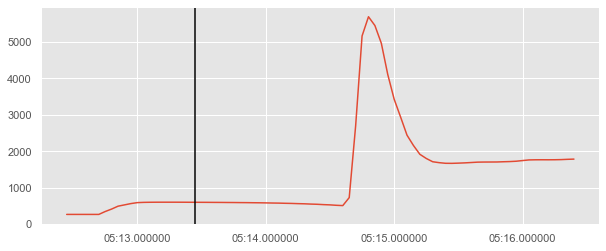

2021-08-16 12:25:48.800000 AC_OFF


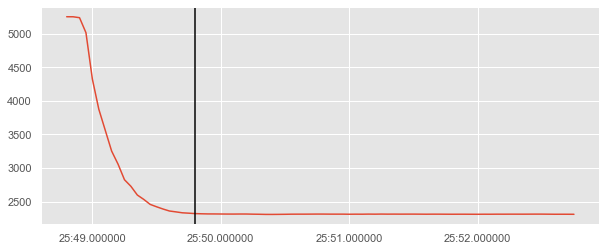

2021-08-16 12:13:58.800000 Microwave_ON


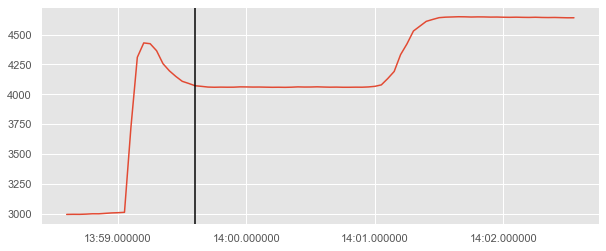

2021-08-16 12:15:46.800000 Geyser_ON


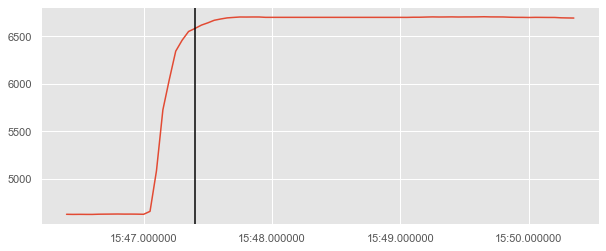

2021-08-16 12:16:58.400000 Microwave_OFF


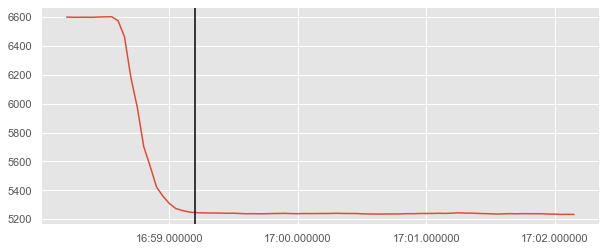

2021-08-16 12:35:04.200000 Geyser_OFF


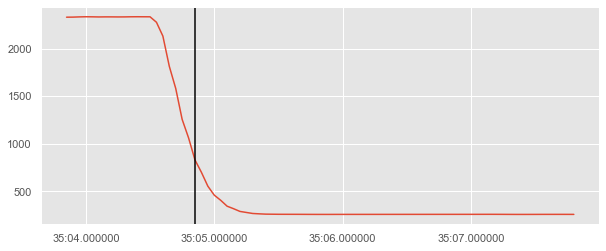

2021-08-16 12:30:44.800000 Microwave_ON


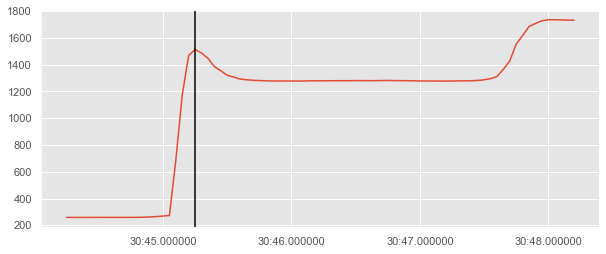

2021-08-16 12:33:44.400000 Microwave_OFF


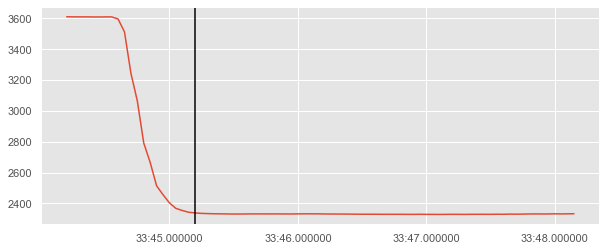

2021-08-16 12:36:04.400000 AC_ON


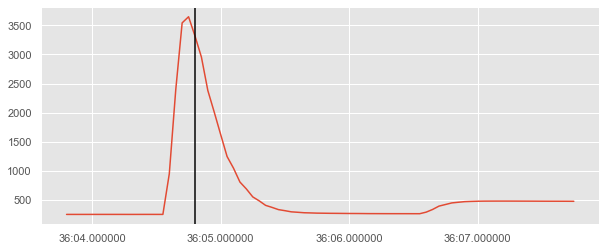

2021-08-16 12:40:45 Geyser_ON


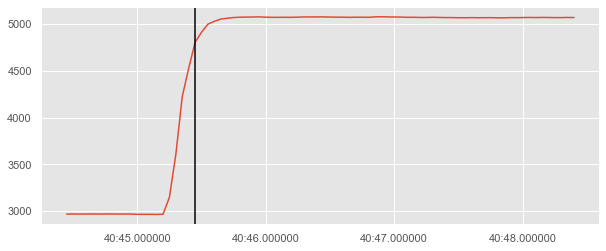

2021-08-16 12:51:03.600000 AC_OFF


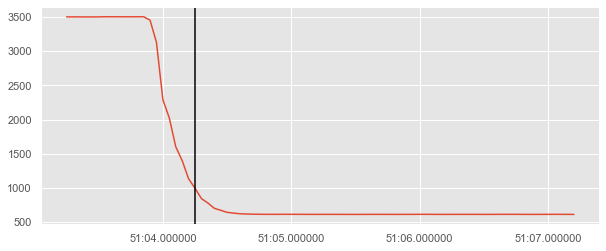

2021-08-16 12:42:11.200000 Geyser_OFF


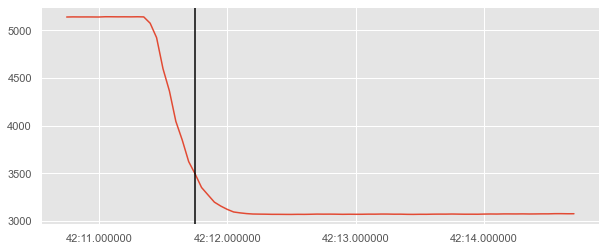

2021-08-16 16:07:33.200000 AC_ON


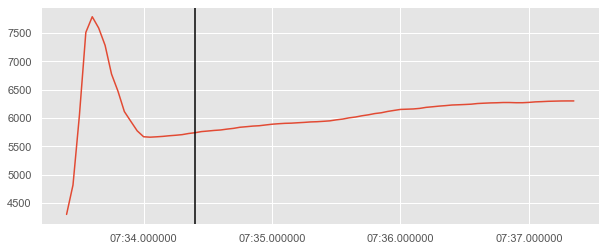

2021-08-16 16:10:57.400000 Microwave_ON


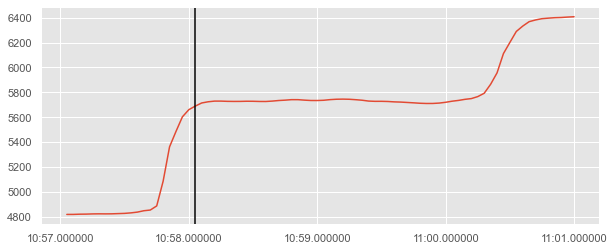

2021-08-16 16:13:57 Microwave_OFF


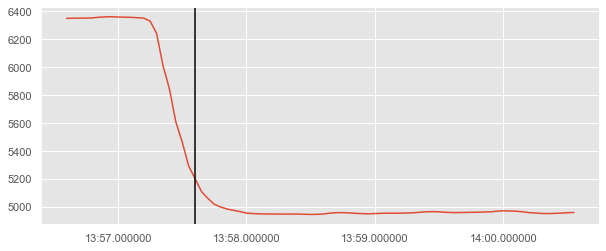

2021-08-16 16:30:52 Microwave_ON


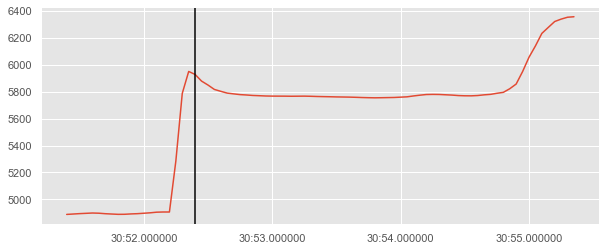

2021-08-16 16:33:51 Microwave_OFF


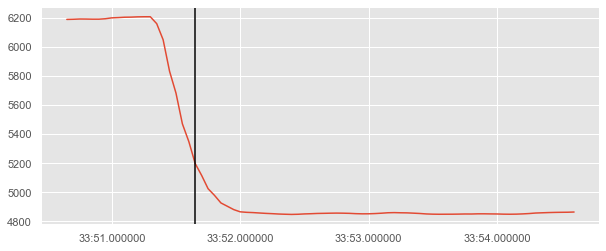

2021-08-16 16:35:53.800000 Geyser_OFF


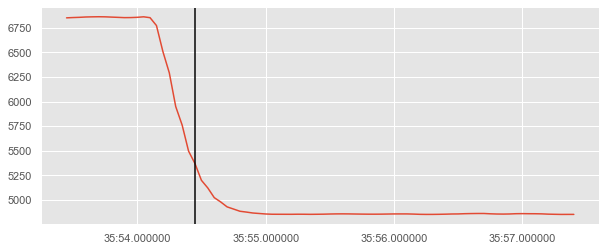

2021-08-16 16:36:54.800000 AC_ON


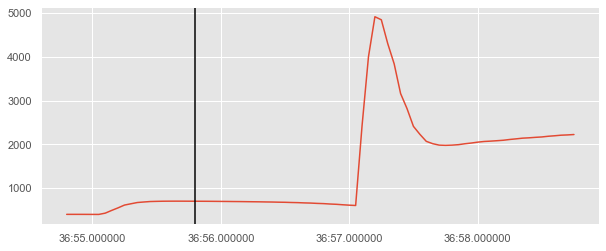

2021-08-16 16:40:48.600000 Geyser_ON


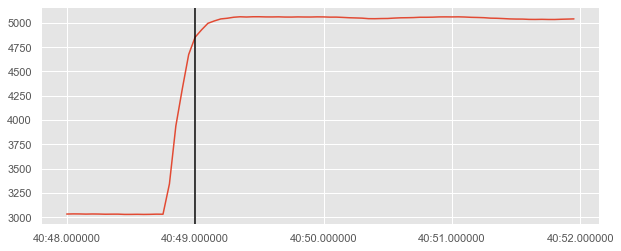

2021-08-16 17:01:09.200000 AC_OFF


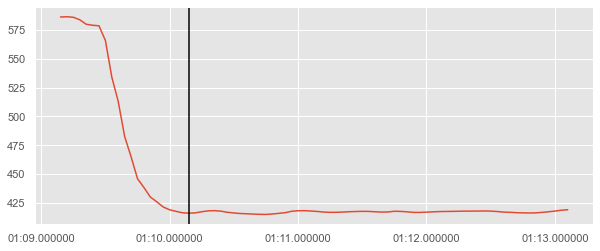

2021-08-17 12:08:45 AC_ON


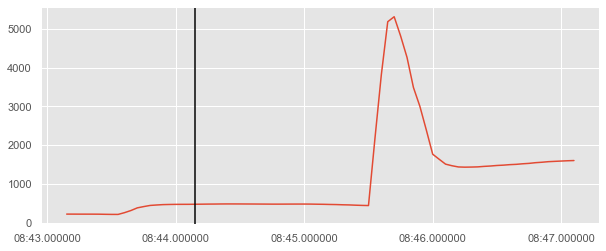

2021-08-17 12:13:55.600000 Microwave_OFF


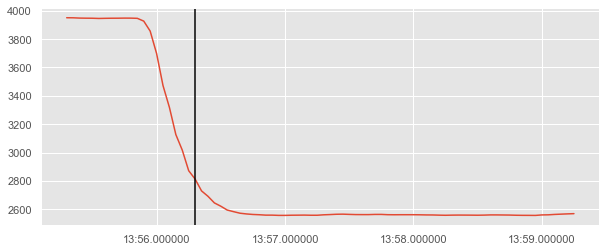

2021-08-17 12:15:55.200000 Geyser_ON


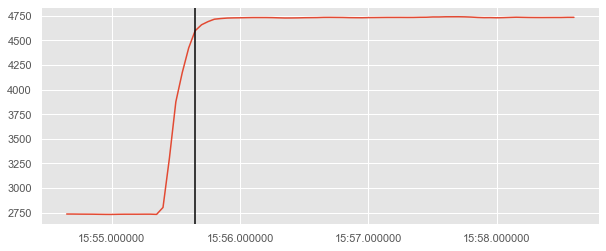

2021-08-17 12:34:17 Geyser_OFF


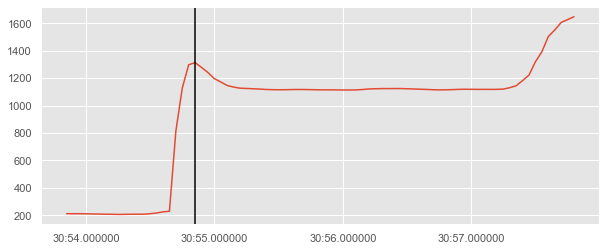

2021-08-17 12:30:54.200000 Microwave_ON


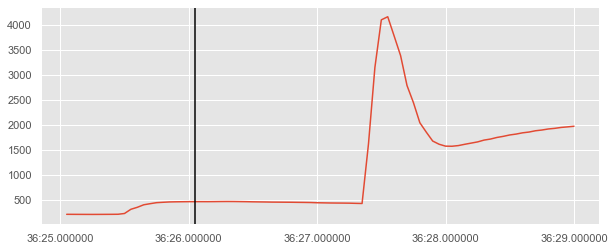

2021-08-17 12:36:25 AC_ON


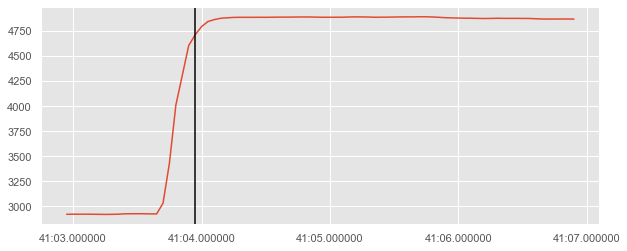

2021-08-17 12:41:03.400000 Geyser_ON


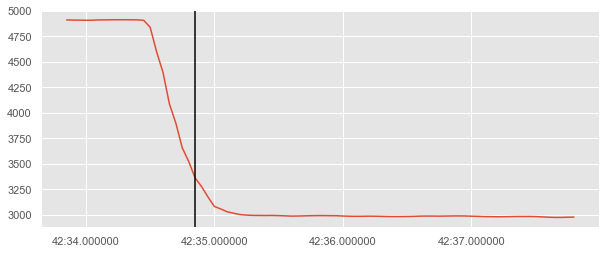

2021-08-17 12:42:34.200000 Geyser_OFF


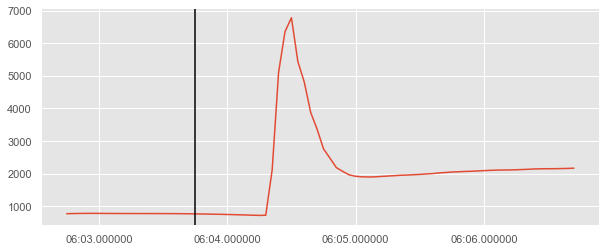

2021-08-17 12:33:54.400000 Microwave_OFF


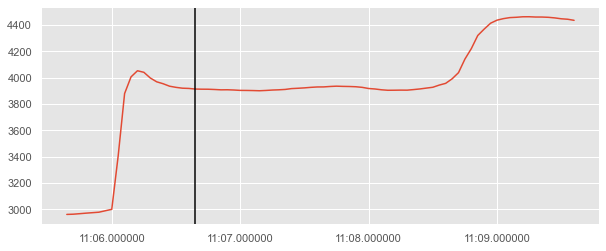

2021-08-17 13:01:27 AC_OFF


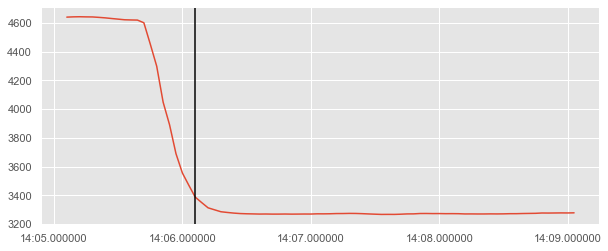

2021-08-17 16:06:02.200000 AC_ON


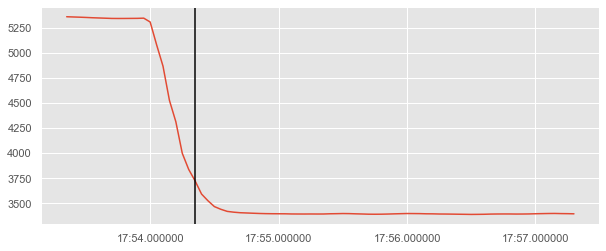

2021-08-17 16:11:05.800000 Microwave_ON


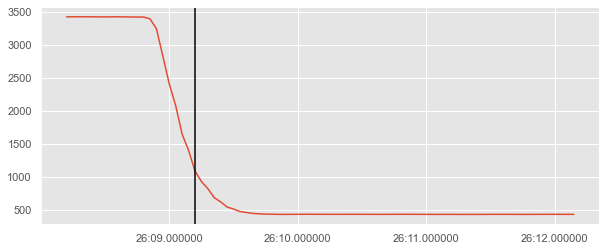

2021-08-17 16:14:05.200000 Microwave_OFF


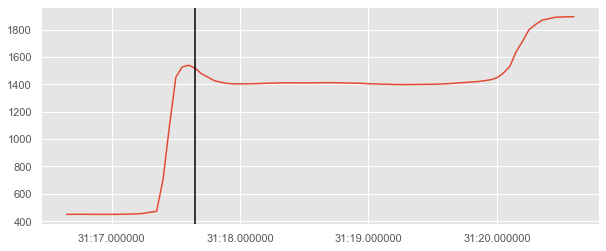

2021-08-17 16:17:53.800000 Geyser_OFF


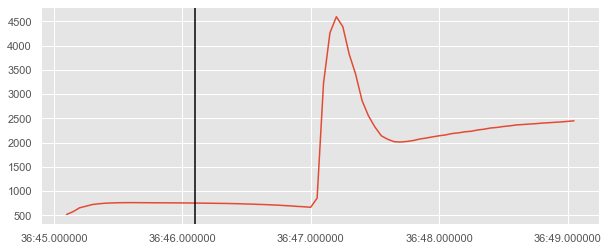

2021-08-17 16:26:08.600000 AC_OFF


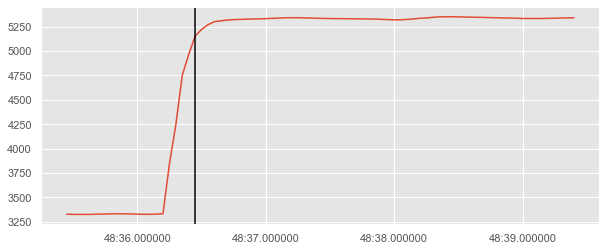

2021-08-17 16:31:17 Microwave_ON


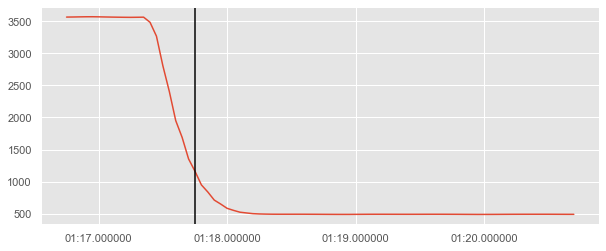

In [18]:
from pylab import rcParams
rcParams['figure.figsize'] = 10, 4

templist = []

for i in range(len(finallist)):
    out = finallist[i]
    out['apparent_power'] = out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3
    print(timelist[i], labellist[i])
    ind = out.index[out.label != 'no_event'].tolist()[0]
    templist.append(ind)
    plt.plot(out.logged_on_local[int(ind-20):int(ind+60)], out.apparent_power[int(ind-20):int(ind+60)])
    plt.axvline(out.logged_on_local[ind], color='black')
#     plt.axvline(timelist[i], color='blue')
    plt.show()

In [19]:
min(templist), max(templist)

(1457, 2431)

In [29]:
out.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3601 entries, 0 to 3600
Data columns (total 49 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   logged_on_utc        0 non-null      object        
 1   logged_on_local      3601 non-null   object        
 2   voltage_V1           3601 non-null   float64       
 3   voltage_V2           3601 non-null   float64       
 4   voltage_V3           3601 non-null   float64       
 5   current_i1           3601 non-null   float64       
 6   current_i2           3601 non-null   float64       
 7   current_i3           3601 non-null   float64       
 8   active_power_P1      3601 non-null   float64       
 9   active_power_P2      3601 non-null   float64       
 10  active_power_P3      3601 non-null   float64       
 11  apparent_power_S1    3601 non-null   float64       
 12  apparent_power_S2    3601 non-null   float64       
 13  apparent_power_S3    3601 non-null   f

In [7]:
labels = import_labels(1403)
labels = labels.sort_values(by='event_time')

In [26]:
labels.tail(60)

,id,created_on,updated_on,is_disabled,uuid,device_id,activity_type,equipment_type,event_time,event_type,lead_property_id
167,168,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,055efbe5d1fb46fd84d33c3467fdb6a3,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 12:48:10.800,OFF,1403
168,169,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,418b97067aa44d19b023ab5945e24571,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 14:11:13.400,ON,1403
169,170,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,c1fba956dc9d40ec9a6891fa719e2404,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 14:37:31.800,OFF,1403
170,171,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,a6c2d34caba64fa0b4cd55e54285297b,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 16:16:01.200,OFF,1403
171,172,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,460423a966f94528b5185a3149ff18d6,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 17:39:42.400,ON,1403
172,173,2021-08-10 05:51:59.138,2021-08-10 05:51:59.138,0,ed2e9aa408204b88bc0157c77cc534e6,53457bfe-4695-4a7c-83c5-76ce8b305082,NaN,Refrigerator,2021-08-09 18:05:50.000,OFF,1403
173,174,2021-08-21 11:28:23.559,2021-08-21 11:28:23.559,0,28d92ff22dff4ac0a50a5228130b0243,03cb5eec-25e2-4ea8-87e0-e9afcb0d75af,NaN,AC,2021-08-16 06:35:12.600,ON,1403
175,176,2021-08-21 11:39:51.707,2021-08-21 11:39:51.707,0,0d295d0f155345ac8d7003b6456c9873,b882c920-44ff-4943-b726-e0ba676fd7c2,NaN,Microwave,2021-08-16 06:43:58.800,ON,1403
176,177,2021-08-21 11:39:51.707,2021-08-21 11:39:51.707,0,30d50b5402ad43cea9774d806f722c57,6c46ce84-2597-47a1-bb83-29f8b080e5db,NaN,Geyser,2021-08-16 06:45:46.800,ON,1403
177,178,2021-08-21 11:39:51.707,2021-08-21 11:39:51.707,0,ea6e09327caa42deb62df190a3412355,b882c920-44ff-4943-b726-e0ba676fd7c2,NaN,Microwave,2021-08-16 06:46:58.400,OFF,1403


In [9]:
labelled_data = pd.read_pickle('Data/labelled_data_22_08_2021.pkl')

In [10]:
labelled_data.label.value_counts()

no_event         2959159
AC_ON                 88
Microwave_ON          77
Microwave_OFF         77
AC_OFF                66
Geyser_OFF            66
Geyser_ON             66
Name: label, dtype: int64

In [11]:
labelled_data.head(50)

,created_on_utc,dump,logged_on_utc,logged_on_local,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,device_id,power_factor_PF1,power_factor_PF2,power_factor_PF3,label
0,2021-08-16 11:21:53.176716,,2021-08-16 11:26:49.450,2021-08-16 16:56:49.450,1403,230.70,232.49,243.38,1.35,0.30,0.73,146.85,61.57,61.57,313.46,71.05,180.33,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
1,2021-08-16 11:21:53.177117,,2021-08-16 11:26:49.900,2021-08-16 16:56:49.900,1403,231.29,233.40,244.09,1.35,0.30,0.73,149.09,62.43,62.43,316.56,71.78,181.00,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
2,2021-08-16 11:21:53.176215,,2021-08-16 11:26:49.000,2021-08-16 16:56:49.000,1403,230.64,232.88,243.54,1.35,0.30,0.73,149.99,61.97,61.97,315.48,71.24,180.38,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
3,2021-08-16 11:21:53.176576,,2021-08-16 11:26:49.300,2021-08-16 16:56:49.300,1403,230.59,232.79,243.43,1.35,0.30,0.73,147.73,61.96,61.96,313.88,71.53,180.00,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
4,2021-08-16 11:21:53.176648,,2021-08-16 11:26:49.400,2021-08-16 16:56:49.400,1403,230.67,232.63,243.42,1.35,0.30,0.73,147.16,61.55,61.55,313.65,71.15,180.26,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
5,2021-08-16 11:21:53.177165,,2021-08-16 11:26:49.950,2021-08-16 16:56:49.950,1403,231.34,233.46,244.15,1.35,0.30,0.73,149.48,62.42,62.42,316.88,71.78,181.22,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
6,2021-08-16 11:21:53.176787,,2021-08-16 11:26:49.550,2021-08-16 16:56:49.550,1403,230.79,232.39,243.40,1.35,0.30,0.73,146.66,62.05,62.05,313.16,71.21,180.38,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
7,2021-08-16 11:21:53.176361,,2021-08-16 11:26:49.050,2021-08-16 16:56:49.050,1403,230.61,232.85,243.51,1.35,0.30,0.73,149.69,61.96,61.96,315.46,71.27,180.22,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
8,2021-08-16 11:21:53.176503,,2021-08-16 11:26:49.200,2021-08-16 16:56:49.200,1403,230.53,232.76,243.38,1.35,0.30,0.73,148.44,62.17,62.17,314.15,71.44,179.73,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event
9,2021-08-16 11:21:53.176411,,2021-08-16 11:26:49.100,2021-08-16 16:56:49.100,1403,230.58,232.81,243.46,1.35,0.30,0.73,148.94,61.88,61.88,314.93,71.26,179.98,277.62,35.35,138.74,50.0,50.00,50.00,46900.64,52884.85,0.0,108720.90,70667.26,0.0,98084.47,46872.75,0.0,devid_C82B9690A288,0.470504,0.868999,-0.639060,no_event


In [11]:
labelled_data.drop_duplicates(subset='logged_on_local', inplace=True)

In [12]:
def resample_data(ld):
    out = ld.set_index('logged_on_local')
    out = out.asfreq(freq='50ms')
    return out

test = resample_data(labelled_data)

In [13]:
test.head()

,created_on_utc,dump,logged_on_utc,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,device_id,power_factor_PF1,power_factor_PF2,power_factor_PF3,label
logged_on_local,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-08-16 05:30:00.050,2021-08-15 23:54:54.282657,,2021-08-16 00:00:00.050,1403.0,239.08,256.73,255.16,0.22,0.21,16.51,27.32,48.40,48.40,53.14,55.51,4248.03,45.4,26.92,2407.33,49.98,49.98,49.98,45476.24,50662.52,0.0,104756.46,68004.17,0.0,94370.7,45363.83,0.0,devid_C82B9690A288,0.516129,0.873758,-0.824156,no_event
2021-08-16 05:30:00.100,2021-08-15 23:54:54.282710,,2021-08-16 00:00:00.100,1403.0,239.08,256.73,255.15,0.22,0.21,16.51,27.35,48.23,48.23,53.10,55.46,4247.22,45.4,26.92,2407.33,49.98,49.98,49.98,45476.24,50662.52,0.0,104756.46,68004.17,0.0,94370.7,45363.83,0.0,devid_C82B9690A288,0.516129,0.873758,-0.824156,no_event
2021-08-16 05:30:00.150,2021-08-15 23:54:54.282755,,2021-08-16 00:00:00.150,1403.0,239.09,256.73,255.15,0.22,0.21,16.51,27.39,48.21,48.21,53.08,55.42,4247.68,45.4,26.92,2407.33,49.98,49.98,49.98,45476.24,50662.52,0.0,104756.46,68004.17,0.0,94370.7,45363.83,0.0,devid_C82B9690A288,0.516129,0.873758,-0.824156,no_event
2021-08-16 05:30:00.200,2021-08-15 23:54:54.282795,,2021-08-16 00:00:00.200,1403.0,239.10,256.72,255.15,0.22,0.21,16.51,27.40,48.30,48.30,53.02,55.40,4249.32,45.4,26.92,2407.33,49.98,49.98,49.98,45476.24,50662.52,0.0,104756.46,68004.17,0.0,94370.7,45363.83,0.0,devid_C82B9690A288,0.516129,0.873758,-0.824156,no_event
2021-08-16 05:30:00.250,2021-08-15 23:54:54.282834,,2021-08-16 00:00:00.250,1403.0,239.10,256.71,255.15,0.22,0.21,16.51,27.45,48.34,48.34,53.03,55.37,4250.00,45.4,26.92,2407.33,49.98,49.98,49.98,45476.24,50662.52,0.0,104756.46,68004.17,0.0,94370.7,45363.83,0.0,devid_C82B9690A288,0.516129,0.873758,-0.824156,no_event


In [14]:

# num_processes = multiprocessing.cpu_count()
# chunk_size = int(test.shape[0]/num_processes)
# chunks = [test[i:i + chunk_size] for i in range(0, test.shape[0], chunk_size)]
# pool = multiprocessing.Pool(processes=num_processes)

def create_training_data(rd):
    columns = ['voltage_V1', 'voltage_V2', 'voltage_V3', 'current_i1', 'current_i2', 'current_i3', 'power_factor_PF1', 
           'power_factor_PF2', 'power_factor_PF3', 'label']
    lookback = 16
    upahead = 0
    nanlimit = 5
    out = rd[columns]
    n = len(out)
    all_train = []
    all_label = []
    for i in tqdm(range(lookback, n - upahead)):
        chunk = out[i-lookback: i+upahead]
        nanvals = chunk.isnull().values.any()
        if nanvals:
            continue
#         chunk.interpolate(method='quadratic')
        all_train.append(chunk[columns[:-1]].values)
        all_label.append(out[i+1].label.values)
    return all_train, all_label
    

train, label = create_training_data(test)
# train, label = create_training_data(test, columns, 15, 0, 5)
# apply our function to each chunk in the list
# result = pool.map(create_training_data, chunks)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3455983/3455983 [25:08<00:00, 2290.79it/s]


In [16]:
train = np.array(train)
label = np.array(label)
np.save('trainTP2.npy', train)
np.save('labelTP2.npy', label)

In [25]:
cor_label = np.array([label[i+1, -1] for i in range(len(label)-1)]).squeeze()
train = train[1:]

In [26]:
train.shape, cor_label.shape

((2883431, 16, 9), (2883432,))

In [17]:
train.shape, label.shape

((2883433, 16, 9), (2883433, 16))

In [27]:
np.isnan(np.sum(train))

False

In [57]:
for et in labels.event_time:
#     uuid = row.uuid
    ind = labelled_data[labelled_data.logged_on_local == et]
#     print(ind)
    if not ind.empty:
        print(ind)
        break

                   created_on_utc  dump        logged_on_utc  \
42740  2021-08-05 19:02:12.922072  None  2021-08-05 19:06:23   

           logged_on_local  property_id  voltage_V1  voltage_V2  voltage_V3  \
42740  2021-08-06 00:36:23       1403.0      200.36      240.61      231.79   

       current_i1  current_i2  ...  per_change  time_spent  avg_diff  events  \
42740       12.13        0.21  ...   -0.115621           0 -0.001767       0   

       event_type  event_smoothening  event_effect  observable_event  \
42740           0                0.0           0.0                 0   

                                              model_data  ExactLabel  
42740  [1.32398, 1.32228, 1.31931, 1.3261500000000002...           4  

[1 rows x 55 columns]


In [58]:
ind.label

42740    no_event
Name: label, dtype: object

In [59]:
ref_on = labelled_data[labelled_data.label == 'Refrigerator_ON']

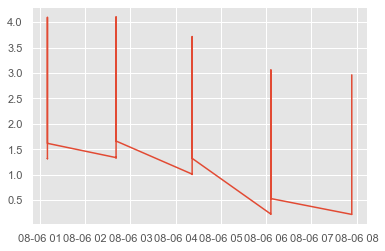

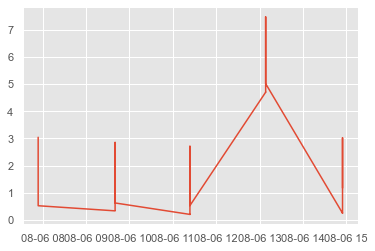

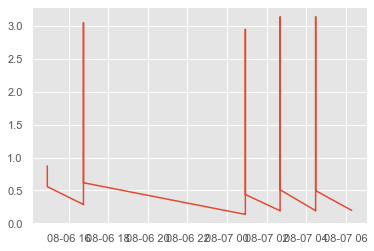

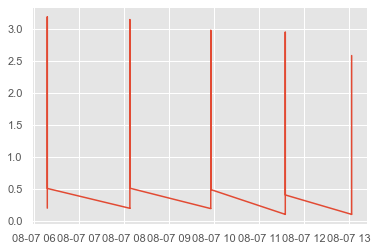

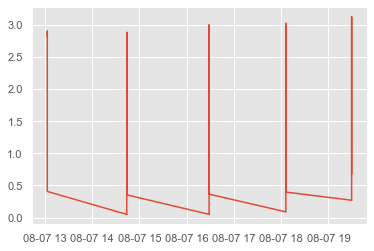

...

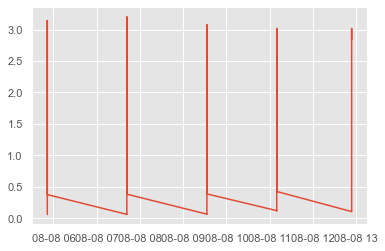

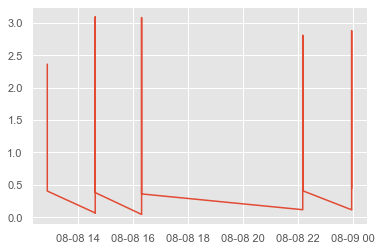

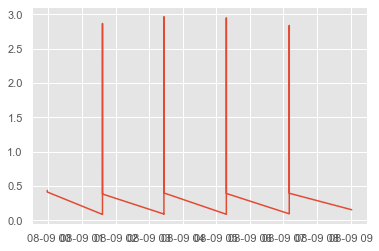

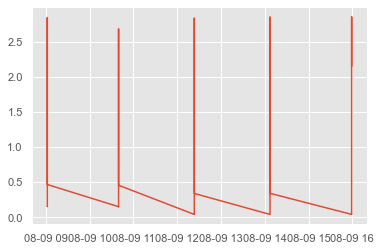

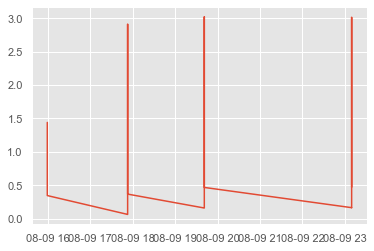

In [65]:
for i in range(0, len(ref_on), 100):
    j = i+100
    plt.plot(ref_on[i:j].logged_on_local, ref_on[i:j].mains_power)
    plt.show()

In [44]:
labelled_data.label.value_counts()

no_event            6582100
Refrigerator_ON        1081
Refrigerator_OFF        856
Geyser_ON               460
Geyser_OFF              360
Name: label, dtype: int64

In [8]:
labelled_data.observable_event.value_counts()

0    6583753
2        592
1        512
Name: observable_event, dtype: int64

In [9]:
event_instances = labelled_data[labelled_data.label!='no_event']

In [10]:
event_instances.columns

Index(['created_on_utc', 'dump', 'logged_on_utc', 'logged_on_local',
       'property_id', 'voltage_V1', 'voltage_V2', 'voltage_V3', 'current_i1',
       'current_i2', 'current_i3', 'active_power_P1', 'active_power_P2',
       'active_power_P3', 'apparent_power_S1', 'apparent_power_S2',
       'apparent_power_S3', 'reactive_power_Q1', 'reactive_power_Q2',
       'reactive_power_Q3', 'frequency_Fq1', 'frequency_Fq2', 'frequency_Fq3',
       'active_energy_Pt1', 'active_energy_Pt2', 'active_energy_Pt3',
       'apparent_energy_St1', 'apparent_energy_St2', 'apparent_energy_St3',
       'reactive_energy_Qt1', 'reactive_energy_Qt2', 'reactive_energy_Qt3',
       'device_id', 'power_factor_PF1', 'power_factor_PF2', 'power_factor_PF3',
       'label', 'logged_time_local', 'mains_power', 'before_mean',
       'before_max_10', 'before_mean_10', 'after_mean', 'after_mean_10',
       'after_max_10', 'per_change', 'time_spent', 'avg_diff', 'events',
       'event_type', 'event_smoothening', 'event

In [6]:
labelled_data['mains_power'] = labelled_data['active_power_P1']+labelled_data['active_power_P2']+labelled_data['active_power_P3']
# labelled_data=labelled_data.sort_values('logged_on_utc')

encoder = LabelEncoder()
encoder.fit(labelled_data['label'])

LabelEncoder()

In [7]:
encoder.classes_


array(['Geyser_OFF', 'Geyser_ON', 'Refrigerator_OFF', 'Refrigerator_ON',
       'no_event'], dtype=object)

In [11]:
def get_dict(x):
    x['prev_mean'] = x['mains_power'].rolling(5).mean()
    x['time_since_last_event'] = 0
    x['time_since_event_start'] = 0
    x['normalized_mains_power'] = 0

    print(datetime.datetime.now())
    x = x.reset_index()

    x_dict = x.to_dict('records')
    print(datetime.datetime.now())
    print('x_dict made')
    
    return x_dict

def get_features(x_dict):
    prev_mean = 0
    prev_activity_time = pd.to_datetime('2021-08-03')
    current_activity_time = pd.to_datetime('2021-08-03')
    activity_ongoing = False

    for row in tqdm(x_dict):

        label = row['label']

        if (label != 'no_event') and (activity_ongoing == False):
            current_activity_time = row['logged_on_utc']
            prev_mean = row['prev_mean']
            activity_ongoing = True

        elif (label == 'no_event') and (activity_ongoing == True):
            prev_activity_time = row['logged_on_utc']
            activity_ongoing = False
            activity_ongoing = False

        elif (label != 'no_event') and (activity_ongoing == True):
            row['time_since_last_event'] = (row['logged_on_utc'] - prev_activity_time).microseconds / 1000000 + \
                                           (row['logged_on_utc'] - prev_activity_time).seconds
            row['time_since_event_start'] = (row['logged_on_utc'] - current_activity_time).microseconds / 1000000 + \
                                            (row['logged_on_utc'] - current_activity_time).seconds
            row['normalized_mains_power'] = row['mains_power'] - prev_mean

        elif (label == 'no_event') and (activity_ongoing == False):
            row['time_since_last_event'] = (row['logged_on_utc'] - prev_activity_time).microseconds / 1000000 + \
                                           (row['logged_on_utc'] - prev_activity_time).seconds
            row['time_since_event_start'] = 0
            row['normalized_mains_power'] = row['mains_power'] - prev_mean
    return x_dict

In [22]:
# del x_dict
del x_out
# del tr_data

In [12]:
x_dict = get_dict(labelled_data)

2021-08-19 15:24:09.731606
2021-08-19 15:28:10.584634
x_dict made


In [42]:
# del labelled_data

In [14]:
x_out = get_features(x_dict)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6584857/6584857 [01:35<00:00, 68603.68it/s]


In [15]:
import gc
gc.collect()

47

In [18]:
# x_out[21], x_dict[20]
x_out

[{'index': 0,
  'created_on_utc': Timestamp('2021-08-05 18:25:51.600058'),
  'dump': None,
  'logged_on_utc': Timestamp('2021-08-05 18:30:00'),
  'logged_on_local': Timestamp('2021-08-06 00:00:00'),
  'property_id': 1403.0,
  'voltage_V1': 203.37,
  'voltage_V2': 235.96,
  'voltage_V3': 232.97,
  'current_i1': 12.05,
  'current_i2': 1.0,
  'current_i3': 0.49,
  'active_power_P1': 1168.33,
  'active_power_P2': 169.33,
  'active_power_P3': 169.33,
  'apparent_power_S1': 2472.28,
  'apparent_power_S2': 239.63,
  'apparent_power_S3': 115.81,
  'reactive_power_Q1': 2175.3,
  'reactive_power_Q2': 169.89,
  'reactive_power_Q3': 98.68,
  'frequency_Fq1': 50.02,
  'frequency_Fq2': 50.02,
  'frequency_Fq3': 50.02,
  'active_energy_Pt1': 15094.88,
  'active_energy_Pt2': 20170.73,
  'active_energy_Pt3': 0.0,
  'apparent_energy_St1': 31948.47,
  'apparent_energy_St2': 27850.76,
  'apparent_energy_St3': 0.0,
  'reactive_energy_Qt1': 28157.57,
  'reactive_energy_Qt2': 19204.33,
  'reactive_energy_Qt3

In [19]:
tr_data = pd.DataFrame.from_records(x_out)
tr_data = tr_data.fillna(0)

In [21]:
tr_data.to_pickle('tr_data.pkl')

In [23]:
tr_data.head(50)

,index,created_on_utc,dump,logged_on_utc,logged_on_local,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,...,events,event_type,event_smoothening,event_effect,observable_event,model_data,prev_mean,time_since_last_event,time_since_event_start,normalized_mains_power
0,0,2021-08-05 18:25:51.600058,0,2021-08-05 18:30:00.000,2021-08-06 00:00:00.000,1403.0,203.37,235.96,232.97,12.05,...,1,2,1.0,0.0,0,"[1.5069899999999998, 0.6767200000000001, 0.948...",0.000,66600.00,0.0,1506.99
1,1,2021-08-05 18:25:51.600211,0,2021-08-05 18:30:00.050,2021-08-06 00:00:00.050,1403.0,203.37,235.96,232.97,12.05,...,1,2,1.0,0.0,0,"[1.5101, 1.5069899999999998, 0.676720000000000...",0.000,66600.05,0.0,1510.10
2,2,2021-08-05 18:25:51.600265,0,2021-08-05 18:30:00.100,2021-08-06 00:00:00.100,1403.0,203.37,235.96,232.96,12.05,...,1,2,1.0,0.0,0,"[1.5147499999999998, 1.5101, 1.506989999999999...",0.000,66600.10,0.0,1514.75
3,3,2021-08-05 18:25:51.600311,0,2021-08-05 18:30:00.150,2021-08-06 00:00:00.150,1403.0,203.35,235.97,232.95,12.05,...,1,2,1.0,0.0,0,"[1.51001, 1.5147499999999998, 1.5101, 1.506989...",0.000,66600.15,0.0,1510.01
4,4,2021-08-05 18:25:51.600353,0,2021-08-05 18:30:00.200,2021-08-06 00:00:00.200,1403.0,203.30,236.01,232.96,12.05,...,1,2,1.0,0.0,0,"[1.51612, 1.51001, 1.5147499999999998, 1.5101,...",1511.594,66600.20,0.0,1516.12
5,5,2021-08-05 18:25:51.600401,0,2021-08-05 18:30:00.250,2021-08-06 00:00:00.250,1403.0,203.26,236.06,232.97,12.05,...,1,2,1.0,0.0,0,"[1.51309, 1.51612, 1.51001, 1.5147499999999998...",1512.814,66600.25,0.0,1513.09
6,6,2021-08-05 18:25:51.600443,0,2021-08-05 18:30:00.300,2021-08-06 00:00:00.300,1403.0,203.24,236.09,232.98,12.05,...,1,2,1.0,0.0,0,"[1.5120500000000001, 1.51309, 1.51612, 1.51001...",1513.204,66600.30,0.0,1512.05
7,7,2021-08-05 18:25:51.600484,0,2021-08-05 18:30:00.350,2021-08-06 00:00:00.350,1403.0,203.23,236.10,232.99,12.05,...,1,2,1.0,0.0,0,"[1.51469, 1.5120500000000001, 1.51309, 1.51612...",1513.192,66600.35,0.0,1514.69
8,8,2021-08-05 18:25:51.600524,0,2021-08-05 18:30:00.400,2021-08-06 00:00:00.400,1403.0,203.23,236.10,232.99,12.05,...,1,2,1.0,0.0,0,"[1.50865, 1.51469, 1.5120500000000001, 1.51309...",1512.920,66600.40,0.0,1508.65
9,9,2021-08-05 18:25:51.600564,0,2021-08-05 18:30:00.450,2021-08-06 00:00:00.450,1403.0,203.23,236.08,232.97,12.05,...,1,2,1.0,0.0,0,"[1.5151, 1.50865, 1.51469, 1.5120500000000001,...",1512.716,66600.45,0.0,1515.10


In [24]:
x_values=tr_data[['mains_power','prev_mean','time_since_last_event','time_since_event_start', 'normalized_mains_power']].fillna(0)
LOOK_BACK=15
def create_dataset (X, look_back = 7):
    Xs, ys = [], []
 
    for i in tqdm(range(len(X)-look_back)):
#         v = X['mains_power'][i:i+look_back].values
        v = X[i:i+look_back].values
        Xs.append(v)
        ys.append(dummy_y[i+look_back])
 
    return np.array(Xs).reshape(len(Xs), look_back, len(X.columns)), np.array(ys)

# encode and transform labels 
encoder = LabelEncoder()
encoder.fit(tr_data['label'])
encoded_Y = encoder.transform(tr_data['label'])

# convert integers to dummy variables (i.e. one hot encoded)
dummy_y = np.zeros((encoded_Y.size, encoded_Y.max()+1))
dummy_y[np.arange(encoded_Y.size),encoded_Y] = 1

X_train, y_train = create_dataset(x_values,LOOK_BACK)
# X_train_back, y_train_back = X_train, y_train
# X_train, y_train = create_dataset(training_data.loc[training_data.reset_index().index.isin(pd.Index(lis))])

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6584842/6584842 [02:29<00:00, 43937.59it/s]


In [25]:
print(len(x_values))
print(len(tr_data))
X_train.shape

6584857
6584857


(6584842, 15, 5)

In [26]:
pd.DataFrame(y_train).sum()
# data.reset_index()[data.reset_index()['label']!=''].pivot_table(index='label', aggfunc='count')

0        360.0
1        460.0
2        856.0
3       1081.0
4    6582085.0
dtype: float64

In [27]:
np.save('Data/CPX_train_0609.npy', X_train)
np.save('Data/CPy_train_0609.npy', y_train)

In [30]:
LOOK_BACK=80
InceptionTime = nn.Sequential(
                    Reshape(out_shape=(4,LOOK_BACK)),
                    InceptionBlock(
                        in_channels=4, 
                        n_filters=32, 
                        kernel_sizes=[5,13,23],
                        bottleneck_channels=32,
                        use_residual=True,
                        activation=nn.ReLU()
                    ),
                    InceptionBlock(
                        in_channels=32*4, 
                        n_filters=32, 
                        kernel_sizes=[5,13,23],
                        bottleneck_channels=32,
                        use_residual=True,
                        activation=nn.ReLU()
                    ),
                    nn.AdaptiveMaxPool1d(output_size=1),
#     nn.AdaptiveMaxPool1d(output_size=1),
                    Flatten(out_features=32*4*1),
                    nn.Linear(in_features=4*32*1, out_features=5)
        )

In [6]:
# X_train = np.load('Data/CPX_train_0609.npy')
# y_train = np.load('Data/CPy_train_0609.npy')

In [7]:
lab_0_ind = np.argwhere(y_train[:, 0] == 1).squeeze()
lab_1_ind = np.argwhere(y_train[:, 1] == 1).squeeze()
lab_2_ind = np.argwhere(y_train[:, 2] == 1).squeeze()
lab_3_ind = np.argwhere(y_train[:, 3] == 1).squeeze()
lab_4_ind = np.argwhere(y_train[:, 4] == 1).squeeze()

In [8]:
clab_4_ind = np.random.choice(lab_4_ind, 10*(len(lab_0_ind)+len(lab_1_ind)+len(lab_2_ind)+len(lab_3_ind)))
ind_list = np.hstack([lab_0_ind, lab_1_ind, lab_2_ind, lab_3_ind, clab_4_ind])

In [9]:
ind_list.shape

(30327,)

In [10]:
# Source: https://stackoverflow.com/questions/50125844/how-to-standard-scale-a-3d-matrix/50134698
import numpy as np
from sklearn.base import TransformerMixin
from sklearn.preprocessing import StandardScaler


class NDStandardScaler(TransformerMixin):
    def __init__(self, **kwargs):
        self._scaler = StandardScaler(copy=True, **kwargs)
        self._orig_shape = None

    def fit(self, X, **kwargs):
        X = np.array(X)
        # Save the original shape to reshape the flattened X later
        # back to its original shape
        if len(X.shape) > 1:
            self._orig_shape = X.shape[1:]
        X = self._flatten(X)
        self._scaler.fit(X, **kwargs)
        return self

    def transform(self, X, **kwargs):
        X = np.array(X)
        X = self._flatten(X)
        X = self._scaler.transform(X, **kwargs)
        X = self._reshape(X)
        return X

    def _flatten(self, X):
        # Reshape X to <= 2 dimensions
        if len(X.shape) > 2:
            n_dims = np.prod(self._orig_shape)
            X = X.reshape(-1, n_dims)
        return X

    def _reshape(self, X):
        # Reshape X back to it's original shape
        if len(X.shape) >= 2:
            X = X.reshape(-1, *self._orig_shape)
        return X

In [11]:
xall_data = X_train[ind_list] 
yall_data = y_train[ind_list]

nx_train, nx_test, ny_train, ny_test = train_test_split(xall_data, yall_data, test_size=0.33, random_state=42)

scaler = NDStandardScaler()
scaler.fit(nx_train)

nx_train = scaler.transform(nx_train)
nx_test = scaler.transform(nx_test)


In [12]:
tensor_x = torch.Tensor(nx_train) # transform to torch tensor
tensor_y = torch.Tensor(ny_train)


# X_test = scaler.transform(tensor_y)

dataset = TensorDataset(tensor_x,tensor_y) # create your datset
trainloader = DataLoader(dataset,batch_size=512*20) # create your dataloader


In [13]:
net=InceptionTime
import torch.optim as optim
import math
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# for epoch in range(epochs):
#     for inputs, labels in trainloader:
#         inputs, labels = inputs.to(device), labels.to(device)
device = "cuda"
net.to(device)
print(device)
# start_lr = 1e-7
# end_lr = .1
epochs=100

optimizer = optim.Adam(net.parameters(), lr=0.03)
# lr_lambda = lambda x: math.exp(x * math.log(end_lr / start_lr) / (epochs * len(trainloader.dataset)))
# scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda)

criterion = nn.BCEWithLogitsLoss()
weight = torch.tensor([10.0, 10.0, 10.0, 10.0, 1.0])
# itera=0
# lr_find_lr=[]
# lr_find_loss=[]
# smoothing=-1e-7
for epoch in range(epochs):  # loop over the dataset multiple times
#     print(epoch)
    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        weight = weight.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss = loss * weight
        loss = loss.mean()
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#         if i % 2000 == 1999:    # print every 2000 mini-batches
        print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss))
        running_loss = 0.0
        
#         # Update LR
#         scheduler.step()
#         lr_step = optimizer.state_dict()["param_groups"][0]["lr"]
#         lr_find_lr.append(lr_step)
        
#             # smooth the loss
#         if itera==0:
#             lr_find_loss.append(loss)
#         else:
#             loss = smoothing  * loss + (1 - smoothing) * lr_find_loss[-1]
#             lr_find_loss.append(loss)

#         itera += 1

cuda
[1,     1] loss: 7.082
[1,     2] loss: 3.002
[2,     1] loss: 2.198
[2,     2] loss: 2.310
[3,     1] loss: 1.898
[3,     2] loss: 1.804
[4,     1] loss: 1.765
[4,     2] loss: 1.578
[5,     1] loss: 1.464
[5,     2] loss: 1.250
[6,     1] loss: 1.193
[6,     2] loss: 1.032
[7,     1] loss: 0.956
[7,     2] loss: 0.848
[8,     1] loss: 0.834
[8,     2] loss: 0.770
[9,     1] loss: 0.803
[9,     2] loss: 0.724
[10,     1] loss: 0.720
[10,     2] loss: 0.650
[11,     1] loss: 0.653
[11,     2] loss: 0.605
[12,     1] loss: 0.613
[12,     2] loss: 0.582
[13,     1] loss: 0.589
[13,     2] loss: 0.552
[14,     1] loss: 0.568
[14,     2] loss: 0.524
[15,     1] loss: 0.543
[15,     2] loss: 0.500
[16,     1] loss: 0.514
[16,     2] loss: 0.470
[17,     1] loss: 0.486
[17,     2] loss: 0.453
[18,     1] loss: 0.474
[18,     2] loss: 0.426
[19,     1] loss: 0.451
[19,     2] loss: 0.409
[20,     1] loss: 0.429
[20,     2] loss: 0.389
[21,     1] loss: 0.419
[21,     2] loss: 0.374
[22, 

In [14]:
tensor_x = torch.Tensor(nx_test) # transform to torch tensor
tensor_y = torch.Tensor(ny_test)

with torch.no_grad():
    inputs, labels = tensor_x.to(device), tensor_y.to(device)
    outputs = net(inputs)
    outputs = outputs.detach().cpu().numpy()
    
ylab = np.argmax(ny_test, axis=1)
pred = np.argmax(outputs, axis=1)
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
# encoder.classes_

0.9184293339666645
0.989308553157474
[[ 111    0    0    0    7]
 [   3  105   13   25    4]
 [   0    0  256    5   18]
 [   1    5    5  320   19]
 [   1    0    1    0 9109]]


In [17]:
def calculate_metrics(cf):
    for i in range(len(cf)):
        print('For label ', i)
        true_positive = cf[i, i]
        false_positive = sum(cf[:, i]) - true_positive
        false_negative = sum(cf[i, :]) - cf[i, i]
        true_negative = sum(sum(cf)) - false_positive - false_negative - true_positive
        print('tp: ', true_positive, ' fp: ', false_positive, ' fn: ', false_negative, ' tn: ', true_negative)
    return

# calculate_metrics(cf1)

In [16]:
test_x = tensor_x = torch.Tensor(X_train) # transform to torch tensor
test_y = torch.Tensor(y_train)

testset = TensorDataset(test_x, test_y) # create your datset
testloader = DataLoader(testset,batch_size=512*20) # create your dataloader

In [17]:
preds = []
with torch.no_grad():
    for data in testloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(inputs)
        # the class with the highest energy is what we choose as prediction
        preds.append(np.argmax(outputs.detach().cpu().numpy(), axis=1))

In [18]:
tr_data = pd.read_pickle('Data/tr_data.pkl')

In [19]:
pred = np.hstack(preds)
out = np.hstack([np.ones(15)*4, pred])
tr_data["Preds"] = out

In [20]:
tr_data.head(50)

,index,created_on_utc,dump,logged_on_utc,logged_on_local,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,...,event_type,event_smoothening,event_effect,observable_event,model_data,prev_mean,time_since_last_event,time_since_event_start,normalized_mains_power,Preds
0,0,2021-08-05 18:25:51.600058,0,2021-08-05 18:30:00.000,2021-08-06 00:00:00.000,1403.0,203.37,235.96,232.97,12.05,...,2,1.0,0.0,0,"[1.5069899999999998, 0.6767200000000001, 0.948...",0.000,66600.00,0.0,1506.99,4.0
1,1,2021-08-05 18:25:51.600211,0,2021-08-05 18:30:00.050,2021-08-06 00:00:00.050,1403.0,203.37,235.96,232.97,12.05,...,2,1.0,0.0,0,"[1.5101, 1.5069899999999998, 0.676720000000000...",0.000,66600.05,0.0,1510.10,4.0
2,2,2021-08-05 18:25:51.600265,0,2021-08-05 18:30:00.100,2021-08-06 00:00:00.100,1403.0,203.37,235.96,232.96,12.05,...,2,1.0,0.0,0,"[1.5147499999999998, 1.5101, 1.506989999999999...",0.000,66600.10,0.0,1514.75,4.0
3,3,2021-08-05 18:25:51.600311,0,2021-08-05 18:30:00.150,2021-08-06 00:00:00.150,1403.0,203.35,235.97,232.95,12.05,...,2,1.0,0.0,0,"[1.51001, 1.5147499999999998, 1.5101, 1.506989...",0.000,66600.15,0.0,1510.01,4.0
4,4,2021-08-05 18:25:51.600353,0,2021-08-05 18:30:00.200,2021-08-06 00:00:00.200,1403.0,203.30,236.01,232.96,12.05,...,2,1.0,0.0,0,"[1.51612, 1.51001, 1.5147499999999998, 1.5101,...",1511.594,66600.20,0.0,1516.12,4.0
5,5,2021-08-05 18:25:51.600401,0,2021-08-05 18:30:00.250,2021-08-06 00:00:00.250,1403.0,203.26,236.06,232.97,12.05,...,2,1.0,0.0,0,"[1.51309, 1.51612, 1.51001, 1.5147499999999998...",1512.814,66600.25,0.0,1513.09,4.0
6,6,2021-08-05 18:25:51.600443,0,2021-08-05 18:30:00.300,2021-08-06 00:00:00.300,1403.0,203.24,236.09,232.98,12.05,...,2,1.0,0.0,0,"[1.5120500000000001, 1.51309, 1.51612, 1.51001...",1513.204,66600.30,0.0,1512.05,4.0
7,7,2021-08-05 18:25:51.600484,0,2021-08-05 18:30:00.350,2021-08-06 00:00:00.350,1403.0,203.23,236.10,232.99,12.05,...,2,1.0,0.0,0,"[1.51469, 1.5120500000000001, 1.51309, 1.51612...",1513.192,66600.35,0.0,1514.69,4.0
8,8,2021-08-05 18:25:51.600524,0,2021-08-05 18:30:00.400,2021-08-06 00:00:00.400,1403.0,203.23,236.10,232.99,12.05,...,2,1.0,0.0,0,"[1.50865, 1.51469, 1.5120500000000001, 1.51309...",1512.920,66600.40,0.0,1508.65,4.0
9,9,2021-08-05 18:25:51.600564,0,2021-08-05 18:30:00.450,2021-08-06 00:00:00.450,1403.0,203.23,236.08,232.97,12.05,...,2,1.0,0.0,0,"[1.5151, 1.50865, 1.51469, 1.5120500000000001,...",1512.716,66600.45,0.0,1515.10,4.0


In [21]:
tr_data.to_pickle('Data/AllResults.pkl')

In [9]:
tr_data = pd.read_pickle('Data/AllResults.pkl')

In [33]:
tr_data = tr_data.drop(columns='index')
tr_data.head(50)

,created_on_utc,dump,logged_on_utc,logged_on_local,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,...,event_type,event_smoothening,event_effect,observable_event,model_data,prev_mean,time_since_last_event,time_since_event_start,normalized_mains_power,Preds
0,2021-08-05 18:25:51.600058,0,2021-08-05 18:30:00.000,2021-08-06 00:00:00.000,1403.0,203.37,235.96,232.97,12.05,1.0,...,2,1.0,0.0,0,"[1.5069899999999998, 0.6767200000000001, 0.948...",0.000,66600.00,0.0,1506.99,4.0
1,2021-08-05 18:25:51.600211,0,2021-08-05 18:30:00.050,2021-08-06 00:00:00.050,1403.0,203.37,235.96,232.97,12.05,1.0,...,2,1.0,0.0,0,"[1.5101, 1.5069899999999998, 0.676720000000000...",0.000,66600.05,0.0,1510.10,4.0
2,2021-08-05 18:25:51.600265,0,2021-08-05 18:30:00.100,2021-08-06 00:00:00.100,1403.0,203.37,235.96,232.96,12.05,1.0,...,2,1.0,0.0,0,"[1.5147499999999998, 1.5101, 1.506989999999999...",0.000,66600.10,0.0,1514.75,4.0
3,2021-08-05 18:25:51.600311,0,2021-08-05 18:30:00.150,2021-08-06 00:00:00.150,1403.0,203.35,235.97,232.95,12.05,1.0,...,2,1.0,0.0,0,"[1.51001, 1.5147499999999998, 1.5101, 1.506989...",0.000,66600.15,0.0,1510.01,4.0
4,2021-08-05 18:25:51.600353,0,2021-08-05 18:30:00.200,2021-08-06 00:00:00.200,1403.0,203.30,236.01,232.96,12.05,1.0,...,2,1.0,0.0,0,"[1.51612, 1.51001, 1.5147499999999998, 1.5101,...",1511.594,66600.20,0.0,1516.12,4.0
5,2021-08-05 18:25:51.600401,0,2021-08-05 18:30:00.250,2021-08-06 00:00:00.250,1403.0,203.26,236.06,232.97,12.05,1.0,...,2,1.0,0.0,0,"[1.51309, 1.51612, 1.51001, 1.5147499999999998...",1512.814,66600.25,0.0,1513.09,4.0
6,2021-08-05 18:25:51.600443,0,2021-08-05 18:30:00.300,2021-08-06 00:00:00.300,1403.0,203.24,236.09,232.98,12.05,1.0,...,2,1.0,0.0,0,"[1.5120500000000001, 1.51309, 1.51612, 1.51001...",1513.204,66600.30,0.0,1512.05,4.0
7,2021-08-05 18:25:51.600484,0,2021-08-05 18:30:00.350,2021-08-06 00:00:00.350,1403.0,203.23,236.10,232.99,12.05,1.0,...,2,1.0,0.0,0,"[1.51469, 1.5120500000000001, 1.51309, 1.51612...",1513.192,66600.35,0.0,1514.69,4.0
8,2021-08-05 18:25:51.600524,0,2021-08-05 18:30:00.400,2021-08-06 00:00:00.400,1403.0,203.23,236.10,232.99,12.05,1.0,...,2,1.0,0.0,0,"[1.50865, 1.51469, 1.5120500000000001, 1.51309...",1512.920,66600.40,0.0,1508.65,4.0
9,2021-08-05 18:25:51.600564,0,2021-08-05 18:30:00.450,2021-08-06 00:00:00.450,1403.0,203.23,236.08,232.97,12.05,1.0,...,2,1.0,0.0,0,"[1.5151, 1.50865, 1.51469, 1.5120500000000001,...",1512.716,66600.45,0.0,1515.10,4.0


In [11]:
encoder_label = {0:'Geyser_OFF', 1:'Geyser_ON', 2:'Refrigerator_OFF', 3:'Refrigerator_ON',
       4:'no_event'}

In [38]:
ind_obser_events = tr_data[tr_data.observable_event>0].index.to_list()
print(len(ind_obser_events))
tr_data.loc[ind_obser_events].head(50)

1104


,created_on_utc,dump,logged_on_utc,logged_on_local,property_id,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,...,event_type,event_smoothening,event_effect,observable_event,model_data,prev_mean,time_since_last_event,time_since_event_start,normalized_mains_power,Preds
7242,2021-08-05 18:32:01.347140,0,2021-08-05 18:36:09.100,2021-08-06 00:06:09.100,1403.0,201.32,236.68,231.73,12.20,0.83,...,1,0.6,-0.216166,2,"[1.52931, 1.5297200000000002, 1.52673000000000...",1527.900,66969.10,0.00,1529.310,4.0
82161,2021-08-05 19:35:46.487345,0,2021-08-05 19:39:55.050,2021-08-06 01:09:55.050,1403.0,205.23,243.38,231.85,12.11,0.21,...,1,0.6,0.308324,1,"[1.3146900000000004, 1.3104399999999998, 1.314...",1312.972,70795.05,0.00,1314.690,3.0
82197,2021-08-05 19:35:47.501199,0,2021-08-05 19:39:56.850,2021-08-06 01:09:56.850,1403.0,205.38,242.70,232.04,12.10,3.05,...,1,0.6,0.306357,1,"[1.90819, 2.06913, 2.4707600000000003, 2.86431...",2583.882,70796.85,0.75,594.126,1.0
92538,2021-08-05 19:44:35.681512,0,2021-08-05 19:48:47.900,2021-08-06 01:18:47.900,1403.0,209.08,240.18,231.57,12.09,1.15,...,1,0.6,3.015668,1,"[1.6190499999999999, 1.62101, 1.62246999999999...",1621.078,530.65,0.00,304.986,4.0
92573,2021-08-05 19:44:37.740056,0,2021-08-05 19:48:49.650,2021-08-06 01:18:49.650,1403.0,209.75,239.82,231.05,12.10,5.76,...,1,0.6,3.023874,1,"[1.9865199999999998, 1.9808, 1.98531, 1.9897, ...",1986.562,532.40,0.00,672.456,4.0
93076,2021-08-05 19:45:04.012862,0,2021-08-05 19:49:14.800,2021-08-06 01:19:14.800,1403.0,209.37,239.02,232.60,12.05,8.20,...,1,0.6,-3.005057,2,"[4.6849300000000005, 4.6838, 4.69145, 4.69643,...",4689.580,557.55,0.00,3370.866,3.0
112522,2021-08-05 20:01:40.214713,0,2021-08-05 20:05:51.100,2021-08-06 01:35:51.100,1403.0,210.33,240.41,234.40,12.10,0.96,...,1,0.6,-0.252104,2,"[1.6036400000000002, 1.59688, 1.59683000000000...",1597.730,1553.85,0.25,11.266,3.0
188955,2021-08-05 21:06:46.471545,0,2021-08-05 21:10:58.750,2021-08-06 02:40:58.750,1403.0,212.68,245.05,236.69,12.20,0.27,...,1,0.6,0.328443,1,"[1.33932, 1.3328700000000002, 1.33716, 1.34068...",1336.714,3907.00,0.00,-253.054,4.0
219369,2021-08-05 21:32:47.761547,0,2021-08-05 21:36:59.450,2021-08-06 03:06:59.450,1403.0,215.17,246.07,239.42,12.26,1.13,...,1,0.6,-0.240834,2,"[1.57327, 1.56952, 1.5700300000000003, 1.56917...",1568.836,1558.60,0.20,5.540,3.0
234979,2021-08-05 21:46:05.874517,0,2021-08-05 21:50:17.950,2021-08-06 03:20:17.950,1403.0,216.90,243.31,241.43,12.32,0.61,...,1,0.6,-1.077751,2,"[1.36502, 1.3585999999999998, 1.36097000000000...",1364.990,797.80,0.00,-202.710,4.0


In [35]:
label_list = []
pred_list = []

for ind in ind_obser_events:
    st = max(0, ind-10)
    en = min(ind+10, len(tr_data))
    focus_data = tr_data[['logged_on_local', 'label', 'observable_event', 'Preds']]
    focus_data = focus_data[st:en]
    focus_data['Preds'] = focus_data.apply(lambda row: encoder_label[row.Preds], axis=1)
    print('Indice is: ', ind)
    fvc = focus_data.label.value_counts()
    pvc = focus_data.Preds.value_counts()
    print('FVC')
    print(fvc)
    print('PVC')
    print(pvc)
    print(" ")
    label_list.append(fvc)
    pred_list.append(pvc)

Indice is:  7242
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  82161
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  82197
FVC
Refrigerator_ON    18
no_event            2
Name: label, dtype: int64
PVC
Refrigerator_ON    17
Geyser_ON           3
Name: Preds, dtype: int64
 
Indice is:  92538
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  92573
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event           15
Refrigerator_ON     5
Name: Preds, dtype: int64
 
Indice is:  93076
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  112522
FVC
Refrigerator_OFF    15
no_event             5
Name: label, dtype: int64
PVC
Refrigerator_ON    12
no_event            6
Geyser_ON           2
Name: Preds, dtype: int64
 
Indice is:  188955
FVC
no_event    20
Name: lab

Indice is:  939613
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  945415
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  945833
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  947175
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  947354
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  948080
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  965255
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  965873
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  982634
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
I

Indice is:  1345904
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event           16
Refrigerator_ON     4
Name: Preds, dtype: int64
 
Indice is:  1346187
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1346641
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1346913
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1348757
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349002
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349087
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349320
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1352595
FVC
no_event    20
Name: label, dtype: int64
PVC
no_eve

Indice is:  2356386
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2378065
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2379488
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2387792
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2389712
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2394809
FVC
no_event            17
Refrigerator_OFF     3
Name: label, dtype: int64
PVC
no_event           18
Refrigerator_ON     2
Name: Preds, dtype: int64
 
Indice is:  2396442
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event     19
Geyser_ON     1
Name: Preds, dtype: int64
 
Indice is:  2396698
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2409450
FVC
no_

Indice is:  2858421
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858456
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858647
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858850
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859046
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859246
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859439
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859641
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859833
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2866427
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866533
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866628
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866730
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866827
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867156
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867359
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867548
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867595
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2877524
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877649
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877843
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877968
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878162
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878287
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878482
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878606
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878757
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2896283
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896386
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896546
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896601
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896706
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2918813
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  2938214
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2938512
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  2951172
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: 

no_event    20
Name: Preds, dtype: int64
 
Indice is:  3600847
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3631270
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3725254
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3755107
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3761951
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3762051
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  3850798
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3880340
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3945155
FVC
no_event    20
Name: label, dt

Indice is:  4553954
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4576785
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4596144
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4598210
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4645041
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688143
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688343
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688467
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4691914
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  4770030
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4770131
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4770224
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771000
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771205
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771391
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771437
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771563
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771795
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  4778980
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779052
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779196
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779385
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779433
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779530
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779737
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779927
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4780041
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Name: Preds, dtype: int64
 
Indice is:  4821199
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821225
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821315
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821521
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821544
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821721
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821731
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821797
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821902
FVC
no_event    20
Name: label, dtype: int64
PVC
no_even

Indice is:  5668921
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710409
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710530
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710852
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5711818
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5726314
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5740784
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5741236
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5742482
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  6396084
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396185
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396281
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396379
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397096
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397308
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397492
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397518
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397731
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

no_event no_event 2


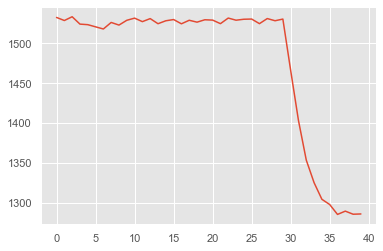

no_event Refrigerator_ON 1


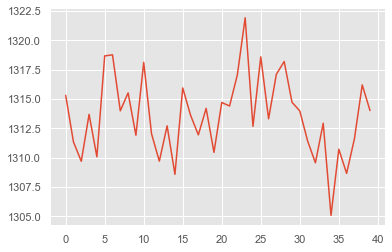

Refrigerator_ON Refrigerator_ON 1


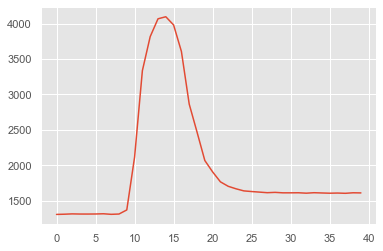

no_event no_event 1


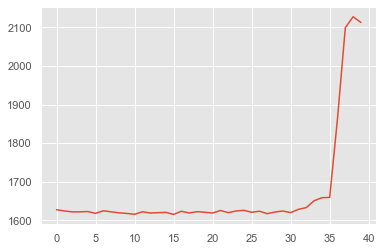

no_event Refrigerator_ON 1


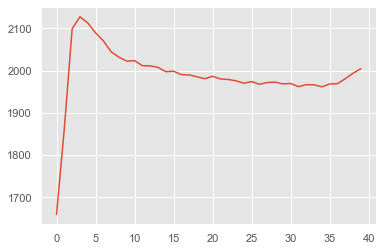

no_event Refrigerator_ON 2


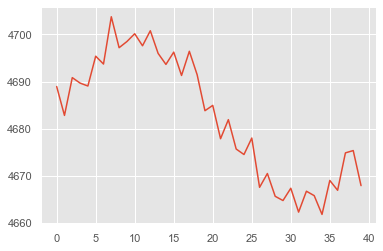

Refrigerator_OFF Refrigerator_ON 2


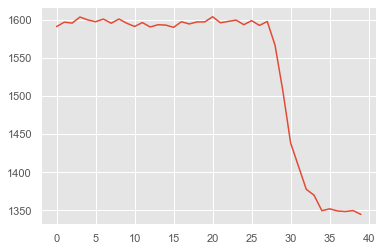

no_event no_event 1


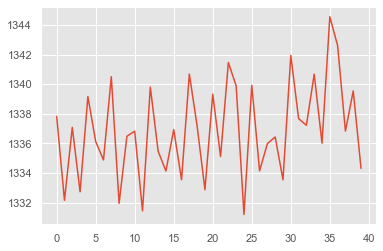

Refrigerator_OFF Refrigerator_ON 2


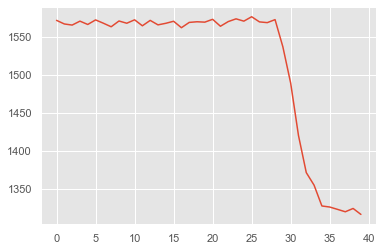

no_event no_event 2


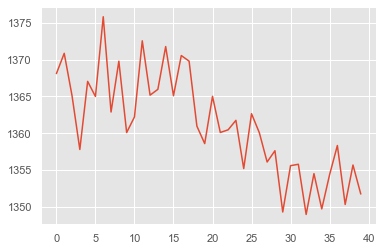

no_event no_event 2


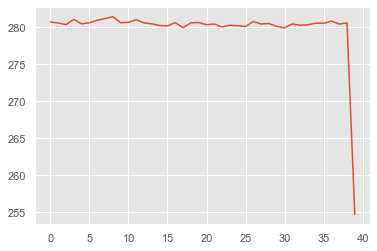

no_event no_event 2


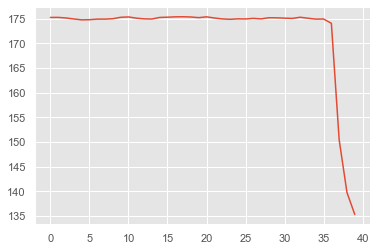

no_event no_event 1


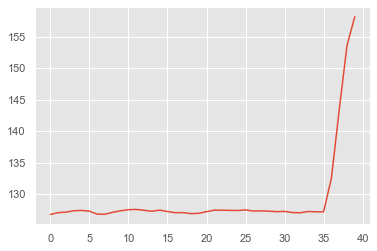

no_event no_event 2


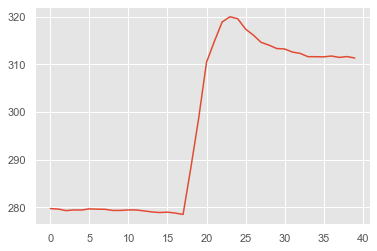

no_event no_event 2


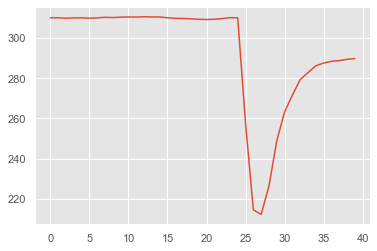

no_event no_event 1


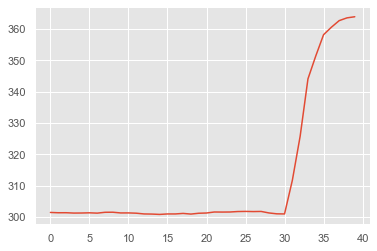

no_event no_event 2


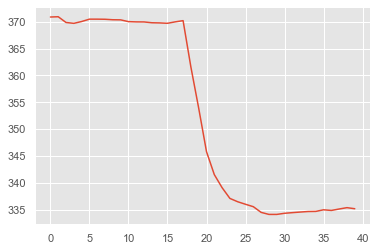

no_event no_event 2


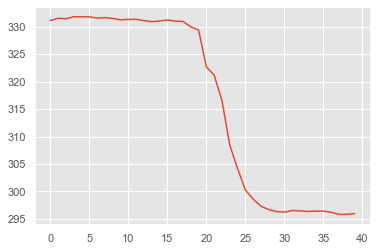

no_event no_event 1


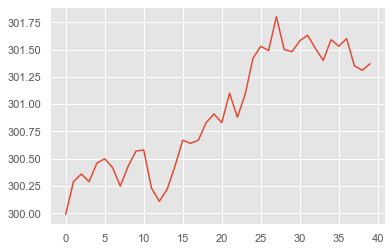

no_event Refrigerator_ON 2


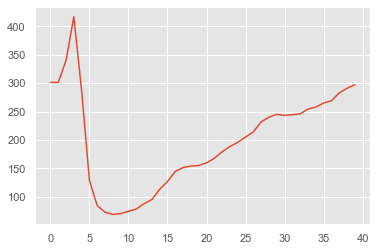

no_event no_event 1


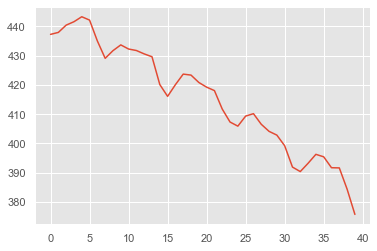

no_event no_event 1


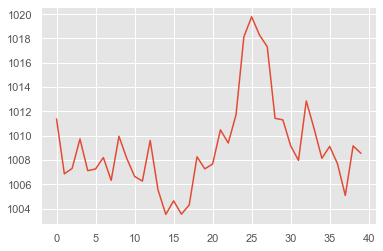

no_event no_event 2


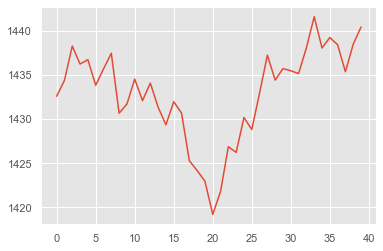

no_event no_event 2


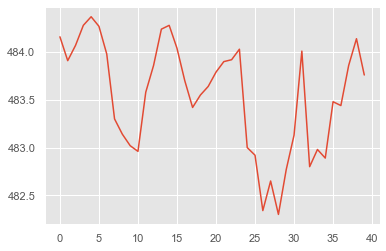

no_event no_event 1


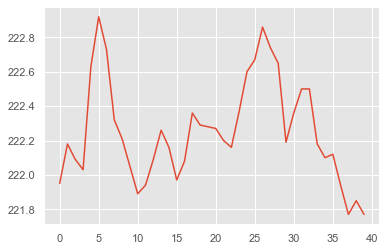

no_event no_event 2


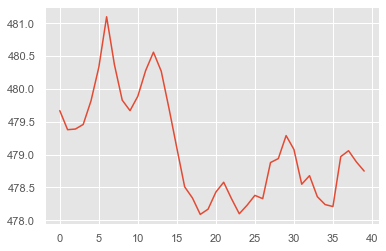

no_event no_event 2


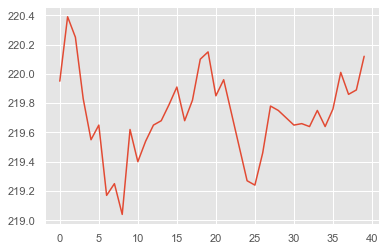

no_event no_event 1


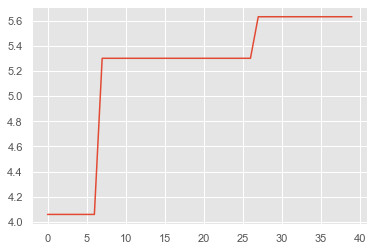

no_event no_event 2


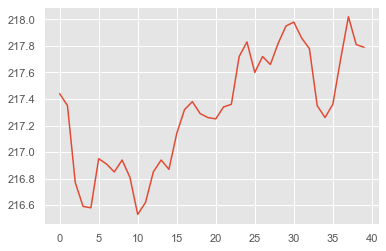

no_event no_event 1


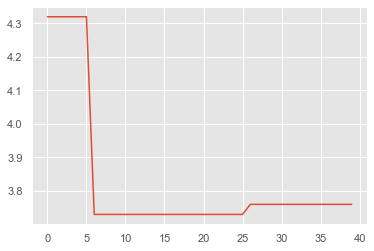

no_event no_event 1


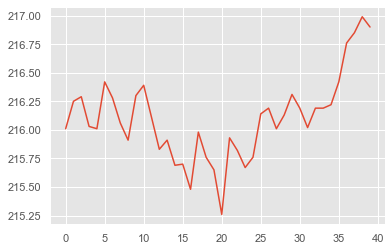

no_event no_event 2


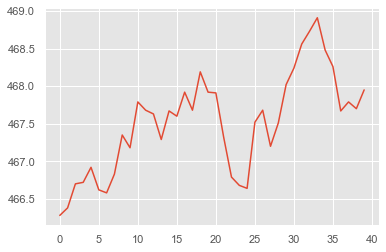

no_event no_event 1


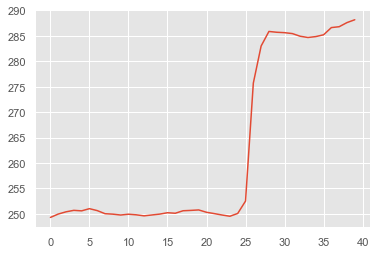

no_event no_event 1


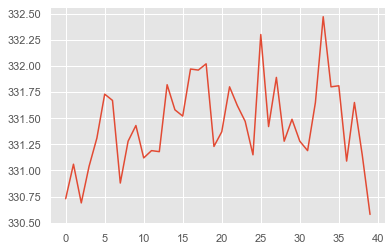

no_event no_event 2


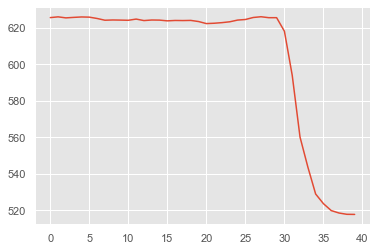

no_event no_event 1


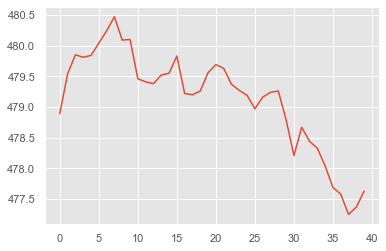

no_event Geyser_OFF 1


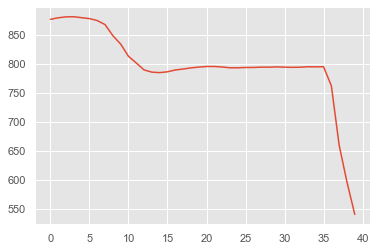

no_event no_event 1


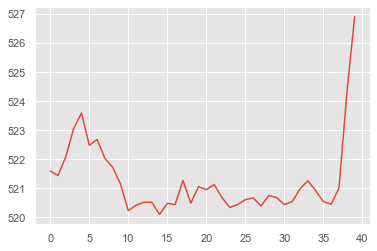

no_event no_event 2


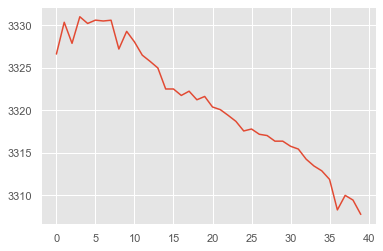

no_event no_event 2


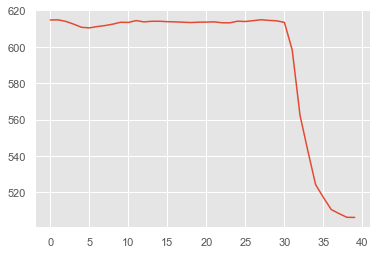

no_event no_event 2


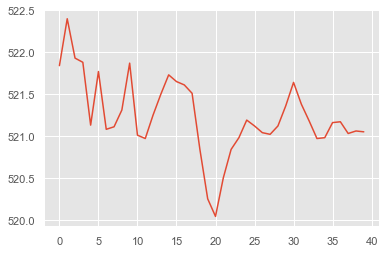

no_event no_event 1


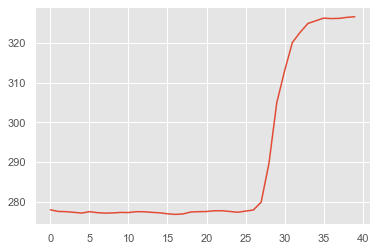

no_event no_event 1


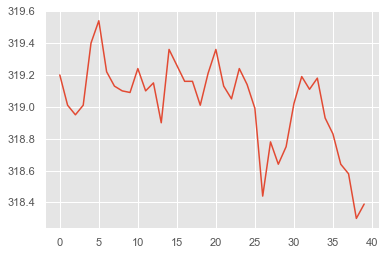

no_event no_event 2


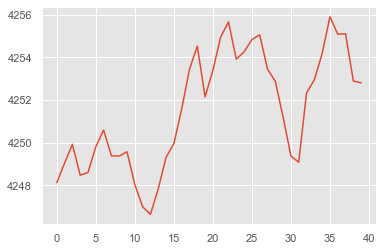

no_event no_event 1


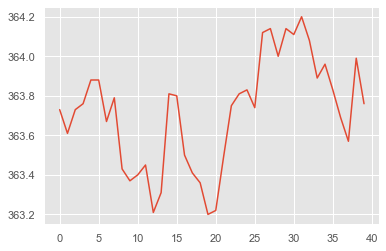

no_event no_event 2


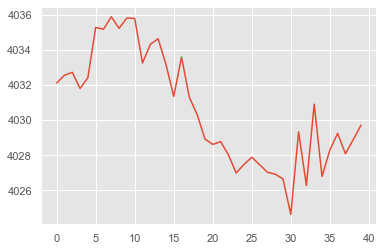

no_event no_event 1


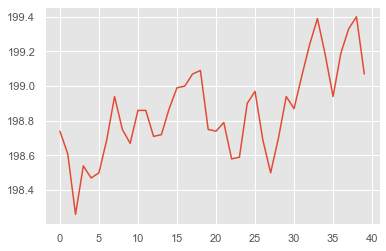

no_event no_event 2


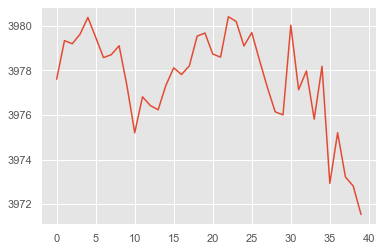

no_event no_event 1


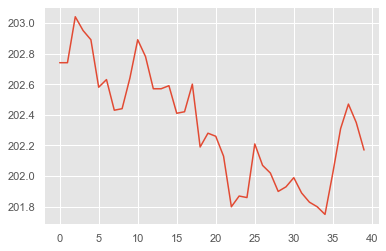

no_event no_event 2


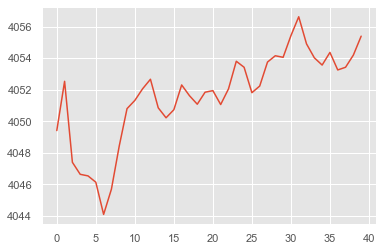

no_event no_event 1


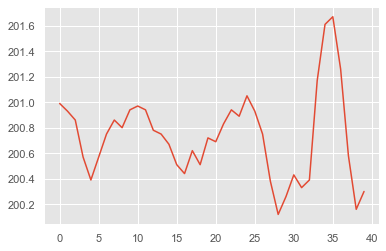

no_event no_event 1


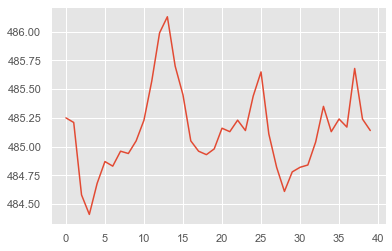

no_event no_event 2


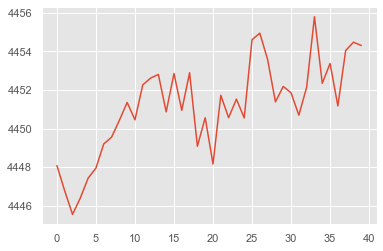

no_event no_event 2


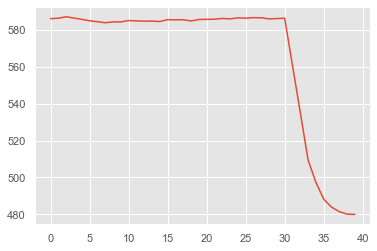

no_event no_event 2


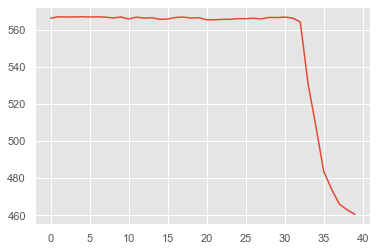

no_event no_event 2


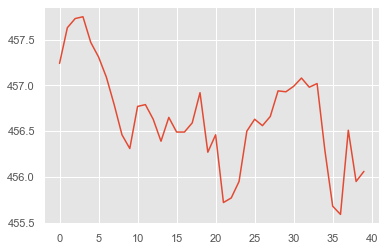

no_event no_event 2


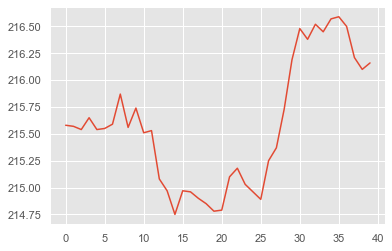

no_event no_event 1


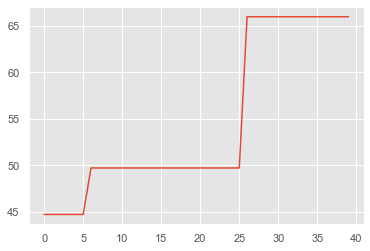

no_event Refrigerator_ON 1


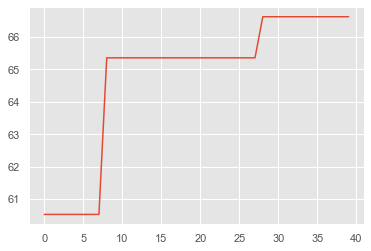

no_event no_event 1


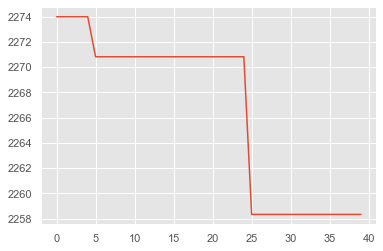

no_event no_event 1


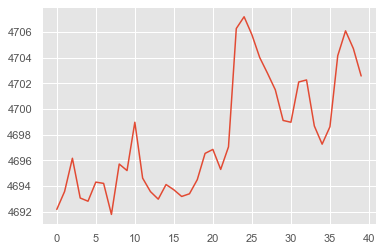

no_event Geyser_OFF 1


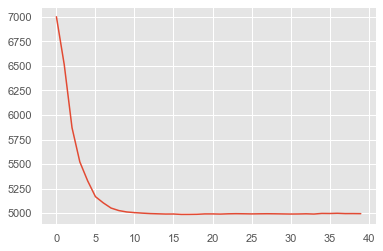

no_event no_event 2


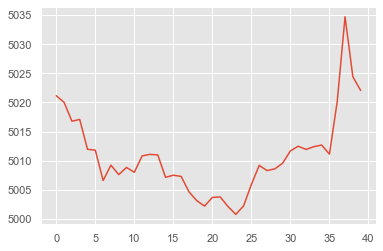

no_event no_event 2


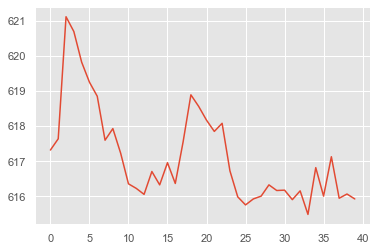

no_event no_event 1


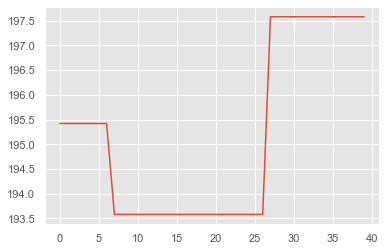

no_event no_event 2


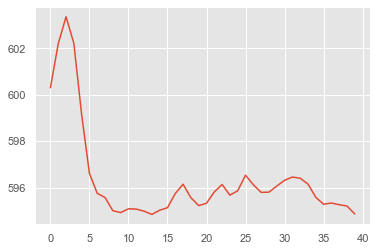

no_event no_event 1


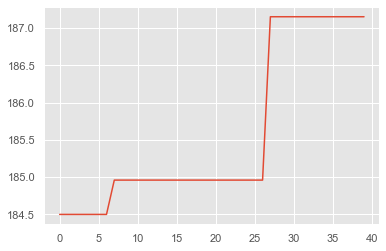

no_event no_event 2


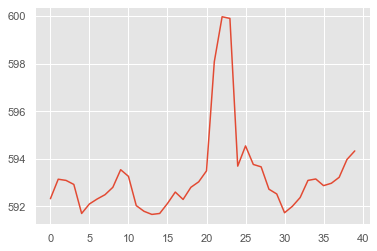

no_event no_event 1


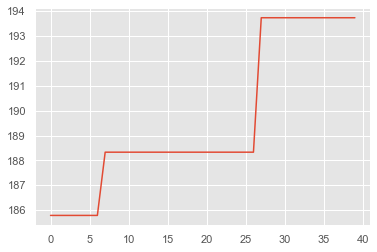

no_event no_event 2


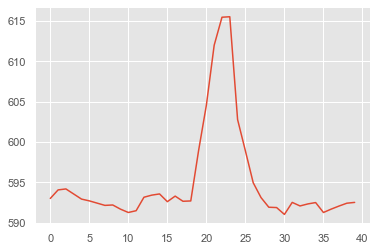

no_event no_event 1


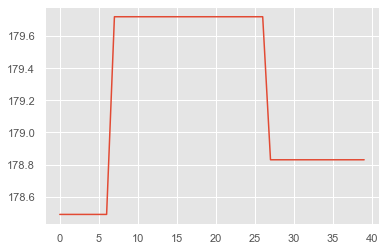

no_event no_event 2


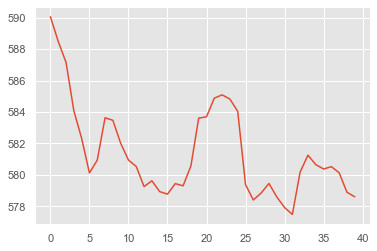

no_event no_event 1


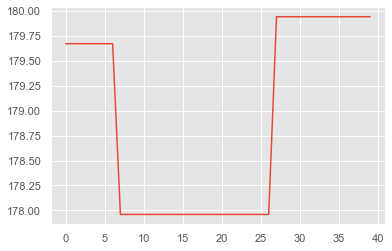

no_event no_event 2


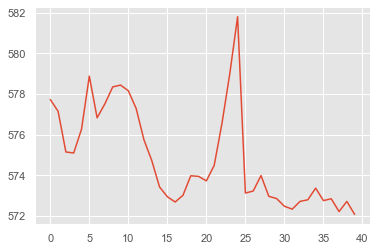

no_event no_event 1


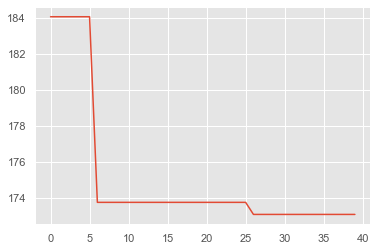

no_event no_event 2


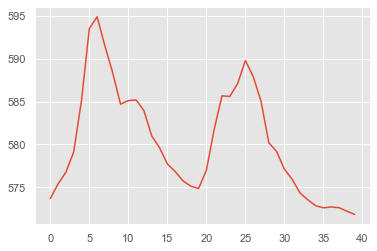

no_event no_event 2


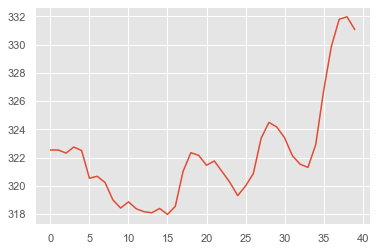

no_event no_event 1


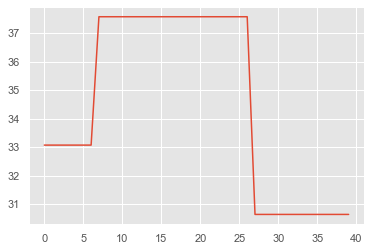

no_event no_event 2


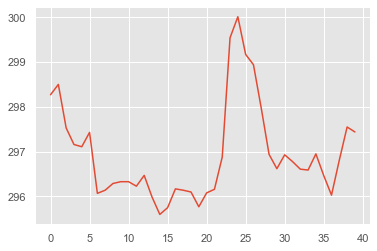

no_event no_event 1


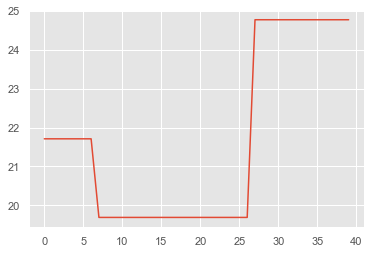

no_event no_event 2


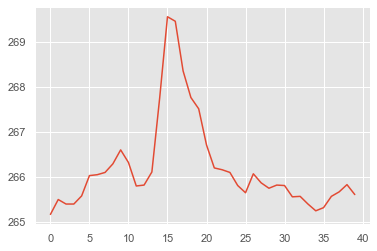

no_event no_event 1


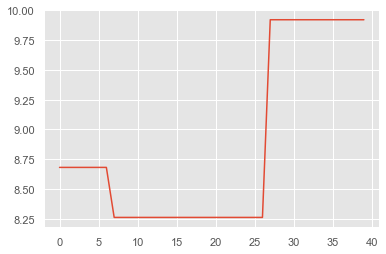

no_event no_event 1


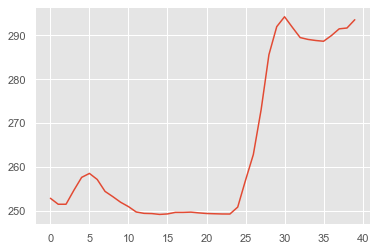

no_event no_event 1


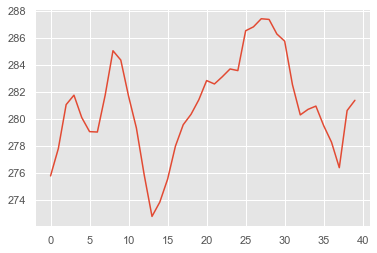

no_event no_event 1


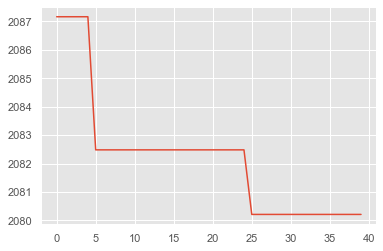

no_event no_event 2


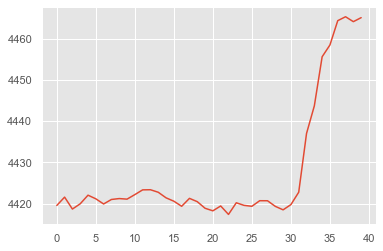

no_event no_event 2


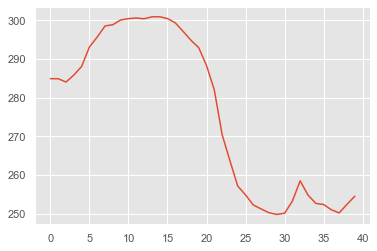

no_event no_event 2


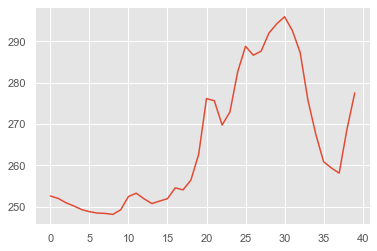

no_event no_event 1


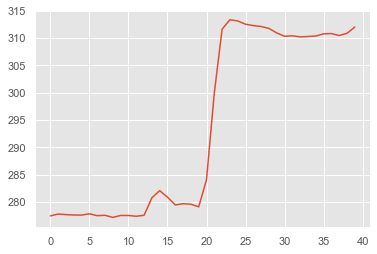

no_event no_event 2


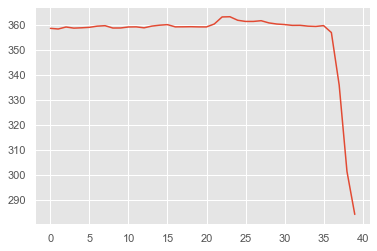

no_event no_event 2


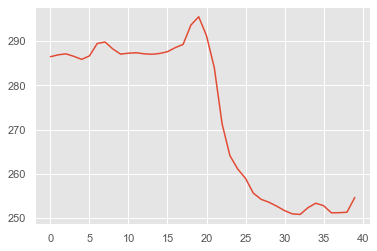

no_event no_event 2


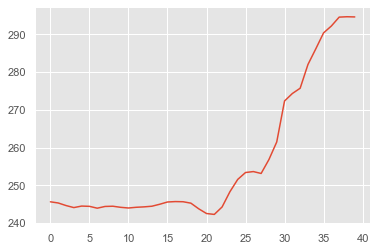

no_event no_event 1


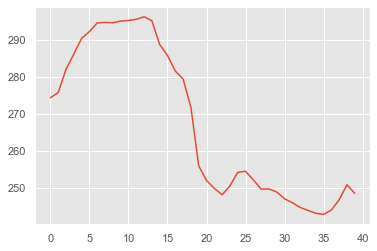

no_event no_event 1


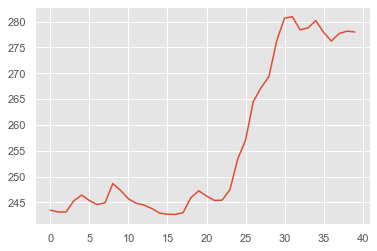

no_event no_event 1


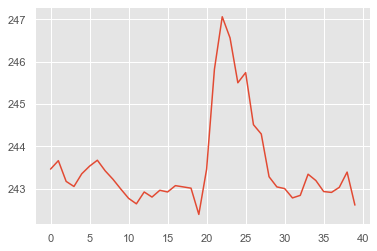

no_event no_event 2


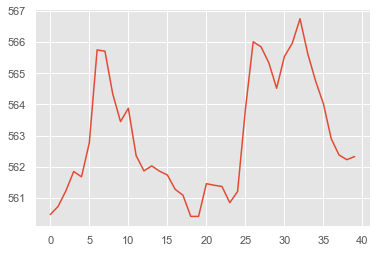

no_event no_event 2


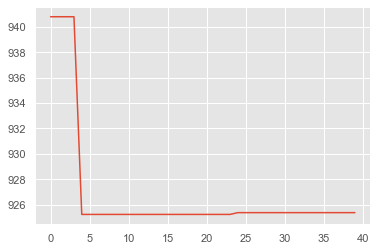

no_event no_event 1


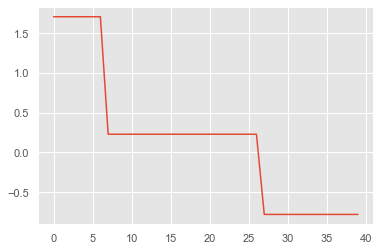

no_event no_event 1


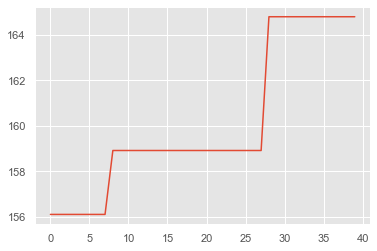

no_event no_event 1


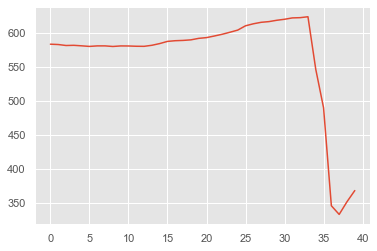

no_event Geyser_ON 1


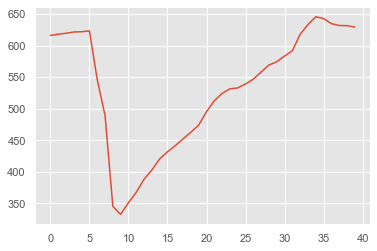

no_event no_event 1


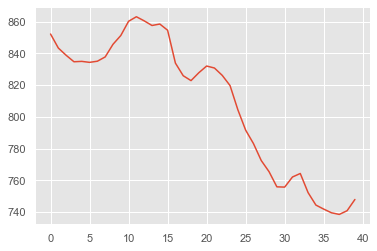

no_event no_event 2


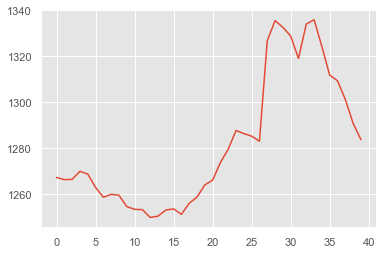

no_event no_event 2


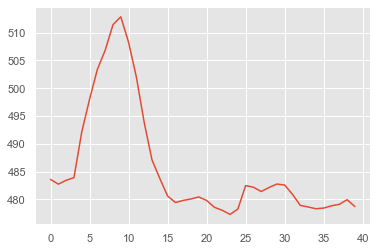

no_event no_event 2


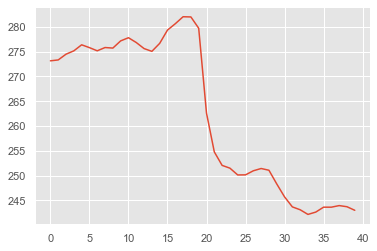

no_event no_event 2


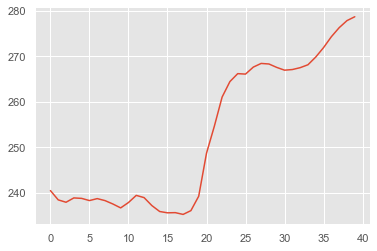

no_event no_event 1


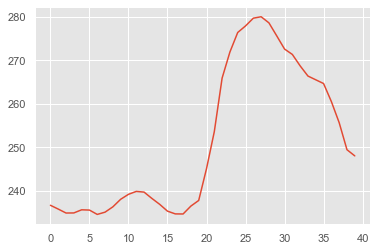

no_event no_event 1


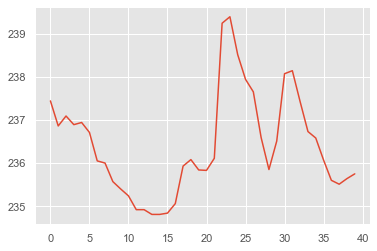

no_event no_event 2


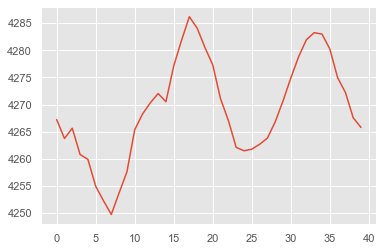

no_event no_event 1


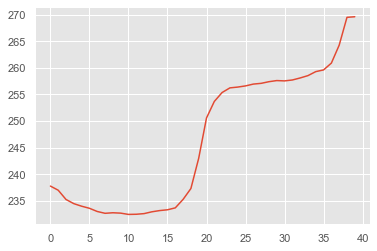

no_event no_event 1


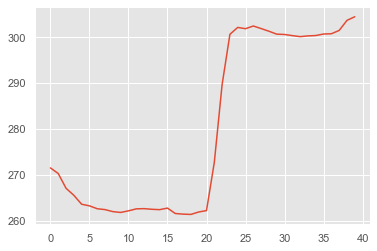

no_event no_event 2


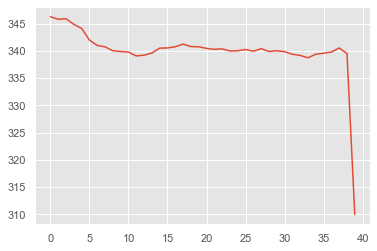

no_event no_event 2


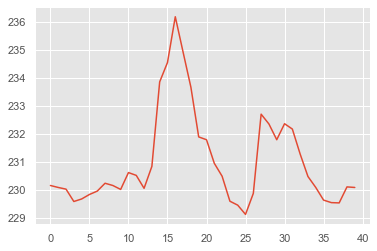

no_event no_event 1


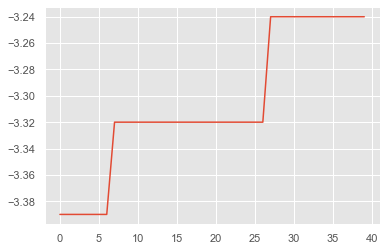

no_event no_event 1


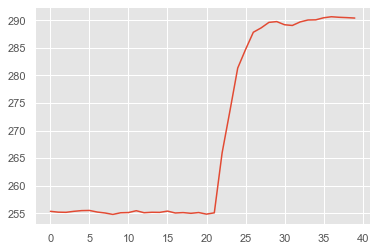

no_event no_event 1


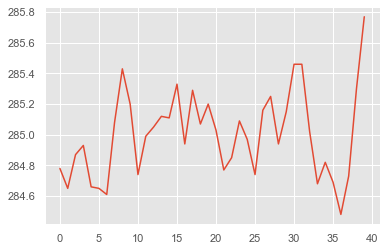

no_event no_event 2


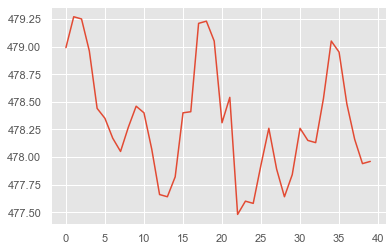

no_event no_event 1


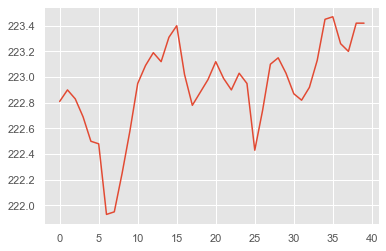

no_event no_event 2


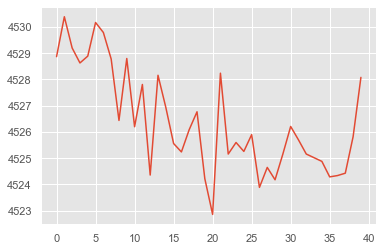

no_event no_event 1


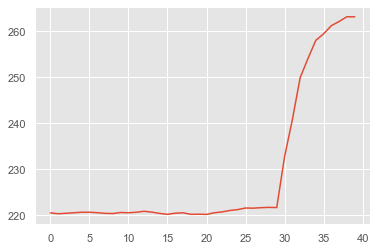

no_event no_event 1


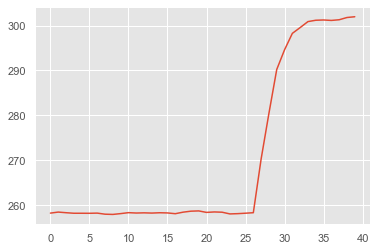

no_event no_event 1


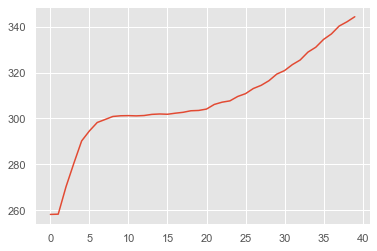

no_event Refrigerator_ON 1


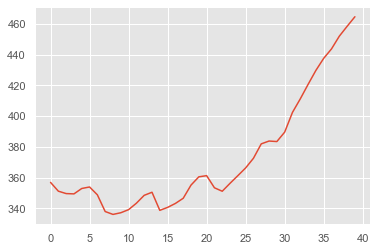

no_event no_event 1


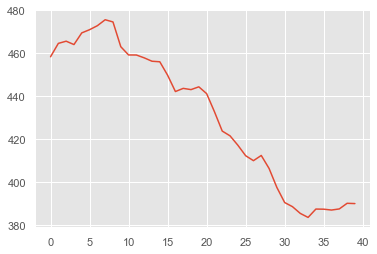

no_event no_event 2


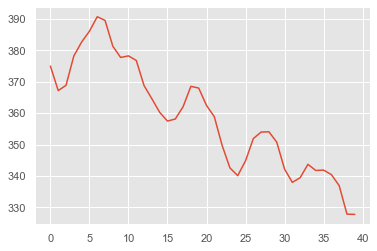

no_event no_event 2


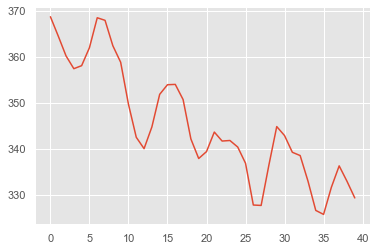

no_event no_event 2


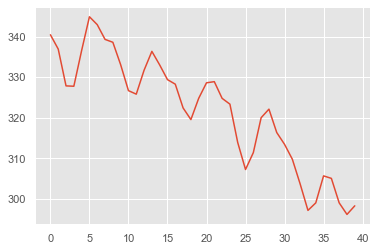

no_event no_event 2


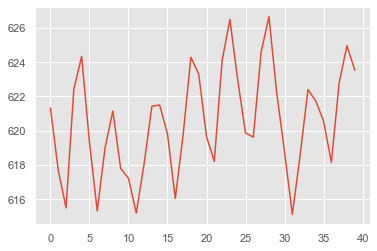

no_event no_event 1


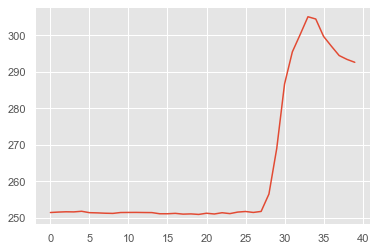

no_event no_event 1


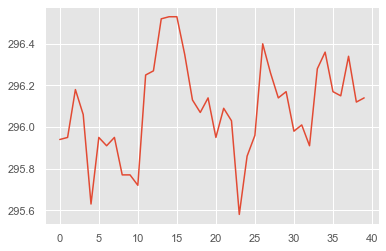

no_event no_event 2


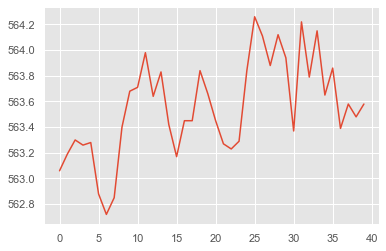

no_event no_event 1


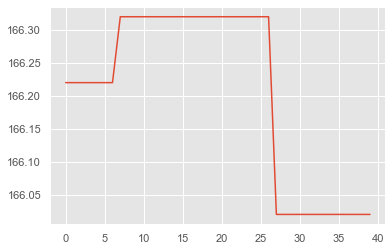

no_event no_event 2


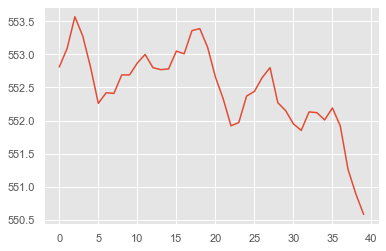

no_event no_event 1


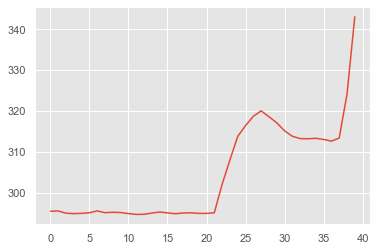

no_event no_event 1


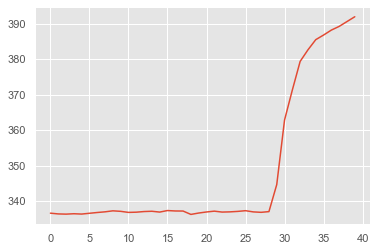

no_event no_event 2


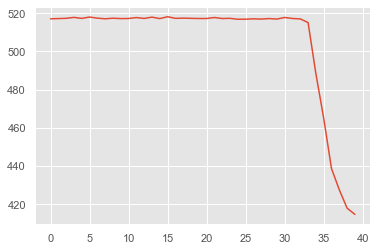

no_event no_event 1


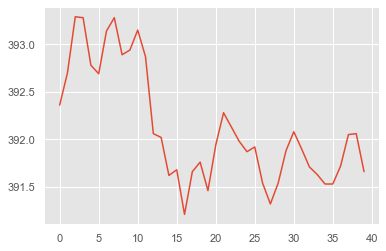

no_event no_event 2


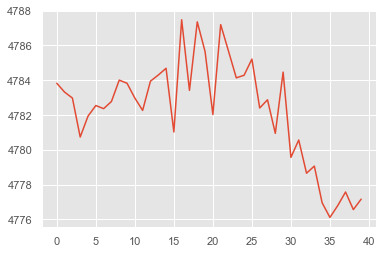

no_event no_event 2


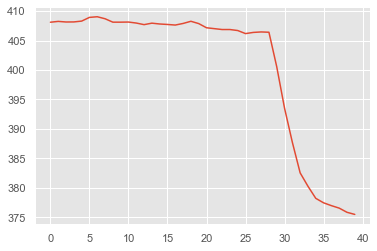

no_event no_event 1


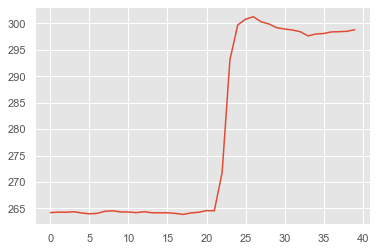

no_event no_event 2


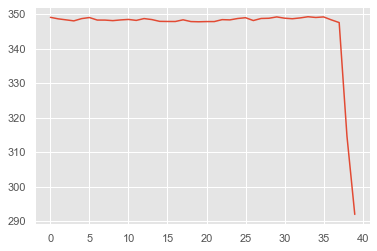

no_event no_event 1


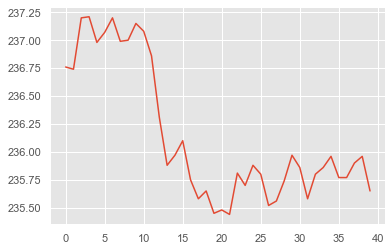

no_event no_event 1


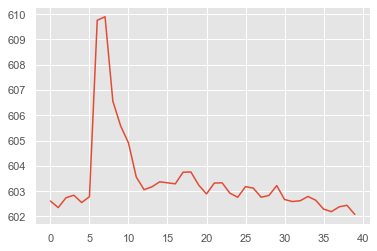

no_event no_event 1


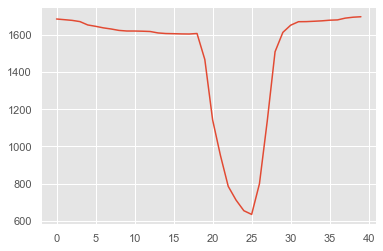

no_event Refrigerator_ON 1


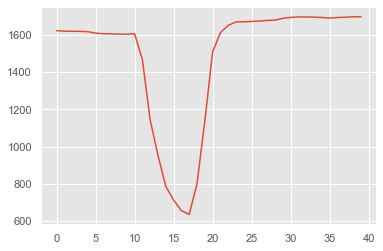

no_event no_event 2


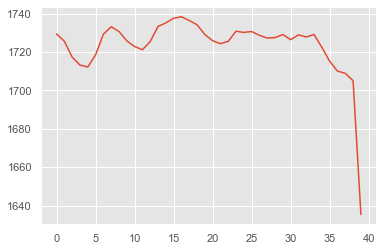

no_event no_event 1


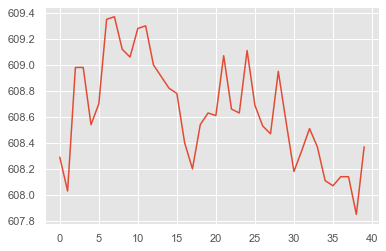

no_event no_event 2


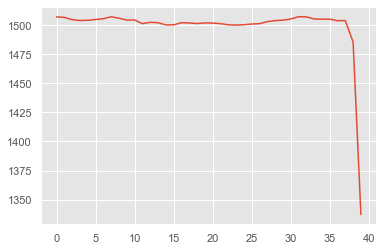

no_event no_event 1


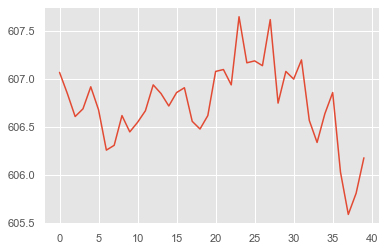

no_event no_event 1


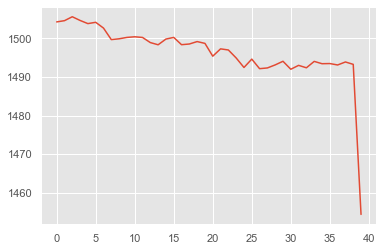

no_event no_event 1


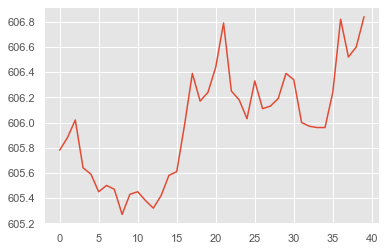

no_event no_event 2


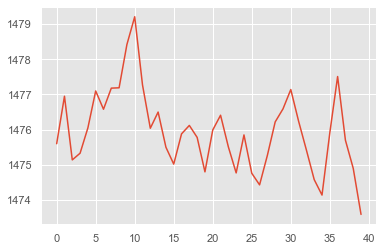

no_event no_event 2


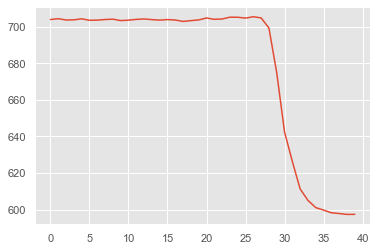

no_event no_event 2


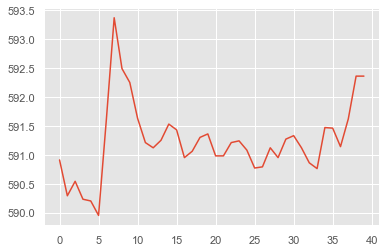

no_event no_event 1


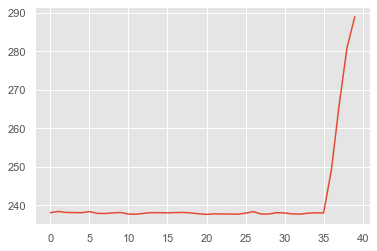

no_event no_event 1


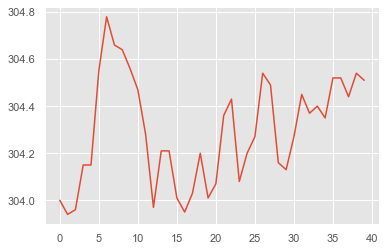

no_event no_event 1


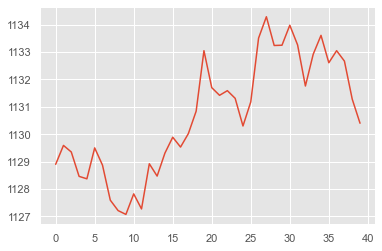

no_event no_event 1


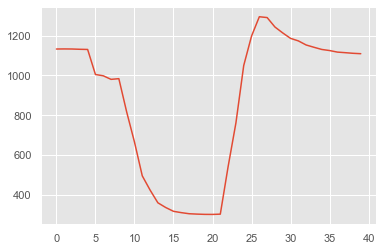

no_event no_event 2


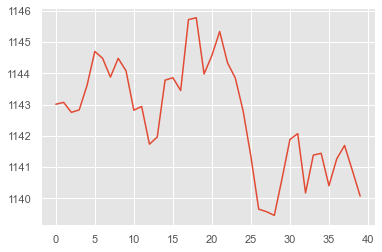

no_event no_event 1


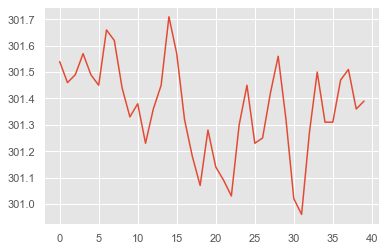

no_event no_event 2


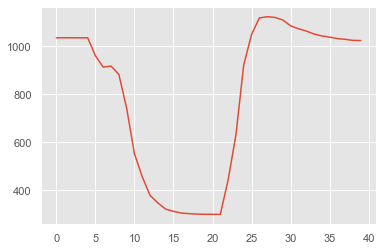

no_event no_event 2


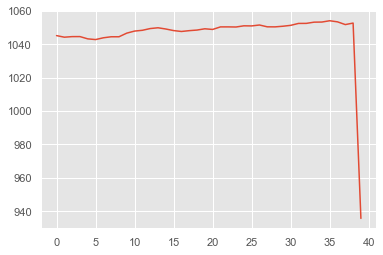

no_event no_event 1


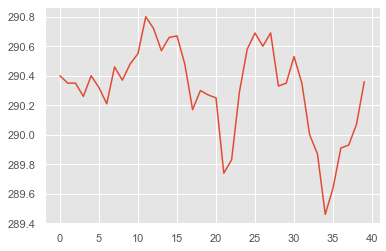

no_event no_event 2


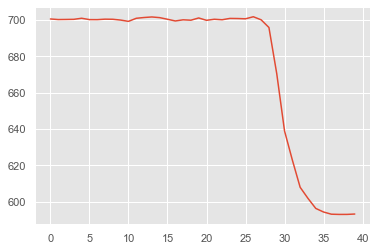

no_event no_event 1


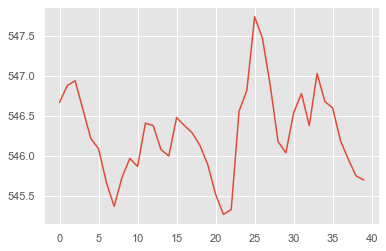

no_event no_event 2


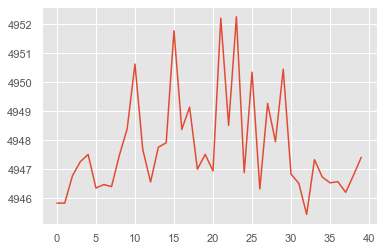

no_event no_event 2


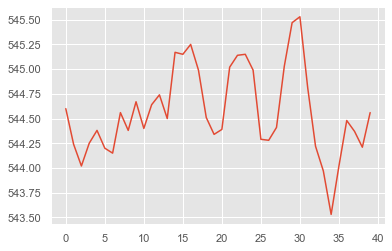

no_event no_event 1


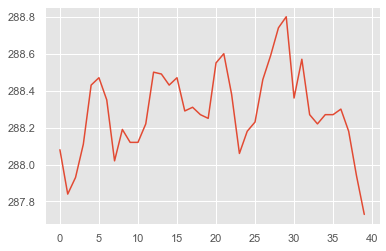

no_event no_event 1


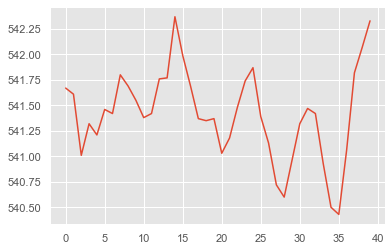

no_event no_event 2


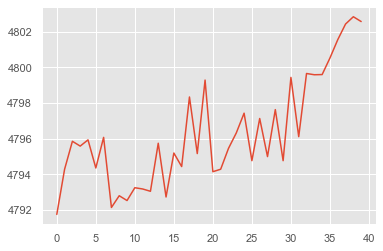

no_event no_event 2


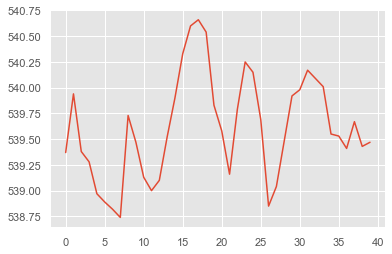

no_event no_event 1


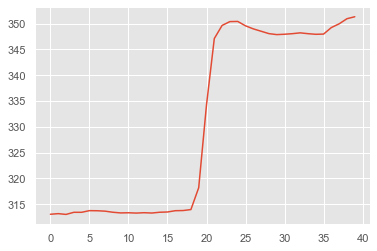

no_event no_event 2


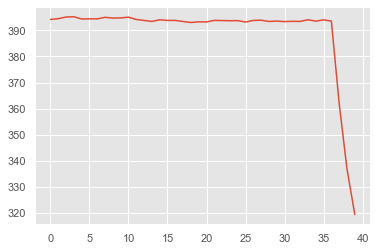

no_event no_event 1


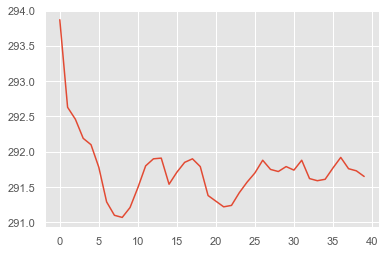

no_event no_event 2


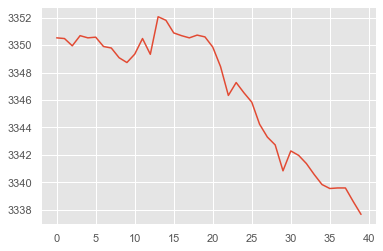

no_event no_event 1


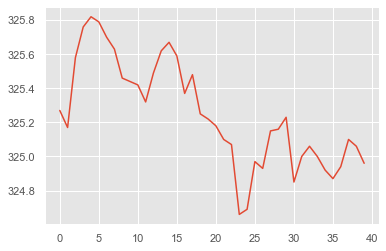

no_event no_event 2


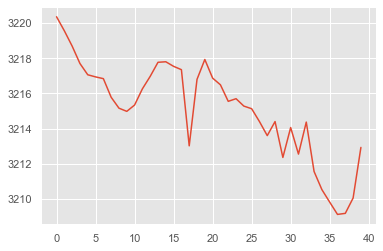

no_event no_event 2


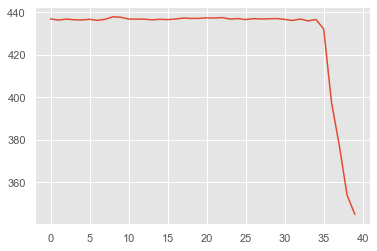

no_event no_event 1


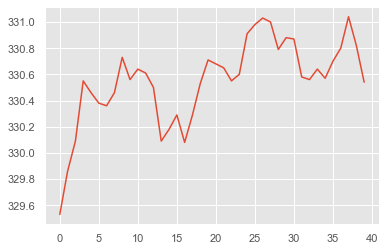

no_event no_event 1


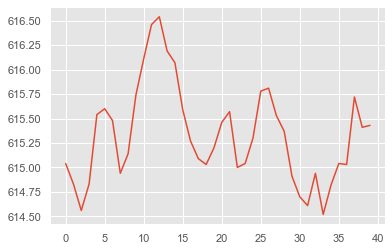

no_event no_event 2


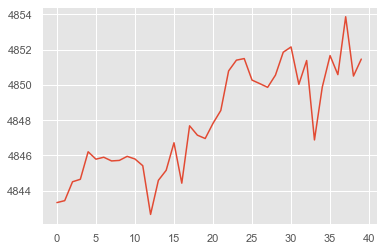

no_event no_event 2


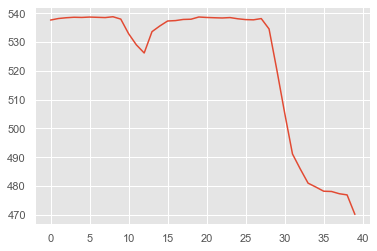

no_event no_event 1


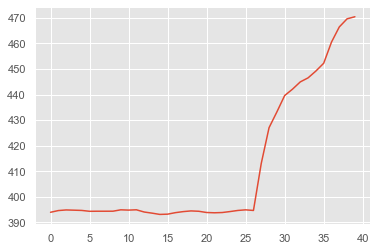

no_event no_event 2


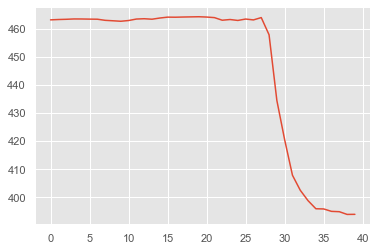

no_event no_event 2


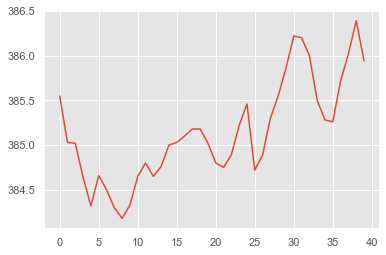

no_event no_event 1


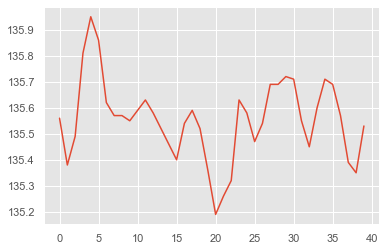

no_event Refrigerator_OFF 2


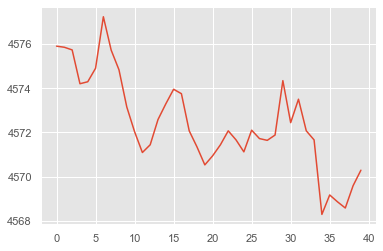

no_event no_event 1


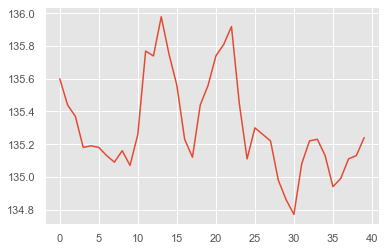

no_event no_event 2


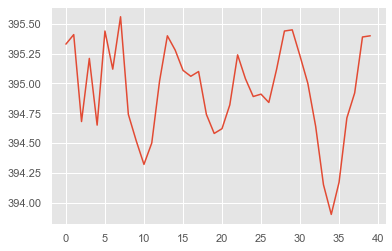

no_event no_event 1


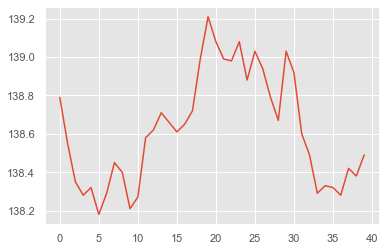

no_event no_event 2


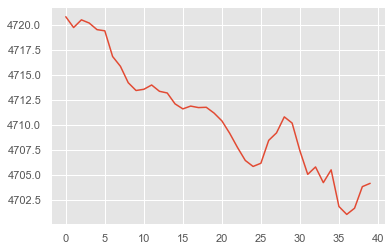

no_event no_event 1


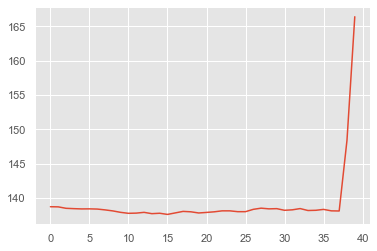

no_event no_event 1


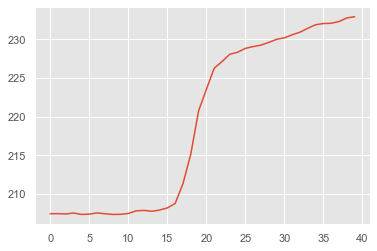

no_event no_event 1


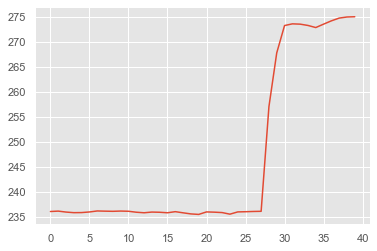

no_event no_event 2


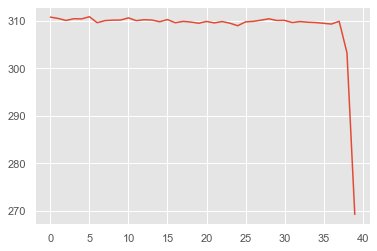

no_event no_event 1


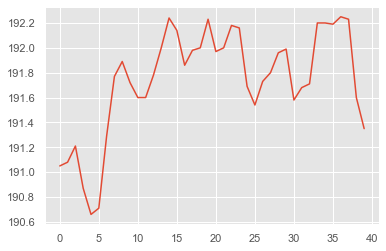

no_event no_event 2


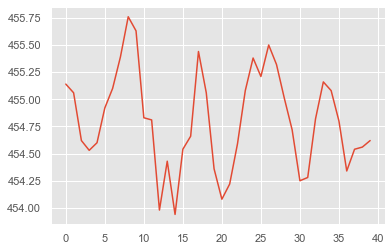

no_event no_event 1


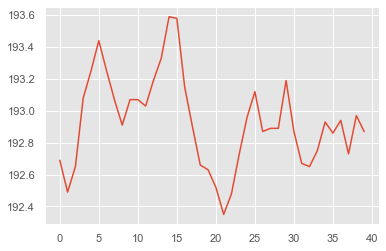

no_event no_event 2


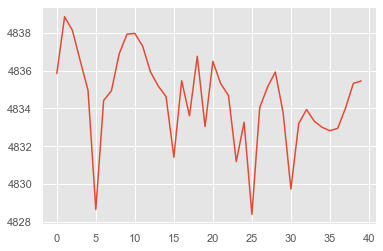

no_event Refrigerator_ON 1


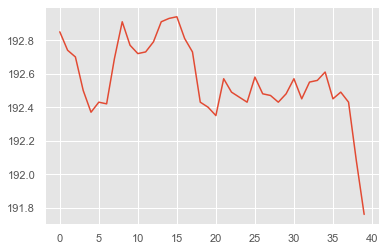

no_event no_event 1


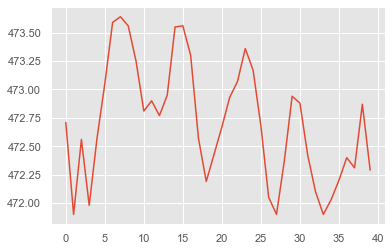

no_event no_event 2


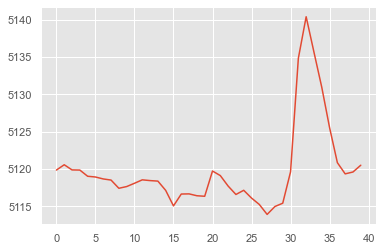

no_event no_event 2


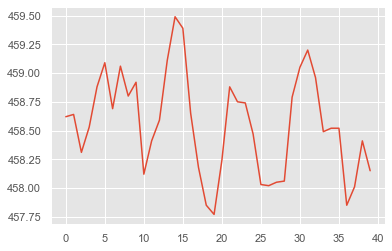

no_event no_event 1


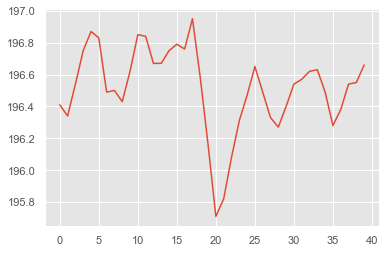

no_event no_event 2


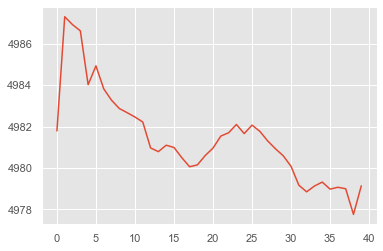

no_event no_event 1


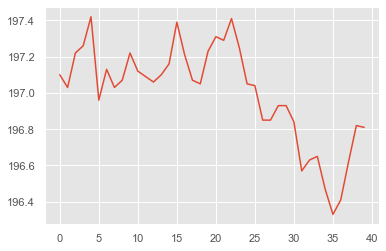

no_event no_event 2


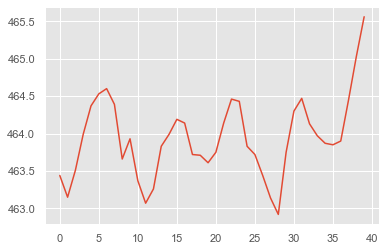

no_event no_event 2


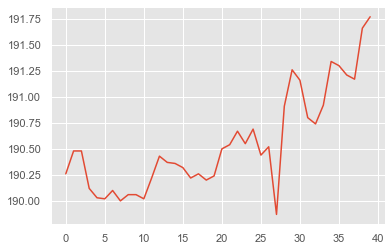

no_event Refrigerator_ON 1


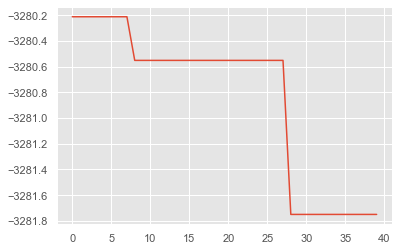

no_event no_event 1


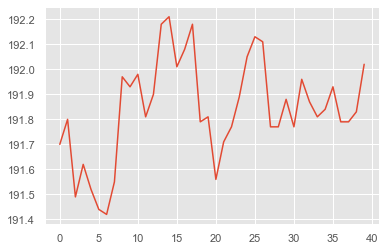

no_event no_event 2


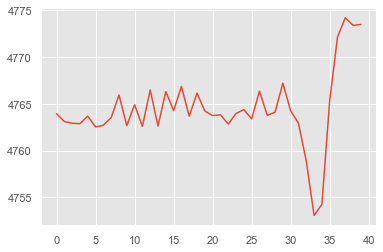

no_event no_event 1


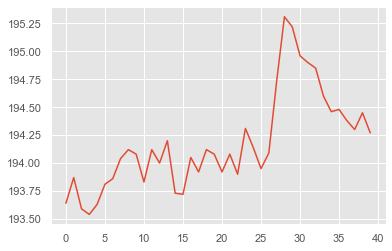

no_event no_event 2


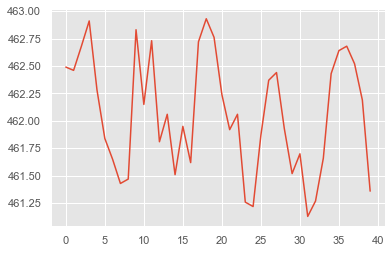

no_event no_event 1


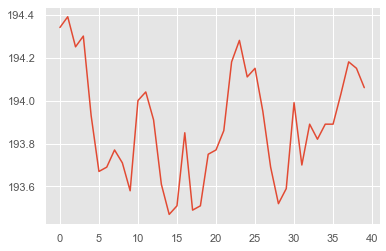

no_event no_event 2


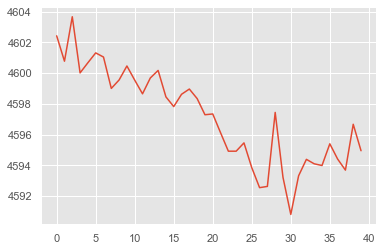

no_event no_event 2


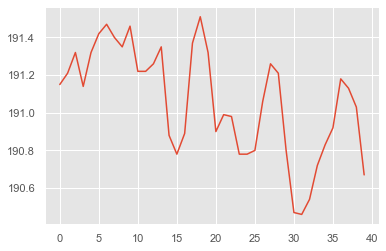

no_event no_event 1


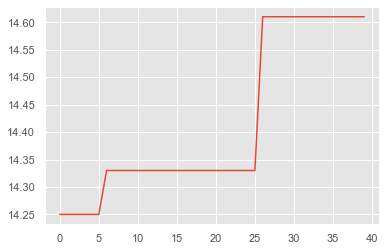

no_event no_event 1


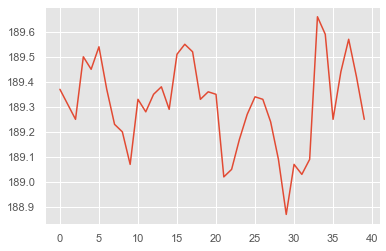

no_event no_event 1


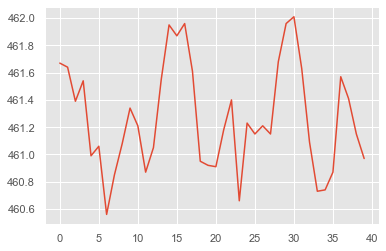

no_event no_event 2


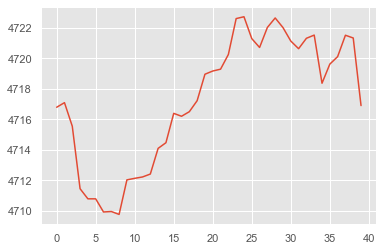

no_event no_event 2


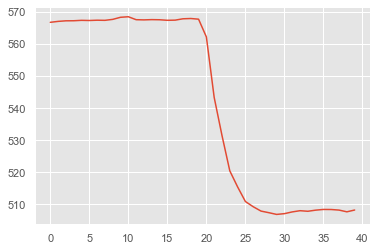

no_event no_event 1


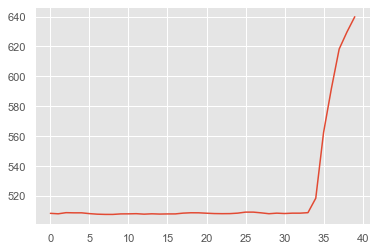

Refrigerator_OFF no_event 2


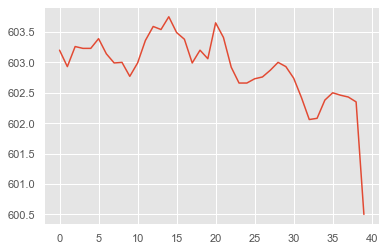

no_event no_event 2


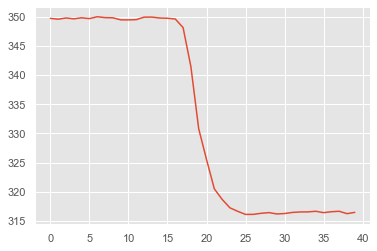

no_event no_event 2


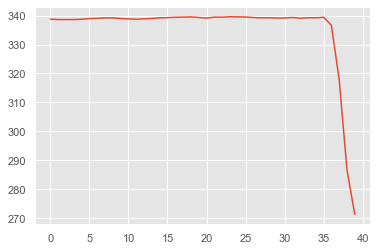

no_event no_event 1


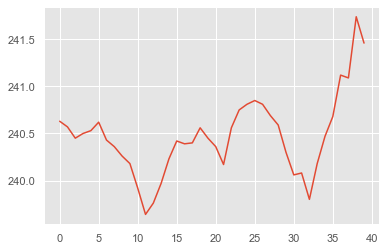

no_event no_event 2


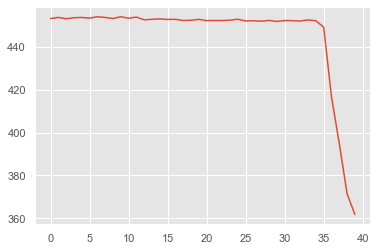

no_event no_event 2


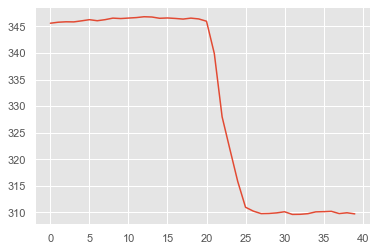

no_event no_event 2


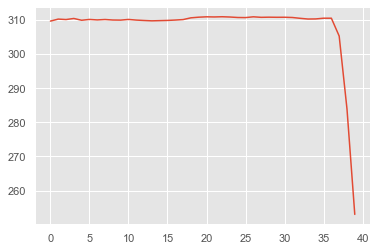

no_event no_event 2


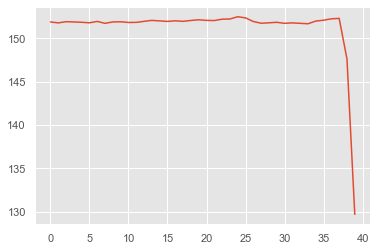

no_event no_event 2


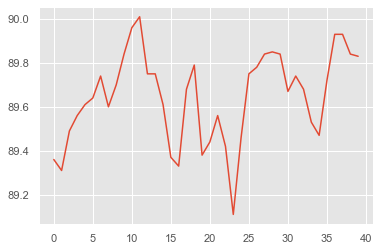

no_event no_event 1


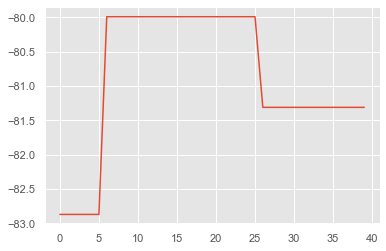

no_event no_event 1


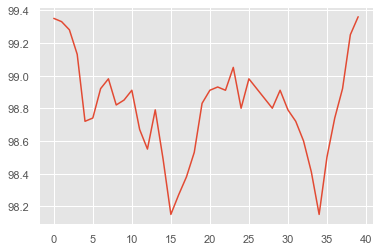

no_event no_event 1


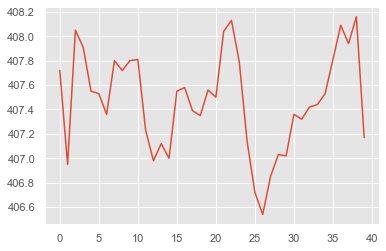

no_event no_event 2


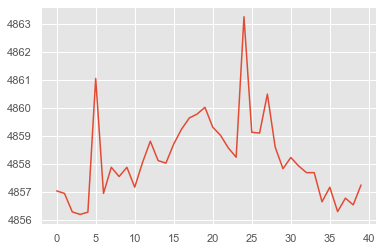

no_event no_event 1


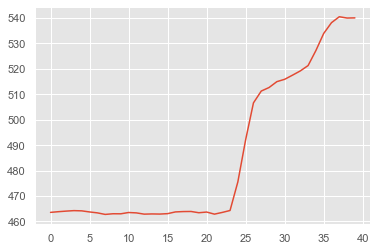

no_event no_event 1


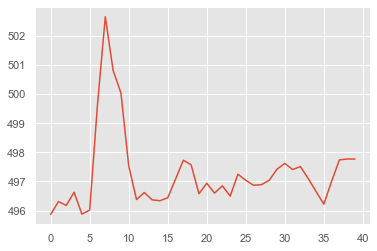

no_event Refrigerator_ON 2


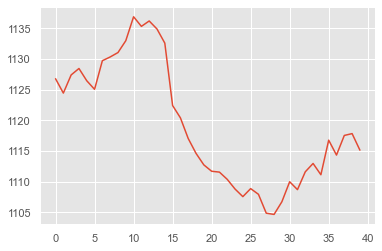

no_event no_event 2


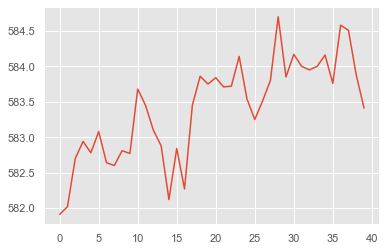

no_event Geyser_ON 1


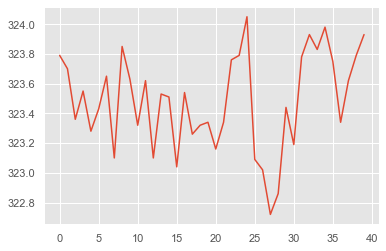

no_event no_event 2


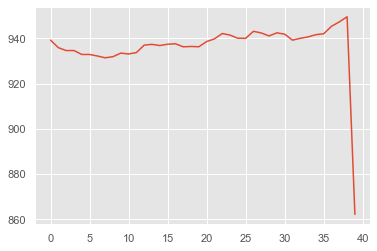

no_event no_event 2


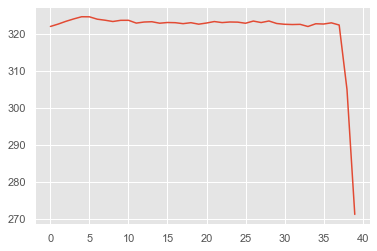

no_event Refrigerator_ON 1


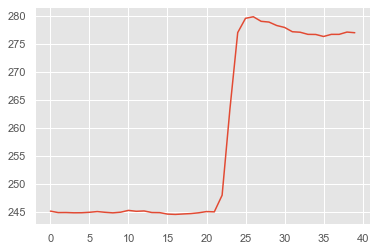

no_event no_event 2


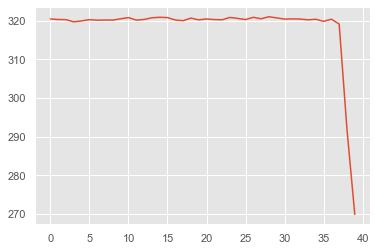

no_event no_event 2


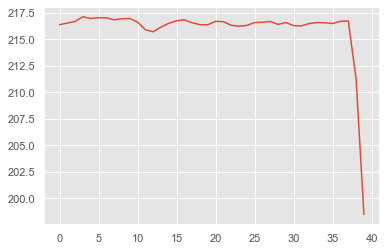

no_event no_event 1


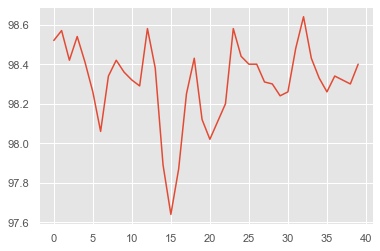

no_event no_event 2


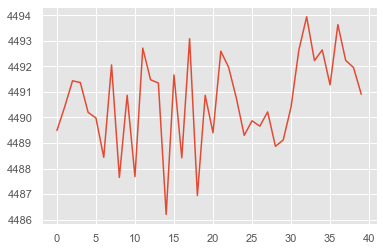

no_event no_event 1


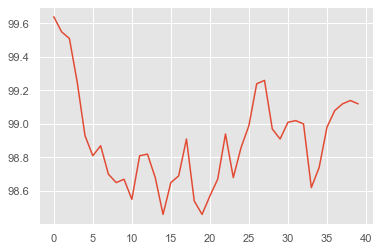

no_event no_event 2


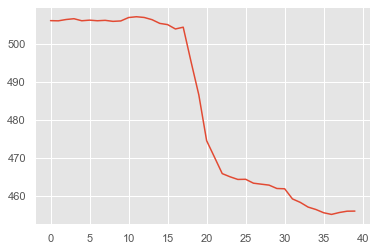

no_event no_event 2


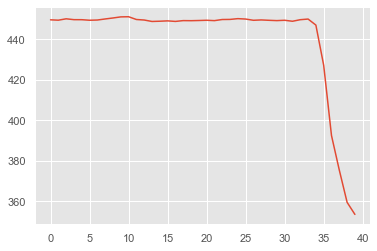

no_event no_event 2


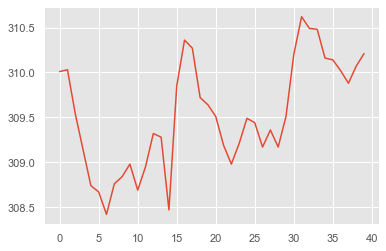

no_event no_event 1


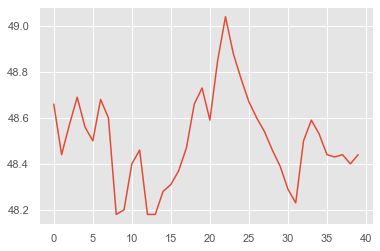

no_event no_event 2


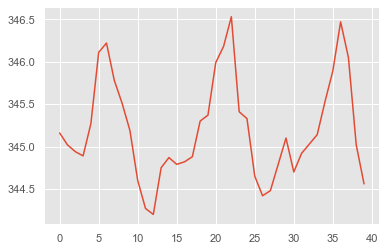

no_event Geyser_OFF 1


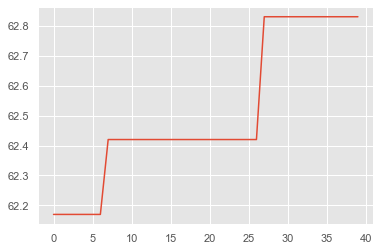

no_event no_event 2


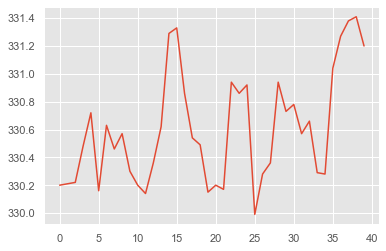

no_event no_event 1


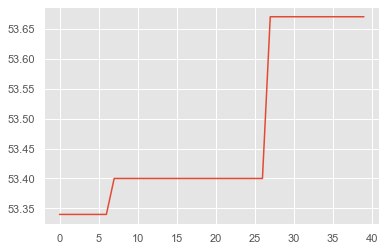

no_event no_event 2


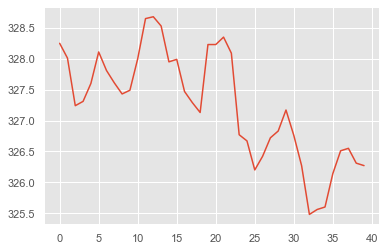

no_event no_event 1


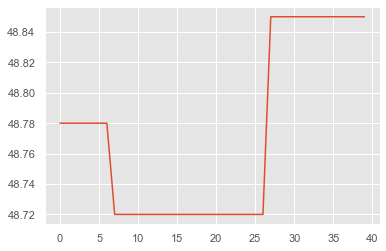

no_event no_event 2


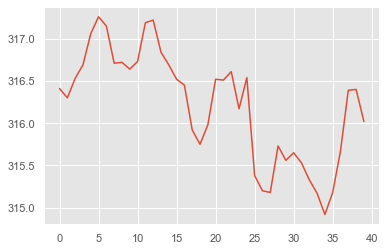

no_event no_event 1


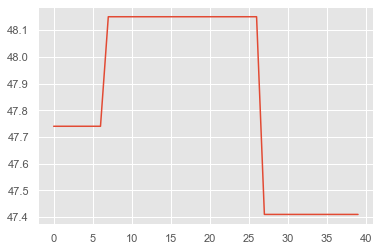

no_event no_event 2


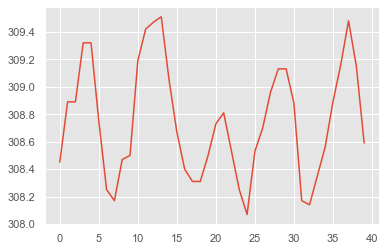

no_event no_event 2


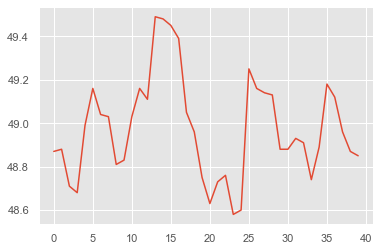

no_event no_event 1


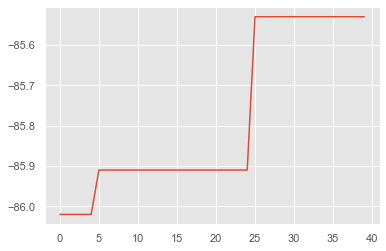

no_event no_event 2


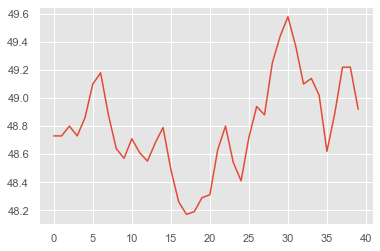

no_event no_event 1


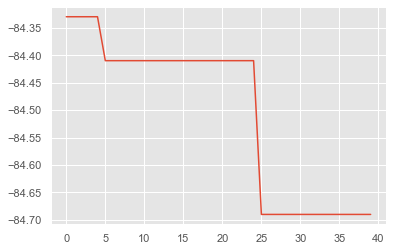

no_event no_event 2


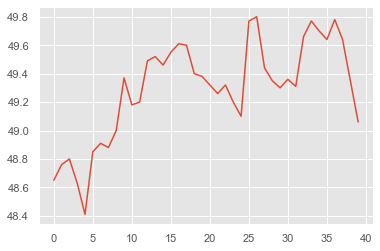

no_event no_event 1


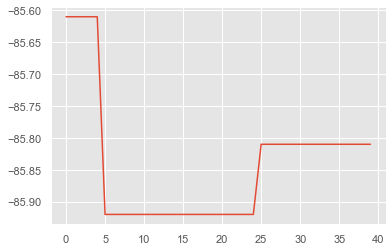

no_event no_event 2


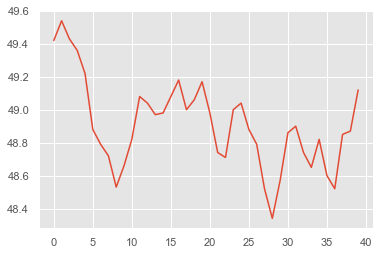

no_event no_event 1


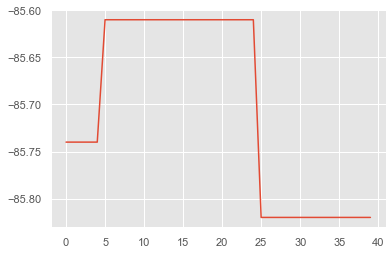

no_event no_event 2


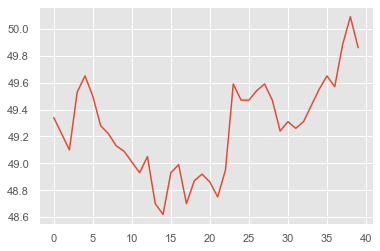

no_event no_event 1


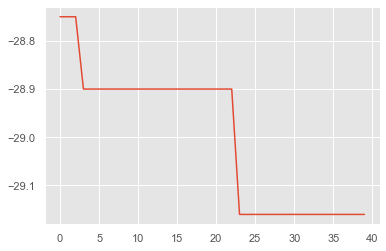

no_event no_event 1


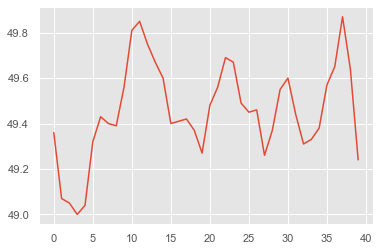

no_event no_event 2


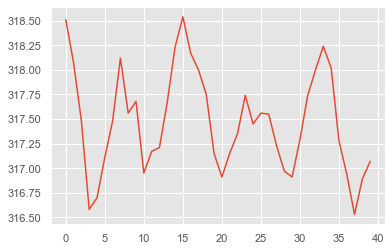

no_event no_event 1


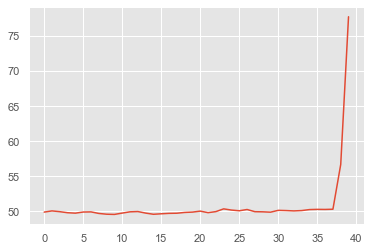

no_event no_event 1


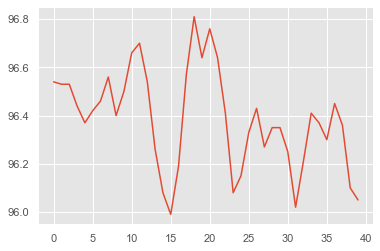

no_event no_event 1


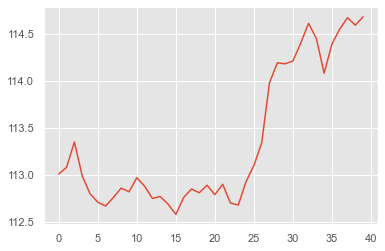

no_event no_event 1


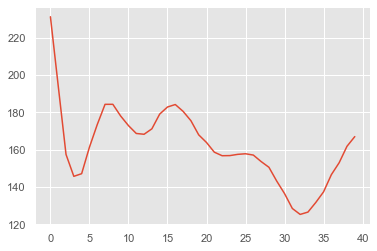

no_event no_event 2


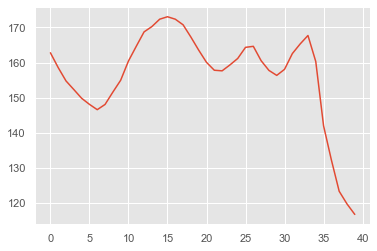

no_event no_event 1


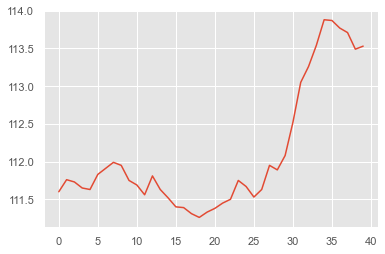

no_event no_event 2


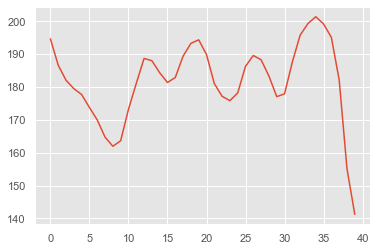

no_event no_event 1


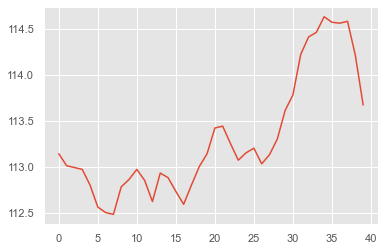

no_event no_event 1


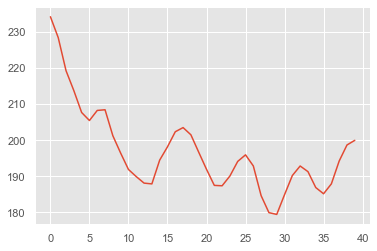

no_event no_event 2


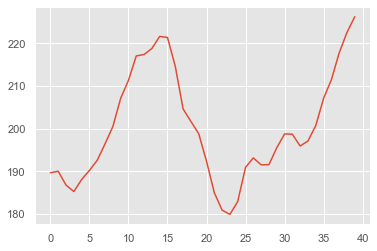

no_event no_event 1


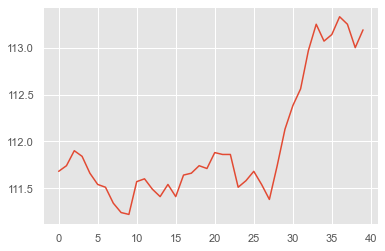

no_event no_event 2


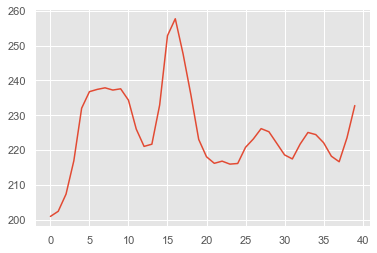

no_event no_event 1


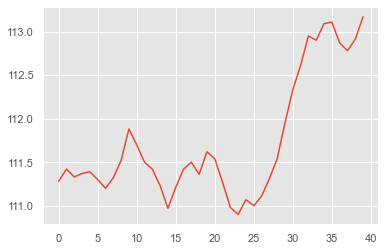

no_event no_event 2


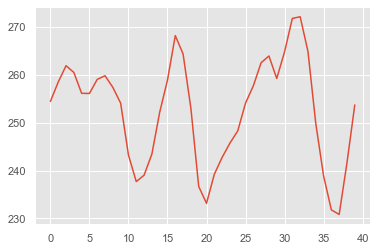

no_event no_event 1


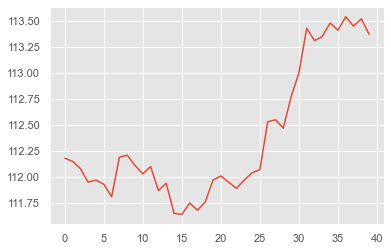

no_event no_event 1


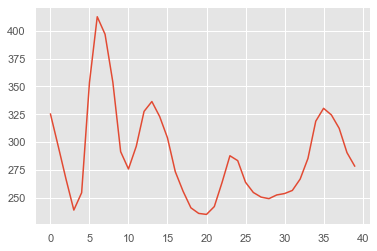

no_event no_event 2


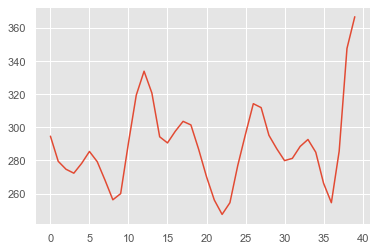

no_event no_event 1


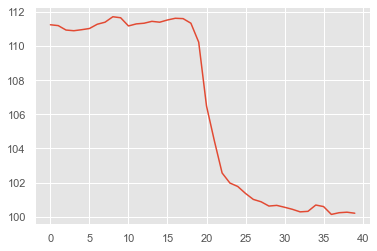

no_event no_event 1


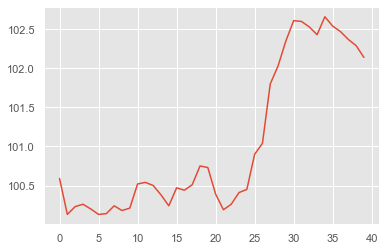

no_event no_event 2


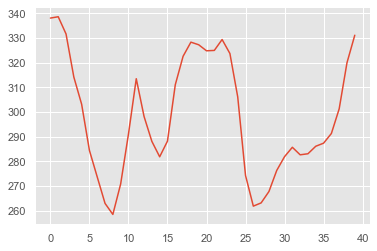

no_event no_event 1


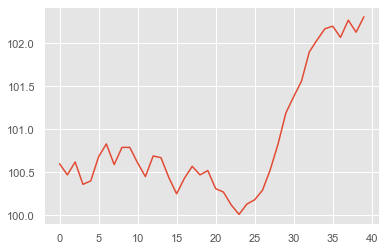

no_event no_event 2


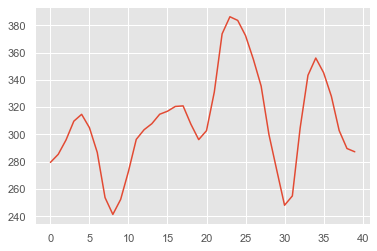

no_event no_event 1


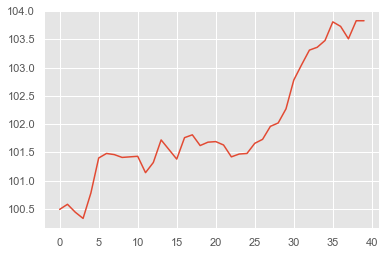

no_event no_event 2


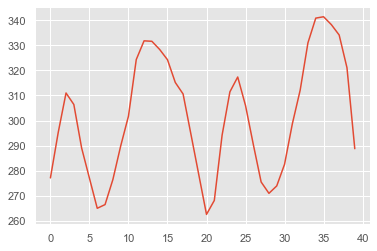

no_event no_event 1


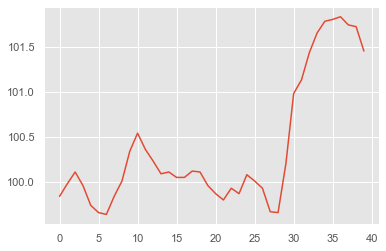

no_event no_event 2


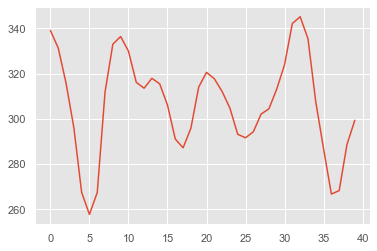

no_event no_event 1


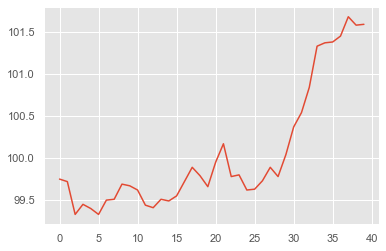

no_event no_event 1


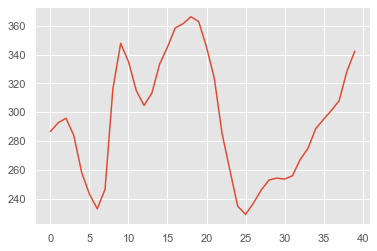

no_event no_event 2


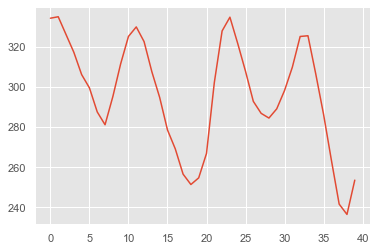

no_event no_event 1


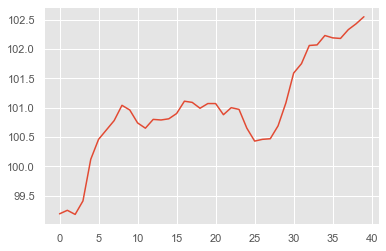

no_event no_event 2


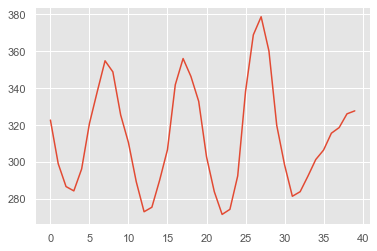

no_event no_event 1


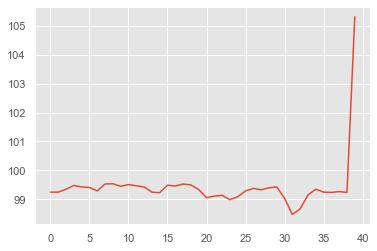

no_event no_event 1


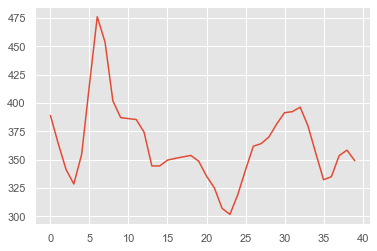

no_event no_event 1


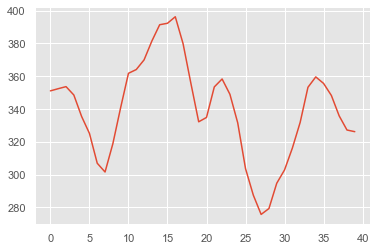

no_event no_event 2


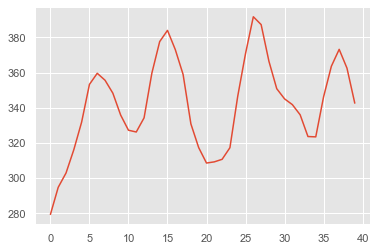

no_event no_event 2


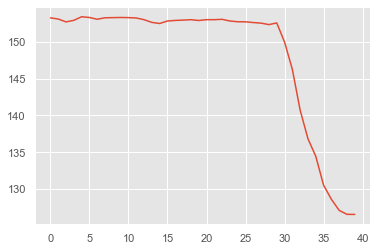

no_event no_event 2


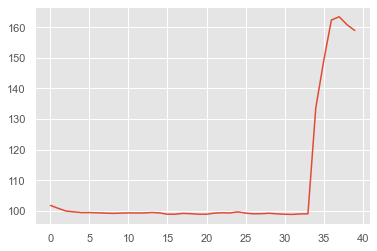

no_event no_event 1


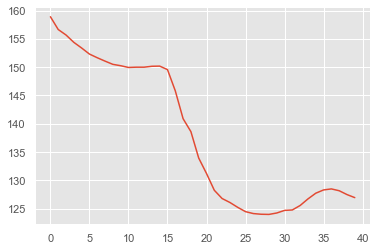

no_event no_event 1


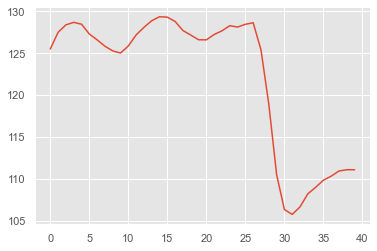

no_event no_event 1


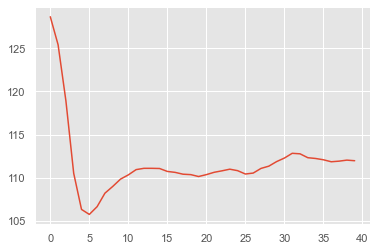

no_event no_event 2


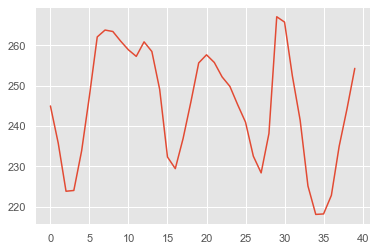

no_event no_event 2


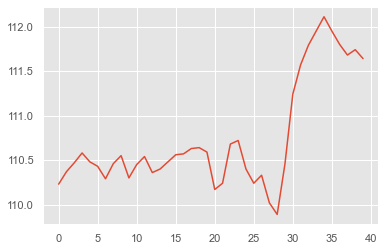

no_event no_event 2


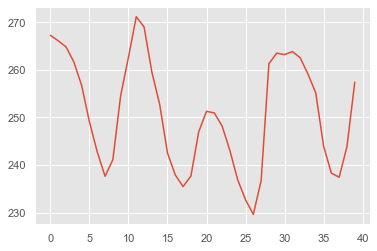

no_event no_event 2


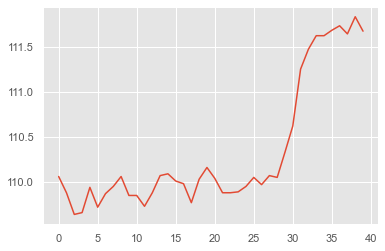

no_event no_event 2


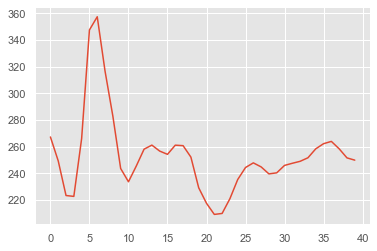

no_event no_event 2


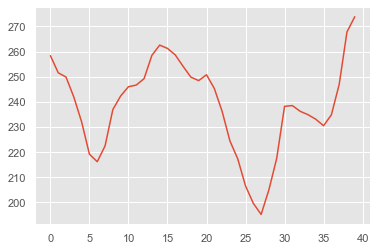

no_event no_event 2


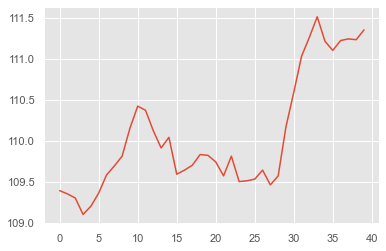

no_event no_event 2


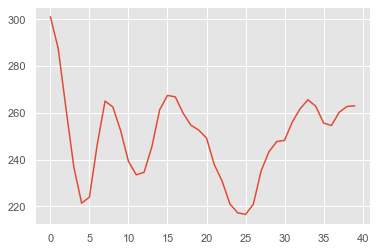

no_event no_event 2


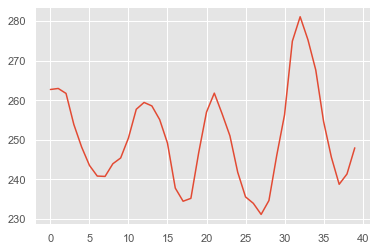

no_event no_event 2


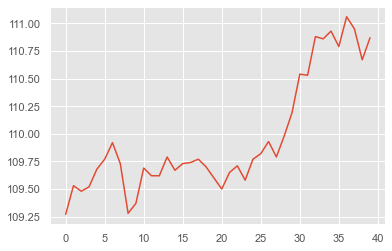

no_event no_event 2


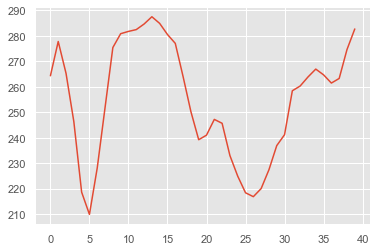

no_event no_event 2


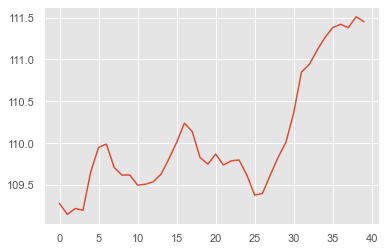

no_event no_event 2


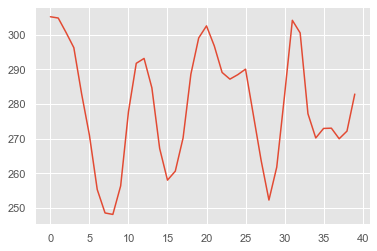

no_event no_event 2


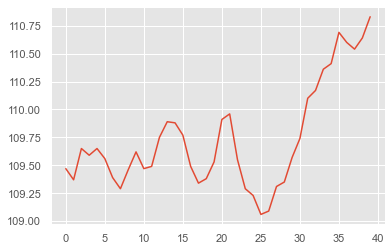

no_event no_event 1


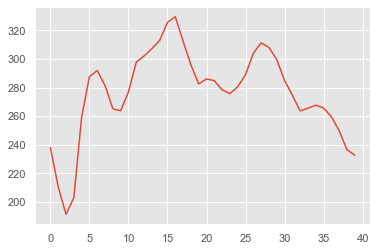

no_event no_event 2


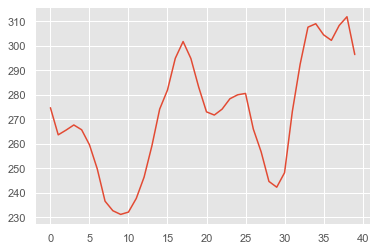

no_event no_event 2


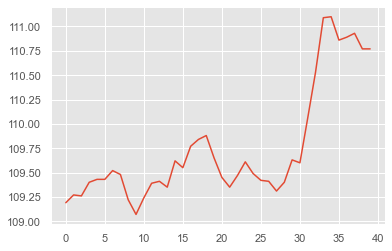

no_event no_event 2


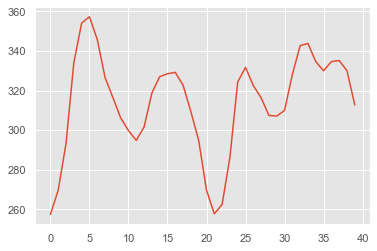

no_event no_event 2


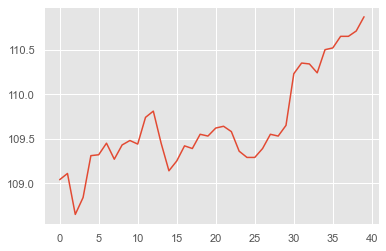

no_event no_event 2


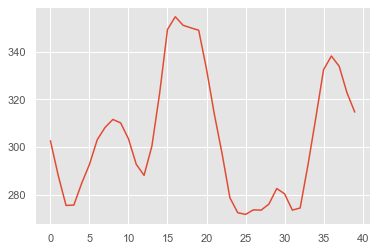

no_event no_event 2


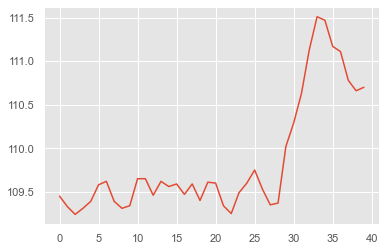

no_event no_event 2


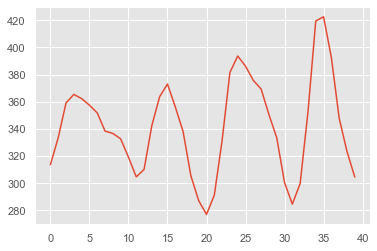

no_event no_event 2


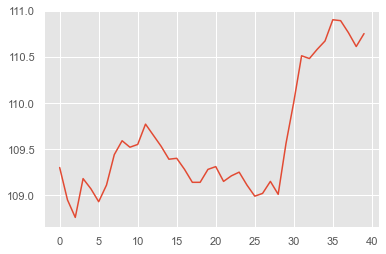

no_event no_event 1


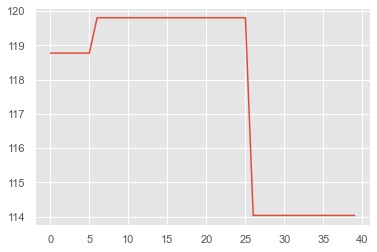

no_event no_event 1


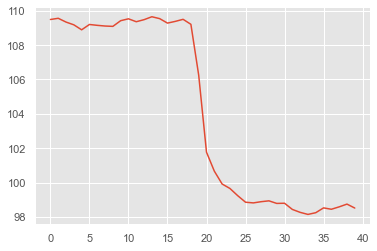

no_event no_event 1


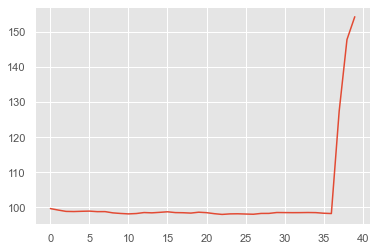

no_event no_event 2


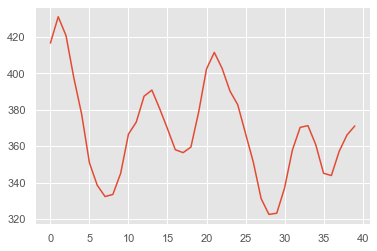

no_event no_event 2


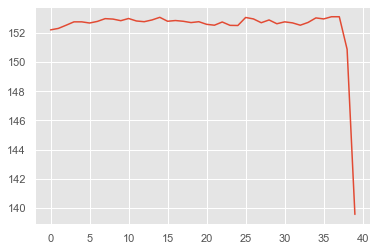

no_event no_event 2


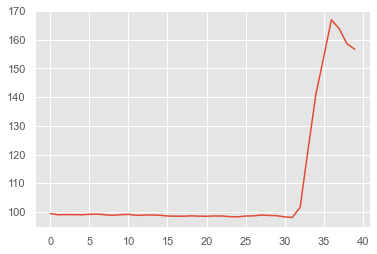

no_event no_event 1


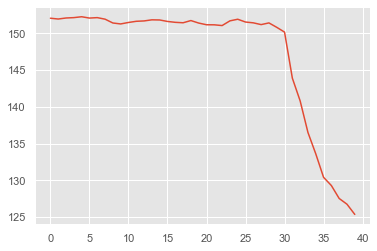

no_event no_event 1


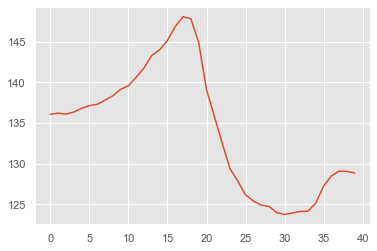

no_event no_event 2


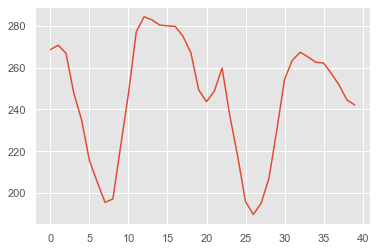

no_event no_event 2


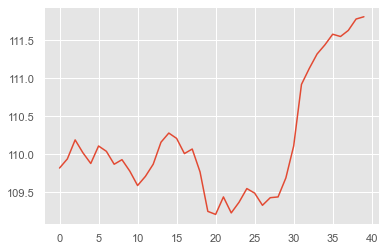

no_event no_event 2


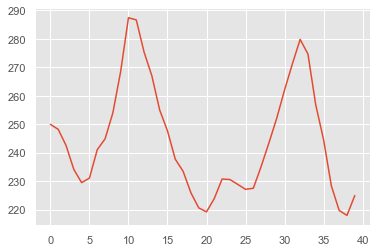

no_event no_event 2


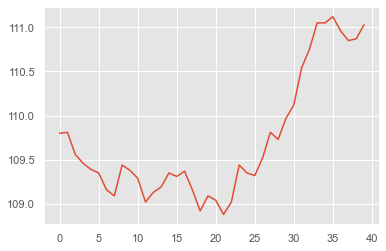

no_event no_event 2


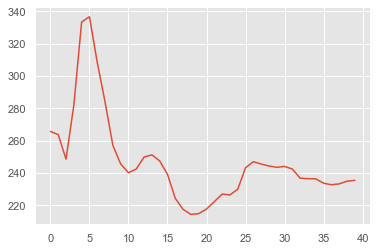

no_event no_event 2


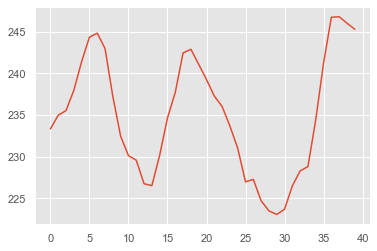

no_event no_event 2


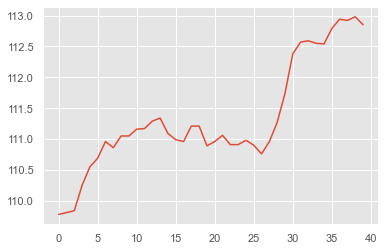

no_event no_event 2


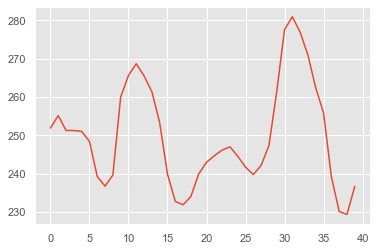

no_event no_event 2


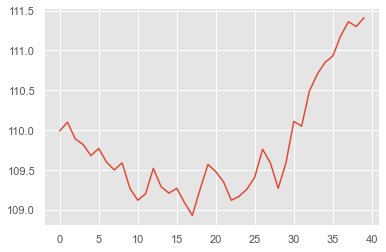

no_event no_event 2


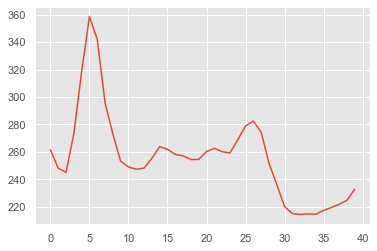

no_event no_event 2


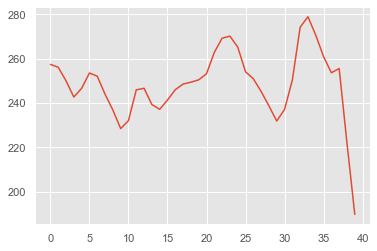

no_event no_event 2


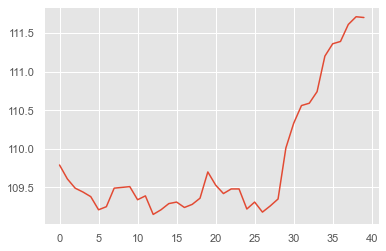

no_event no_event 2


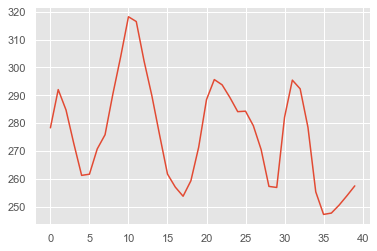

no_event no_event 2


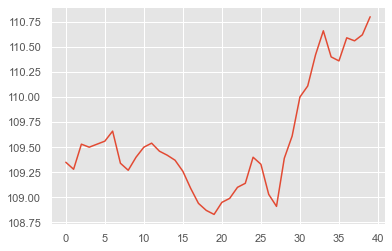

no_event no_event 2


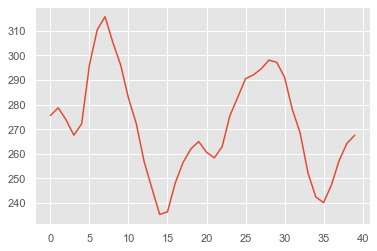

no_event no_event 2


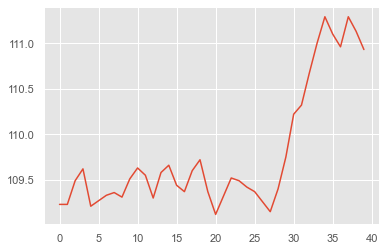

no_event no_event 2


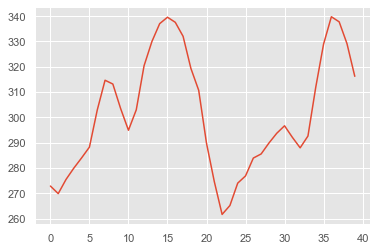

no_event no_event 2


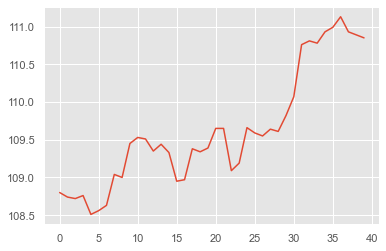

no_event no_event 2


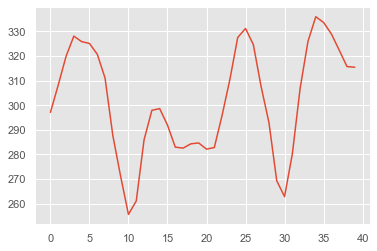

no_event no_event 2


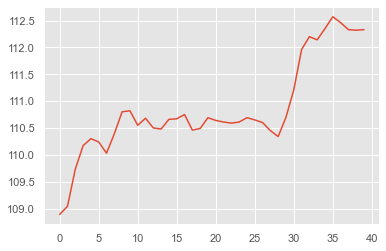

no_event no_event 2


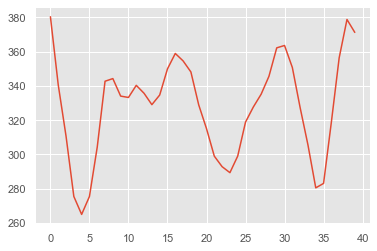

no_event no_event 2


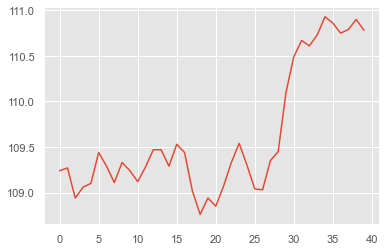

no_event no_event 2


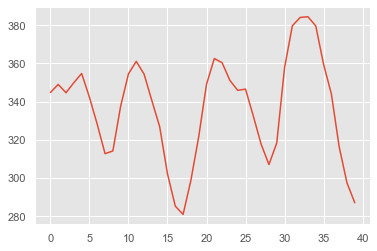

no_event no_event 2


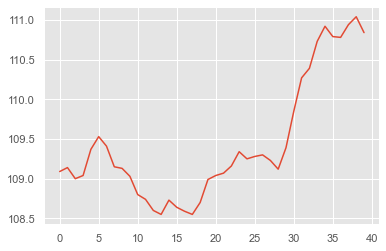

no_event no_event 2


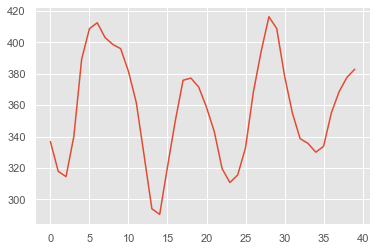

no_event no_event 1


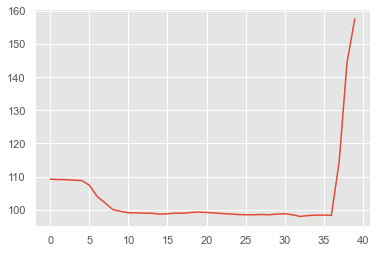

no_event no_event 2


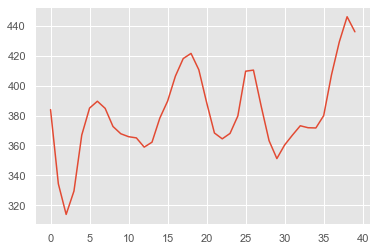

no_event no_event 2


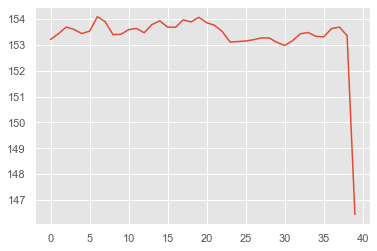

no_event no_event 2


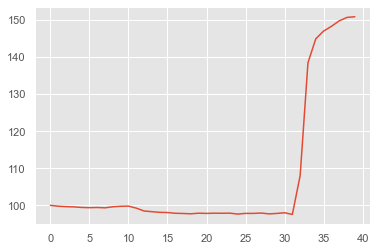

no_event no_event 1


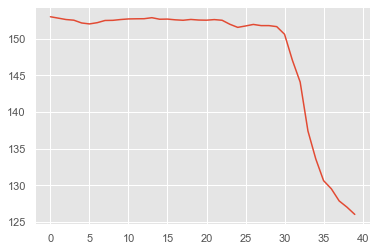

no_event no_event 1


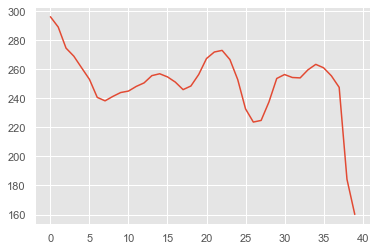

no_event no_event 2


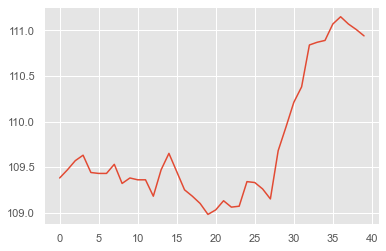

no_event no_event 2


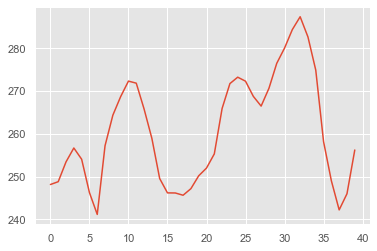

no_event no_event 2


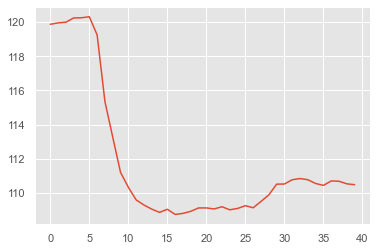

no_event no_event 1


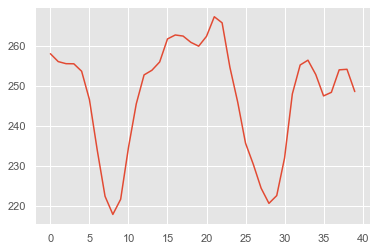

no_event no_event 2


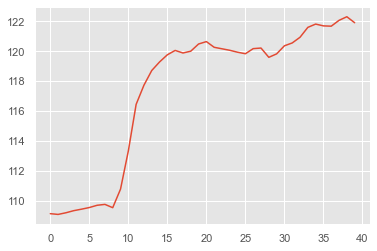

no_event no_event 2


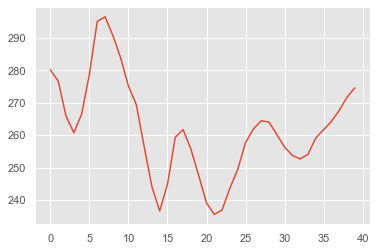

no_event no_event 2


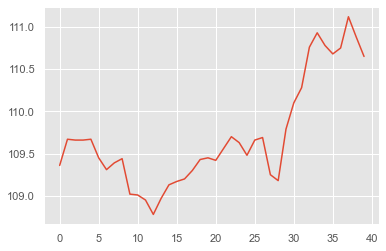

no_event no_event 1


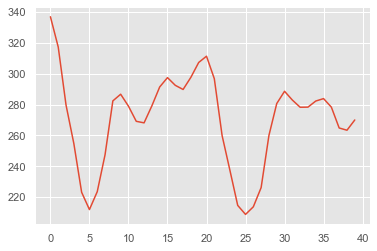

no_event no_event 2


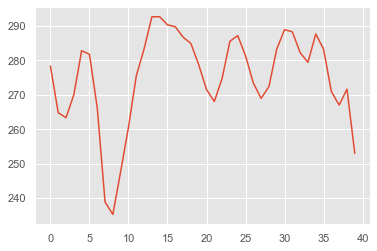

no_event no_event 2


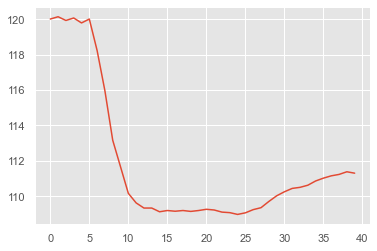

no_event no_event 2


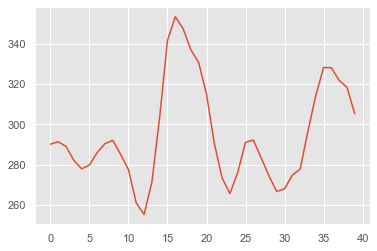

no_event no_event 2


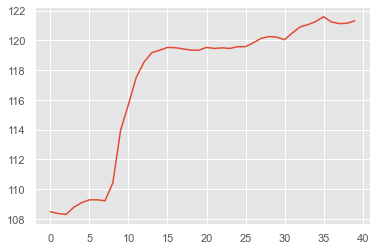

no_event no_event 2


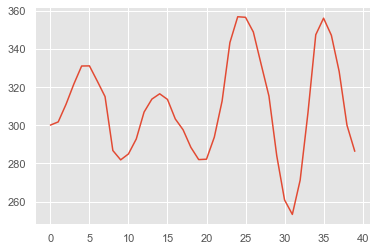

no_event no_event 2


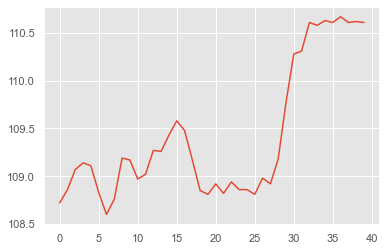

no_event no_event 1


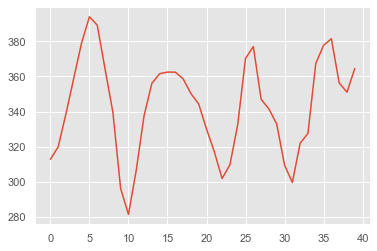

no_event no_event 1


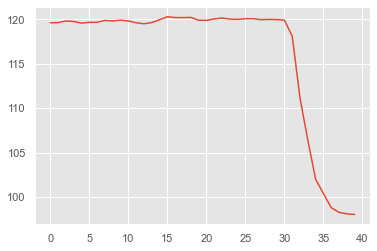

no_event no_event 1


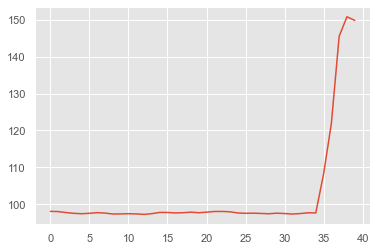

no_event no_event 2


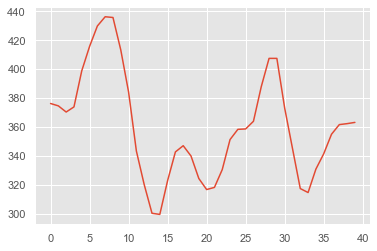

no_event no_event 2


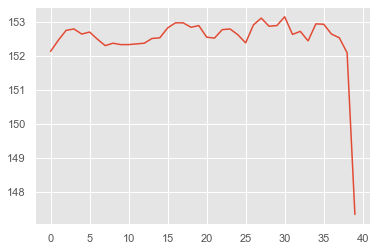

no_event no_event 2


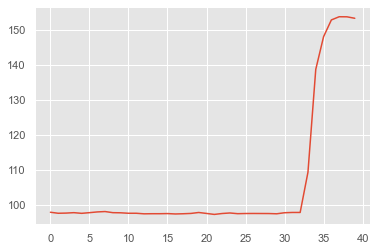

no_event no_event 1


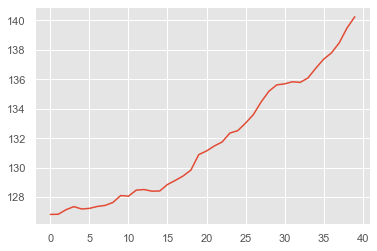

no_event no_event 1


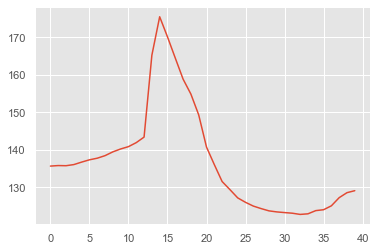

no_event no_event 1


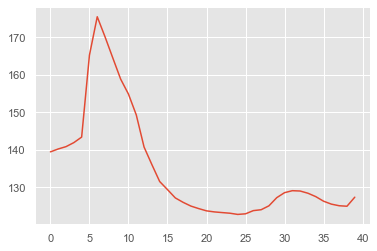

no_event no_event 1


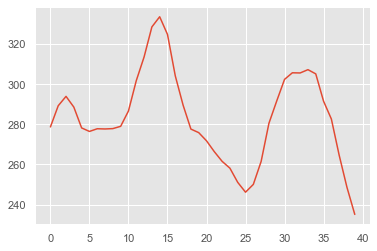

no_event no_event 2


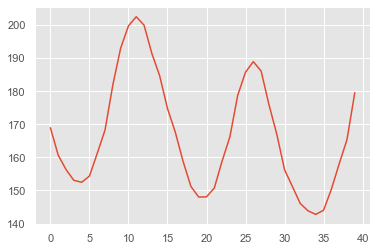

no_event no_event 2


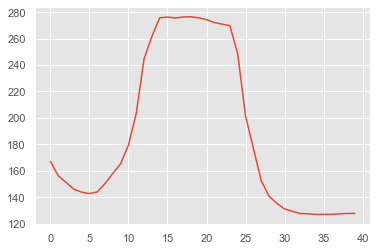

no_event no_event 1


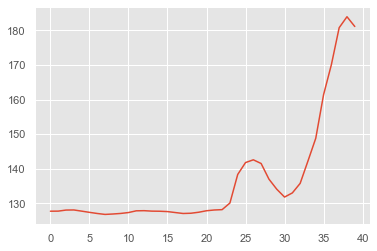

no_event no_event 2


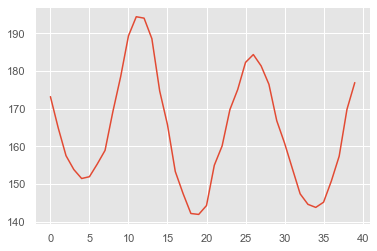

no_event no_event 2


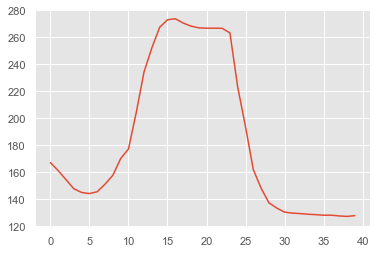

no_event no_event 1


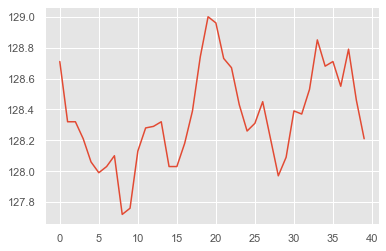

no_event no_event 2


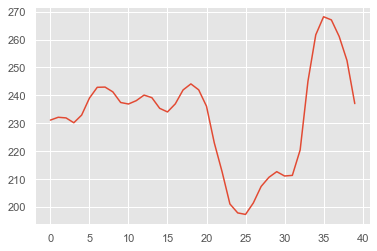

no_event no_event 2


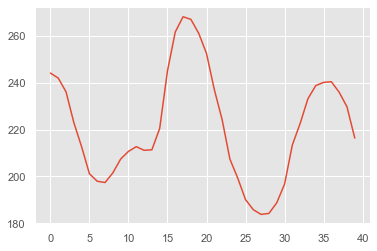

no_event no_event 2


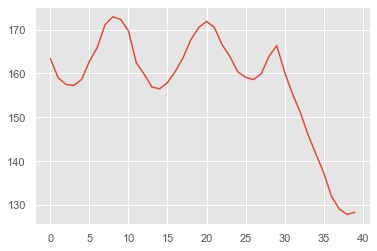

no_event no_event 1


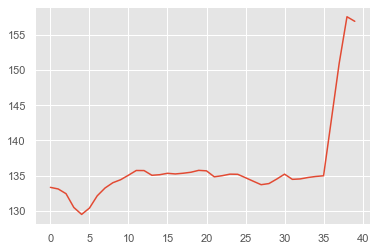

no_event no_event 1


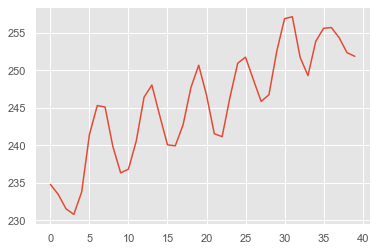

no_event no_event 2


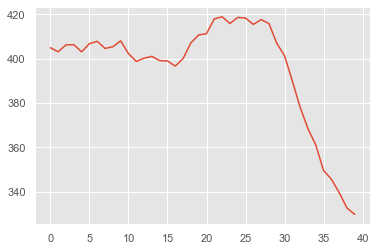

no_event no_event 1


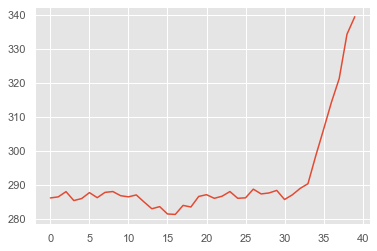

no_event no_event 2


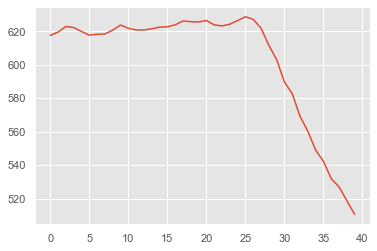

no_event no_event 2


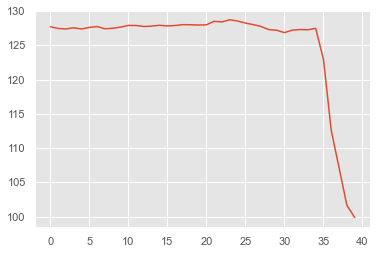

no_event no_event 1


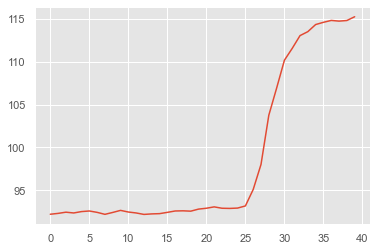

no_event no_event 1


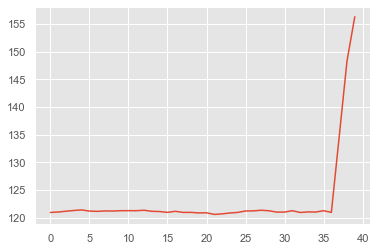

no_event no_event 2


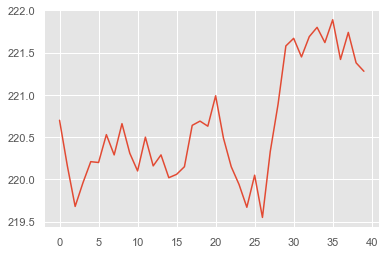

no_event no_event 1


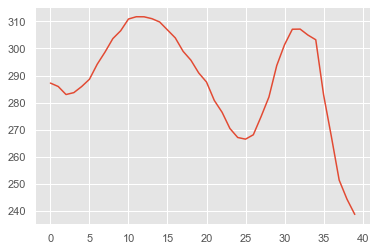

no_event no_event 2


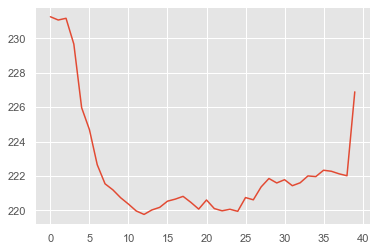

no_event no_event 1


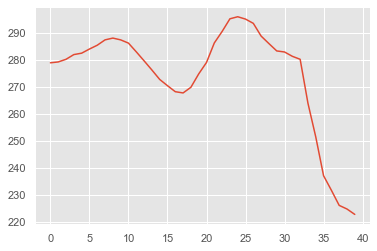

no_event no_event 2


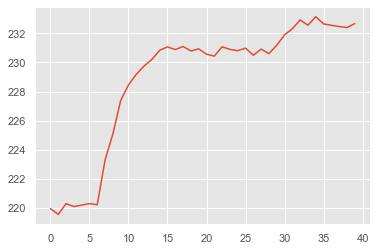

no_event no_event 2


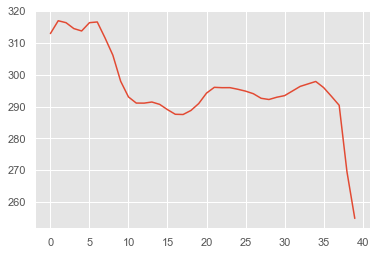

no_event no_event 1


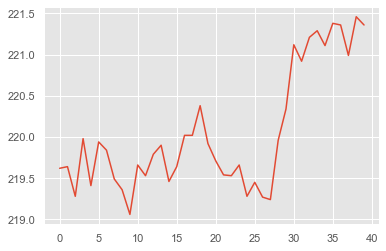

no_event no_event 1


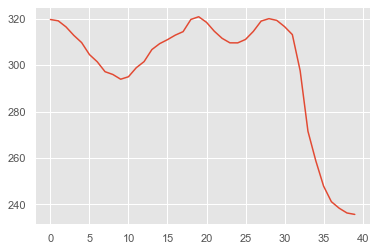

no_event no_event 2


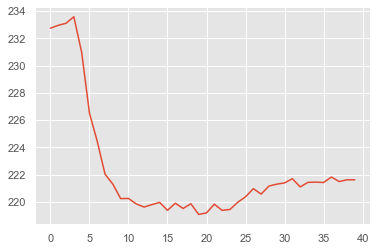

no_event no_event 1


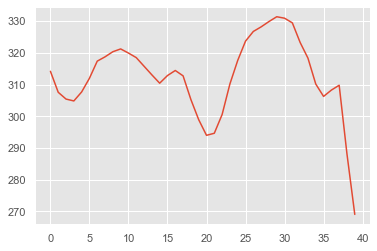

no_event no_event 2


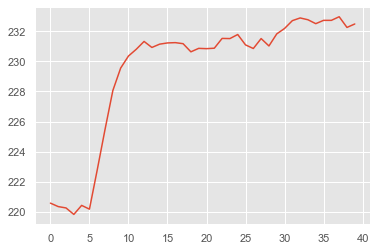

no_event no_event 1


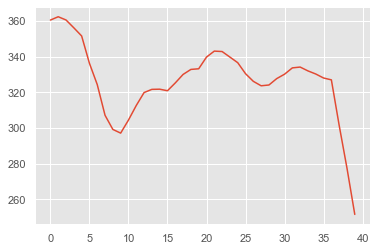

no_event no_event 2


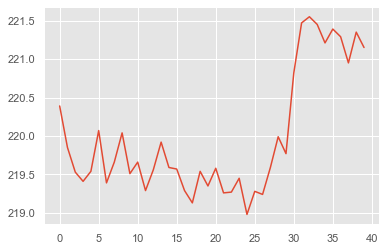

no_event no_event 2


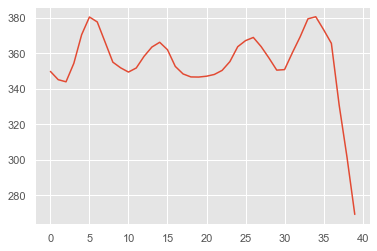

no_event no_event 2


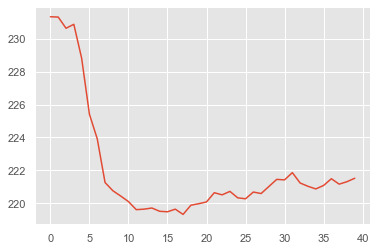

no_event no_event 1


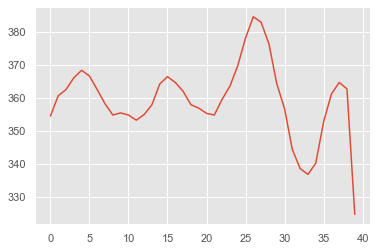

no_event no_event 2


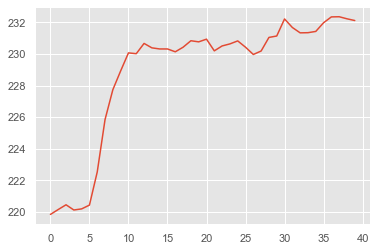

no_event no_event 2


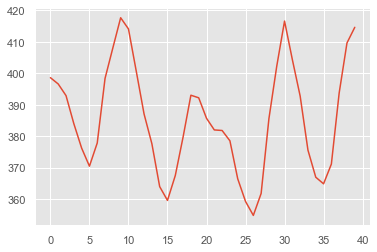

no_event no_event 2


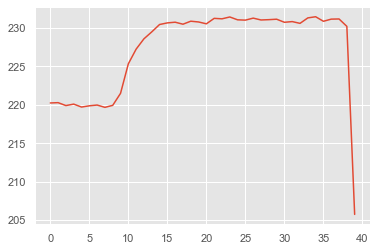

no_event no_event 1


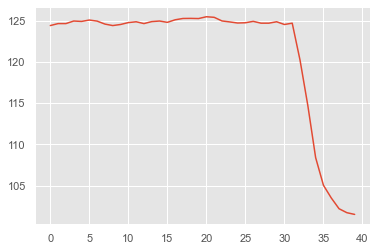

no_event no_event 1


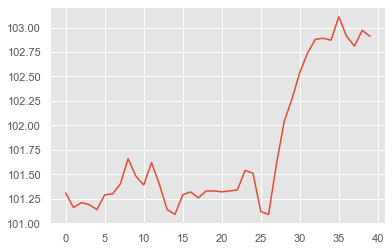

no_event no_event 2


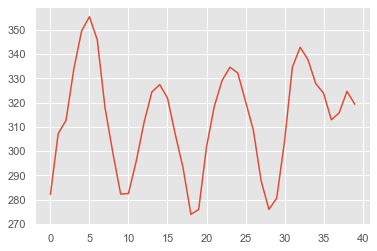

no_event no_event 1


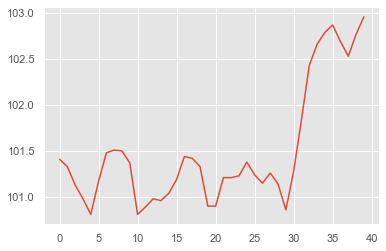

no_event no_event 2


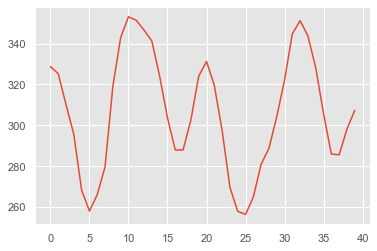

no_event no_event 1


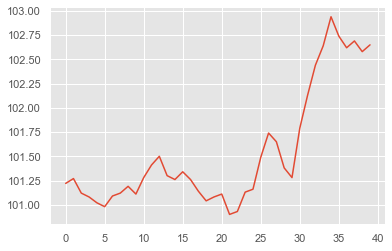

no_event no_event 2


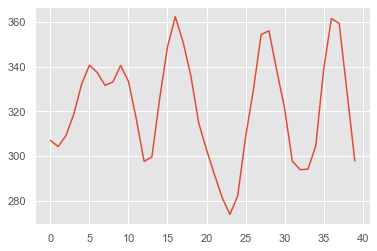

no_event no_event 1


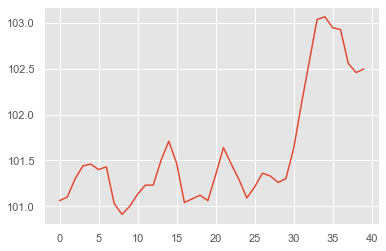

no_event no_event 2


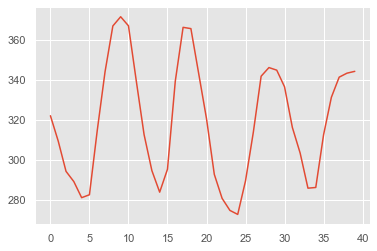

no_event no_event 1


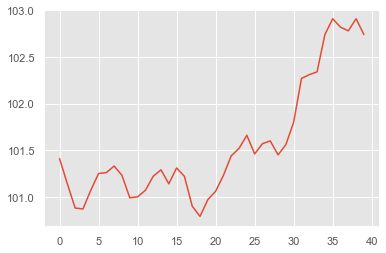

no_event no_event 2


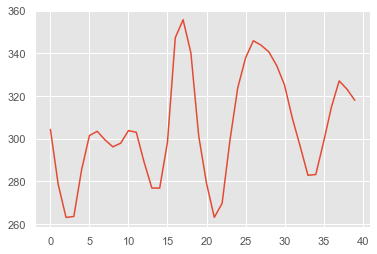

no_event no_event 1


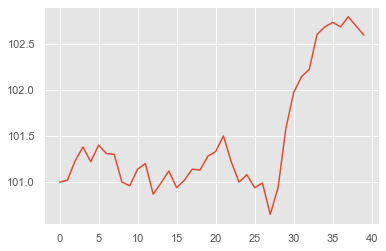

no_event no_event 2


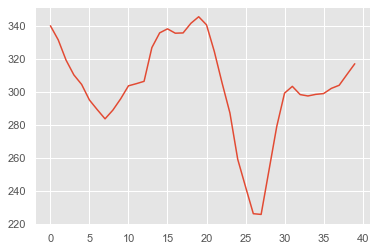

no_event no_event 2


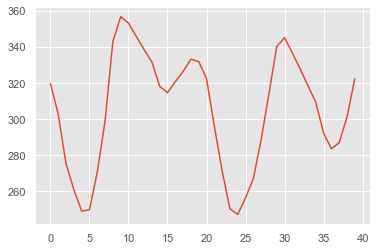

no_event no_event 1


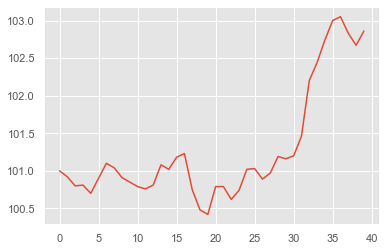

no_event no_event 2


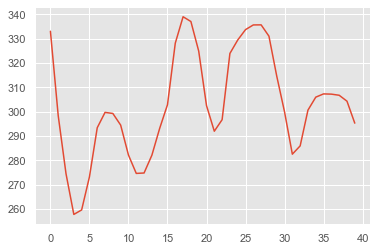

no_event no_event 1


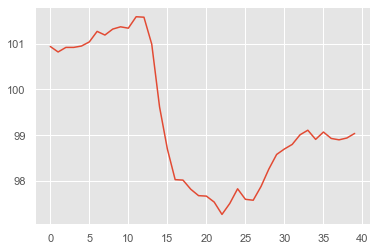

no_event no_event 2


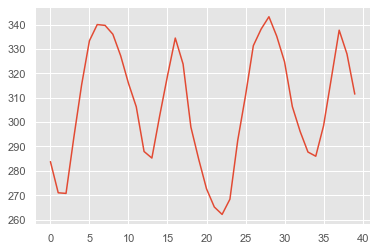

no_event no_event 1


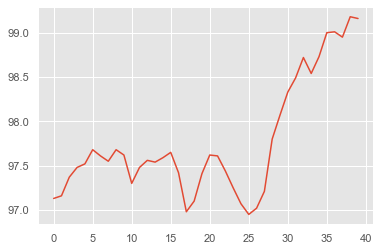

no_event no_event 2


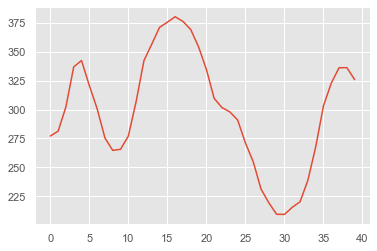

no_event no_event 2


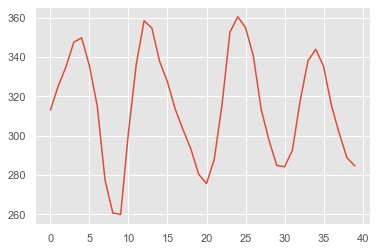

no_event no_event 1


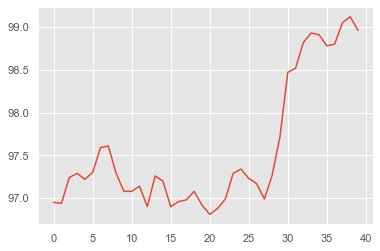

no_event no_event 2


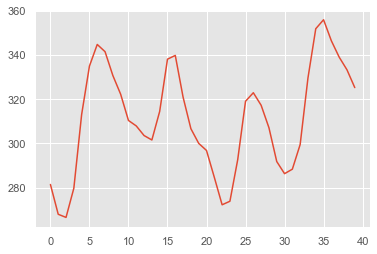

no_event no_event 1


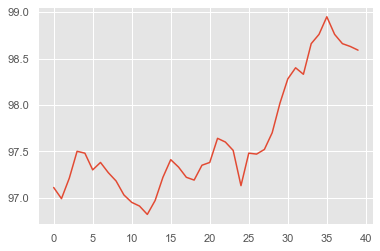

no_event no_event 2


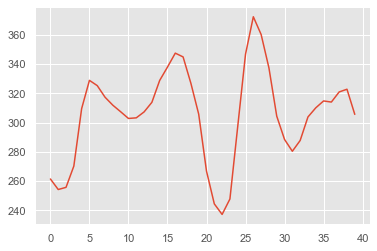

no_event no_event 2


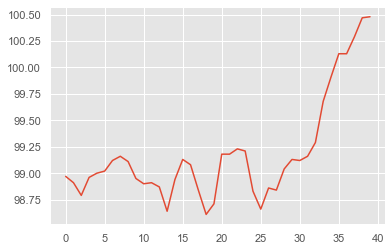

no_event no_event 2


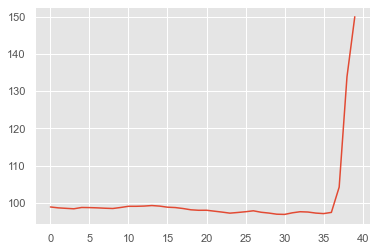

no_event no_event 2


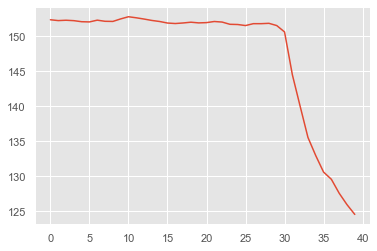

no_event no_event 1


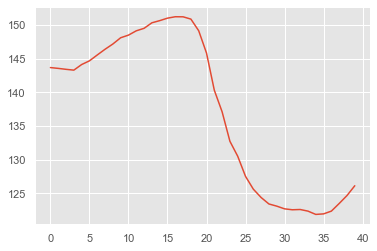

no_event no_event 1


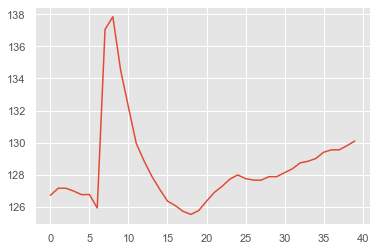

no_event no_event 1


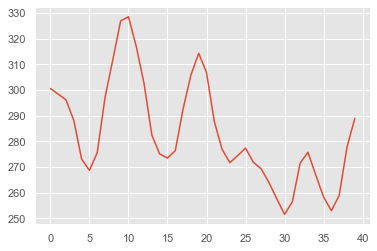

no_event no_event 2


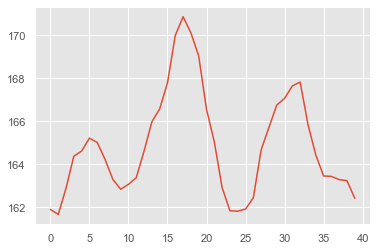

no_event no_event 2


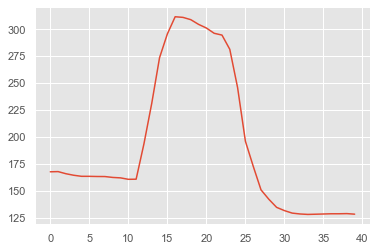

no_event no_event 2


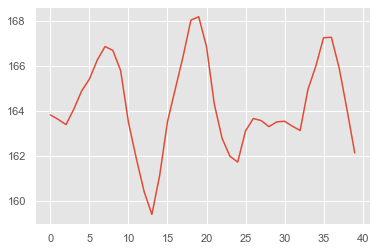

no_event no_event 2


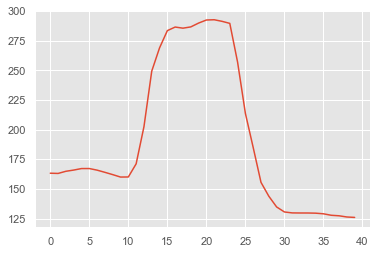

no_event no_event 1


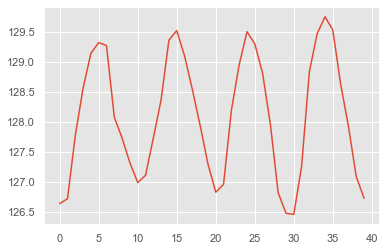

no_event no_event 1


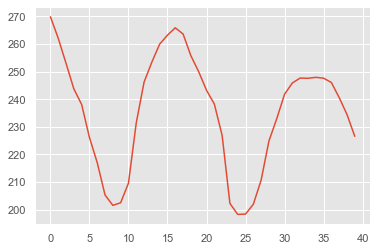

no_event no_event 2


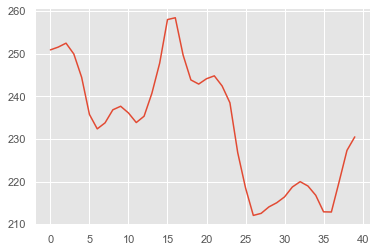

no_event no_event 2


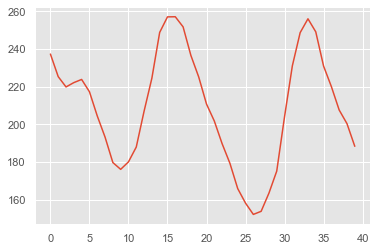

no_event no_event 2


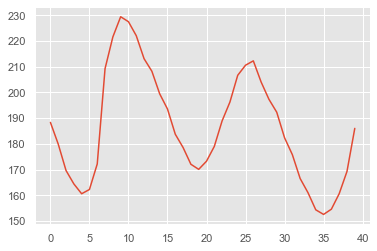

no_event no_event 2


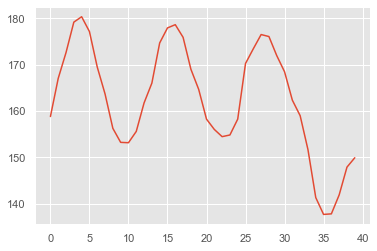

no_event no_event 2


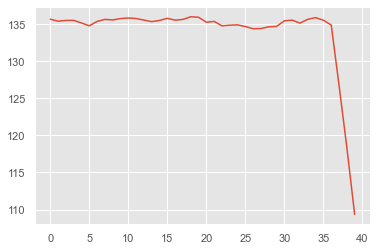

no_event no_event 1


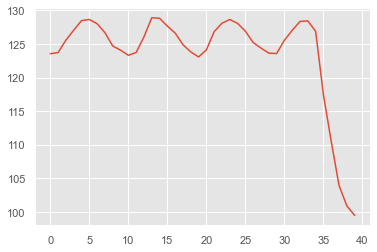

no_event no_event 2


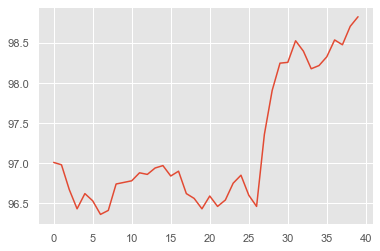

no_event no_event 2


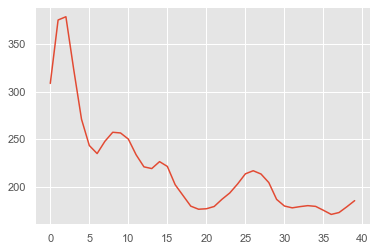

no_event no_event 2


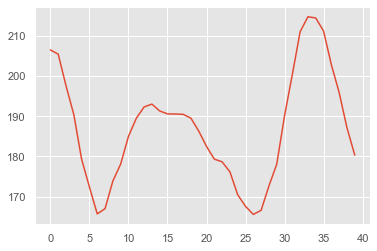

no_event no_event 1


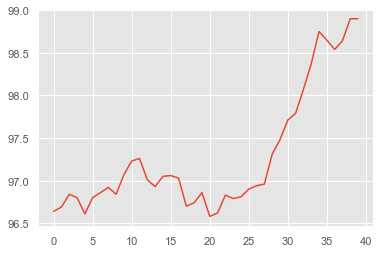

no_event no_event 1


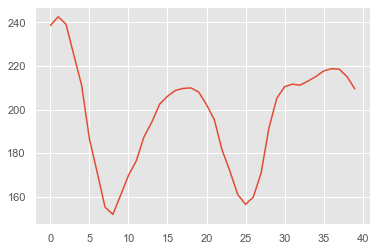

no_event no_event 2


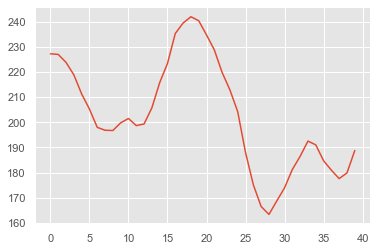

no_event no_event 1


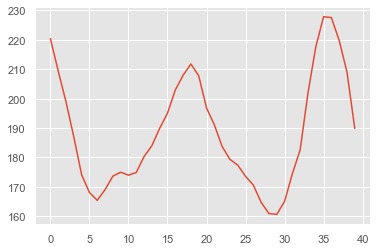

no_event no_event 2


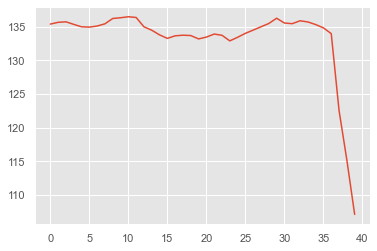

no_event no_event 1


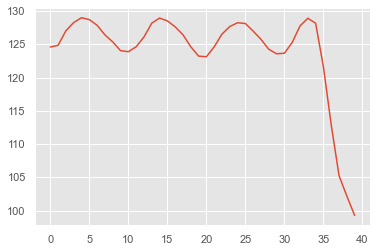

no_event no_event 2


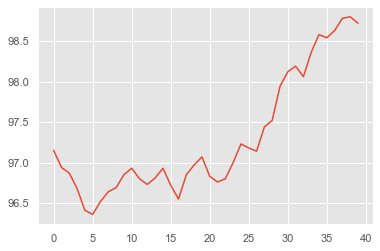

no_event no_event 2


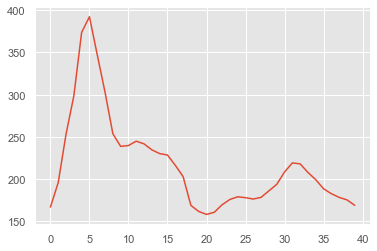

no_event no_event 2


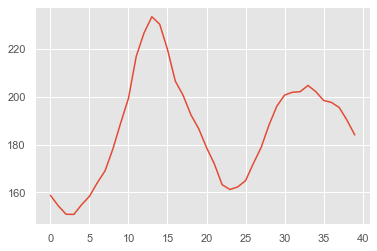

no_event no_event 1


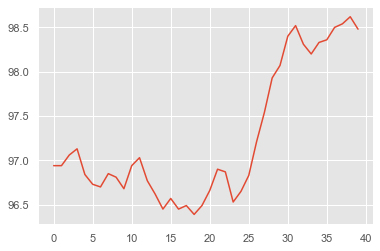

no_event no_event 1


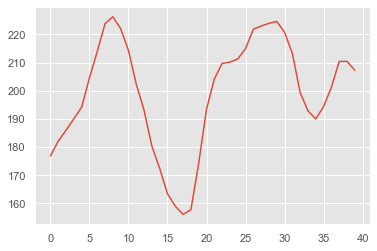

no_event no_event 2


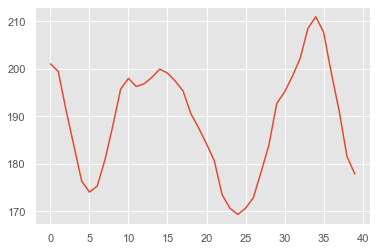

no_event no_event 1


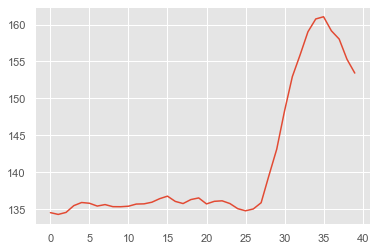

no_event no_event 1


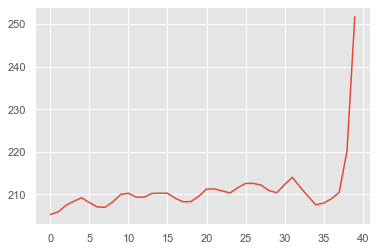

no_event no_event 2


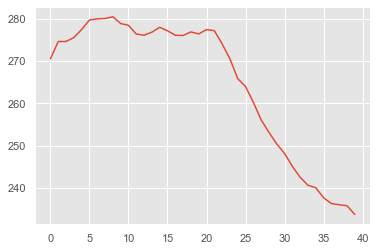

no_event no_event 1


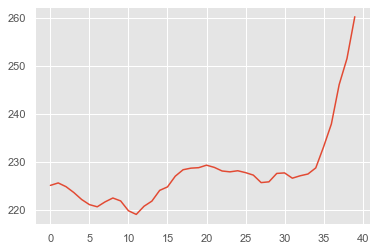

no_event no_event 2


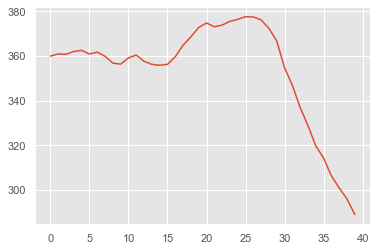

no_event no_event 2


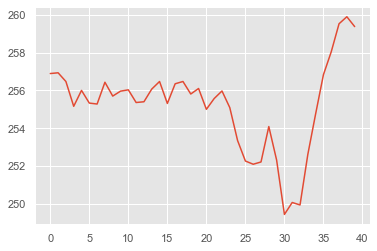

no_event no_event 1


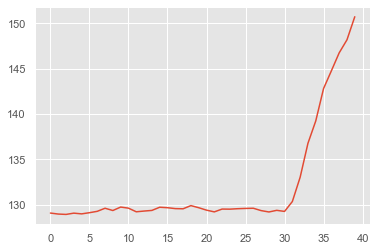

no_event no_event 1


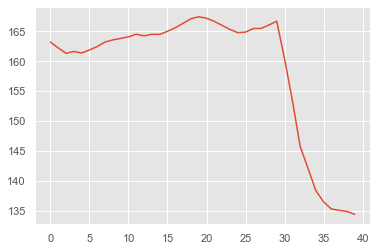

no_event no_event 1


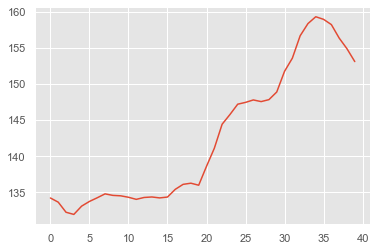

no_event no_event 1


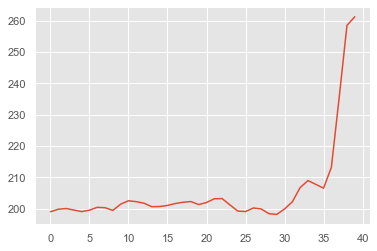

no_event no_event 1


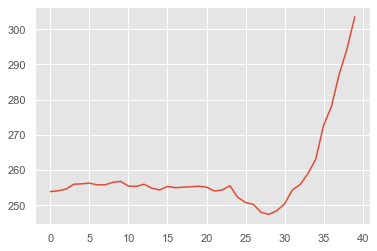

no_event no_event 2


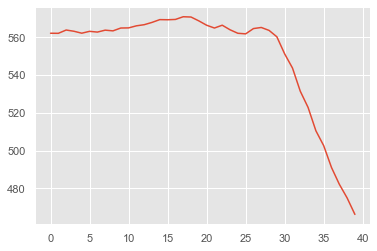

no_event no_event 1


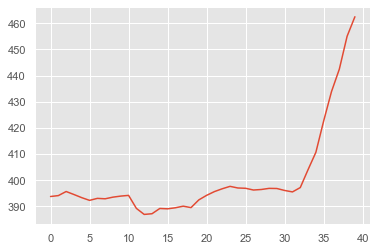

no_event no_event 2


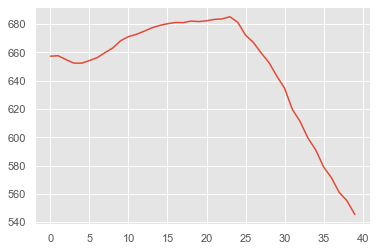

no_event no_event 2


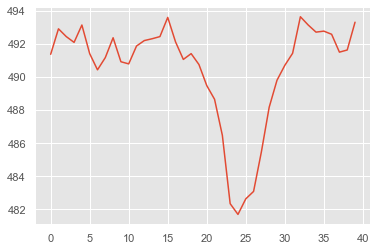

no_event no_event 1


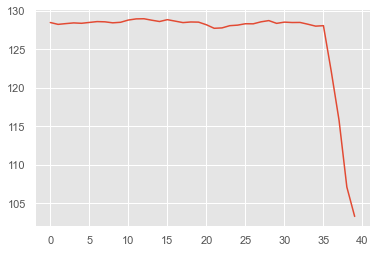

no_event no_event 1


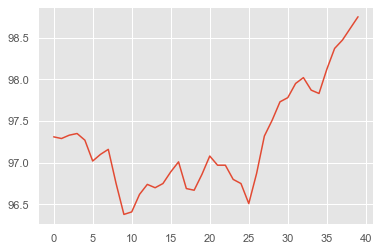

no_event no_event 2


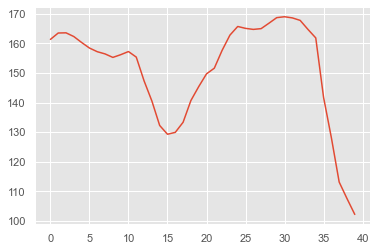

no_event no_event 1


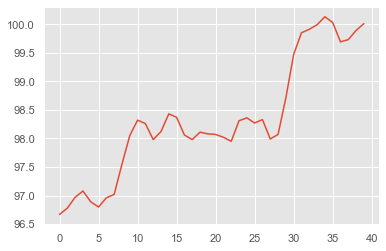

no_event no_event 1


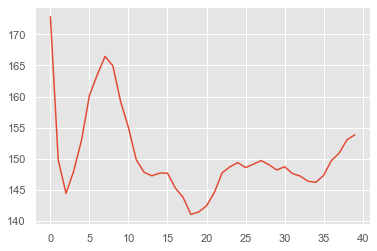

no_event no_event 2


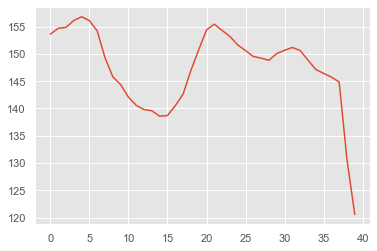

no_event no_event 1


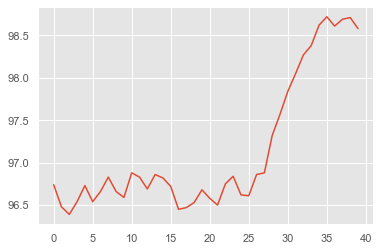

no_event no_event 1


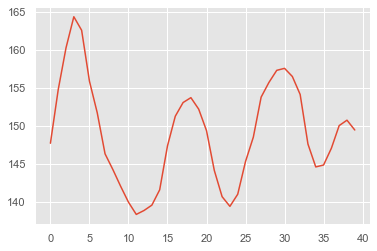

no_event no_event 2


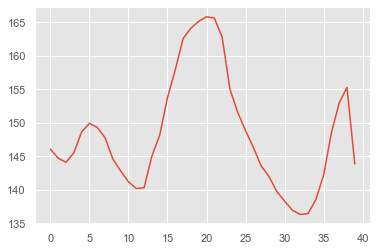

no_event no_event 1


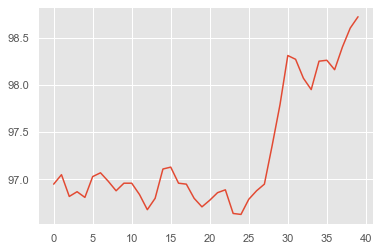

no_event no_event 1


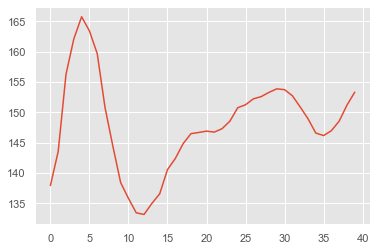

no_event no_event 2


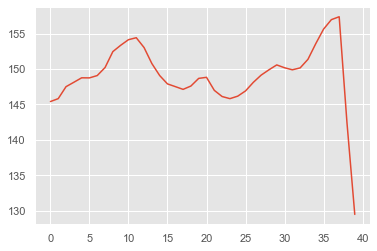

no_event Refrigerator_ON 1


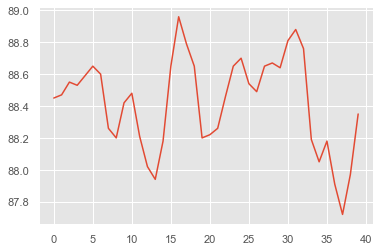

no_event no_event 2


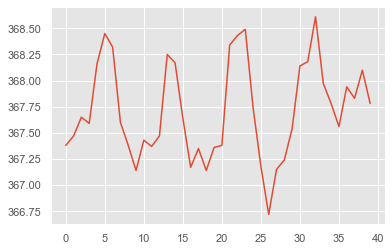

no_event Refrigerator_ON 1


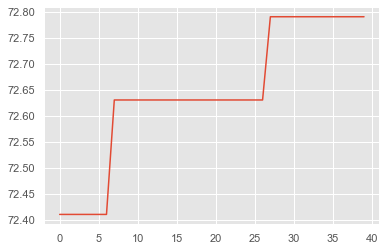

no_event no_event 2


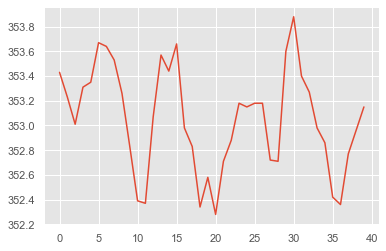

no_event no_event 1


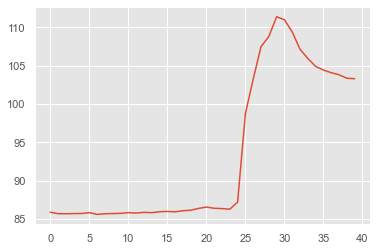

no_event no_event 1


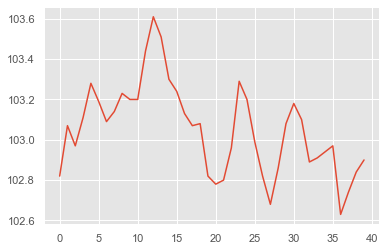

no_event no_event 1


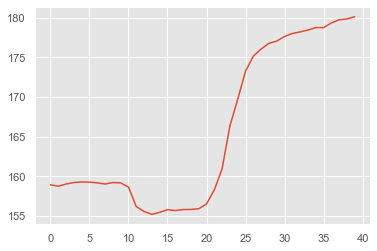

no_event no_event 1


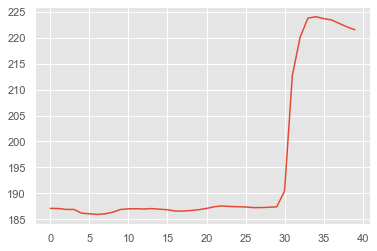

no_event no_event 1


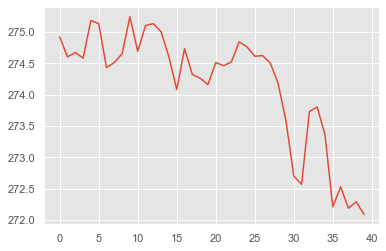

no_event Geyser_ON 2


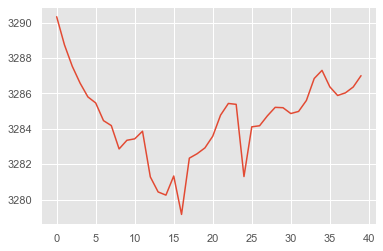

no_event no_event 1


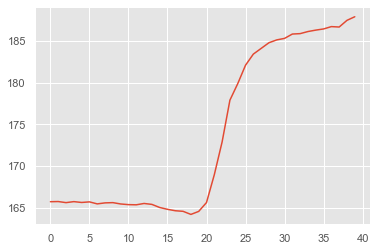

no_event no_event 1


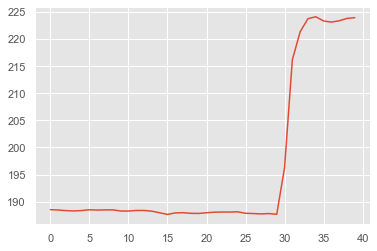

no_event no_event 2


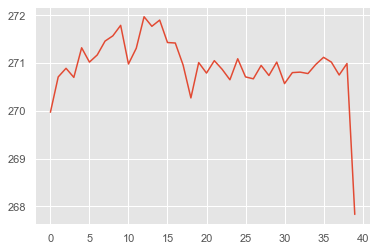

no_event no_event 1


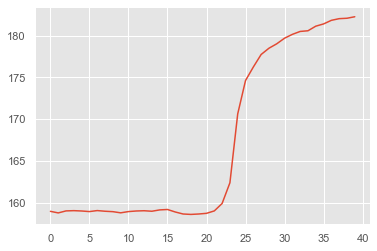

no_event no_event 1


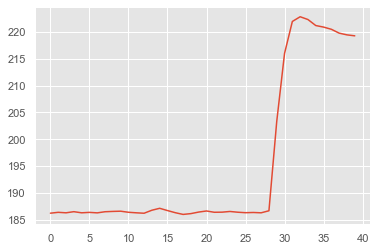

no_event no_event 1


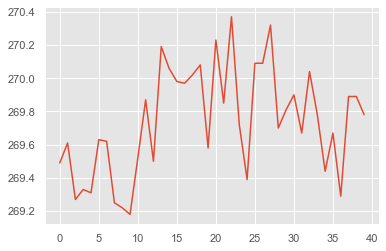

no_event no_event 2


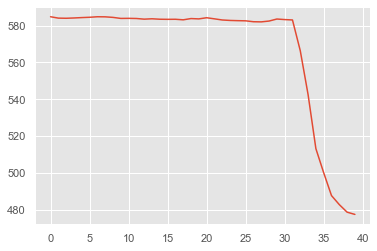

no_event no_event 2


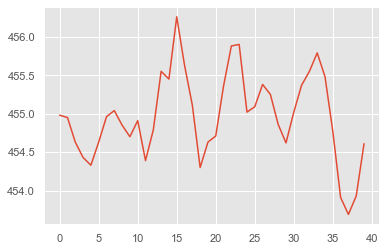

no_event Refrigerator_ON 1


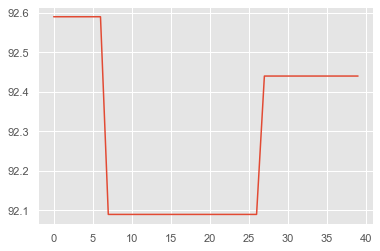

no_event no_event 2


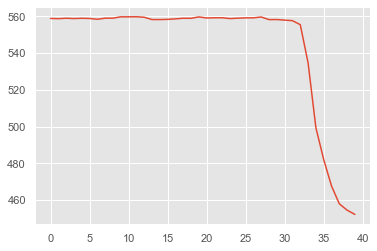

no_event no_event 2


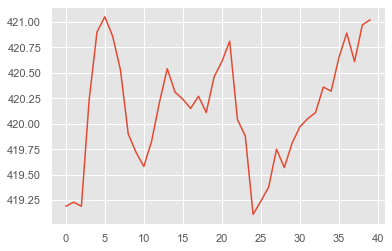

no_event no_event 2


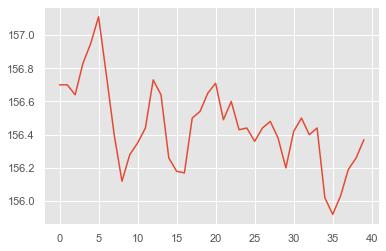

no_event no_event 1


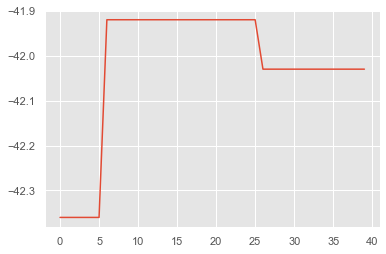

no_event no_event 2


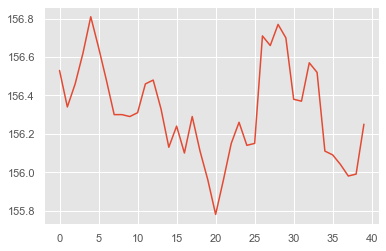

no_event no_event 1


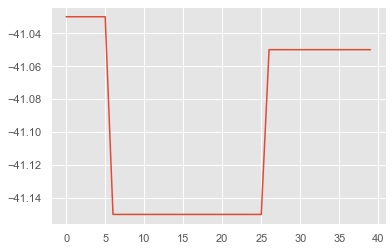

no_event no_event 1


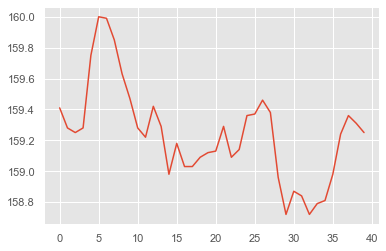

no_event no_event 2


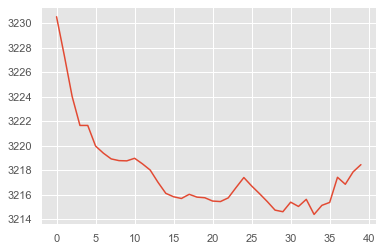

no_event no_event 1


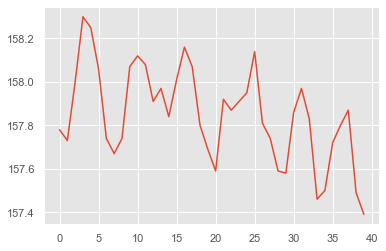

no_event no_event 2


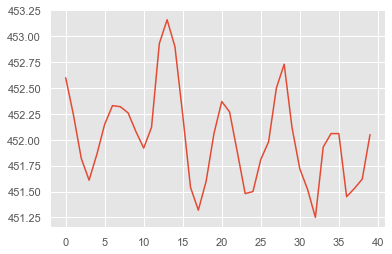

no_event no_event 1


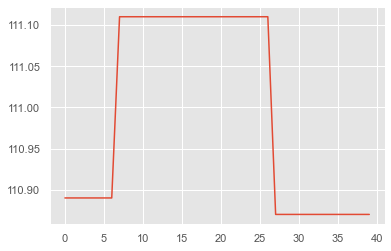

no_event no_event 2


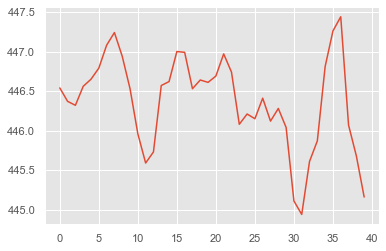

no_event Refrigerator_ON 1


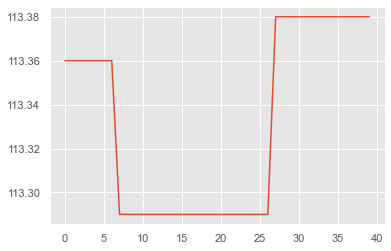

no_event no_event 2


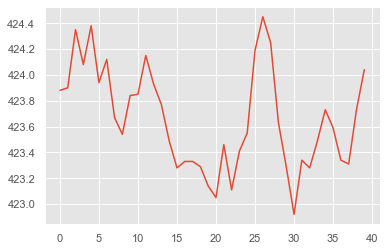

no_event no_event 1


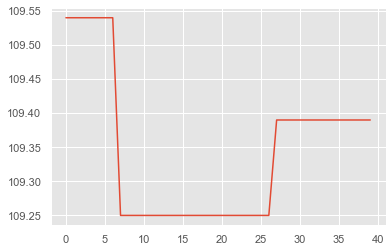

no_event no_event 2


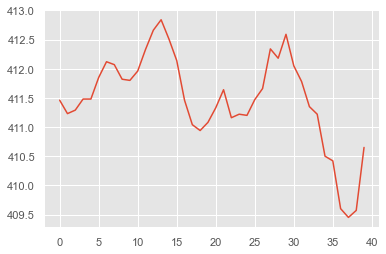

no_event no_event 2


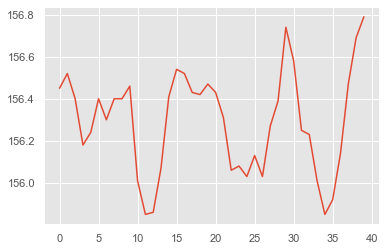

no_event no_event 1


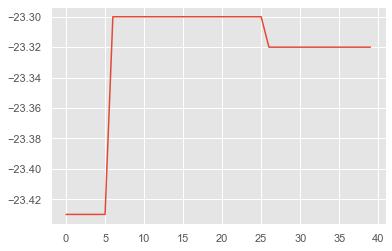

no_event no_event 2


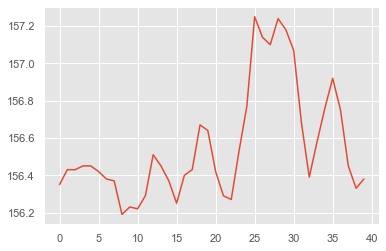

no_event no_event 1


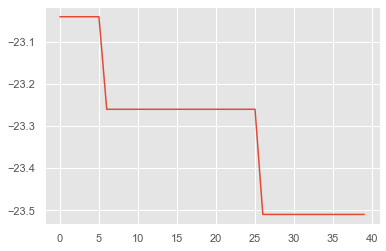

no_event no_event 2


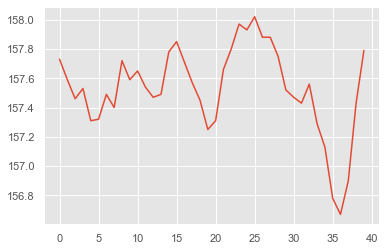

no_event no_event 1


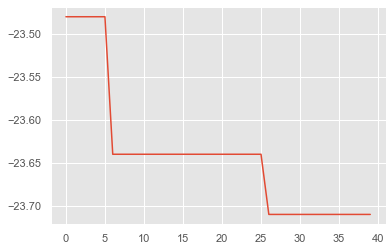

no_event no_event 2


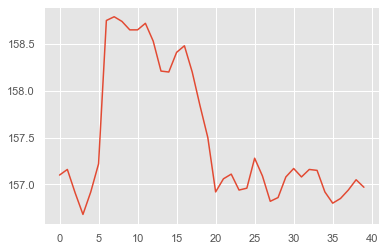

no_event no_event 1


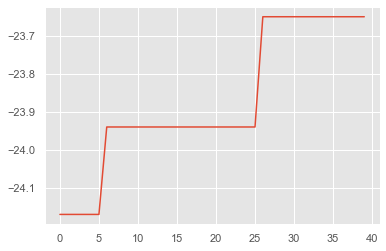

no_event no_event 2


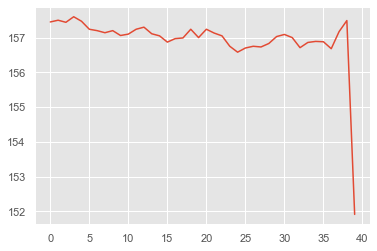

no_event no_event 2


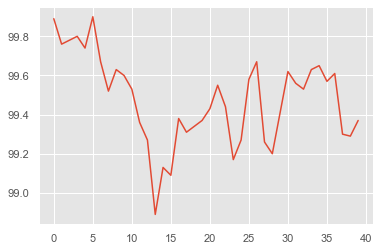

no_event no_event 1


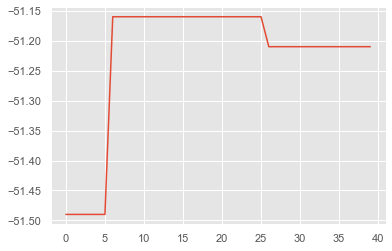

no_event no_event 2


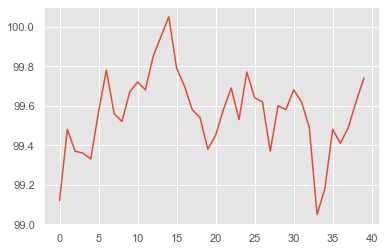

no_event no_event 2


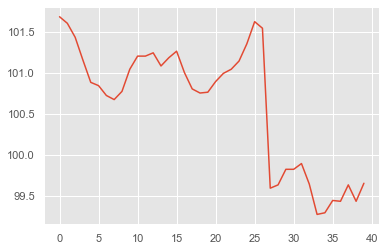

no_event no_event 1


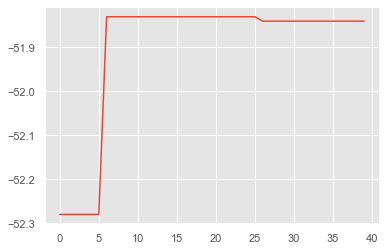

no_event no_event 2


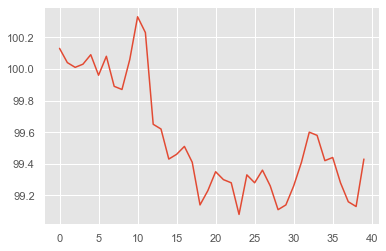

no_event no_event 1


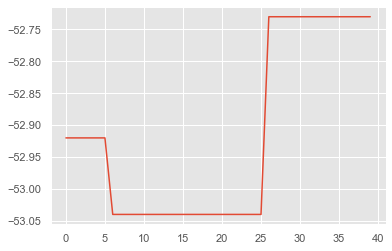

no_event no_event 1


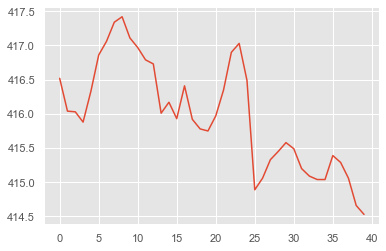

no_event no_event 1


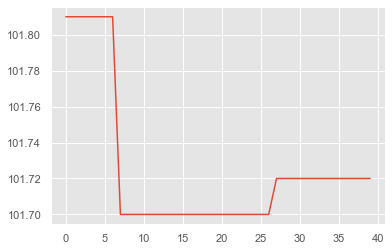

no_event no_event 2


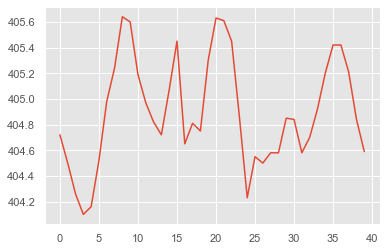

no_event no_event 2


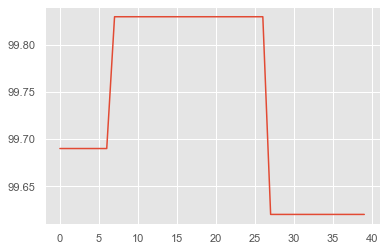

no_event no_event 1


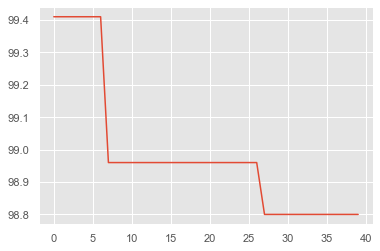

no_event no_event 1


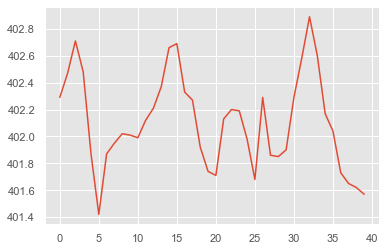

no_event no_event 1


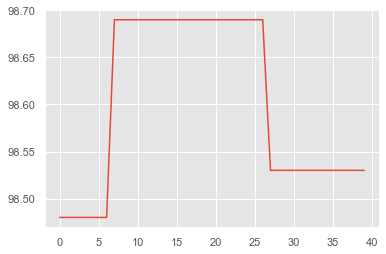

no_event no_event 2


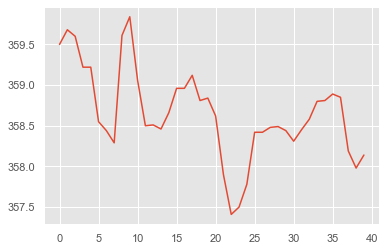

no_event no_event 1


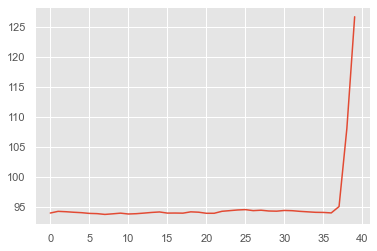

no_event no_event 1


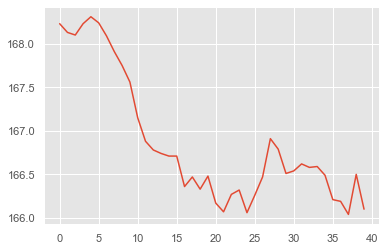

no_event no_event 2


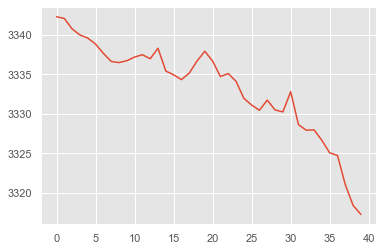

no_event no_event 2


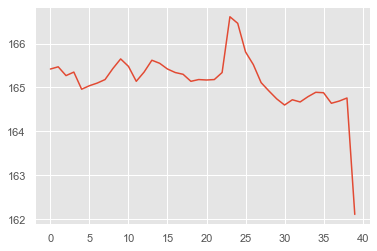

no_event no_event 2


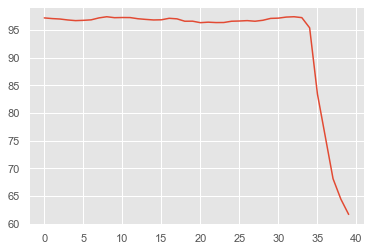

no_event no_event 1


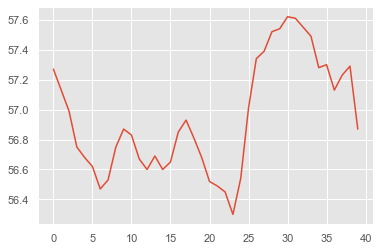

no_event no_event 2


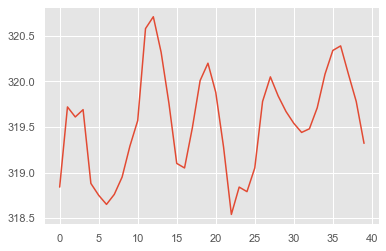

no_event no_event 1


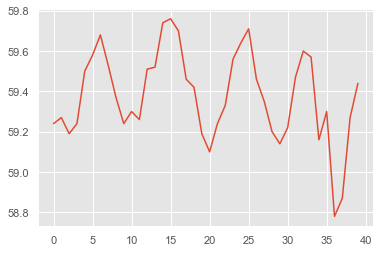

no_event no_event 2


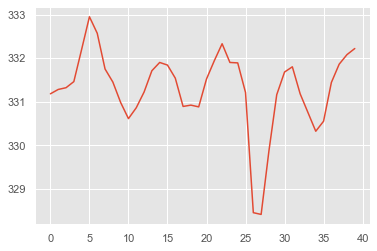

no_event no_event 1


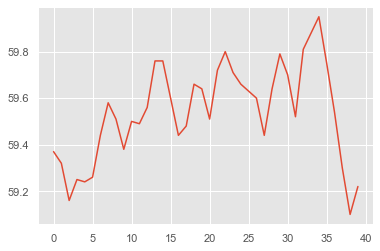

no_event no_event 2


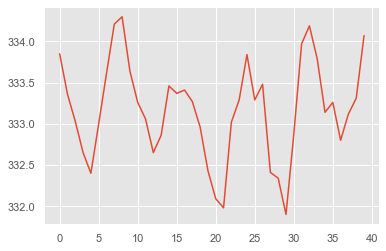

no_event no_event 1


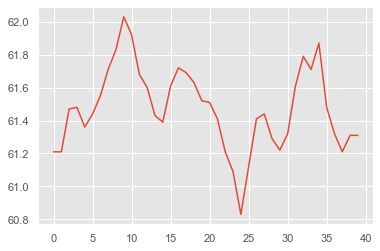

no_event no_event 2


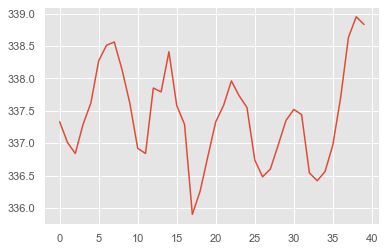

no_event no_event 2


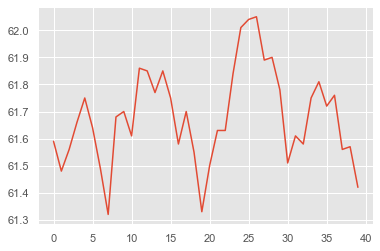

no_event Refrigerator_ON 1


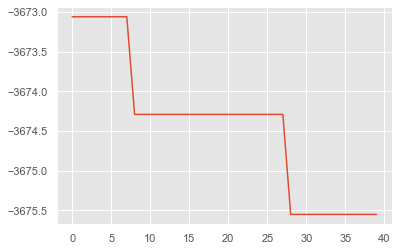

no_event no_event 1


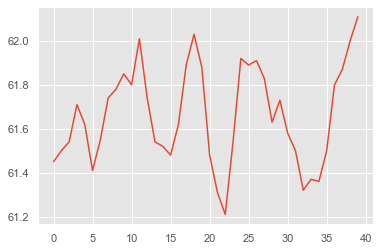

no_event no_event 2


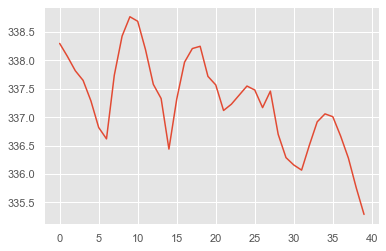

no_event no_event 2


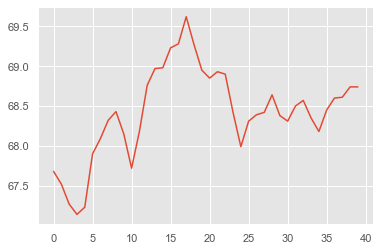

no_event no_event 1


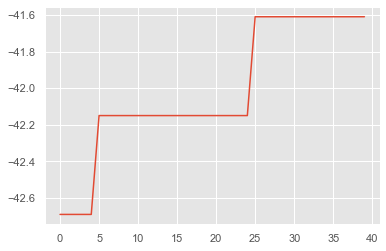

no_event no_event 2


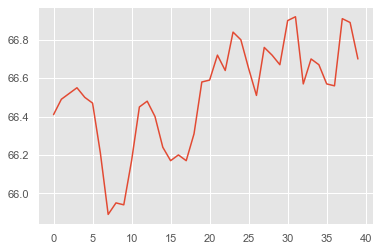

no_event no_event 1


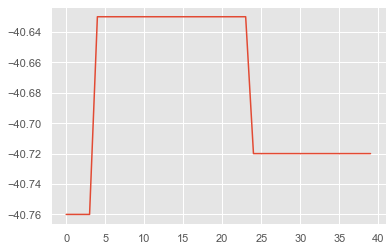

no_event no_event 1


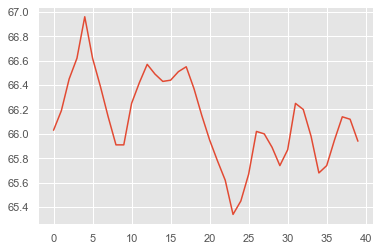

no_event no_event 2


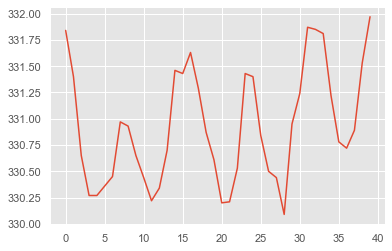

no_event no_event 2


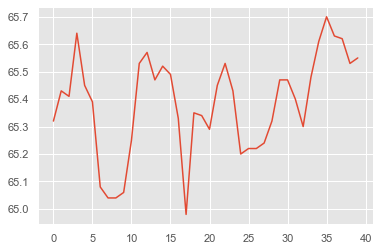

no_event no_event 1


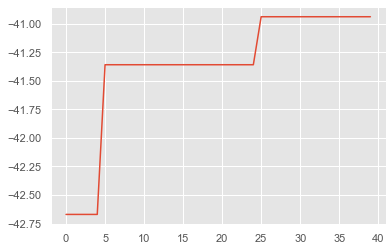

no_event no_event 1


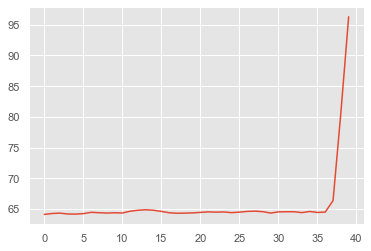

no_event no_event 1


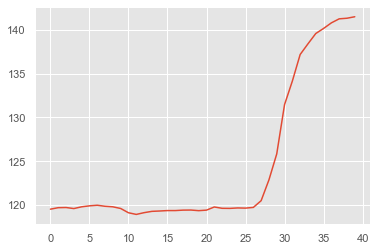

no_event no_event 1


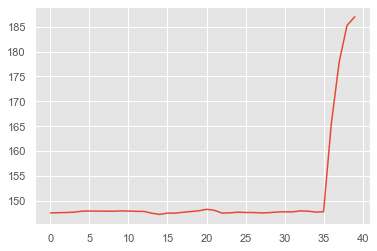

no_event no_event 2


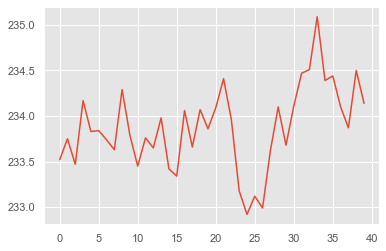

no_event no_event 1


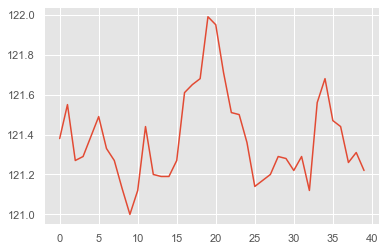

no_event no_event 2


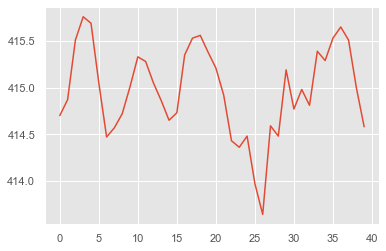

no_event Refrigerator_ON 1


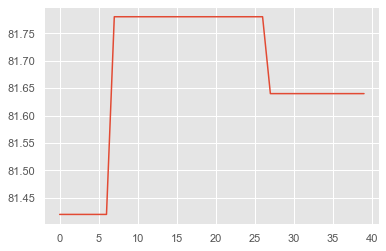

no_event no_event 1


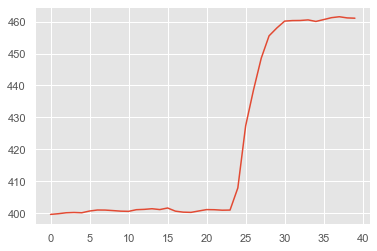

no_event no_event 2


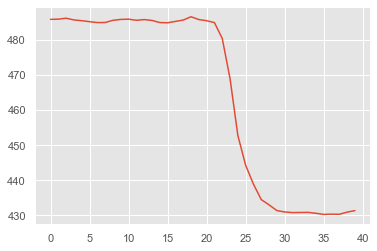

no_event no_event 2


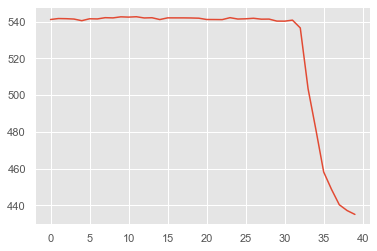

no_event Refrigerator_ON 2


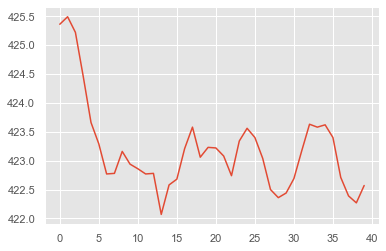

no_event no_event 1


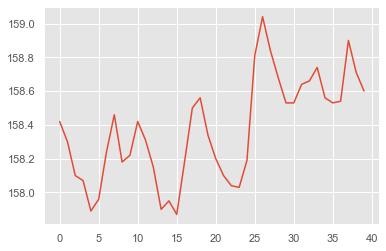

no_event no_event 2


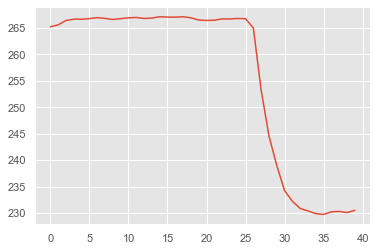

no_event no_event 1


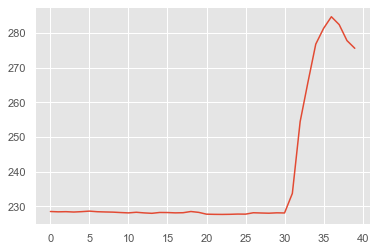

no_event no_event 2


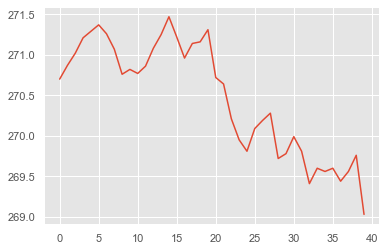

no_event no_event 1


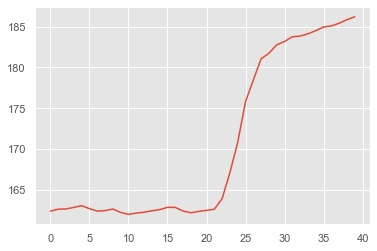

no_event no_event 1


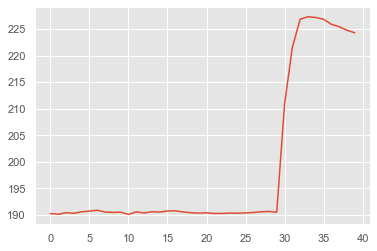

no_event no_event 2


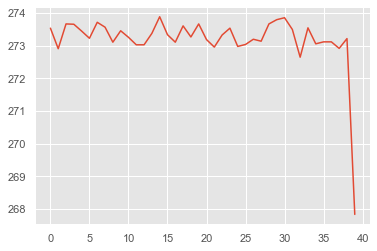

no_event no_event 2


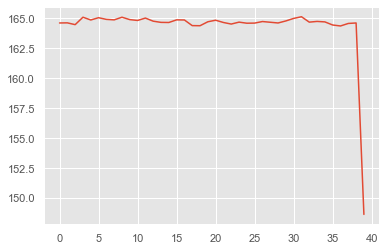

no_event no_event 2


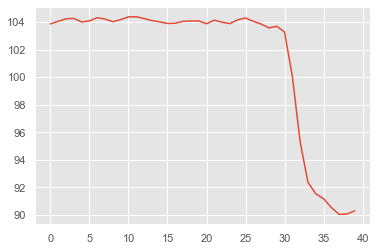

no_event no_event 1


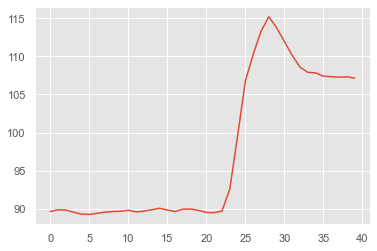

no_event no_event 1


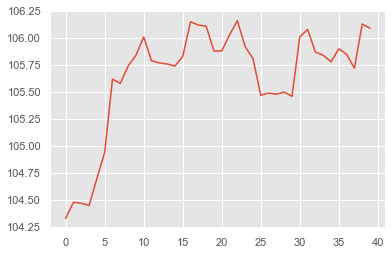

no_event Geyser_ON 1


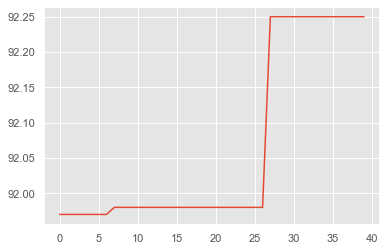

no_event no_event 1


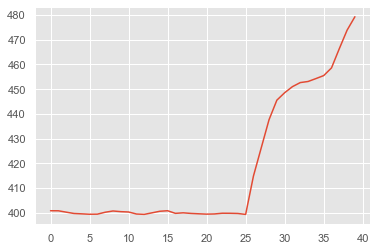

no_event no_event 2


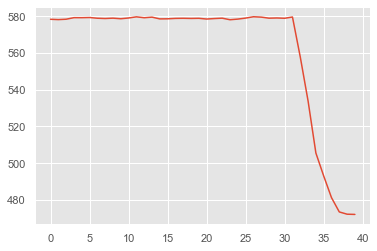

no_event no_event 2


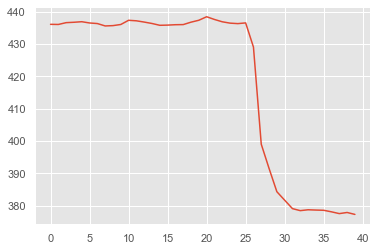

no_event no_event 2


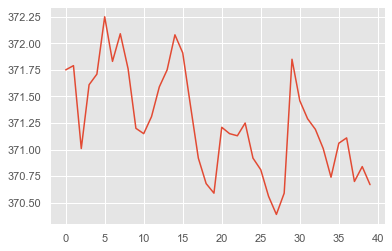

no_event no_event 2


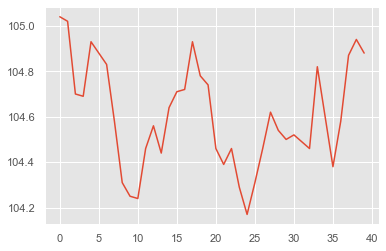

no_event no_event 1


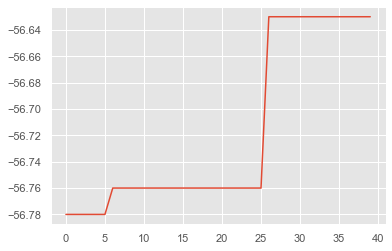

no_event no_event 2


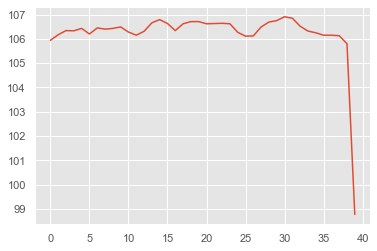

no_event no_event 2


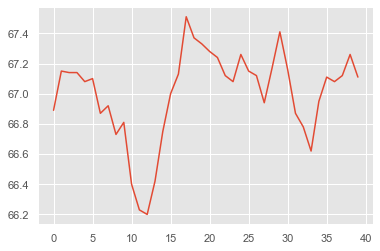

no_event no_event 1


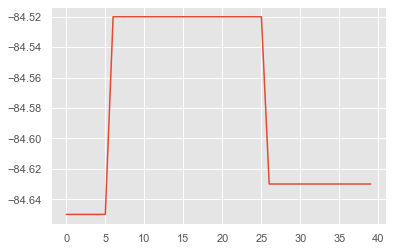

no_event no_event 2


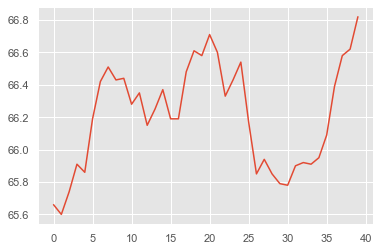

no_event no_event 1


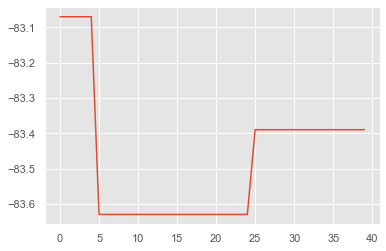

no_event no_event 1


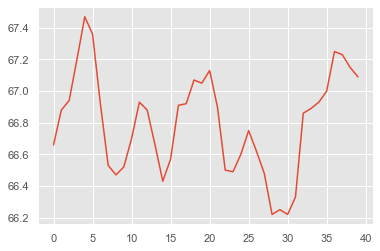

no_event no_event 2


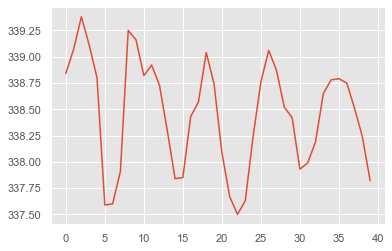

no_event no_event 2


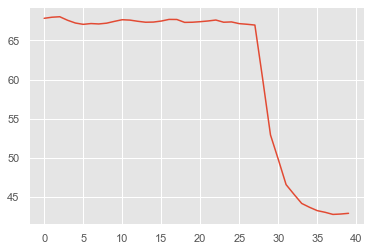

no_event no_event 1


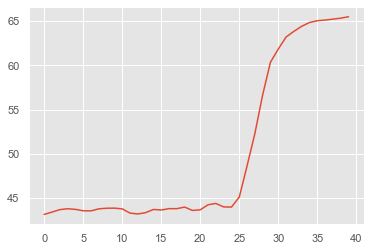

no_event no_event 1


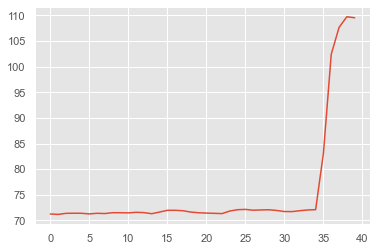

no_event no_event 1


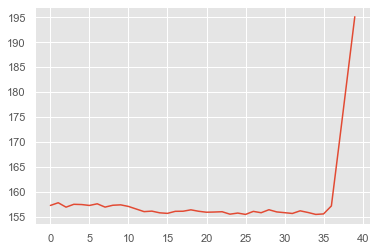

no_event no_event 2


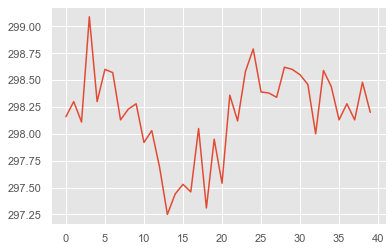

no_event no_event 2


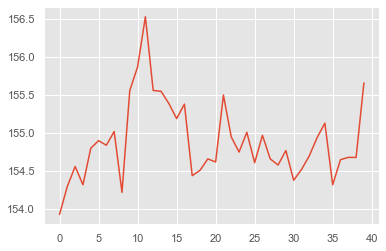

no_event no_event 1


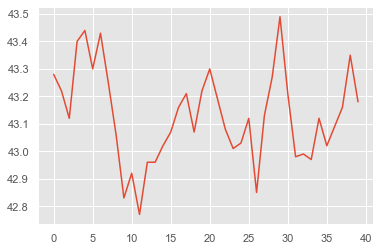

no_event no_event 2


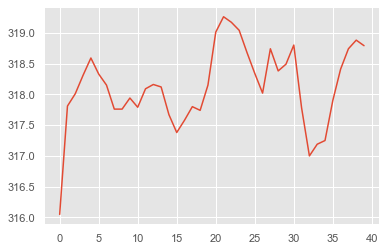

no_event no_event 2


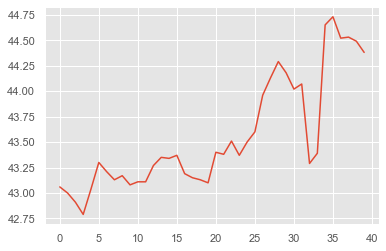

no_event no_event 1


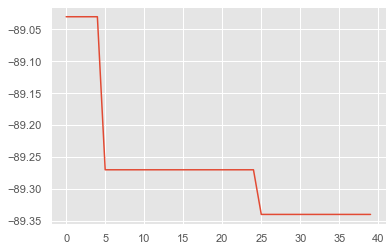

no_event no_event 2


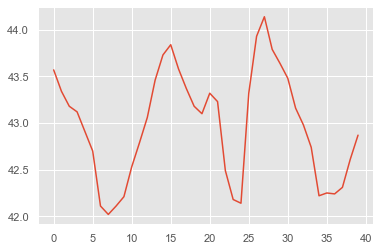

no_event no_event 1


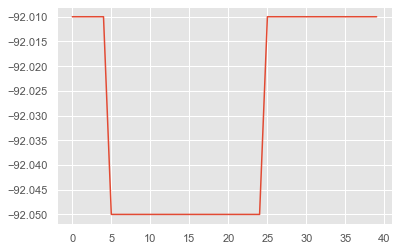

no_event no_event 1


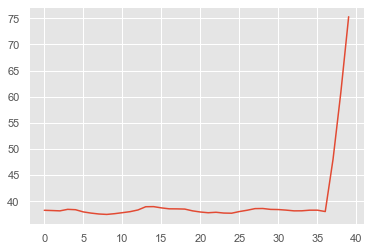

no_event no_event 1


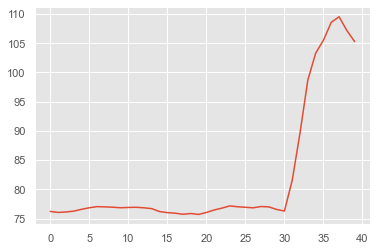

no_event no_event 1


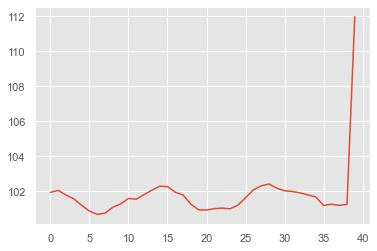

no_event no_event 1


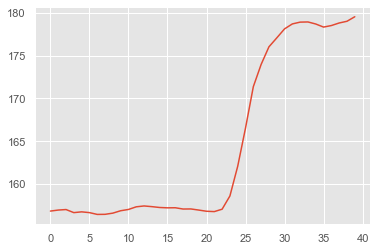

no_event no_event 1


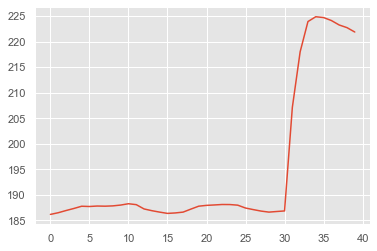

no_event no_event 2


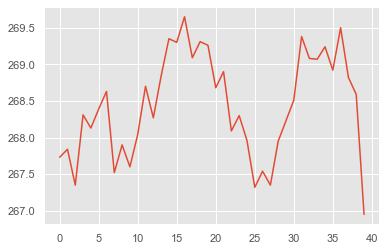

no_event no_event 1


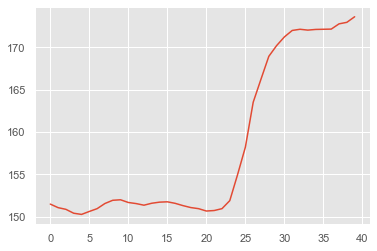

no_event no_event 1


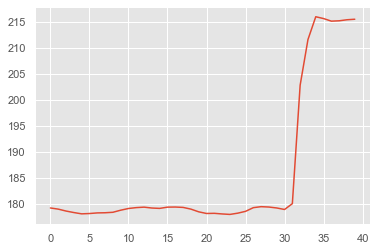

no_event no_event 1


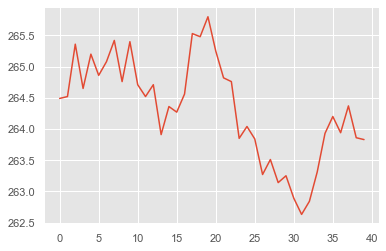

no_event no_event 2


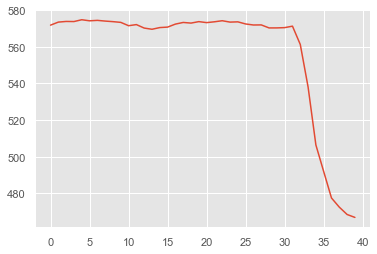

no_event no_event 2


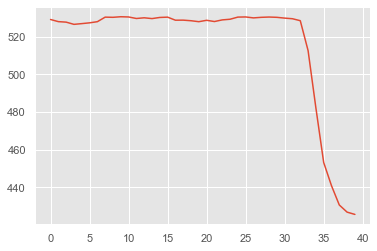

no_event no_event 2


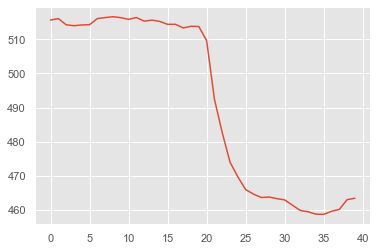

no_event no_event 2


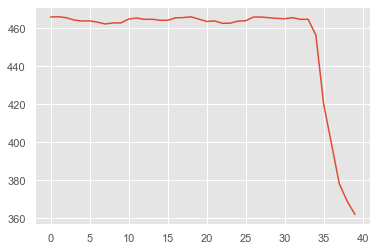

no_event no_event 2


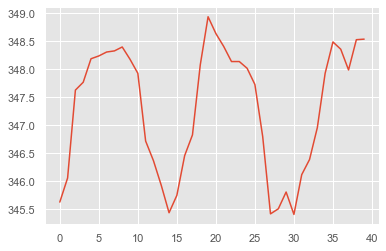

no_event no_event 1


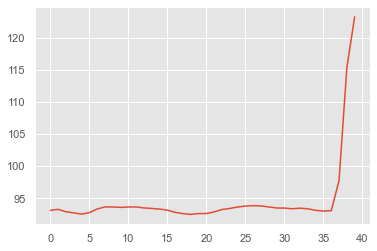

no_event no_event 1


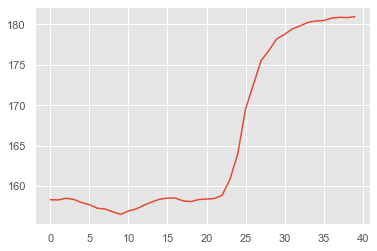

no_event no_event 1


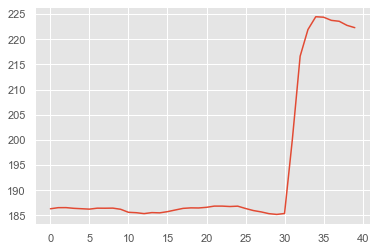

no_event no_event 2


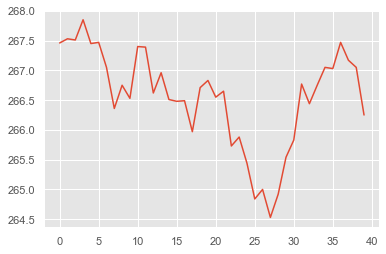

no_event no_event 1


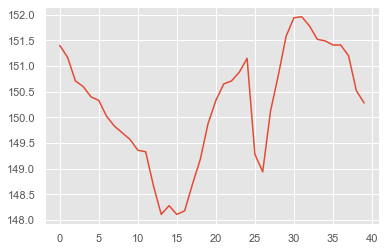

no_event no_event 2


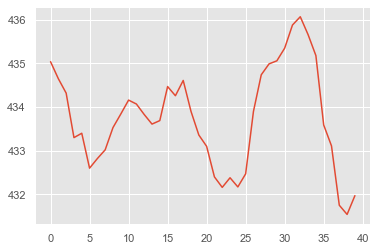

no_event no_event 2


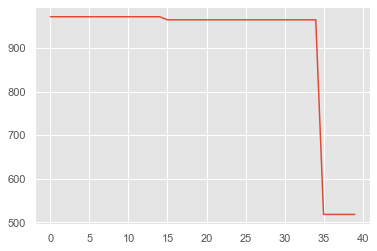

no_event no_event 1


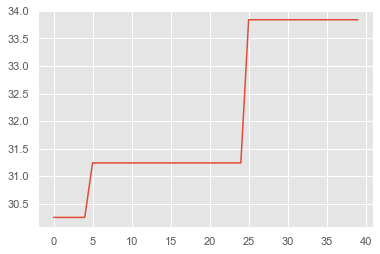

no_event no_event 1


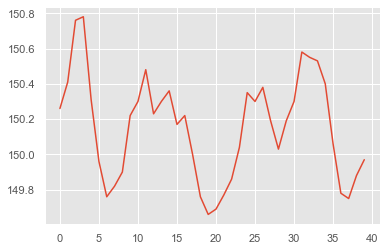

no_event no_event 2


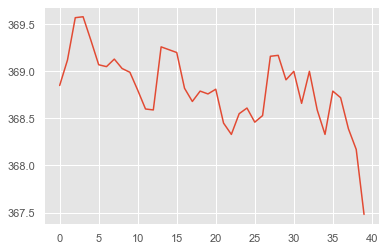

no_event no_event 1


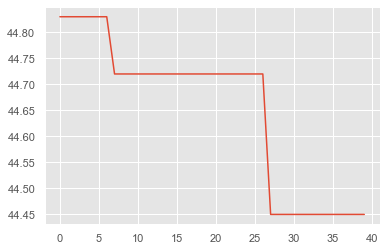

no_event no_event 2


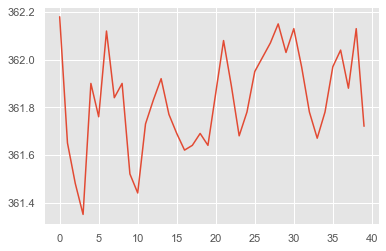

no_event no_event 1


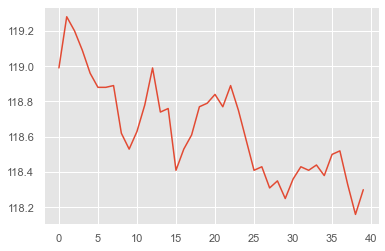

no_event no_event 1


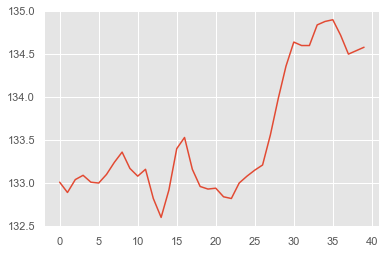

no_event no_event 2


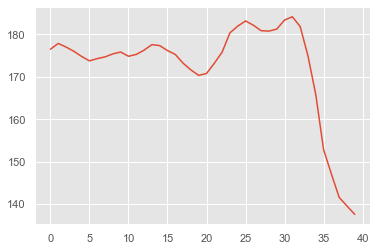

no_event no_event 1


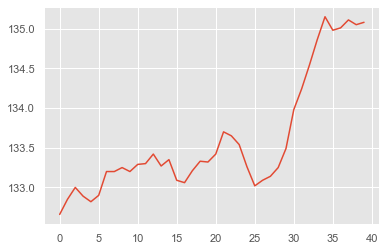

no_event no_event 2


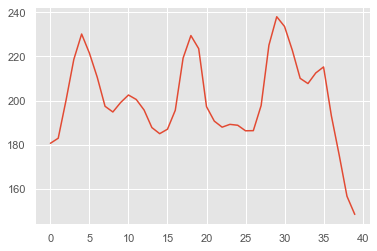

no_event no_event 1


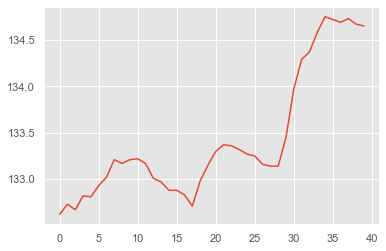

no_event no_event 2


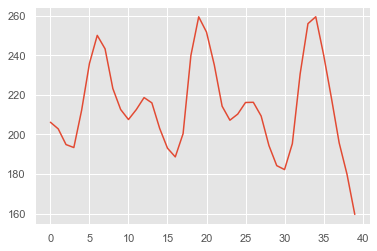

no_event no_event 1


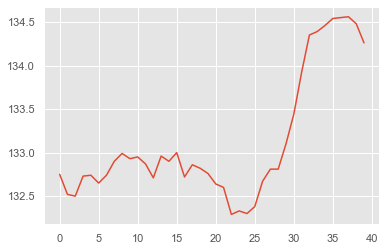

no_event no_event 2


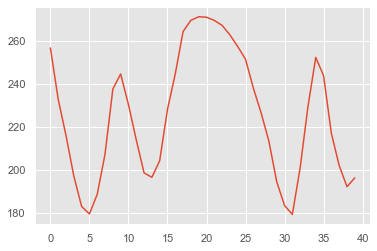

no_event no_event 1


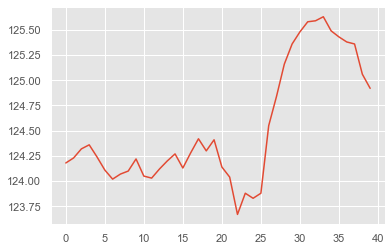

no_event no_event 1


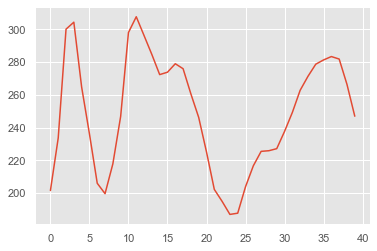

no_event no_event 2


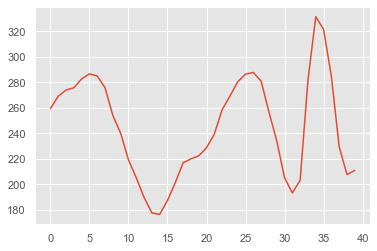

no_event no_event 2


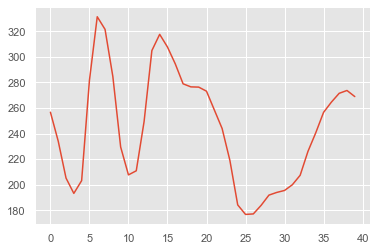

no_event no_event 2


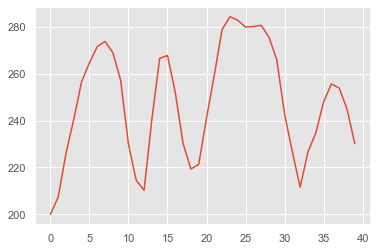

no_event no_event 2


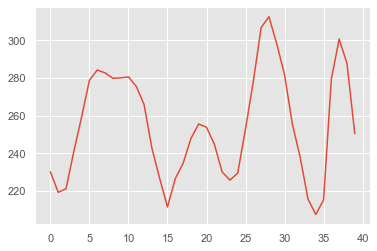

no_event no_event 1


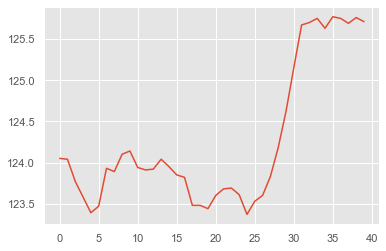

no_event no_event 1


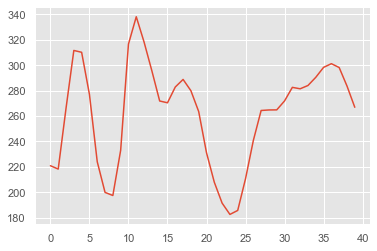

no_event no_event 1


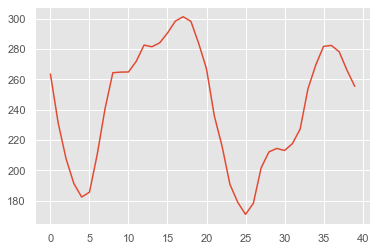

no_event no_event 2


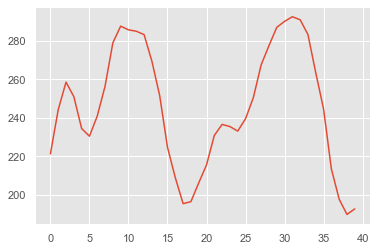

no_event no_event 1


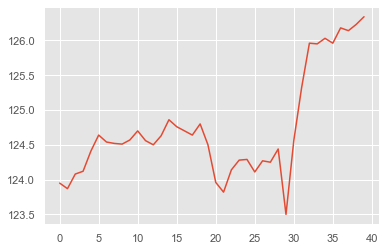

no_event no_event 2


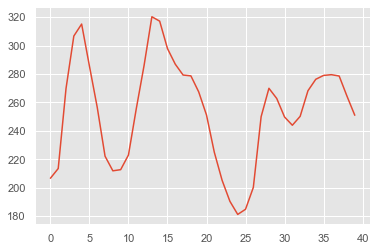

no_event no_event 2


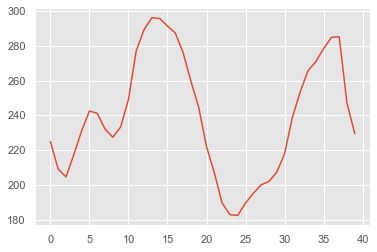

no_event no_event 1


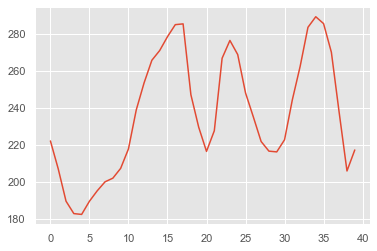

no_event no_event 1


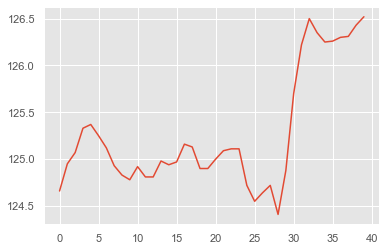

no_event no_event 1


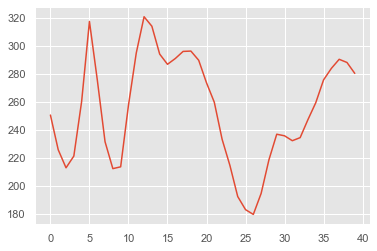

no_event no_event 2


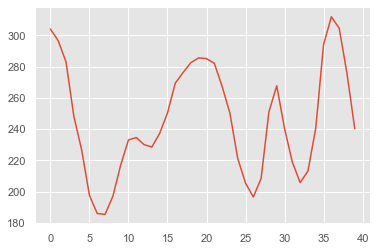

no_event no_event 1


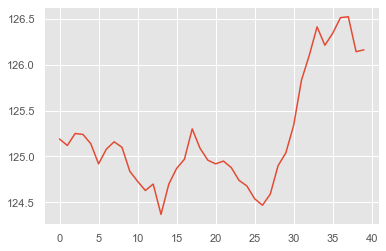

no_event no_event 2


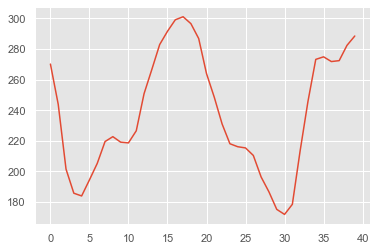

no_event no_event 1


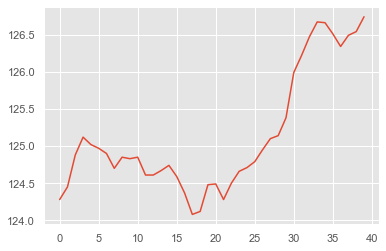

no_event no_event 1


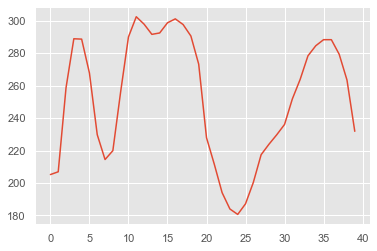

no_event no_event 2


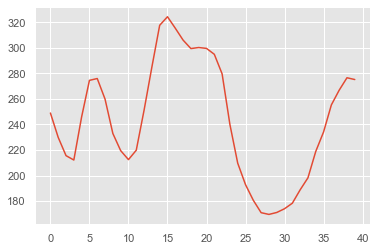

no_event no_event 2


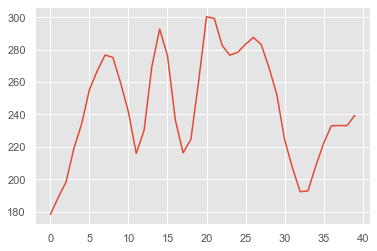

no_event no_event 2


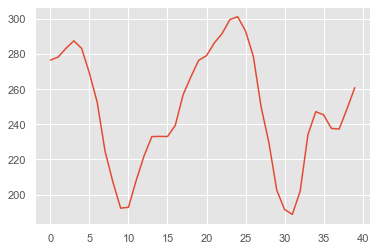

no_event no_event 1


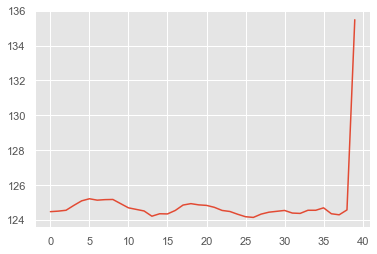

no_event no_event 2


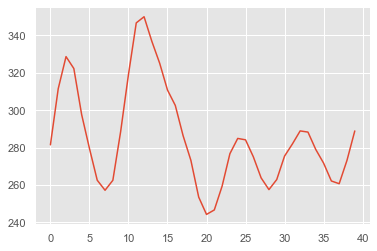

no_event no_event 2


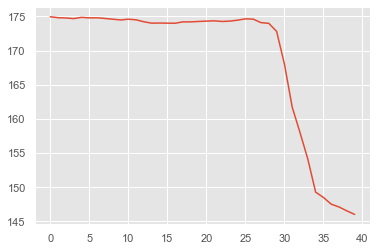

no_event no_event 1


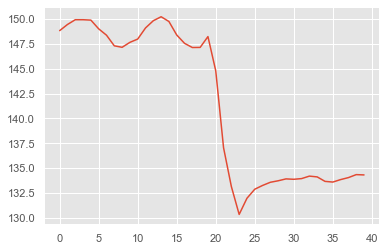

no_event no_event 1


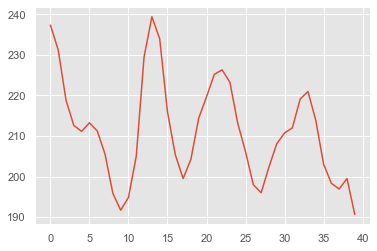

no_event no_event 2


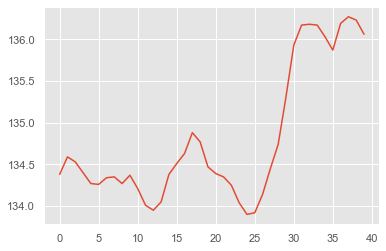

no_event no_event 1


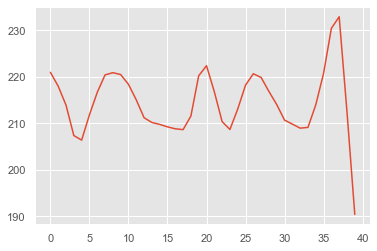

no_event no_event 2


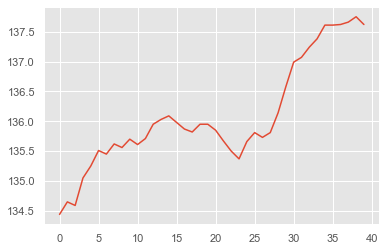

no_event no_event 1


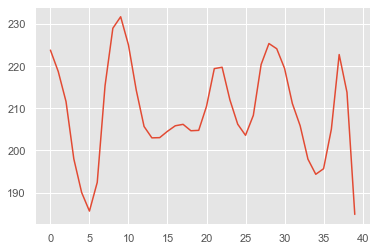

no_event no_event 2


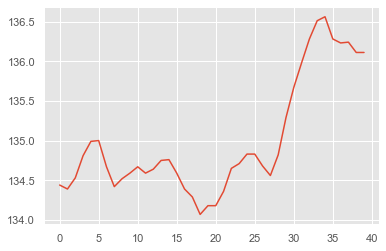

no_event no_event 2


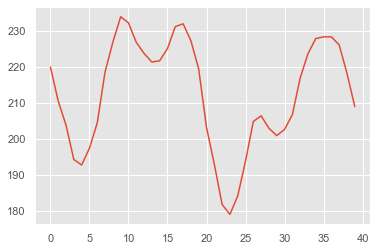

no_event no_event 2


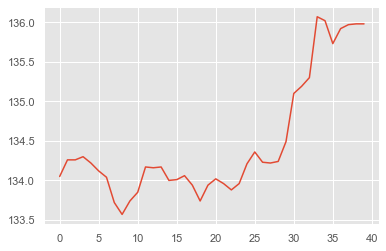

no_event no_event 1


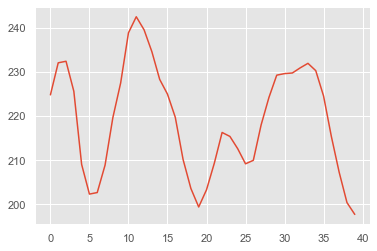

no_event no_event 2


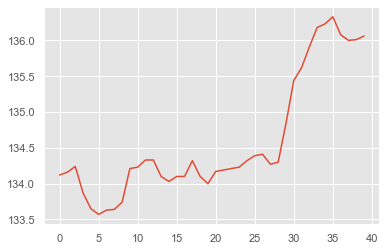

no_event no_event 1


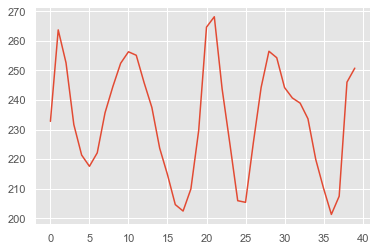

no_event no_event 2


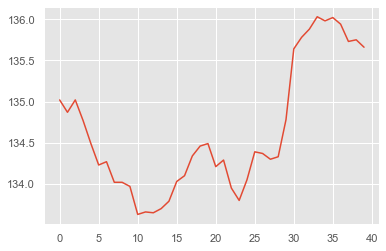

no_event no_event 1


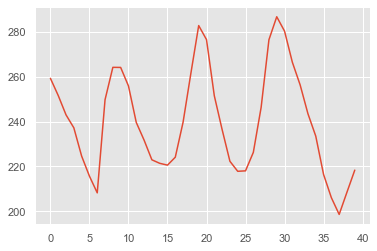

no_event no_event 2


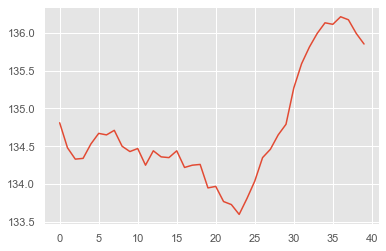

no_event no_event 2


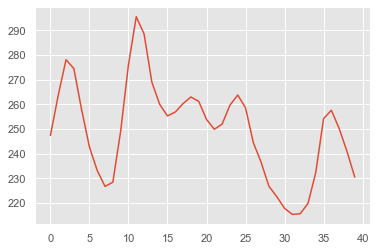

no_event no_event 2


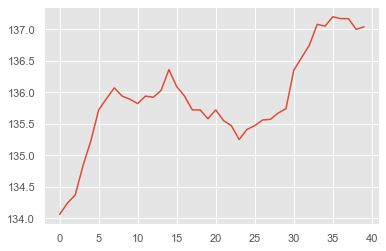

no_event no_event 1


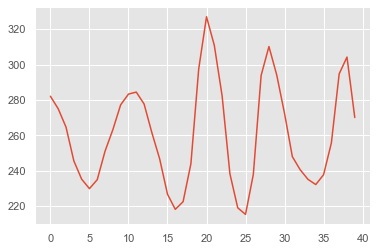

no_event no_event 2


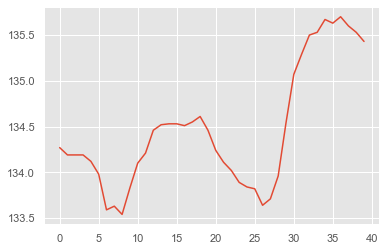

no_event no_event 2


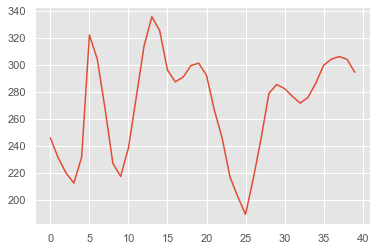

no_event no_event 2


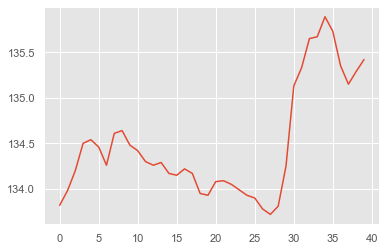

no_event no_event 2


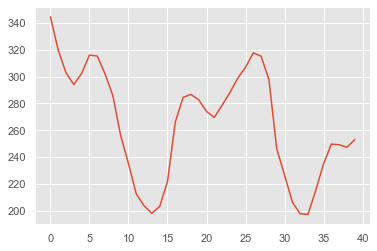

no_event no_event 2


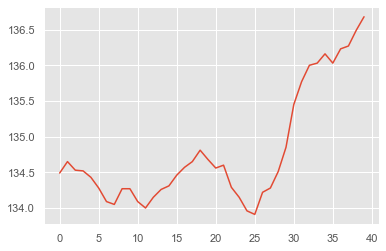

no_event no_event 2


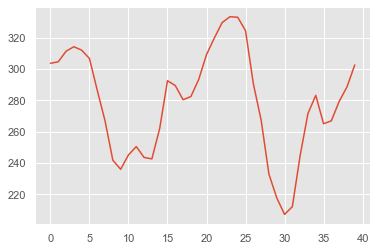

no_event no_event 1


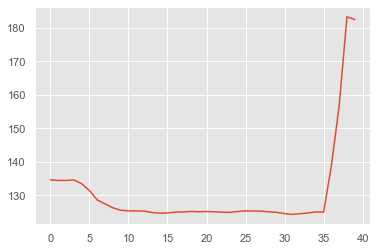

no_event no_event 2


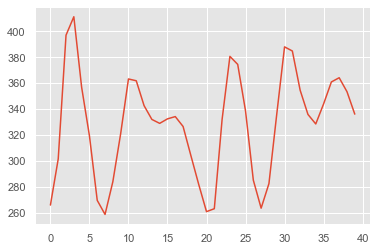

no_event no_event 2


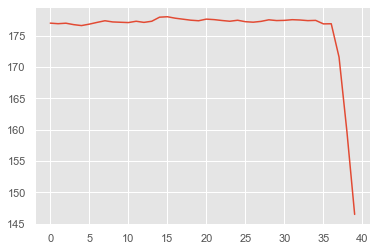

no_event no_event 2


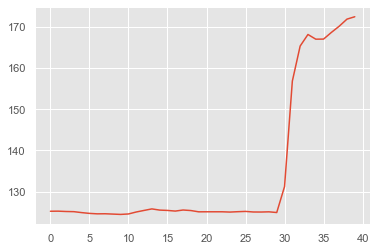

no_event no_event 2


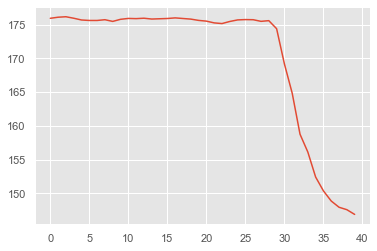

no_event no_event 1


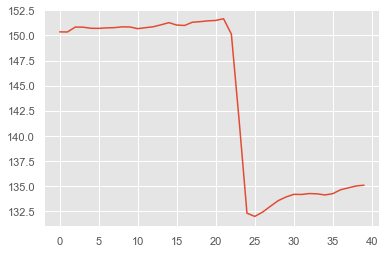

no_event no_event 1


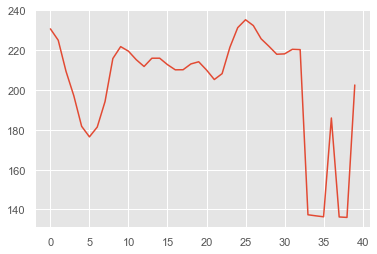

no_event no_event 2


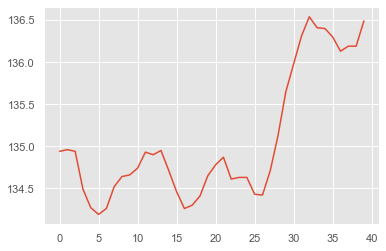

no_event no_event 1


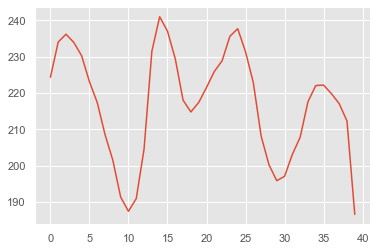

no_event no_event 2


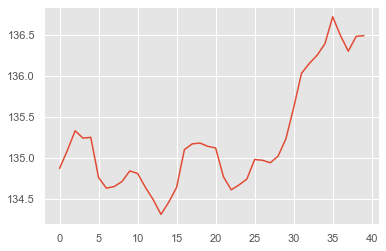

no_event no_event 1


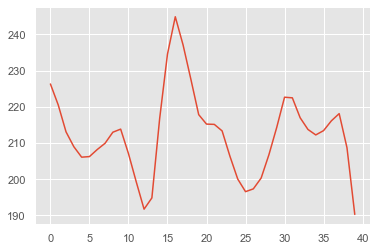

no_event no_event 2


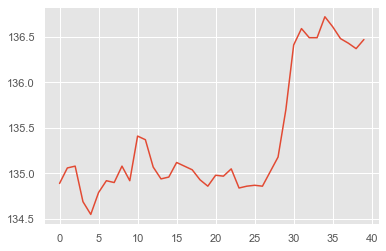

no_event no_event 2


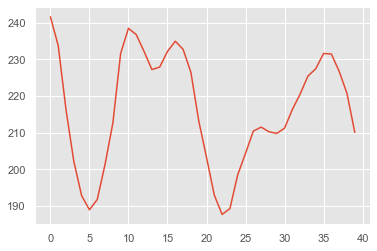

no_event no_event 1


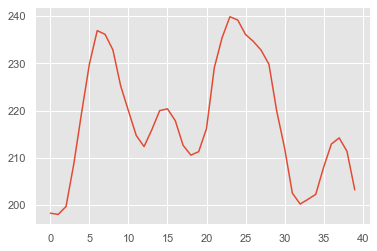

no_event no_event 2


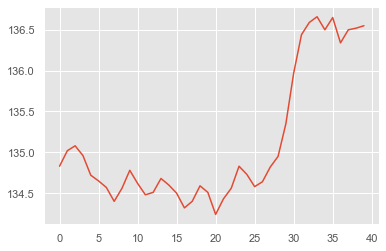

no_event no_event 1


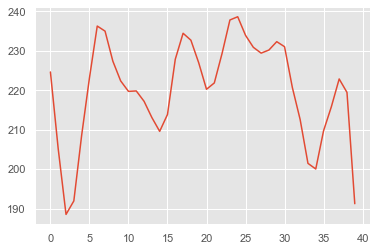

no_event no_event 2


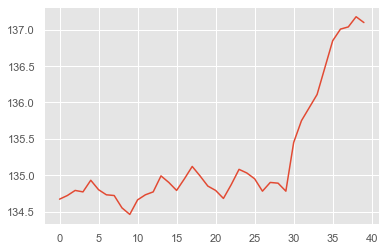

no_event no_event 2


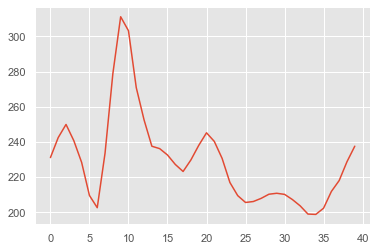

no_event no_event 1


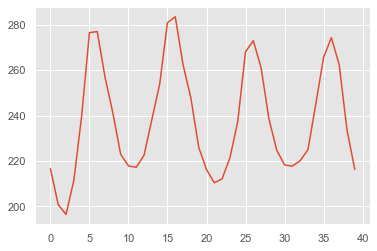

no_event no_event 2


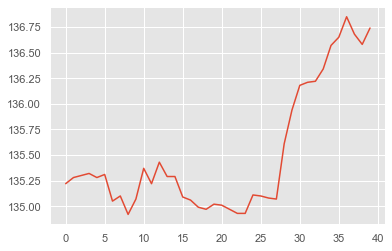

no_event no_event 1


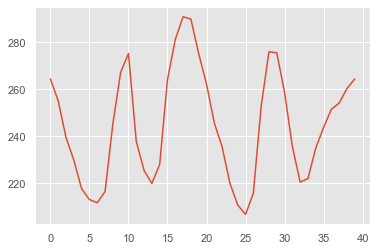

no_event no_event 2


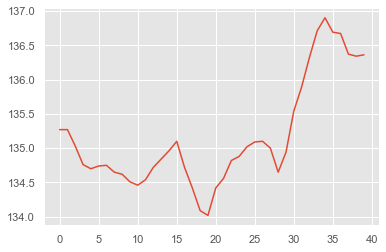

no_event no_event 2


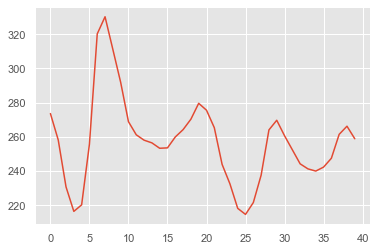

no_event no_event 2


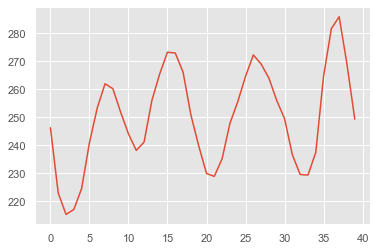

no_event no_event 2


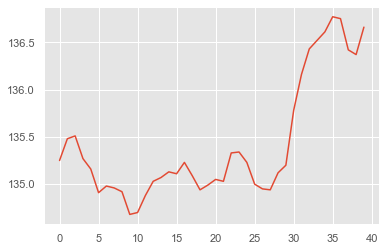

no_event no_event 2


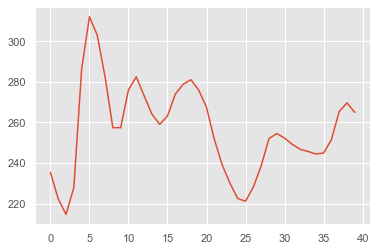

no_event no_event 1


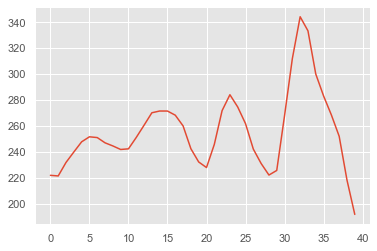

no_event no_event 2


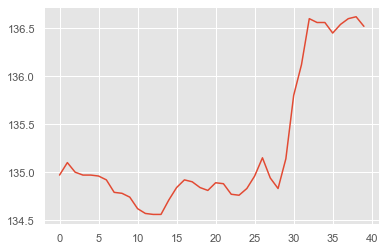

no_event no_event 2


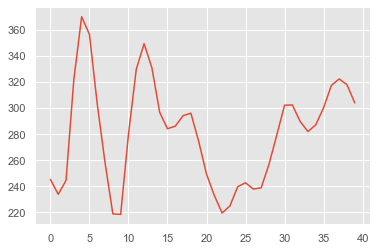

no_event no_event 2


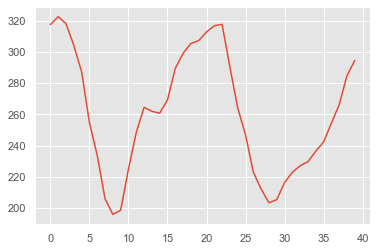

no_event no_event 2


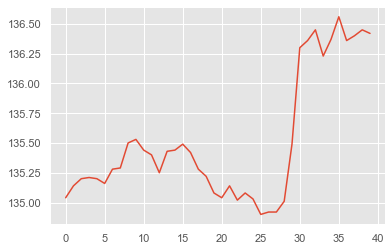

no_event no_event 1


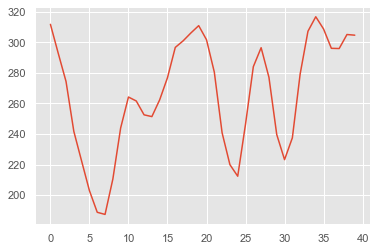

no_event no_event 2


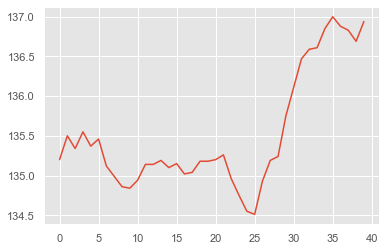

no_event no_event 2


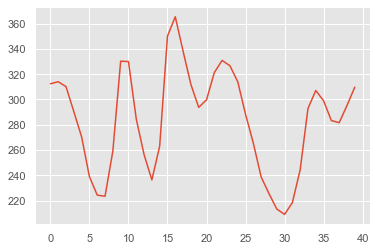

no_event no_event 1


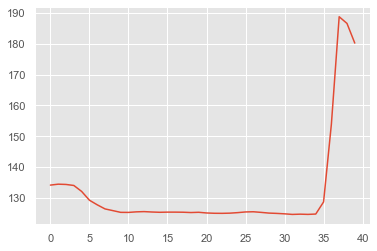

no_event no_event 2


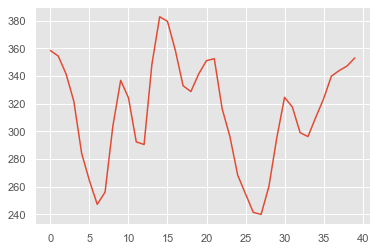

no_event no_event 2


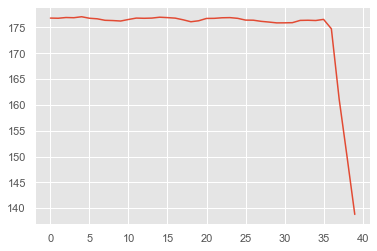

no_event no_event 2


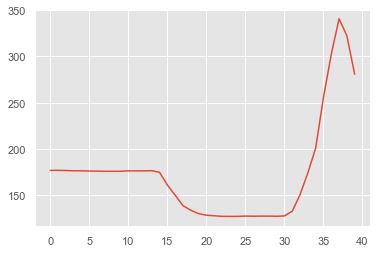

no_event no_event 2


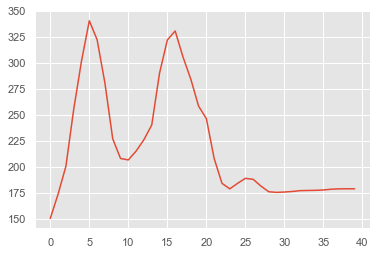

no_event no_event 2


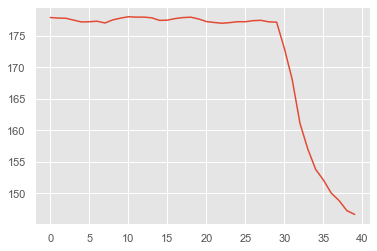

no_event no_event 2


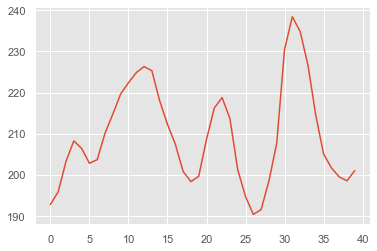

no_event no_event 2


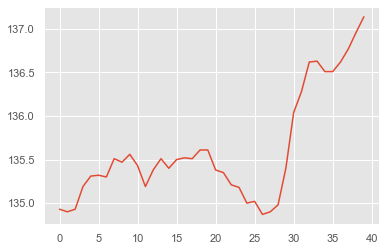

no_event no_event 1


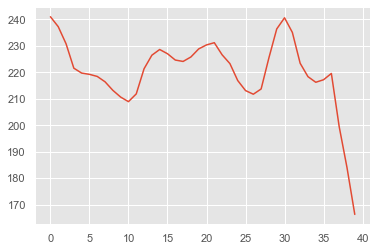

no_event no_event 2


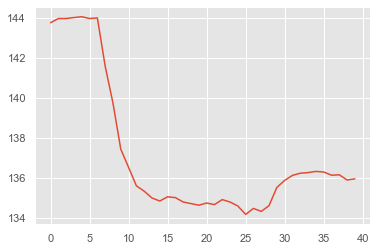

no_event no_event 1


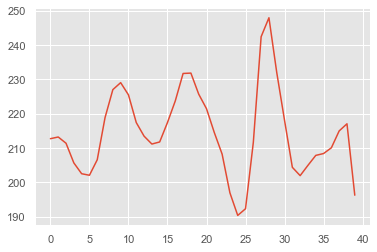

no_event no_event 2


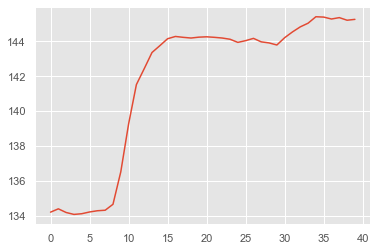

no_event no_event 2


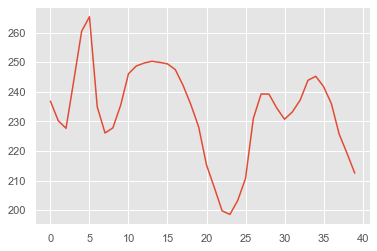

no_event no_event 1


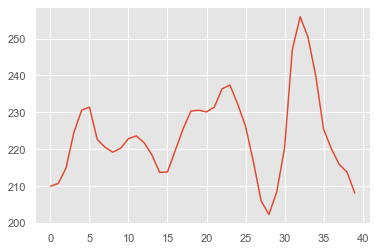

no_event no_event 2


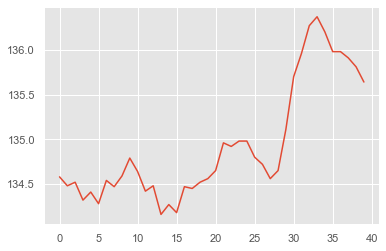

no_event no_event 1


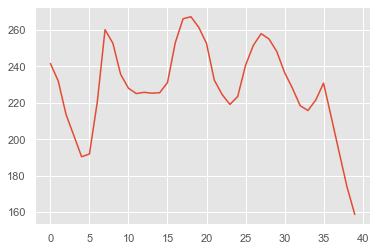

no_event no_event 2


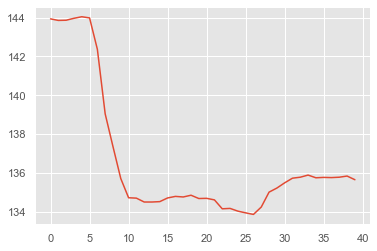

no_event no_event 1


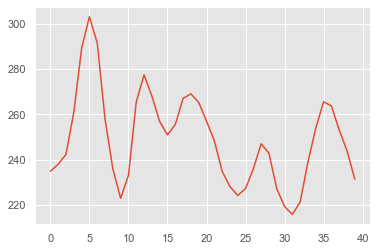

no_event no_event 2


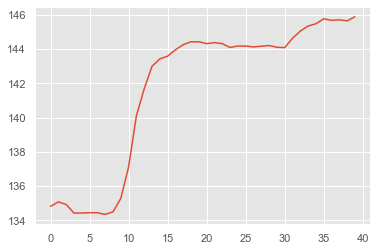

no_event no_event 2


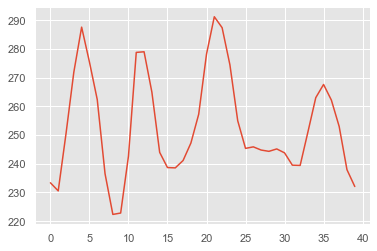

no_event no_event 2


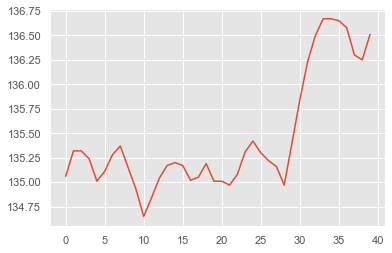

no_event no_event 1


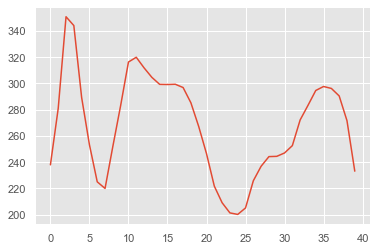

no_event no_event 2


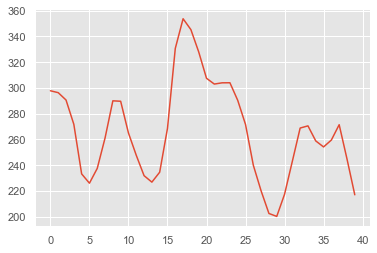

no_event no_event 1


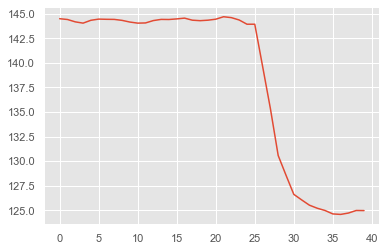

no_event no_event 1


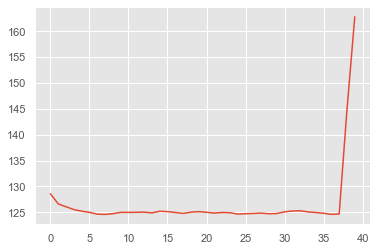

no_event no_event 2


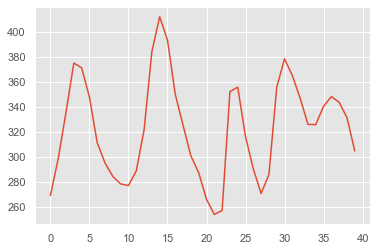

no_event no_event 2


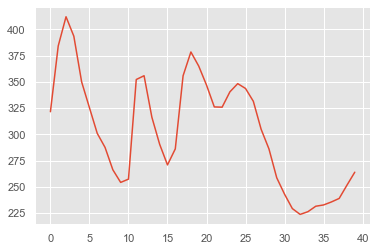

no_event no_event 2


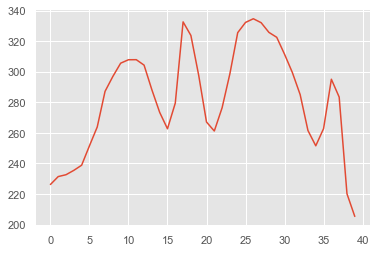

no_event no_event 2


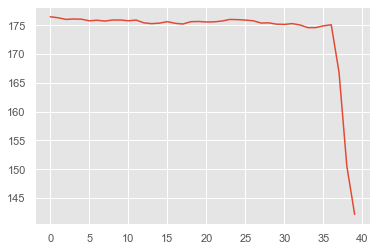

no_event no_event 2


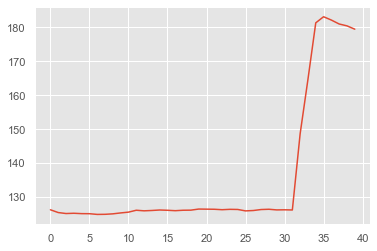

no_event no_event 1


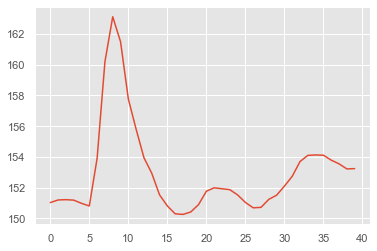

no_event no_event 1


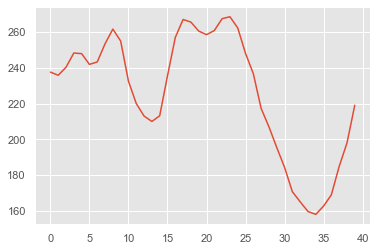

no_event no_event 2


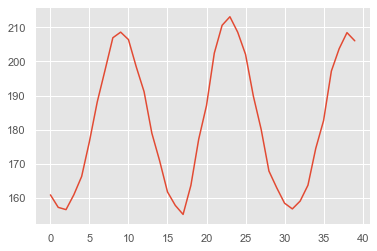

no_event no_event 2


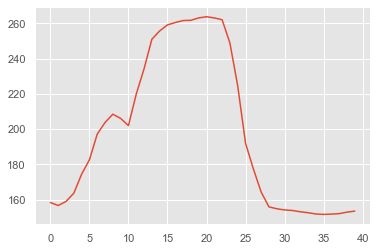

no_event no_event 2


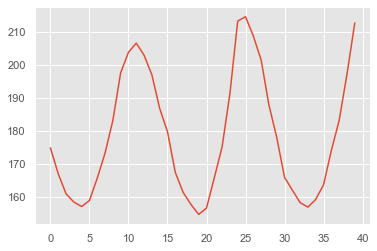

no_event no_event 2


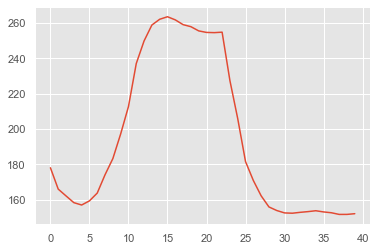

no_event no_event 1


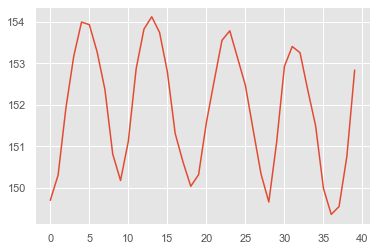

no_event no_event 2


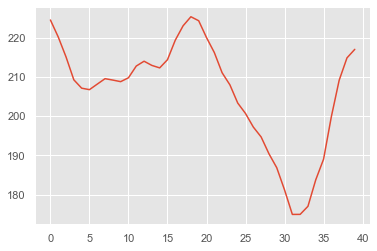

no_event no_event 2


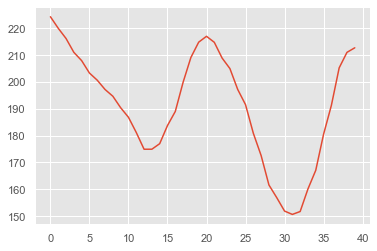

no_event no_event 1


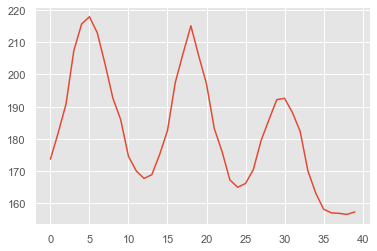

no_event no_event 1


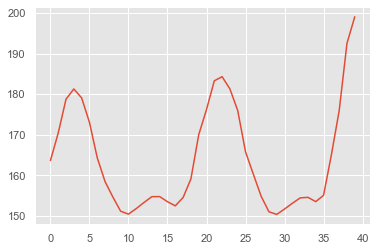

no_event no_event 1


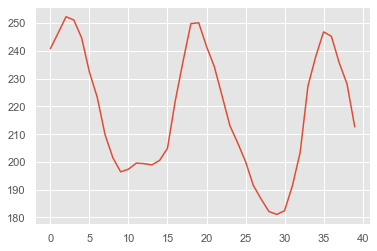

no_event no_event 1


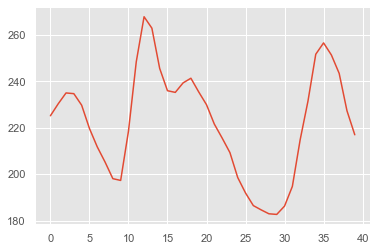

no_event no_event 2


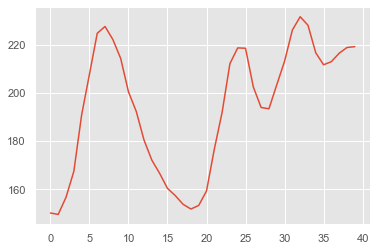

no_event no_event 2


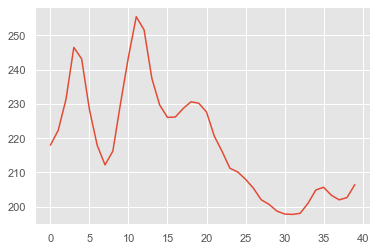

no_event no_event 2


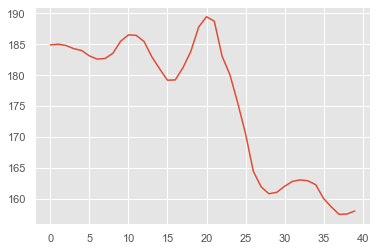

no_event no_event 1


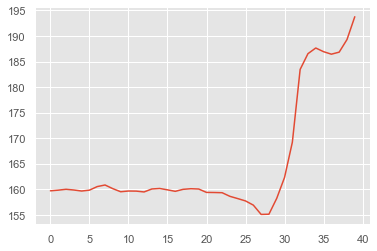

no_event no_event 1


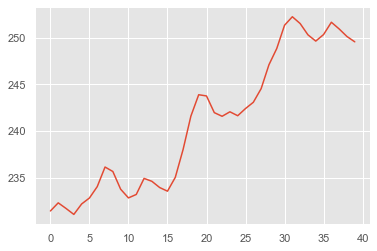

no_event no_event 2


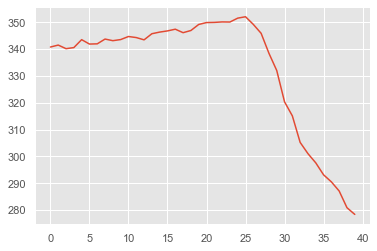

no_event no_event 1


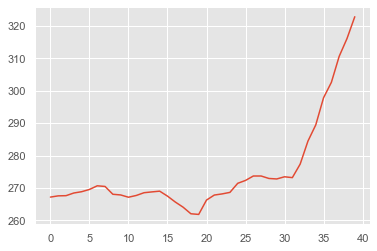

no_event no_event 2


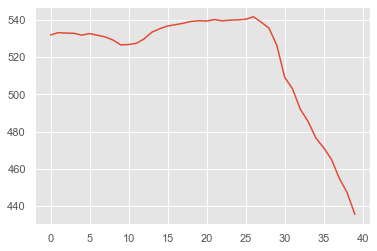

no_event no_event 2


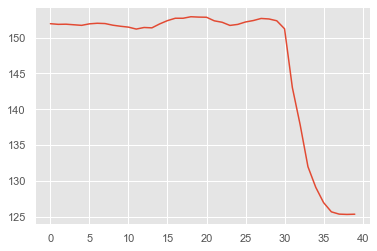

no_event no_event 1


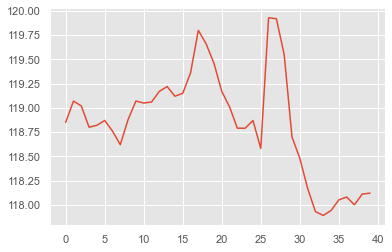

no_event no_event 2


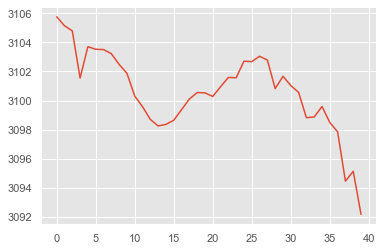

no_event no_event 2


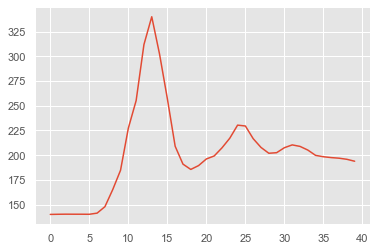

no_event no_event 1


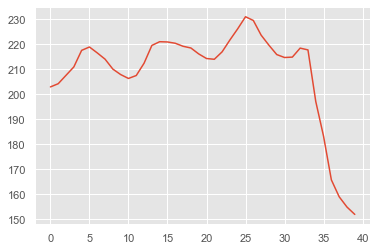

no_event no_event 2


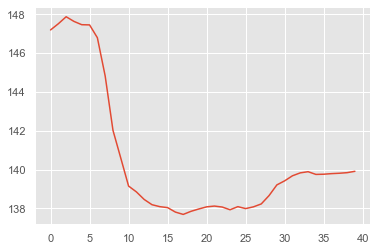

no_event no_event 1


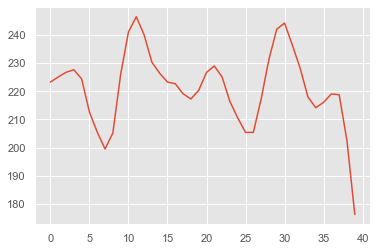

no_event no_event 2


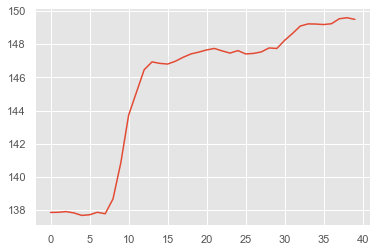

no_event no_event 1


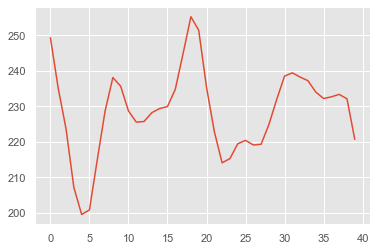

no_event no_event 2


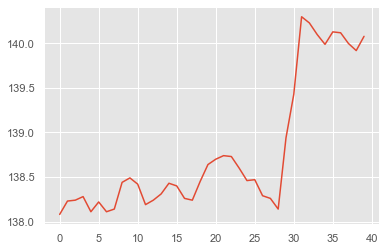

no_event no_event 1


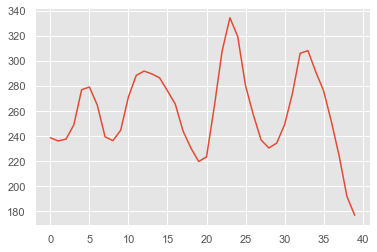

no_event no_event 2


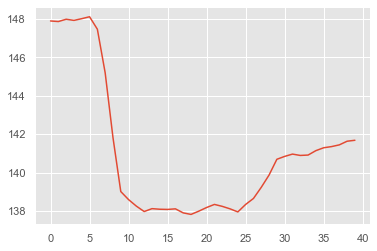

no_event no_event 2


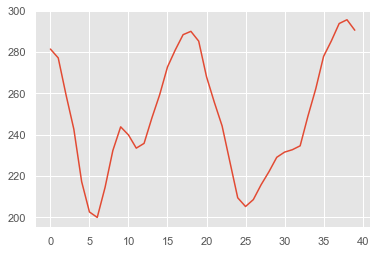

no_event no_event 1


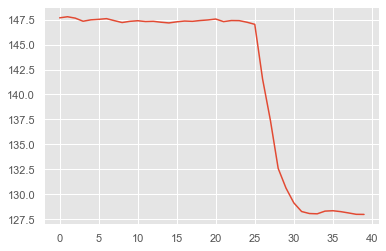

no_event no_event 1


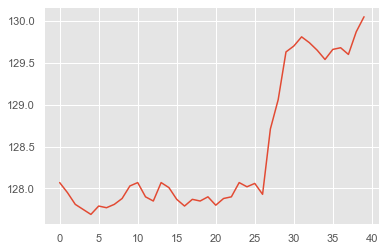

no_event no_event 1


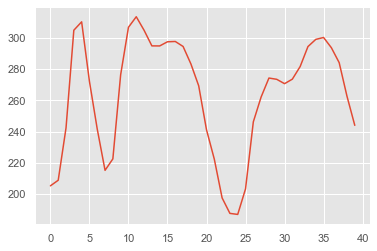

no_event no_event 2


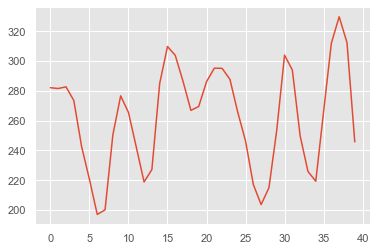

no_event no_event 1


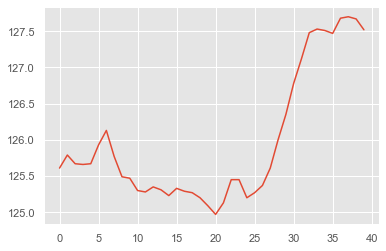

no_event no_event 1


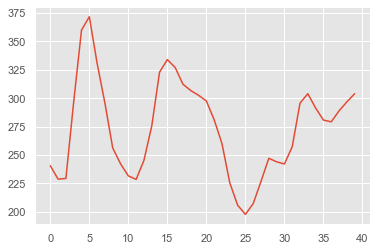

no_event no_event 2


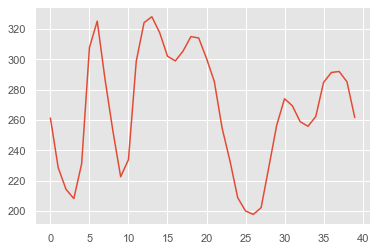

no_event no_event 2


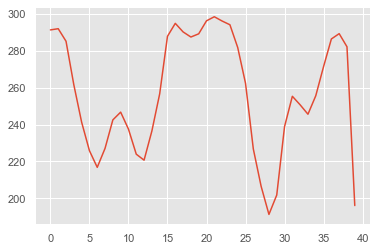

no_event no_event 1


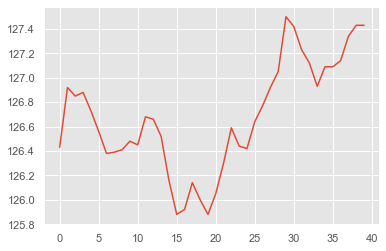

no_event no_event 1


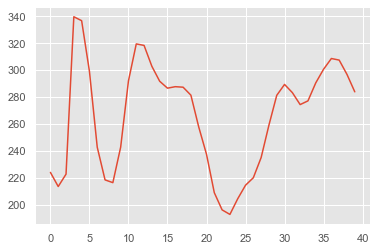

no_event no_event 2


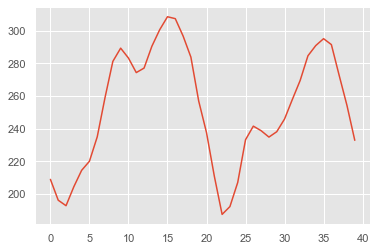

no_event no_event 2


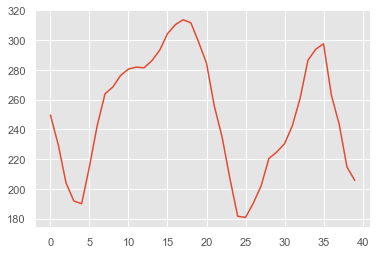

no_event no_event 2


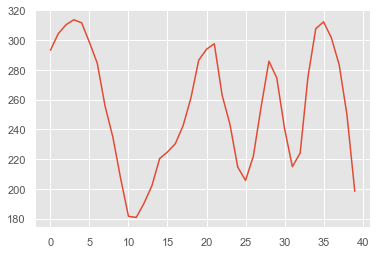

no_event no_event 1


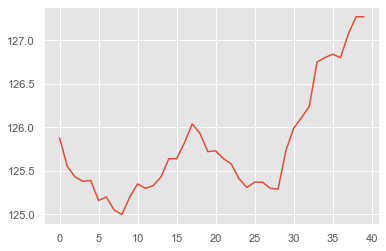

no_event no_event 2


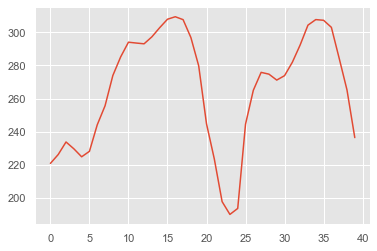

no_event no_event 2


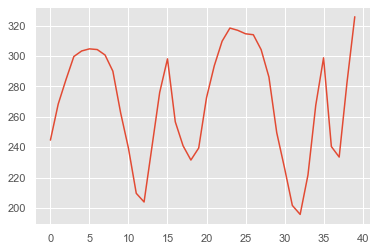

no_event no_event 2


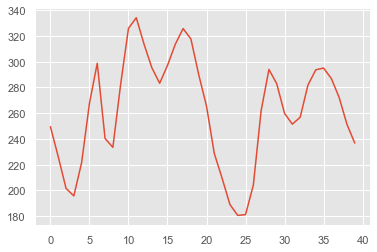

no_event no_event 2


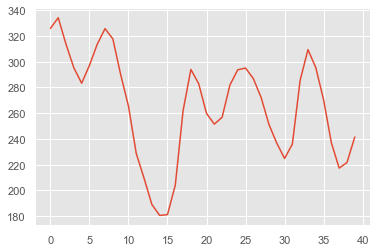

no_event no_event 1


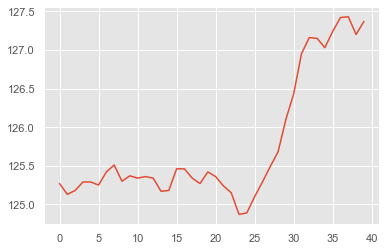

no_event no_event 1


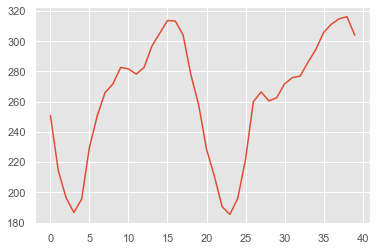

no_event no_event 2


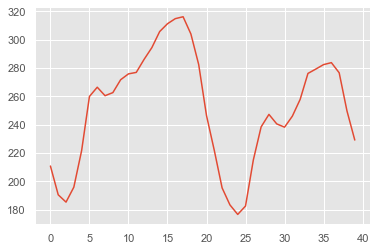

no_event no_event 2


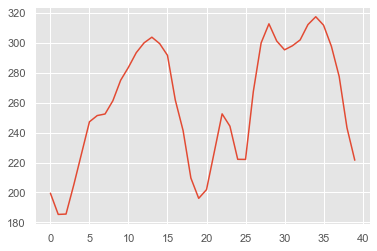

no_event no_event 1


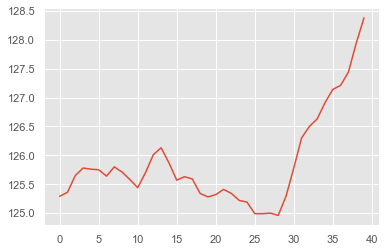

no_event no_event 1


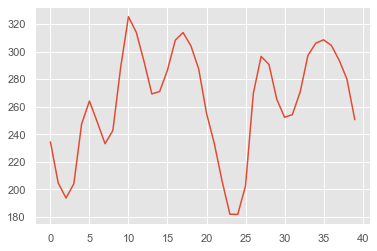

no_event no_event 2


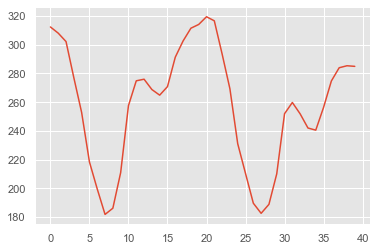

no_event no_event 1


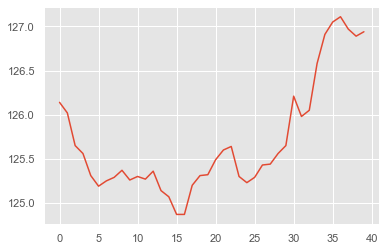

no_event no_event 2


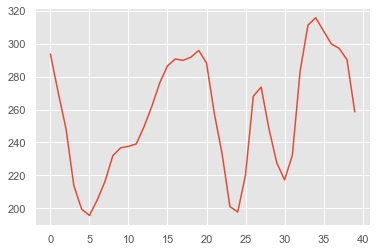

no_event no_event 1


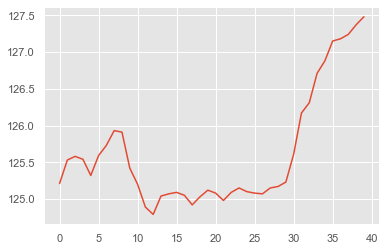

no_event no_event 1


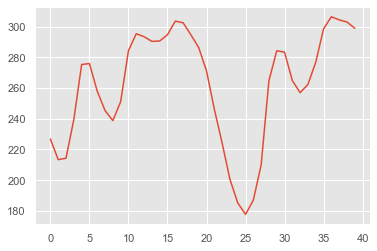

no_event no_event 2


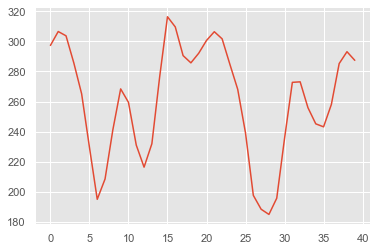

no_event no_event 1


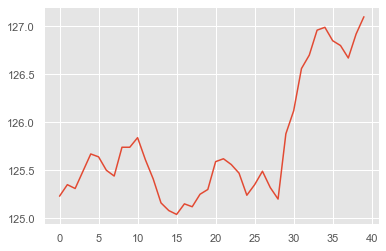

no_event no_event 1


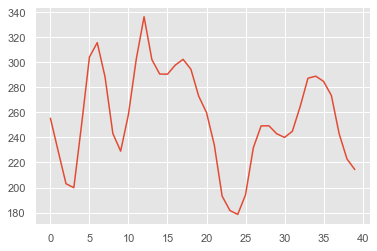

no_event no_event 2


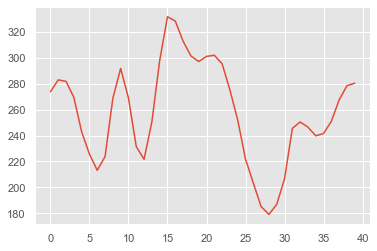

no_event no_event 2


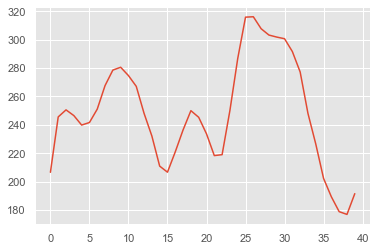

no_event no_event 1


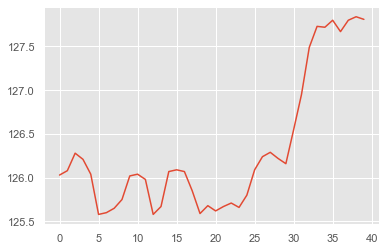

no_event no_event 2


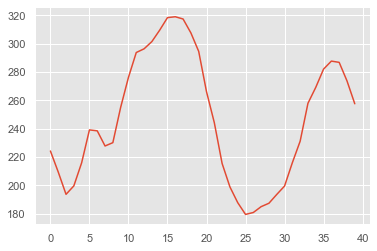

no_event no_event 2


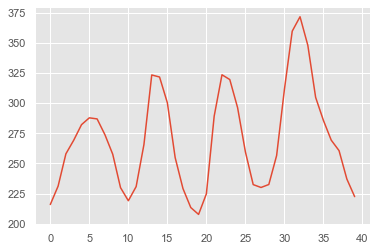

no_event no_event 2


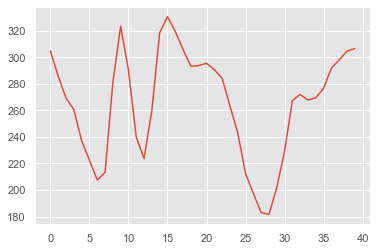

no_event no_event 2


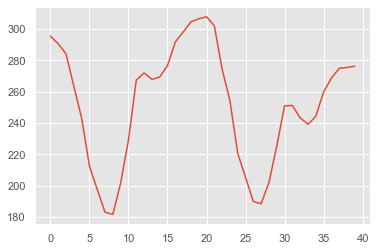

no_event no_event 1


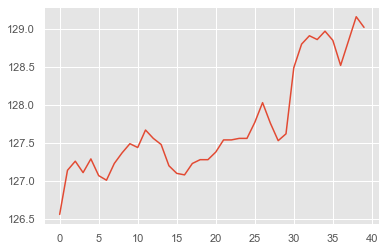

no_event no_event 2


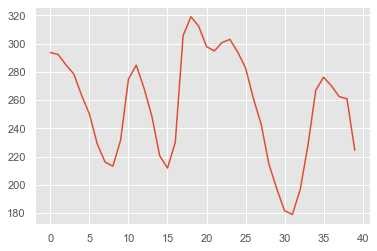

no_event no_event 1


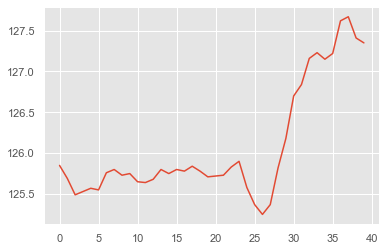

no_event no_event 1


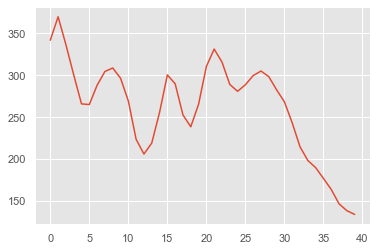

no_event no_event 1


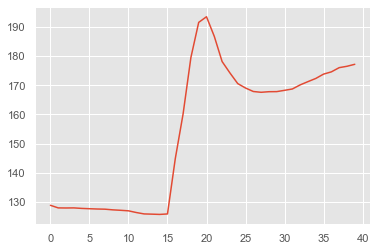

no_event no_event 2


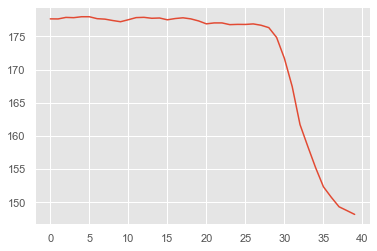

no_event no_event 2


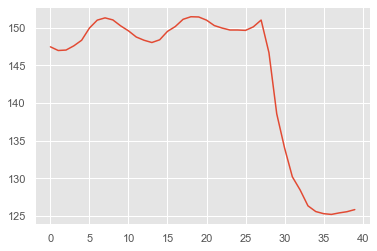

no_event no_event 1


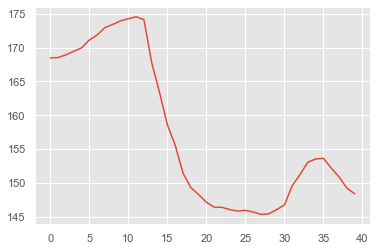

no_event no_event 1


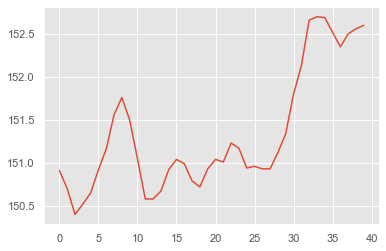

no_event no_event 2


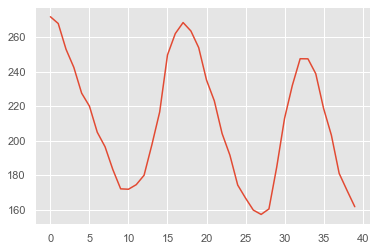

no_event no_event 2


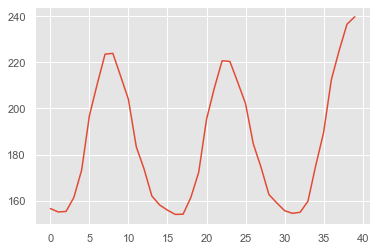

no_event no_event 1


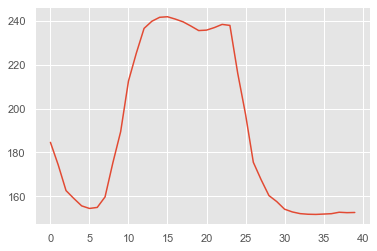

no_event no_event 1


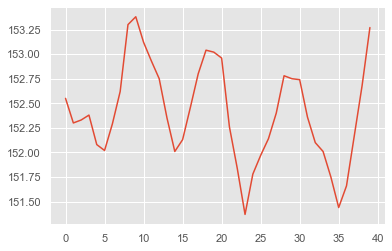

no_event no_event 2


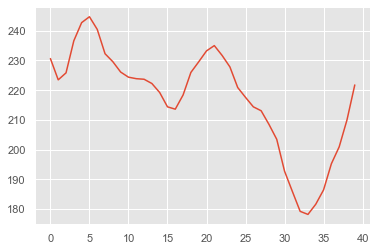

no_event no_event 2


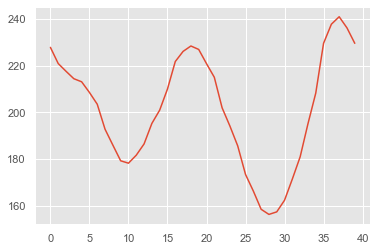

no_event no_event 1


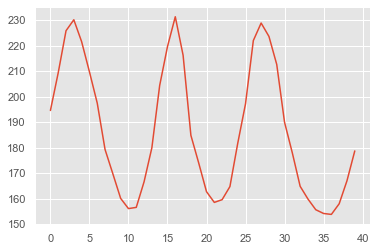

no_event no_event 1


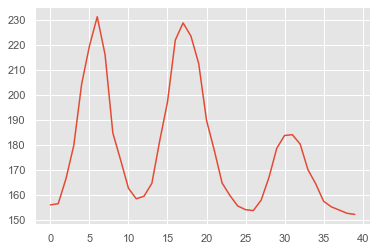

no_event no_event 1


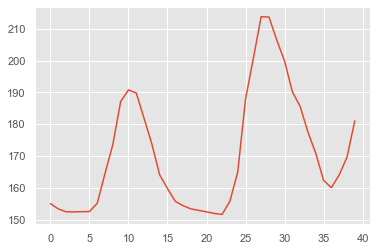

no_event no_event 1


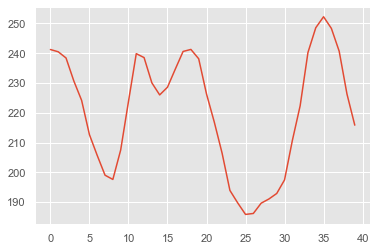

no_event no_event 1


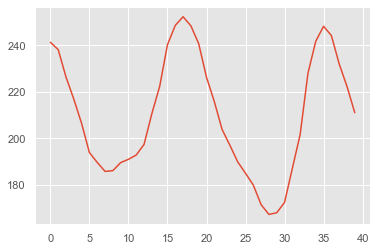

no_event no_event 1


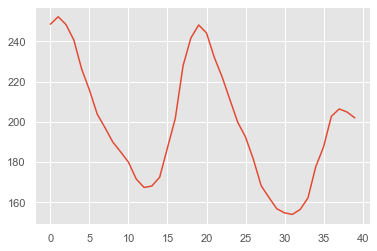

no_event no_event 1


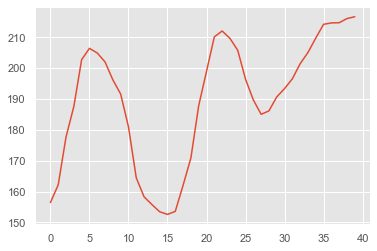

no_event no_event 2


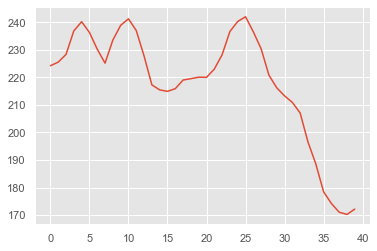

no_event no_event 2


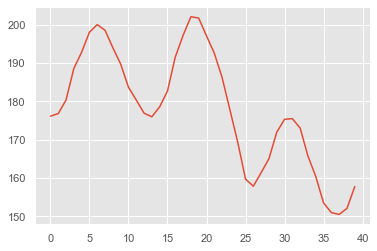

no_event no_event 1


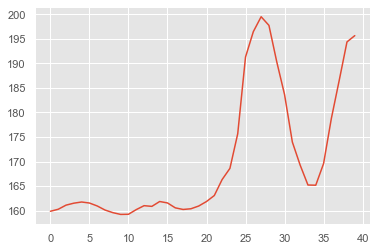

no_event no_event 1


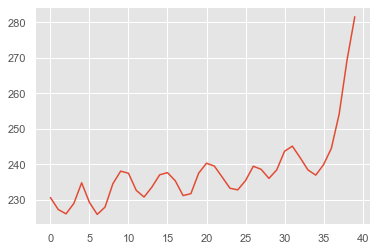

no_event no_event 1


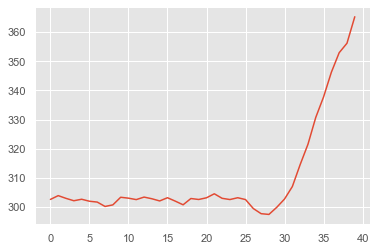

no_event no_event 2


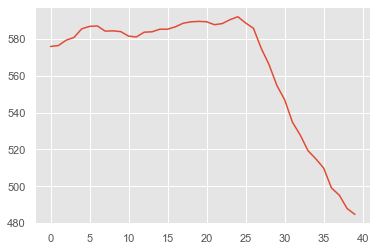

no_event no_event 1


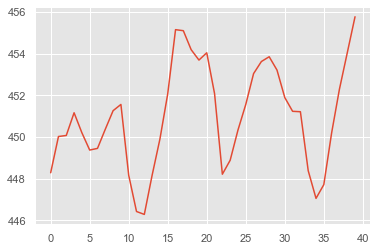

no_event no_event 2


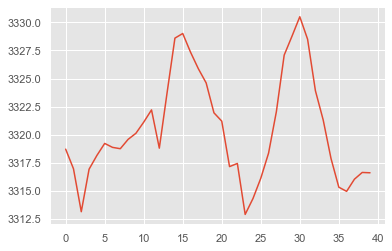

no_event no_event 2


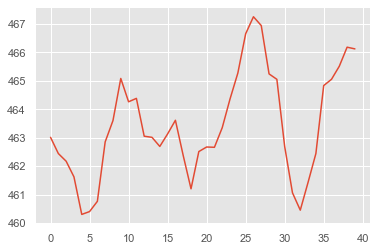

no_event no_event 1


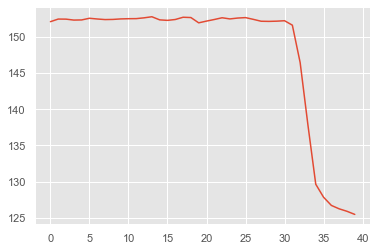

no_event no_event 1


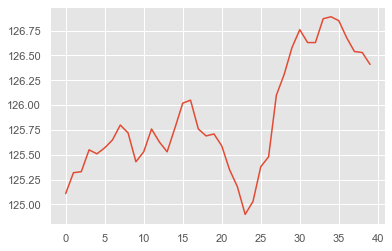

no_event no_event 2


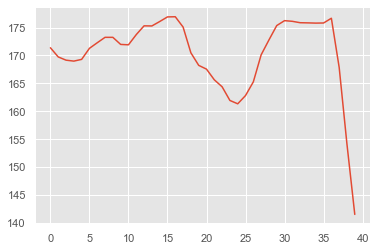

no_event no_event 1


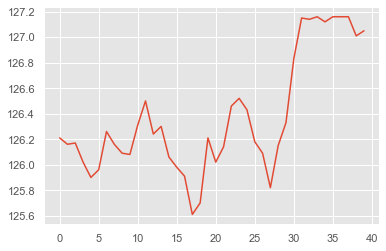

no_event no_event 2


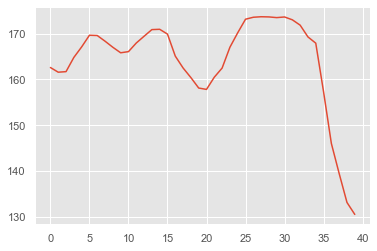

no_event no_event 1


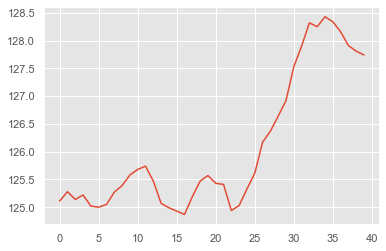

no_event no_event 2


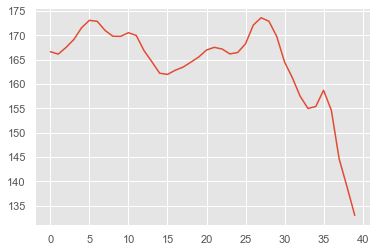

no_event no_event 1


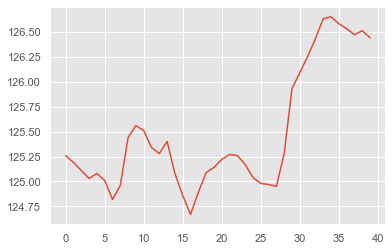

no_event no_event 2


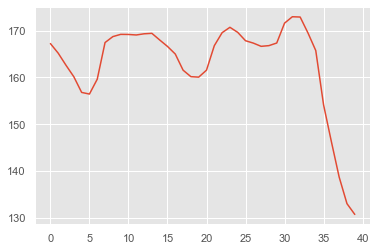

no_event no_event 1


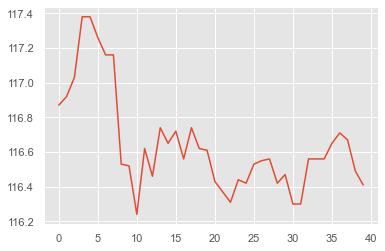

no_event no_event 2


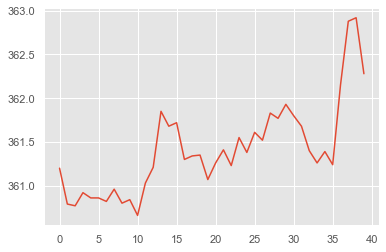

no_event no_event 1


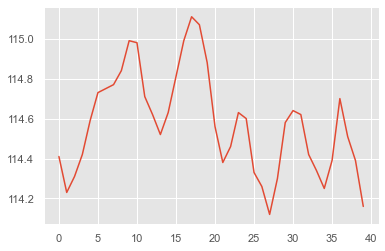

no_event no_event 2


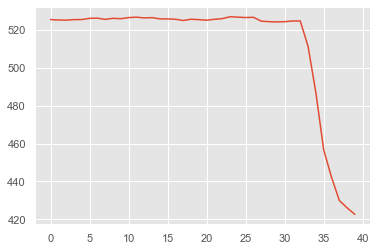

no_event no_event 2


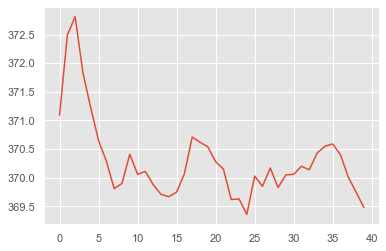

no_event no_event 1


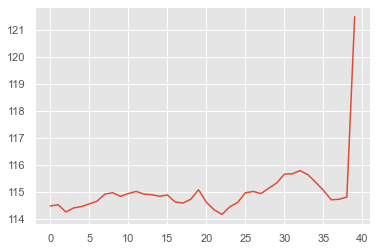

no_event no_event 1


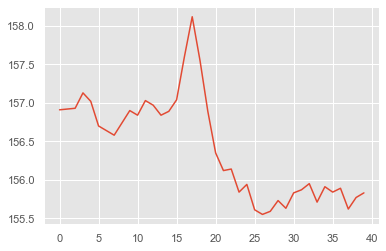

no_event no_event 2


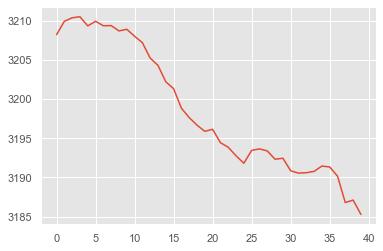

no_event no_event 1


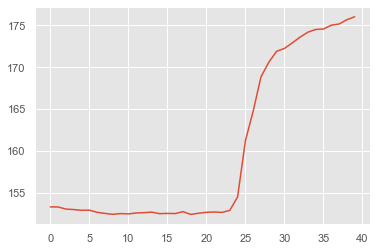

no_event no_event 1


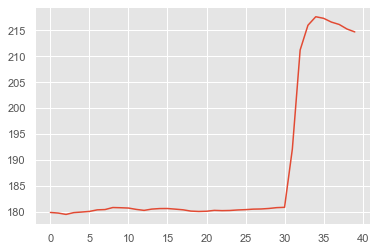

no_event no_event 2


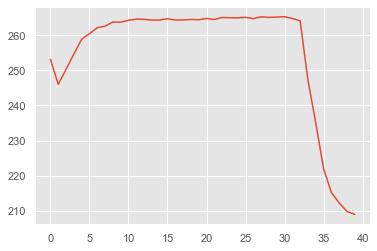

no_event no_event 2


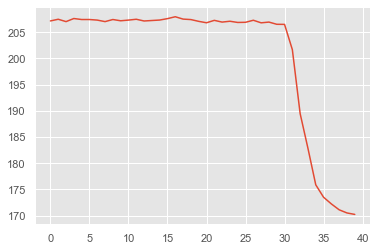

no_event no_event 2


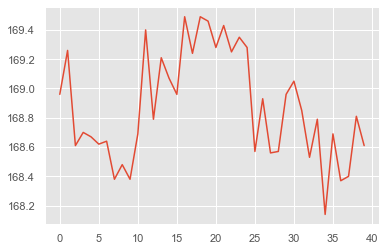

no_event no_event 1


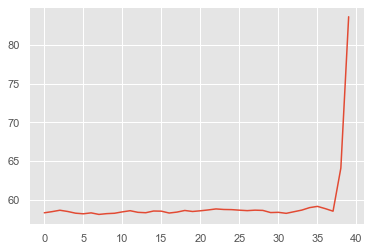

no_event no_event 1


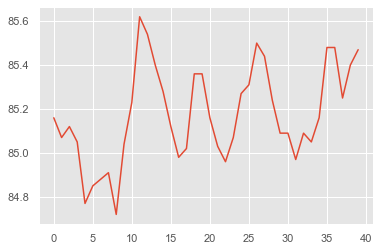

no_event no_event 2


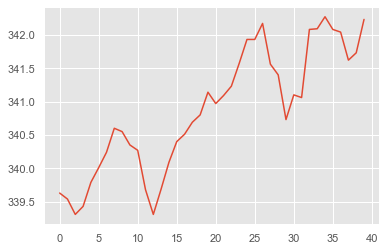

no_event no_event 2


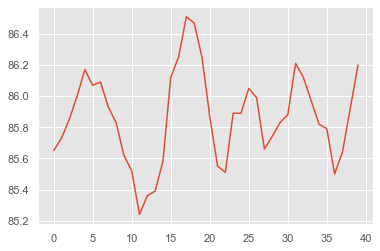

no_event Refrigerator_ON 1


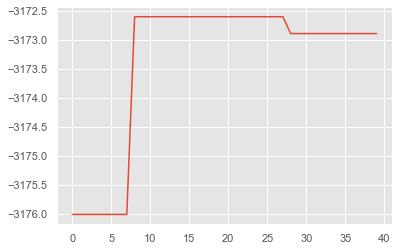

no_event no_event 1


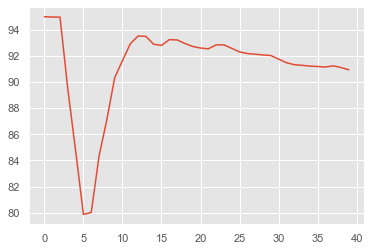

no_event no_event 2


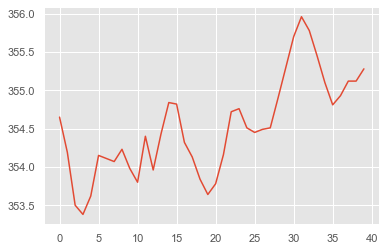

no_event no_event 1


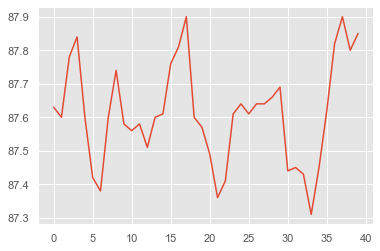

no_event no_event 2


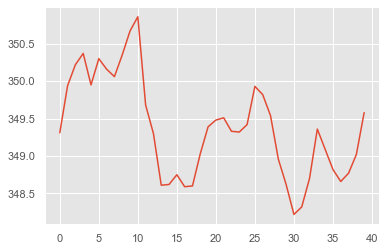

no_event no_event 1


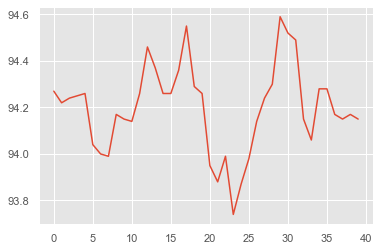

no_event no_event 2


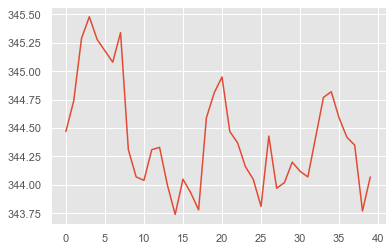

no_event no_event 1


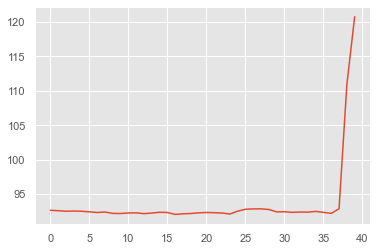

no_event no_event 1


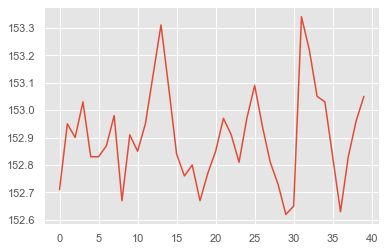

no_event no_event 2


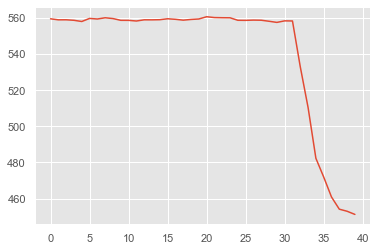

no_event no_event 2


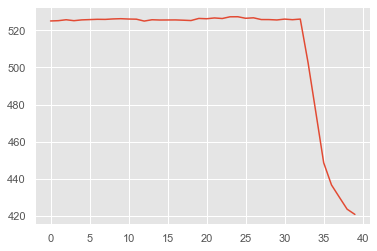

no_event no_event 1


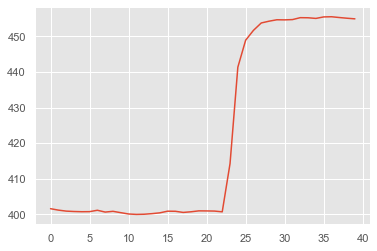

no_event no_event 2


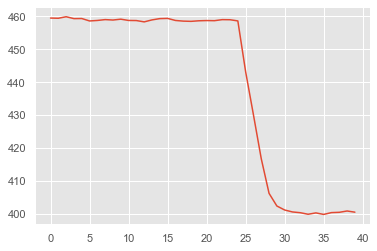

no_event no_event 1


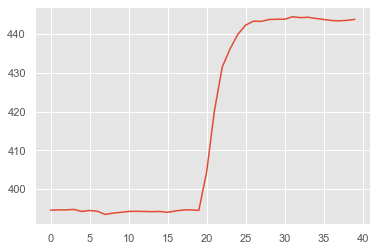

no_event no_event 2


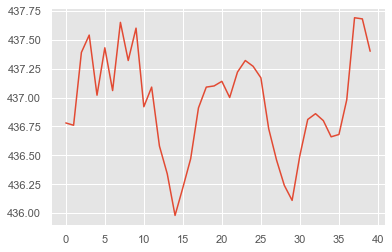

no_event no_event 1


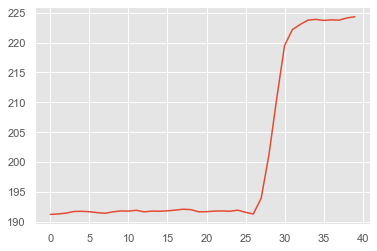

no_event no_event 1


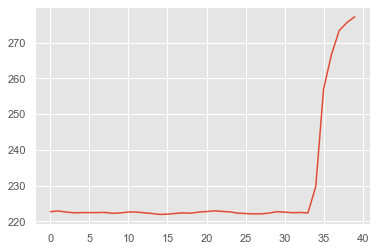

no_event no_event 2


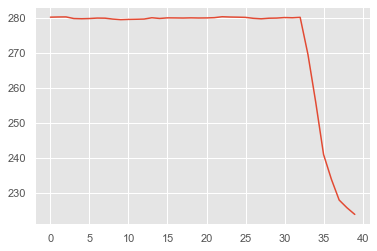

no_event no_event 1


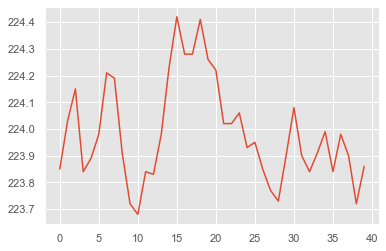

no_event no_event 2


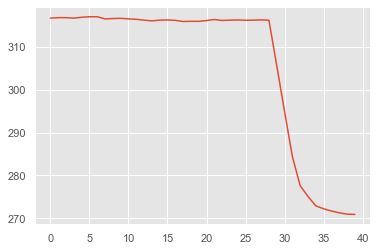

no_event no_event 2


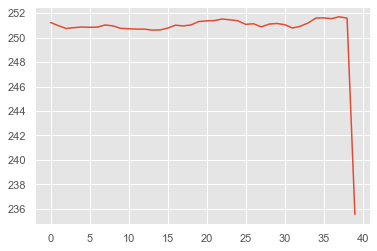

no_event no_event 1


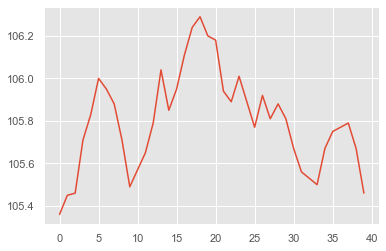

no_event no_event 2


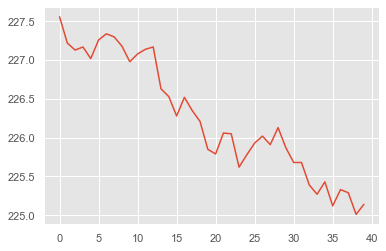

no_event no_event 1


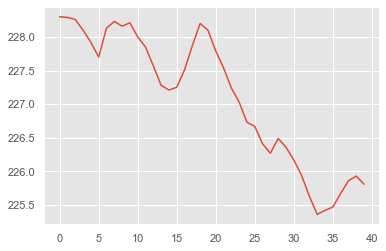

no_event no_event 2


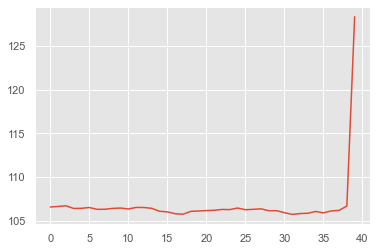

no_event no_event 2


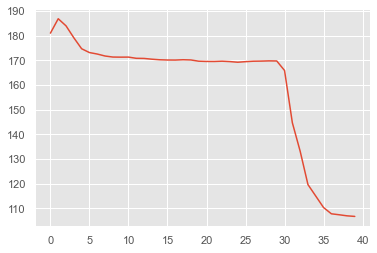

no_event no_event 2


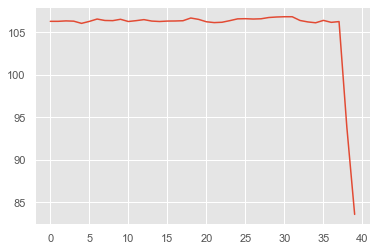

no_event no_event 1


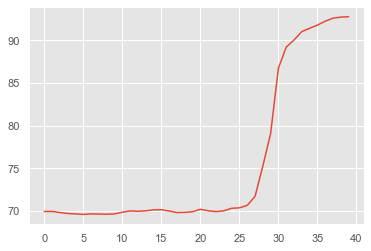

no_event no_event 1


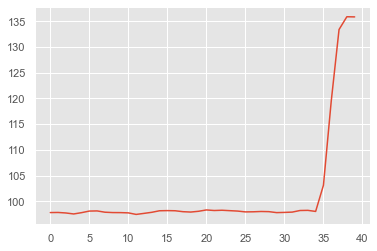

no_event no_event 1


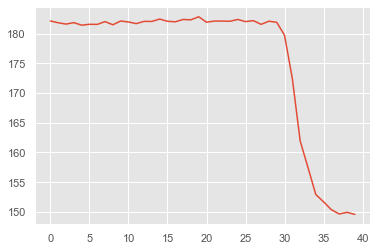

no_event no_event 2


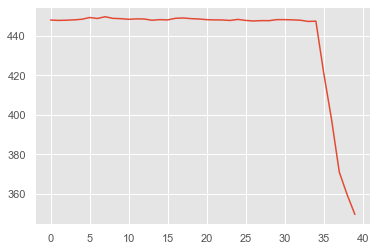

no_event no_event 2


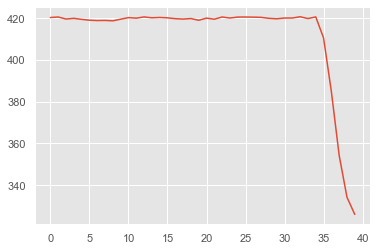

no_event no_event 1


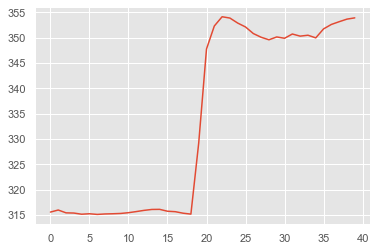

no_event no_event 2


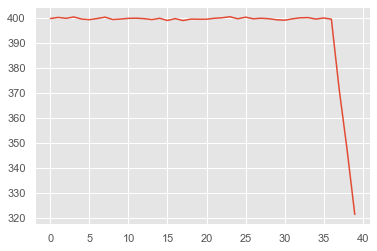

no_event no_event 1


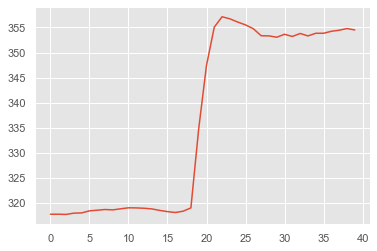

no_event no_event 2


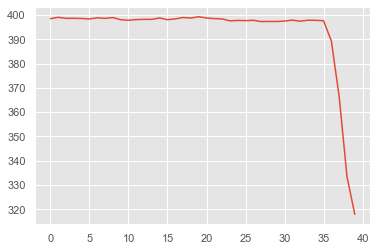

no_event no_event 1


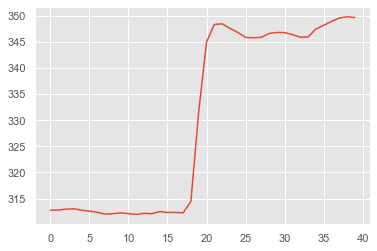

no_event no_event 2


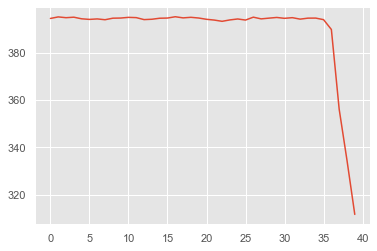

no_event no_event 2


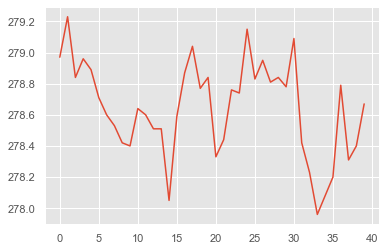

no_event no_event 2


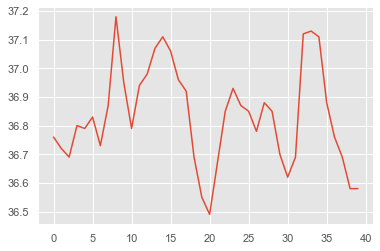

no_event no_event 1


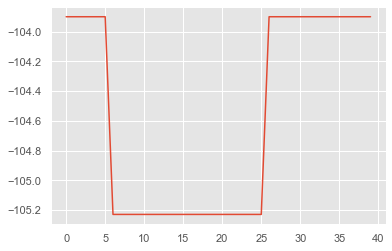

no_event no_event 1


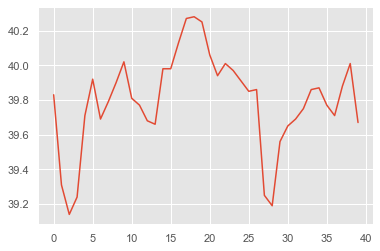

no_event no_event 2


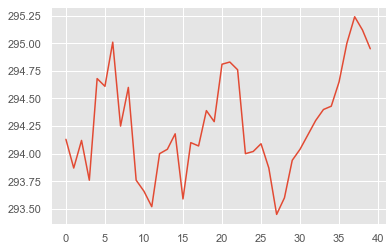

no_event no_event 1


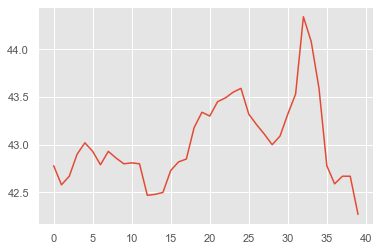

no_event no_event 2


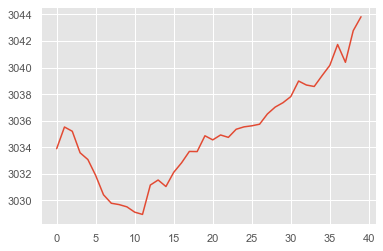

no_event no_event 1


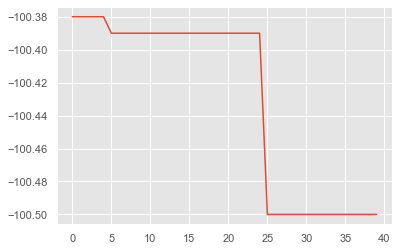

no_event no_event 1


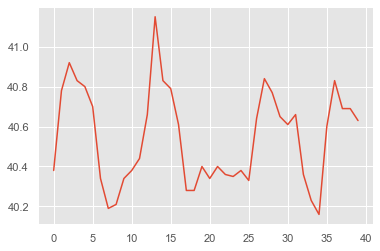

no_event no_event 2


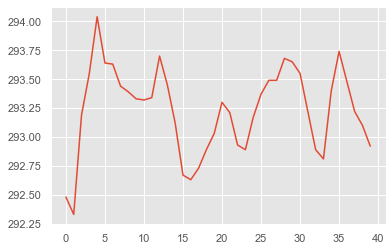

no_event no_event 1


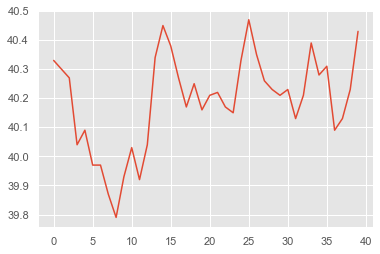

no_event no_event 2


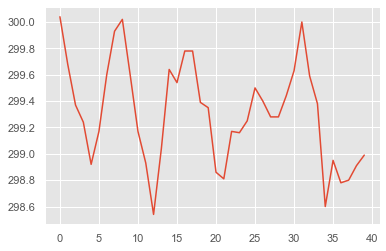

no_event no_event 1


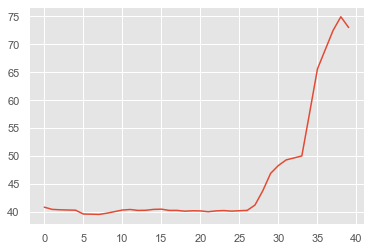

no_event no_event 1


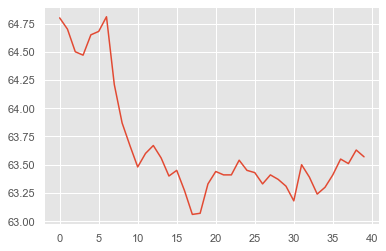

no_event no_event 1


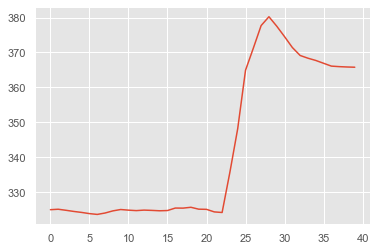

no_event no_event 2


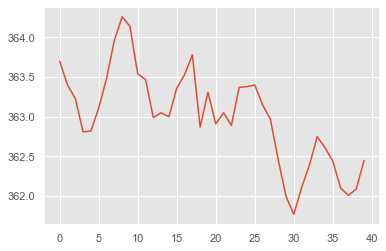

no_event no_event 1


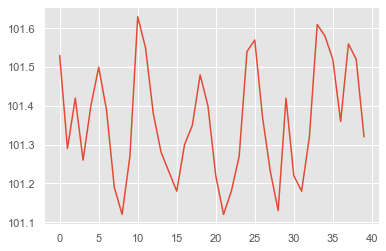

no_event no_event 1


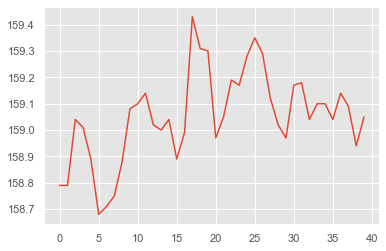

no_event no_event 2


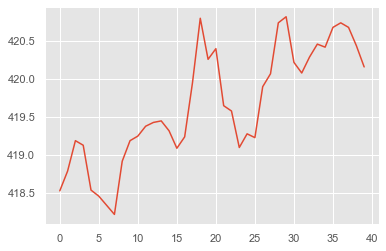

no_event no_event 1


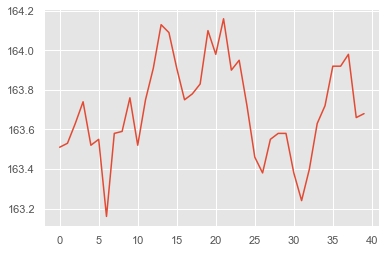

no_event no_event 1


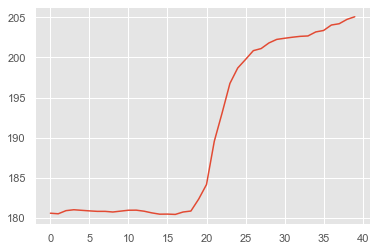

no_event no_event 1


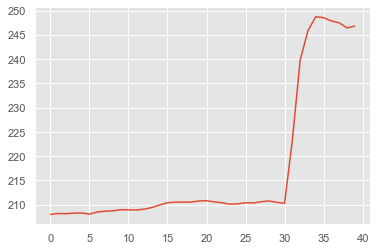

no_event no_event 1


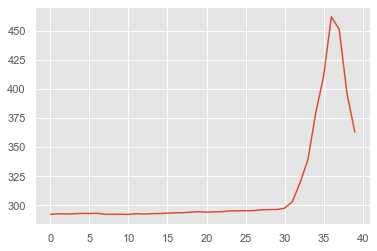

no_event no_event 2


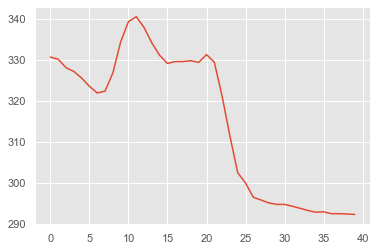

no_event no_event 1


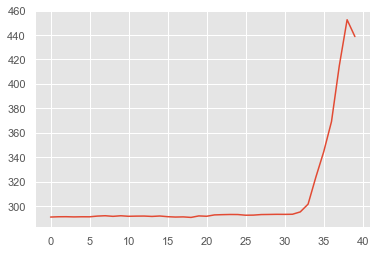

no_event no_event 2


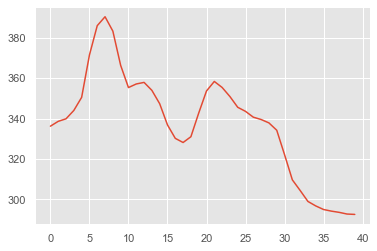

no_event no_event 1


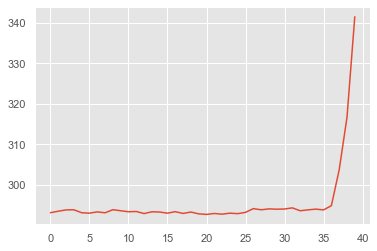

no_event no_event 2


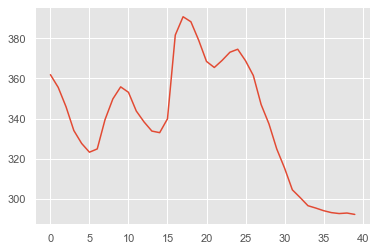

no_event no_event 1


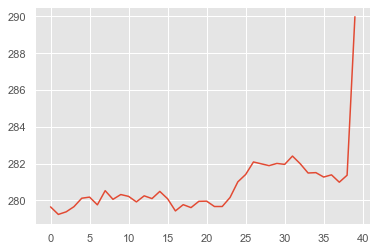

no_event no_event 2


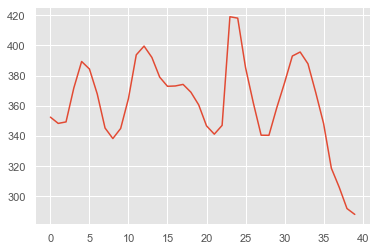

no_event no_event 1


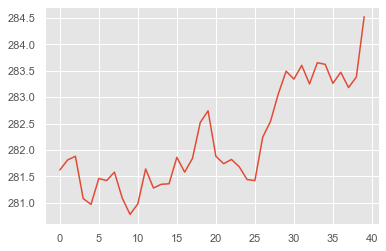

no_event no_event 2


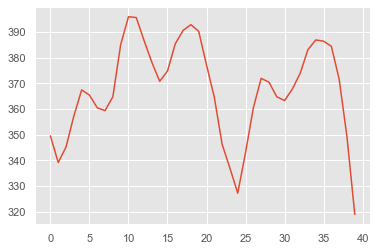

no_event no_event 1


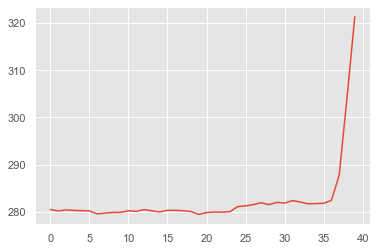

no_event no_event 2


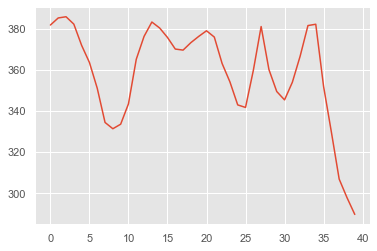

no_event no_event 2


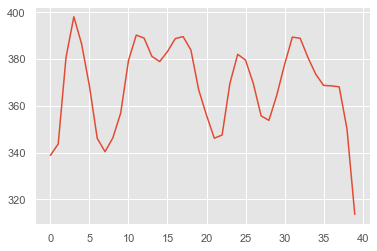

no_event no_event 2


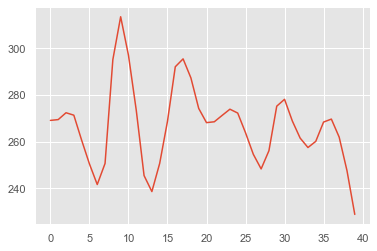

no_event no_event 1


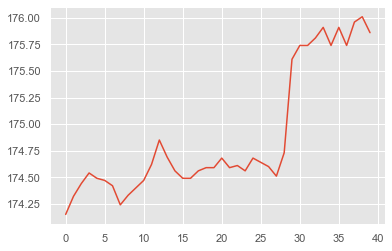

no_event no_event 2


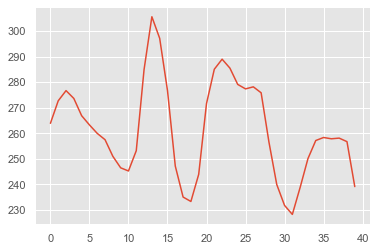

no_event no_event 1


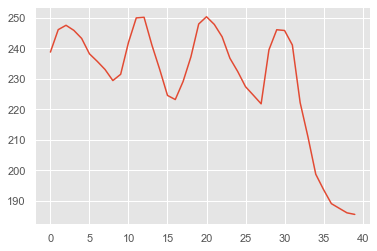

no_event no_event 1


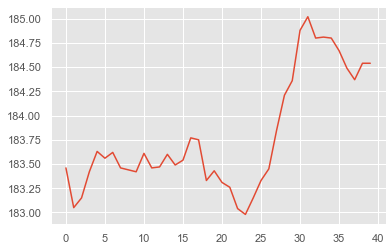

no_event no_event 1


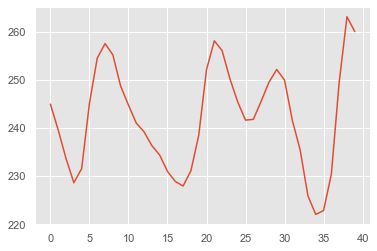

no_event no_event 2


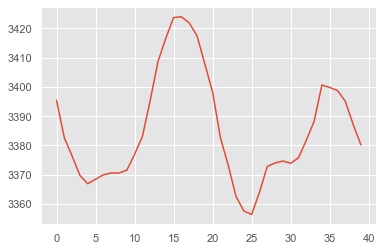

no_event no_event 2


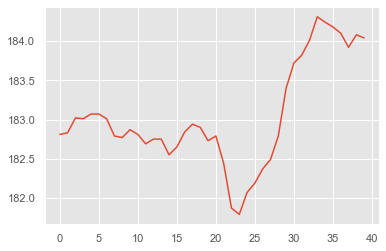

no_event no_event 1


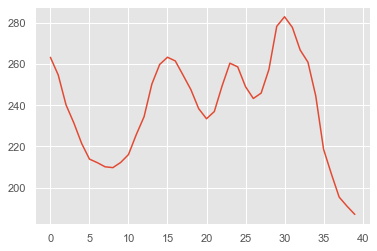

no_event no_event 2


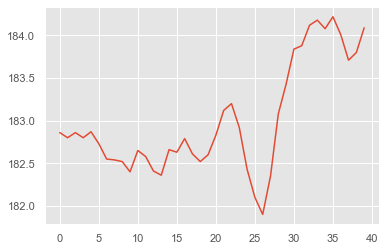

no_event no_event 2


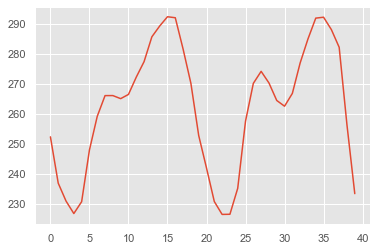

no_event no_event 2


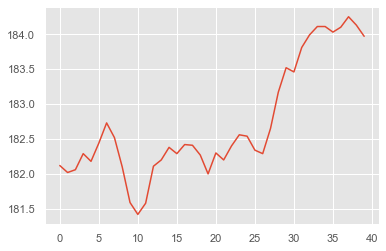

no_event no_event 1


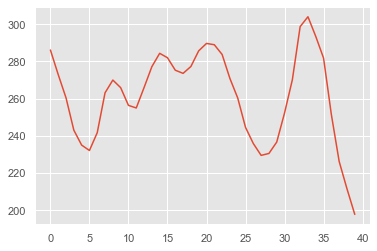

no_event no_event 1


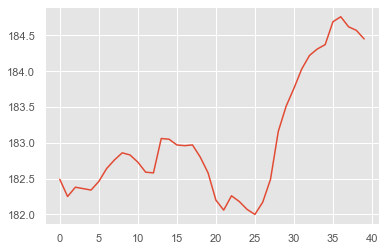

no_event no_event 1


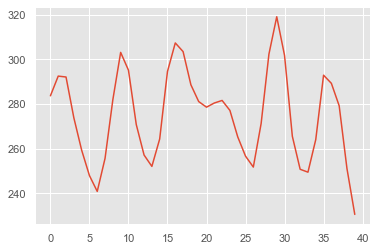

no_event no_event 1


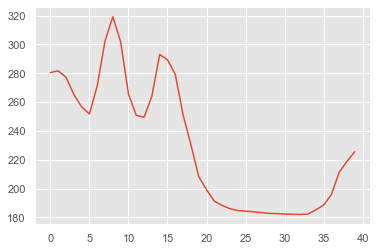

no_event no_event 2


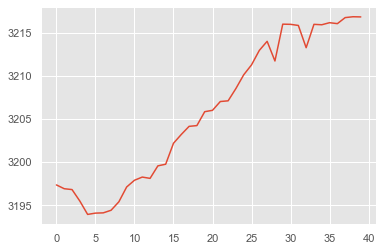

no_event no_event 2


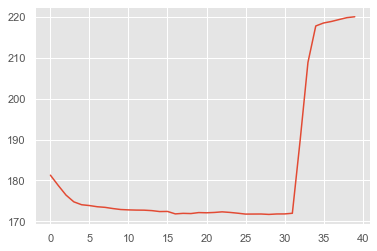

no_event no_event 2


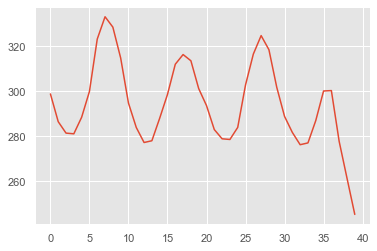

no_event no_event 2


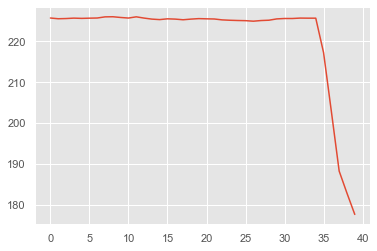

no_event no_event 2


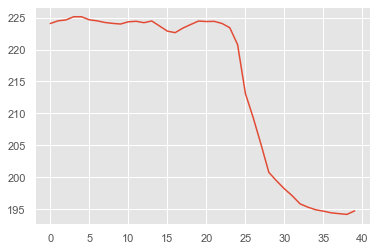

no_event no_event 1


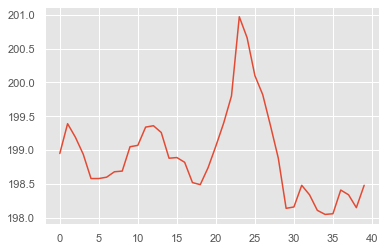

no_event no_event 2


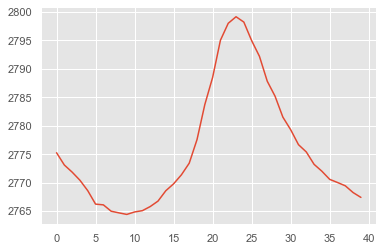

no_event no_event 2


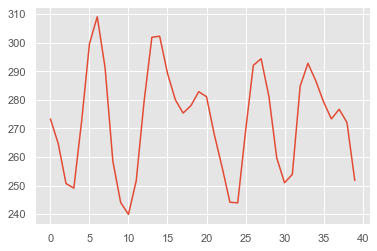

no_event no_event 2


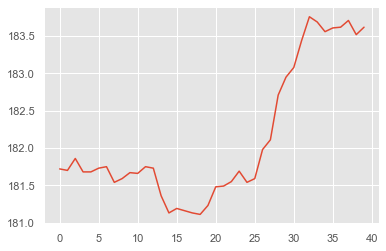

no_event no_event 2


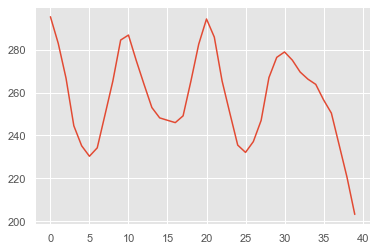

no_event no_event 2


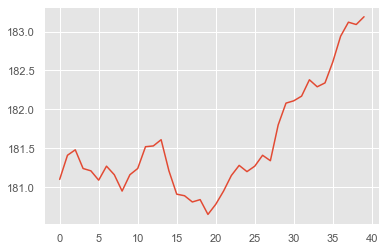

no_event no_event 1


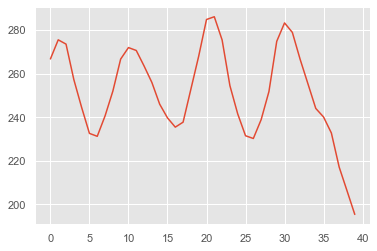

no_event no_event 2


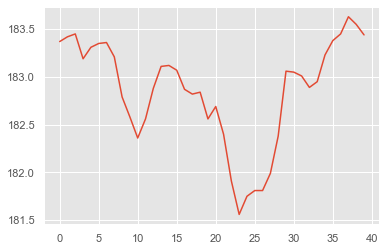

no_event no_event 2


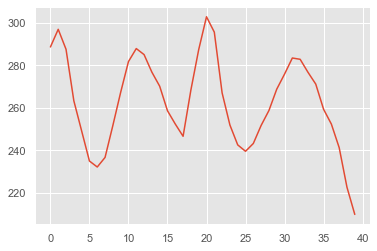

no_event no_event 1


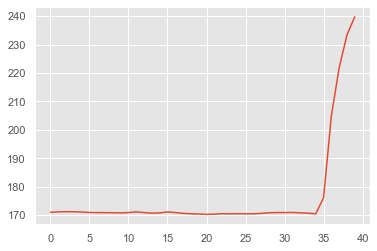

no_event no_event 2


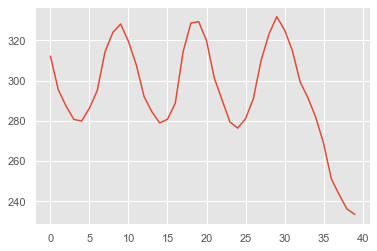

no_event no_event 2


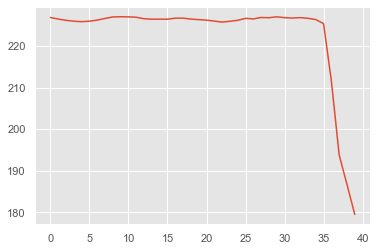

no_event no_event 2


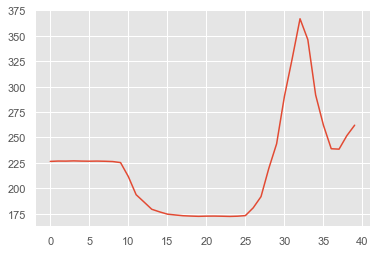

no_event no_event 2


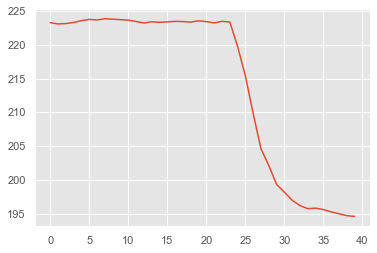

no_event no_event 1


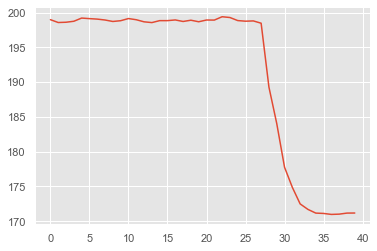

no_event no_event 2


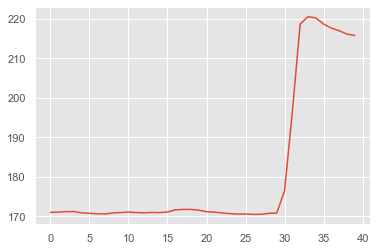

no_event no_event 1


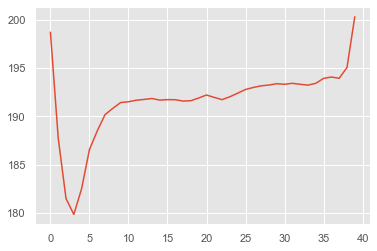

no_event no_event 2


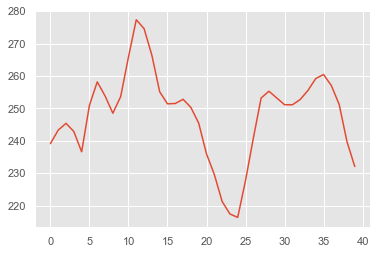

no_event no_event 2


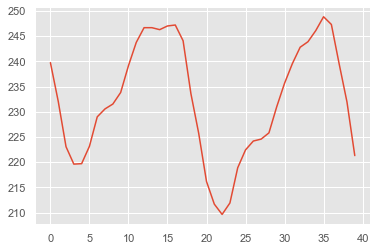

no_event no_event 1


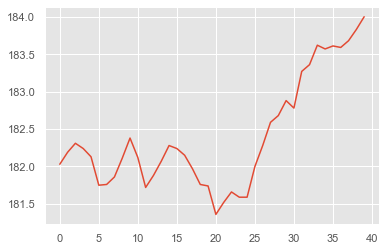

no_event no_event 1


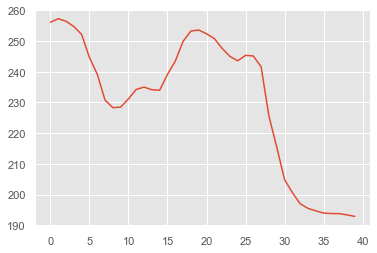

no_event no_event 2


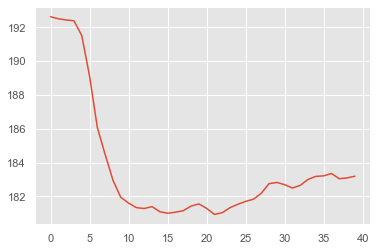

no_event no_event 1


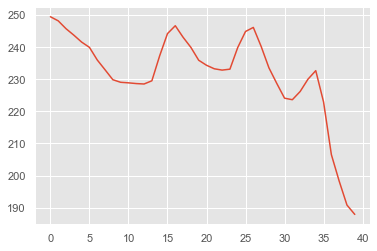

no_event no_event 2


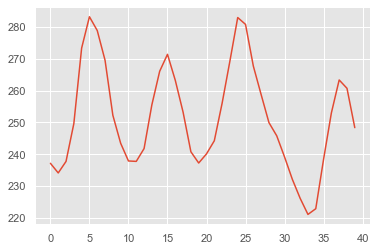

no_event no_event 2


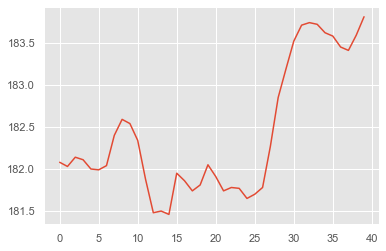

no_event no_event 1


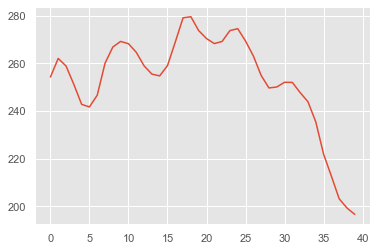

no_event no_event 2


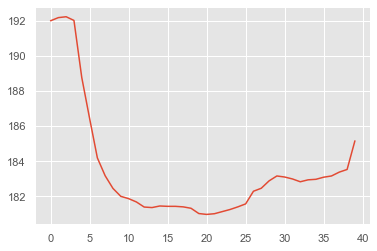

no_event no_event 1


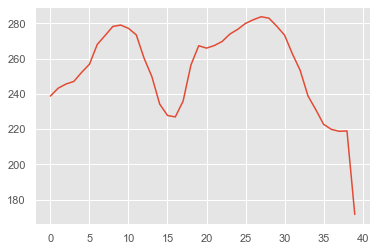

no_event no_event 2


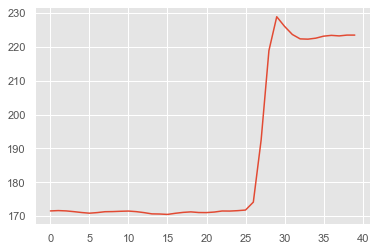

no_event no_event 1


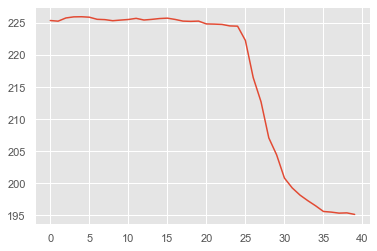

no_event no_event 1


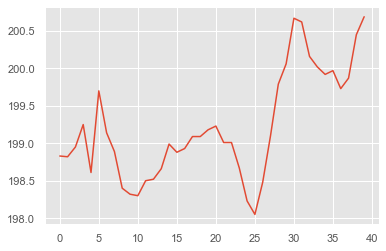

no_event no_event 2


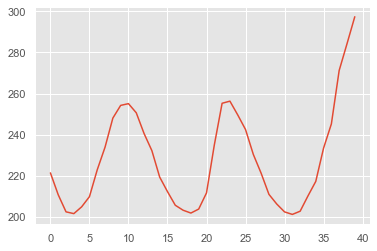

no_event no_event 2


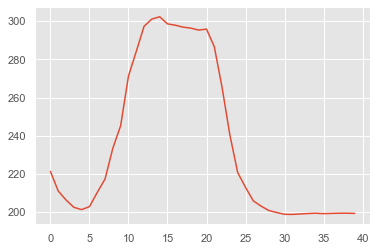

no_event no_event 1


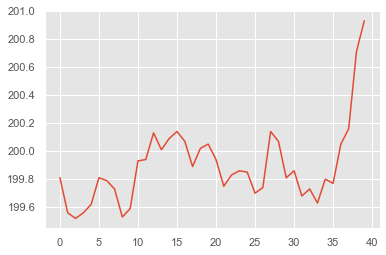

no_event no_event 2


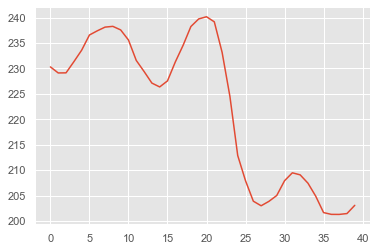

no_event no_event 1


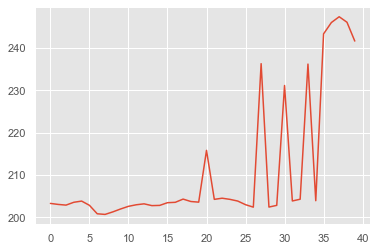

no_event no_event 1


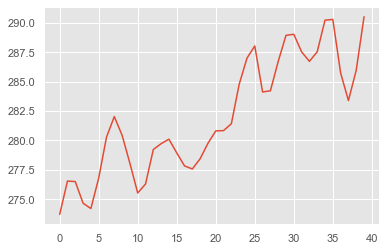

no_event no_event 2


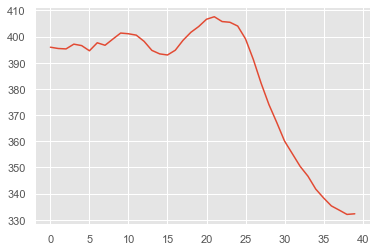

no_event no_event 1


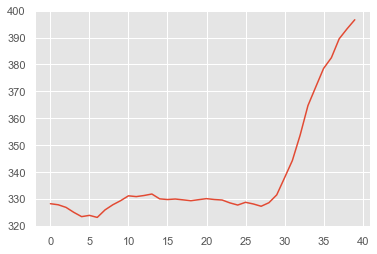

no_event no_event 2


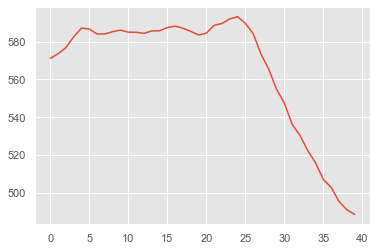

no_event no_event 2


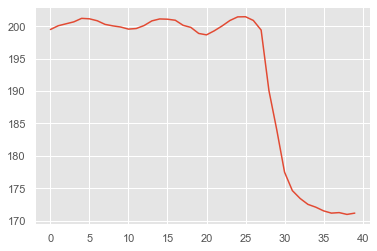

no_event no_event 1


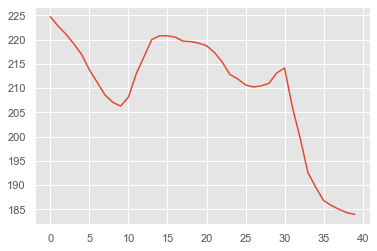

no_event no_event 1


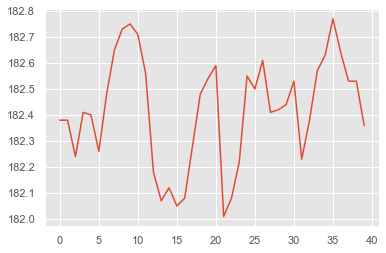

no_event no_event 1


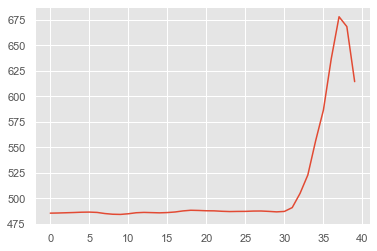

no_event no_event 2


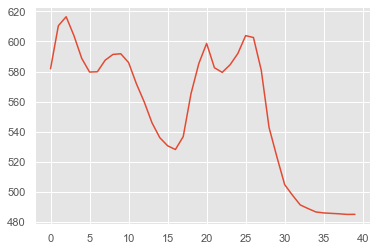

no_event no_event 1


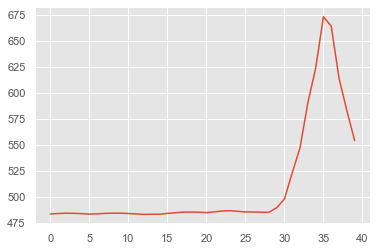

no_event no_event 2


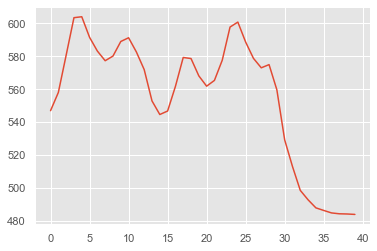

no_event no_event 1


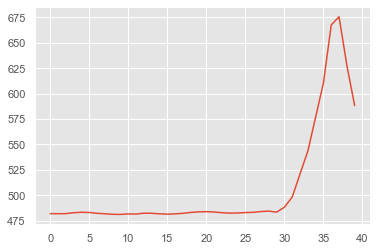

no_event no_event 2


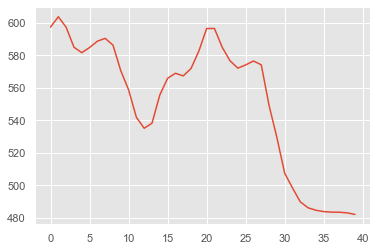

no_event no_event 1


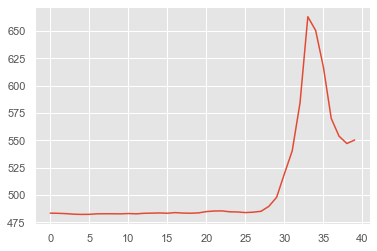

no_event no_event 2


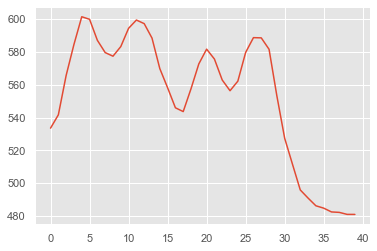

no_event no_event 1


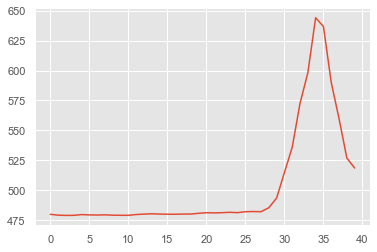

no_event no_event 2


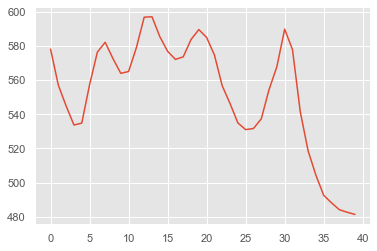

no_event no_event 1


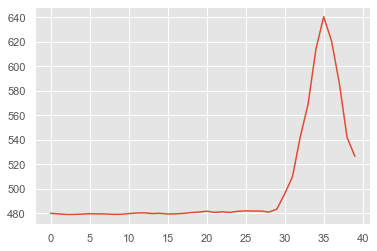

no_event no_event 2


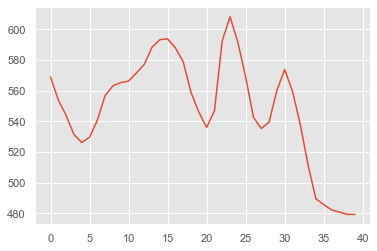

no_event no_event 1


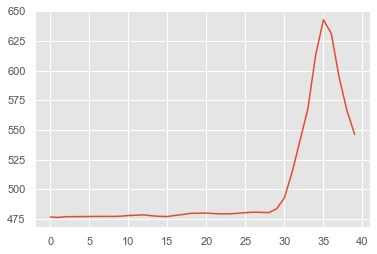

no_event no_event 2


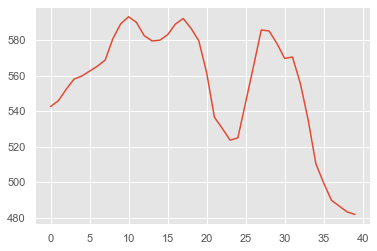

no_event no_event 1


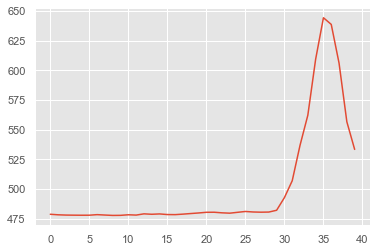

no_event no_event 2


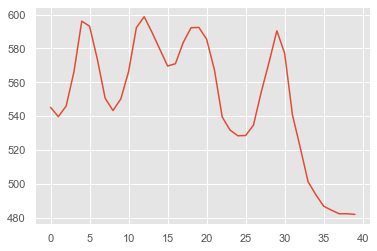

no_event no_event 1


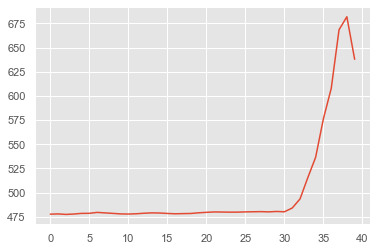

no_event no_event 2


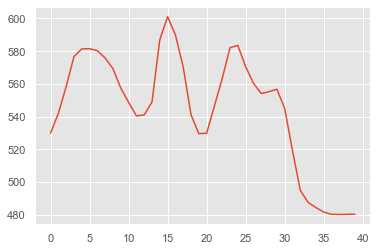

no_event no_event 1


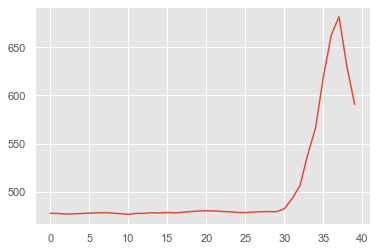

no_event no_event 2


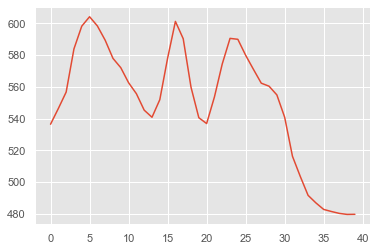

no_event no_event 1


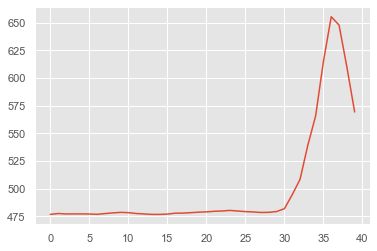

no_event no_event 2


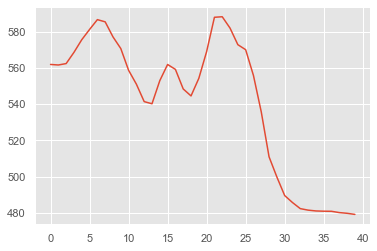

no_event no_event 1


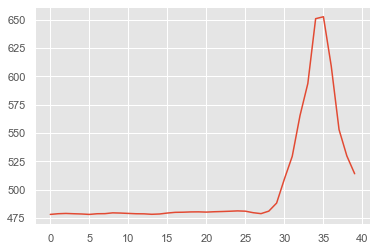

no_event no_event 1


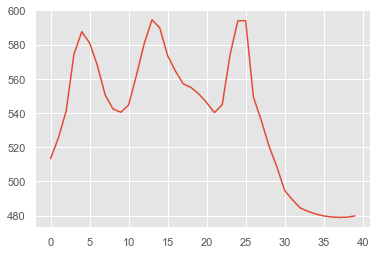

no_event no_event 1


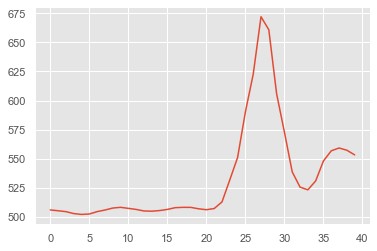

no_event no_event 2


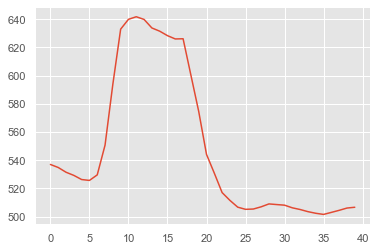

no_event no_event 1


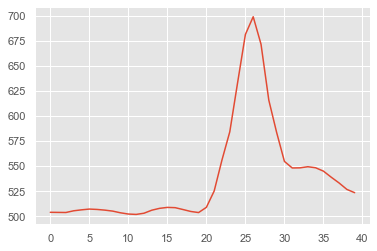

no_event no_event 1


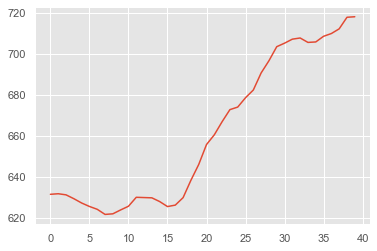

no_event no_event 2


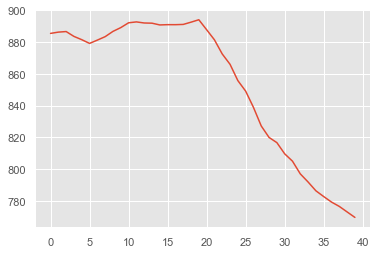

no_event no_event 1


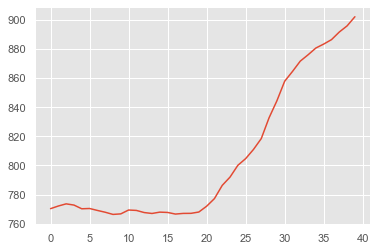

no_event no_event 2


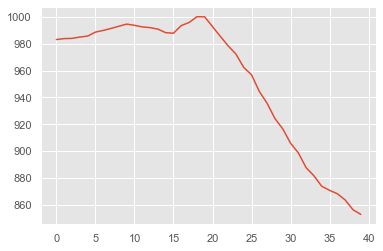

no_event no_event 2


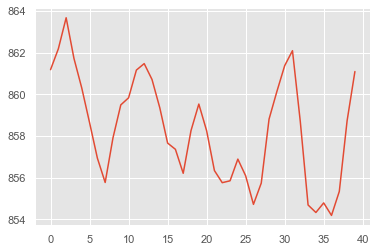

no_event no_event 2


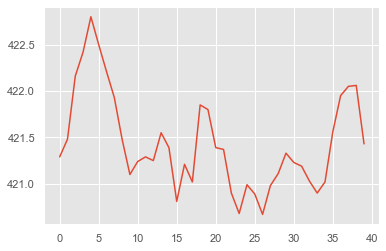

no_event Refrigerator_ON 1


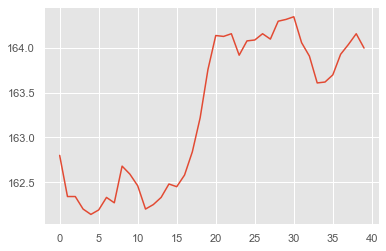

no_event no_event 2


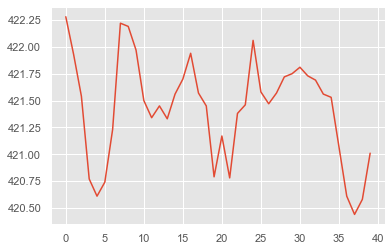

In [39]:
def read_series(vc):
    if vc.index[0] != 'no_event':
        return vc.index[0]
    elif len(vc) > 1:
        if vc[1] > 2:
            return vc.index[1]
    return vc.index[0]

def plot_around_observed_events(indice, data):
    frequency = 20
    timewindow = 1
    startindice = max(0, indice - frequency * timewindow)
    endindice = min(len(data) - 1, indice + frequency * timewindow)
    data = (data[startindice:endindice][['mains_power']]).to_numpy()
    plt.plot(data)
    plt.show()
    return 

act_list = []
pre_list = []

for i in range(len(ind_obser_events)):
    fvc = label_list[i]
    pvc = pred_list[i]
    act_list.append(read_series(fvc))
    pre_list.append(read_series(pvc))
    print(read_series(fvc), read_series(pvc), tr_data.observable_event[ind_obser_events[i]])
#     if read_series(fvc)!= read_series(pvc):
    plot_around_observed_events(ind_obser_events[i], tr_data)
    
    

In [40]:
ylab = act_list
pred = pre_list
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred)
calculate_metrics(cf1)

0.2139975456358337
0.9719202898550725
For label  0
tp:  0  fp:  3  fn:  0  tn:  1101
For label  1
tp:  0  fp:  4  fn:  0  tn:  1100
For label  2
tp:  0  fp:  1  fn:  3  tn:  1100
For label  3
tp:  1  fp:  22  fn:  0  tn:  1081
For label  4
tp:  1072  fp:  1  fn:  28  tn:  3


In [41]:
len(ind_obser_events)

1104

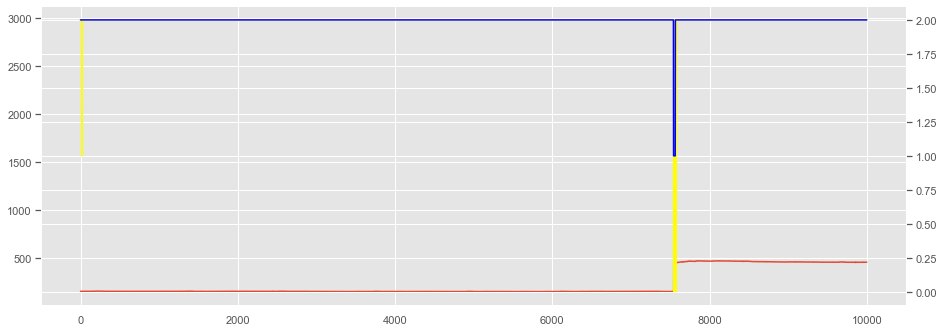

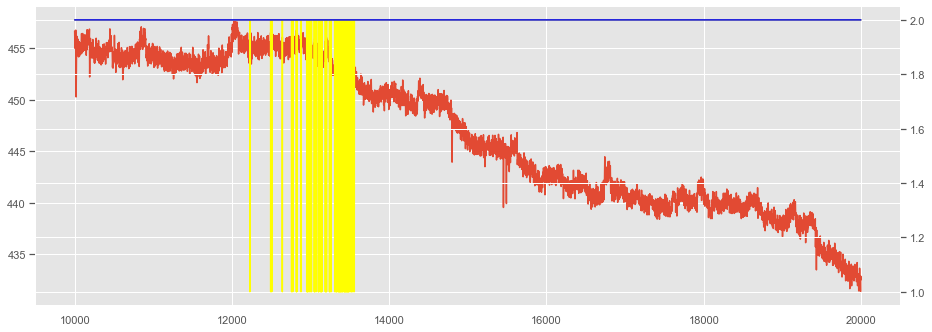

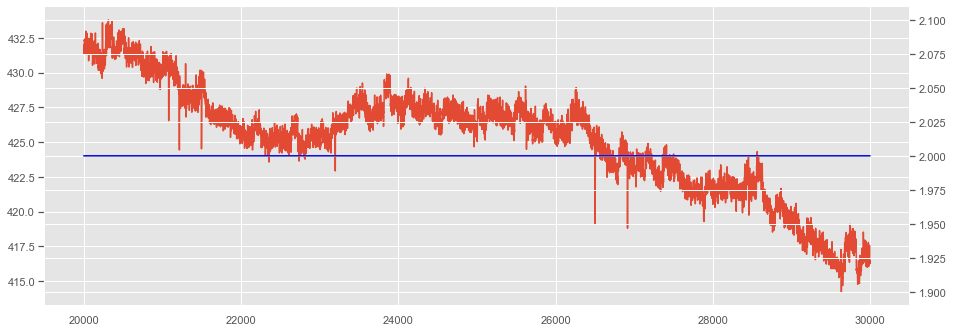

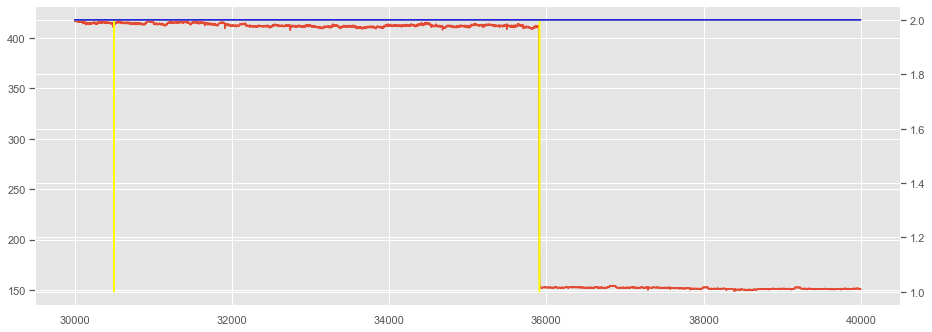

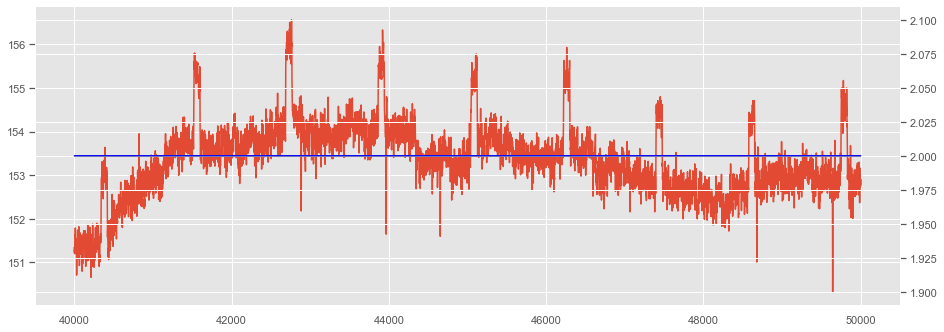

...

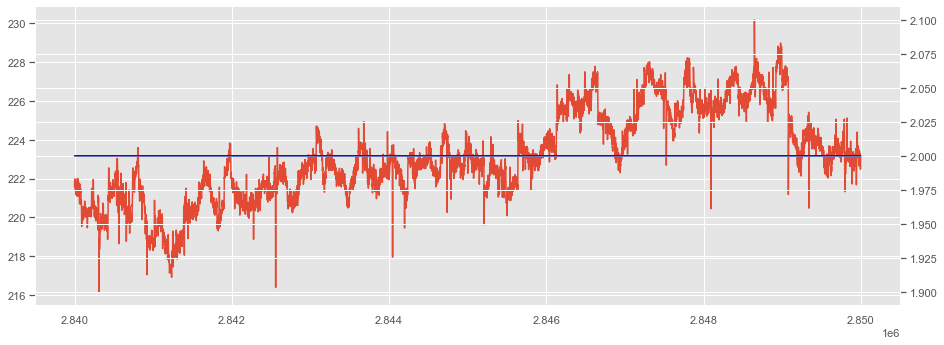

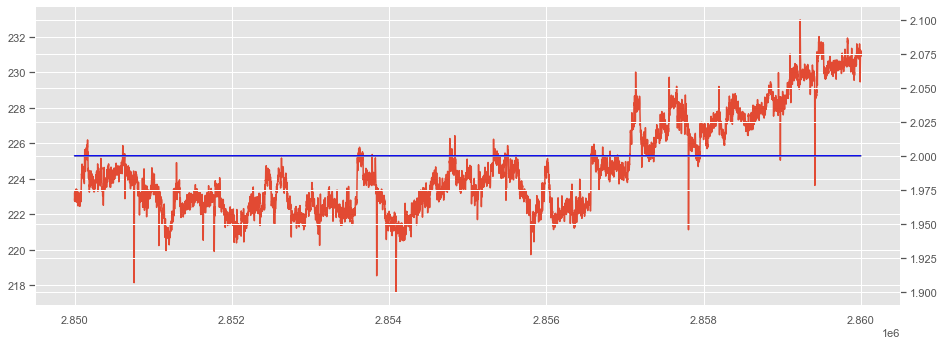

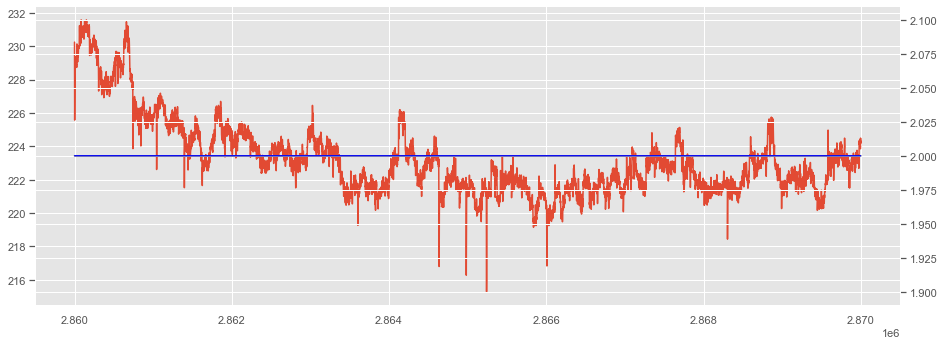

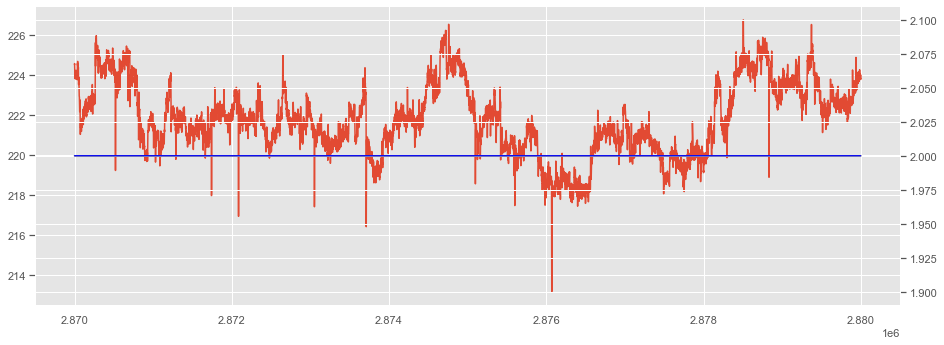

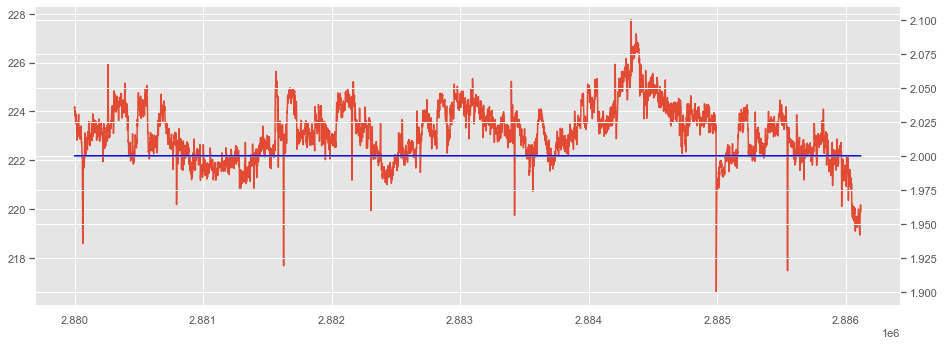

In [85]:
show_data = tr_data[['logged_on_utc', 'mains_power','prev_mean','time_since_last_event','time_since_event_start', 'normalized_mains_power', 'label', 'Preds']]
show_data.label = encoder.transform(show_data['label'])
for start in range(0, len(show_data), 10000):
    end = start + 10000
    fig,ax=plt.subplots()
    ax2=ax.twinx()
    fig.set_size_inches(15.5, 5.5)
    show_data['mains_power'][start:end].plot(ax=ax)
    show_data['Preds'][start:end].plot(ax=ax2, color='yellow')
    show_data['label'][start:end].plot(ax=ax2, color='blue')
    plt.show()

In [22]:
ylab = np.argmax(y_train, axis=1)
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
calculate_metrics(cf1)

0.34773894647926884
0.9879779107059206
[[    229      73      15]
 [    189     207      18]
 [  19568   14834 2850971]]
For label  0
tp:  229  fp:  19757  fn:  88  tn:  2866030
For label  1
tp:  207  fp:  14907  fn:  207  tn:  2870783
For label  2
tp:  2850971  fp:  33  fn:  34402  tn:  698


In [2]:
.9**5

0.5904900000000001